In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
my_google_drive_path = "/content/drive/MyDrive/BTP/"
import os
assert os.path.isdir(my_google_drive_path), f"{my_google_drive_path} is not a valid location"

In [ ]:

input_dir="/content/drive/MyDrive/BTP/EmodB_without_silence"

if os.path.exists(input_dir)==False:
    try:
      os.mkdir(input_dir)
      print("Directory \"wav_data\" created.")

    except OSError as error:
      print(error)


# print("Upload the wav files in the \"wav_data\" folder")

In [ ]:
!pip install datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.6/474.6 kB 26.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 64.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 32.6 MB/s eta 0:00:00


In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 94.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 102.4 MB/s eta 0:00:00


In [ ]:
!pip install audiomentations

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.1/66.1 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.3/214.3 kB 26.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 80.8 MB/s eta 0:00:00
  Attempting uninstall: librosa
    Found existing installation: librosa 0.10.0.post2
    Uninstalling librosa-0.10.0.post2:
      Successfully uninstalled librosa-0.10.0.post2


In [ ]:
import fnmatch
import os
import os.path
import numpy as np
import pandas as pd
import torch
import tensorflow
import torchaudio
from audiomentations import Compose, Shift
from datasets import load_dataset
from imblearn.over_sampling import RandomOverSampler
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from transformers import Wav2Vec2FeatureExtractor

In [ ]:
import librosa
import numpy as np

In [ ]:
def getlabel(name):
  x='neutral'
  if name[0:2] in '0310111215':  # MALE
      if name[5] == 'W':  # Ärger (Wut) -> Angry
          x='angry'
      elif name[5] == 'L':  # Langeweile -> Boredom
          x='bored'
      elif name[5] == 'E':  # Ekel -> Disgusted
          x='disgust'
      elif name[5] == 'A':  # Angst -> Angry
          x='fear'
      elif name[5] == 'F':  # Freude -> Happiness
          x='happy'
      elif name[5] == 'T':  # Trauer -> Sadness
          x='sad'

      else:
          x='neutral'
  else:
      if name[5] == 'W':  # Ärger (Wut) -> Angry
          x='angry'
      elif name[5] == 'L':  # Langeweile -> Boredom
          x='bored'
      elif name[5] == 'E':  # Ekel -> Disgusted
          x='disgust'
      elif name[5] == 'A':  # Angst -> Angry
          x='fear'
      elif name[5] == 'F':  # Freude -> Happiness
          x='happy'
      elif name[5] == 'T':  # Trauer -> Sadness
          x='sad'

      else:
          x='neutral'
  return x



In [ ]:
!pip install speechbrain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.0/519.0 kB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 61.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.5/109.5 kB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 485.6/485.6 kB 35.6 MB/s eta 0:00:00


In [ ]:
!pip install -q torchaudio

SAMPLING_RATE = 16000

import torch
torch.set_num_threads(1)

from IPython.display import Audio
from pprint import pprint
# download example
torch.hub.download_url_to_file('https://models.silero.ai/vad_models/en.wav', 'en_example.wav')

100%|██████████| 1.83M/1.83M [00:01<00:00, 1.64MB/s]


In [ ]:
USE_ONNX = False # change this to True if you want to test onnx model
if USE_ONNX:
    !pip install -q onnxruntime

model, utils = torch.hub.load(repo_or_dir='snakers4/silero-vad',
                              model='silero_vad',
                              force_reload=True,
                              onnx=USE_ONNX)

(get_speech_timestamps,
 save_audio,
 read_audio,
 VADIterator,
 collect_chunks) = utils

/usr/local/lib/python3.10/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/snakers4/silero-vad/zipball/master" to /root/.cache/torch/hub/master.zip


In [ ]:
wav = read_audio('/content/drive/MyDrive/BTP/EmodB/03b03Tc.wav', sampling_rate=SAMPLING_RATE)
# get speech timestamps from full audio file
speech_timestamps = get_speech_timestamps(wav, model, sampling_rate=SAMPLING_RATE)
pprint(speech_timestamps)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %669 : int[] = prim::profile_ivalue(%667)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)


[{'end': 41440, 'start': 1568}, {'end': 82912, 'start': 64032}]


In [ ]:
print(speech_timestamps)

[{'start': 1568, 'end': 41440}, {'start': 64032, 'end': 82912}]


In [ ]:
save_audio('only_speech.wav',
           collect_chunks(speech_timestamps, wav), sampling_rate=SAMPLING_RATE)
Audio('only_speech.wav')

In [ ]:
audio, sample_rate = librosa.load("/content/drive/MyDrive/BTP/EmodB/03b03Tc.wav")
Audio("/content/drive/MyDrive/BTP/EmodB/03b03Tc.wav")

In [ ]:
audio1, sample_rate = librosa.load("/content/drive/MyDrive/BTP/EmodB_without_silence/03b03Tc.wav")

Audio("/content/drive/MyDrive/BTP/EmodB_without_silence/03b03Tc.wav")

audio2, sample_rate = librosa.load("/content/drive/MyDrive/BTP/EmodB_without_silence_30/03b03Tc.wav")

# audio2=winframe_varshift2(audio,30)
# from scipy.io.wavfile import write
# write('temp.wav', sample_rate, audio2)

In [ ]:
# import matplotlib.pyplot as plt
# plt.plot(audio)
# plt.figure()
# plt.plot(audio1)
# plt.figure()
# plt.plot(audio2)

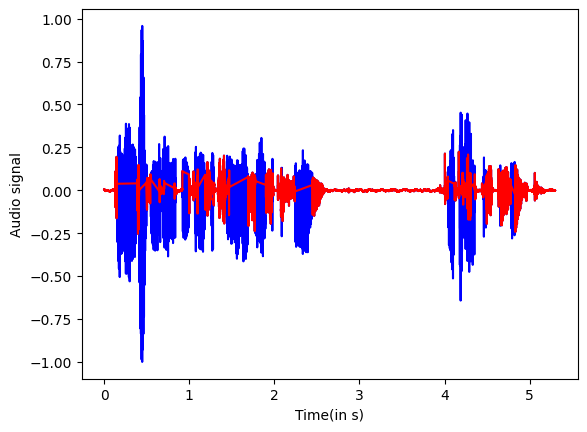

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

a1=[]
b1=[]

def winframe_varshift(y,threshold):



    # Calculate framedspeech
    framedspeech = np.zeros((len(y)//80, 160))
    # print(framedspeech.shape)
    w = np.hamming(160)
    # print(w.shape)
    for i in range(framedspeech.shape[0]):
      if i*80+160<=len(y):
        t=y[i*80:i*80+160]
        # print(t.shape,w.shape)
        framedspeech[i, :] = (y[i*80:i*80+160] * w).flatten()

    # Calculate remaining variables
    E = 20 * np.log10(np.std(framedspeech, axis=1) + np.finfo(float).eps)
    maxl = np.max(E)
    # I = (E > maxl - threshold) & (E > -55)
    I=E > maxl - threshold
    taken=y>=0

    for j in range(len(y)):
      taken[j]=False


    for j in range(len(I)):
      if I[j]:
        for k in range(j*80,j*80+160):
          taken[k]=True
    # I=E>10

    taken_not=y>=0


    for j in range(len(y)):
      taken_not[j]=True
      if taken[j]:
        taken_not[j]=False
    framedspeech = framedspeech[I, :]
    g = framedspeech.shape[0]
    w_rep = np.concatenate([np.tile(w, (1, g)), np.tile(w, (1, g))], axis=1)[:,:framedspeech.shape[0]]
    win_framedspeech = framedspeech * w_rep.T

    # inv_w = 1 / w
    #inv_w=1
    #frames = win_framedspeech * inv_w
    # print(frames.shape)

    frames = win_framedspeech
    audio = np.zeros(len(y))
    start=0
    end=160
    for i in range(frames.shape[0]):
        start = i * 80
        end = start + 160
        audio[start:end] += frames[i, :]

    # Trim any extra padded zeros
    audio = audio[:end]
    audio=audio.astype('float32')

    time = list(range(len(y)))
    time=np.array(time)
    y2=y[taken_not]
    tw=1/SAMPLING_RATE
    plt.plot(tw*time, y, 'b')

    plt.plot(tw*np.where(taken_not)[0], y2, 'r')

    # print(taken.shape,y.shape)
    # print(y[taken].shape)
    y1=y[taken]
    # print(y1.shape)
    # print(taken)
    # plt.plot(np.where(taken)[0], y1, 'b')
    # print(np.where(taken)[0])

    plt.xlabel('Time(in s)')
    plt.ylabel('Audio signal')
    plt.show()

    return audio


y = read_audio('/content/drive/MyDrive/BTP/EmodB/03b03Tc.wav', sampling_rate=SAMPLING_RATE)
# Plot curve
xx=winframe_varshift(y, threshold=15)

In [ ]:
import numpy as np

def winframe_varshift2(y,threshold):



    # Calculate framedspeech
    framedspeech = np.zeros((len(y)//160, 160))
    # print(framedspeech.shape)
    w = np.hamming(160)
    # print(w.shape)
    for i in range(framedspeech.shape[0]):
      if i*160+160<=len(y):
        t=y[i*160:i*160+160]
        # print(t.shape,w.shape)
        framedspeech[i, :] = (y[i*160:i*160+160] * w).flatten()

    # framedspeech=librosa.util.frame(y,160,80)
    # print(framedspeech.shape)
    # framedspeech=np.transpose(framedspeech)

    # Calculate remaining variables
    E = 20 * np.log10(np.std(framedspeech, axis=1) + np.finfo(float).eps)
    maxl = np.max(E)
    # I = (E > maxl - threshold) & (E > -55)
    I=E > maxl - threshold
    # I=E>10
    framedspeech = framedspeech[I, :]
    g = framedspeech.shape[0]
    w_rep = np.concatenate([np.tile(w, (1, g)), np.tile(w, (1, g))], axis=1)[:,:framedspeech.shape[0]]
    win_framedspeech = framedspeech * w_rep.T

    # inv_w = 1 / w
    inv_w=1
    frames = framedspeech * inv_w
    print(frames.shape)
    # print(frames.shape)
    audio = np.zeros(len(y))
    start=0
    end=160
    for i in range(frames.shape[0]):
        start = i * 160
        end = start + 160
        audio[start:end] += frames[i, :]

    # Trim any extra padded zeros
    audio = audio[:end]
    audio=audio.astype('float32')
    return audio


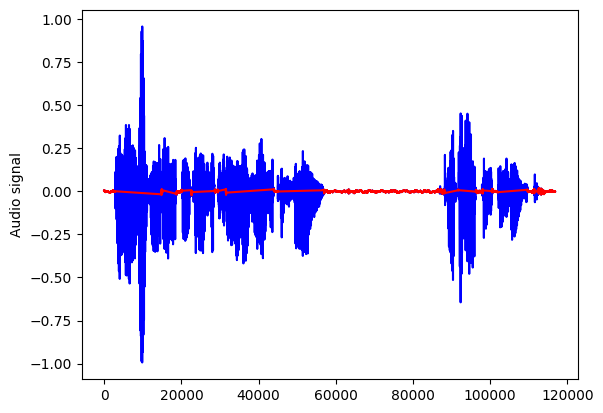

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,35)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

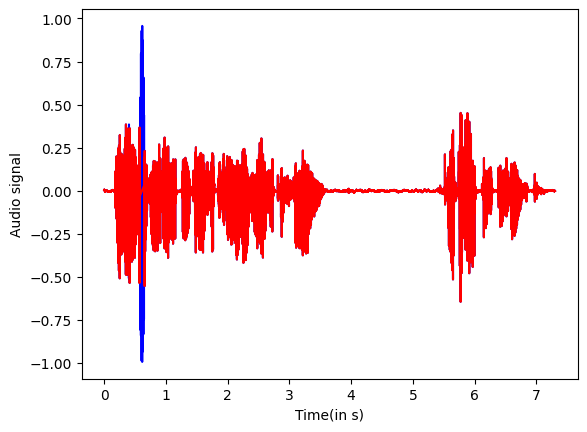

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,5)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

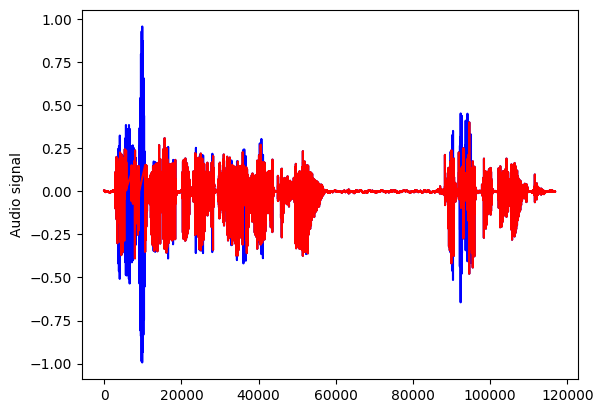

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,10)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

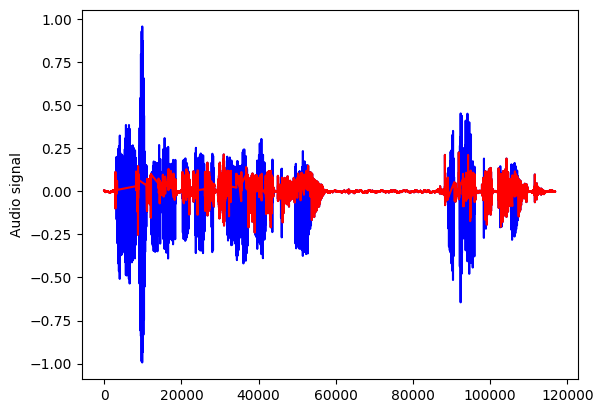

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,15)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

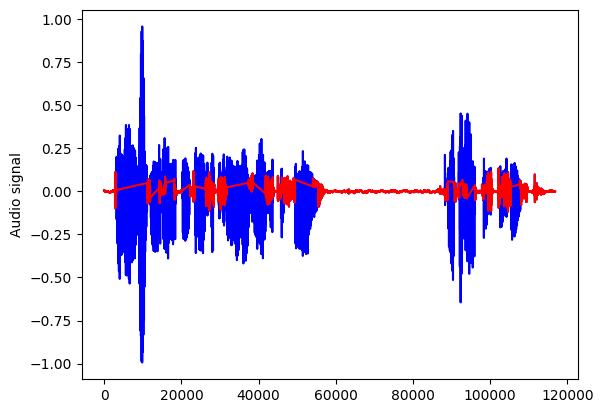

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,20)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

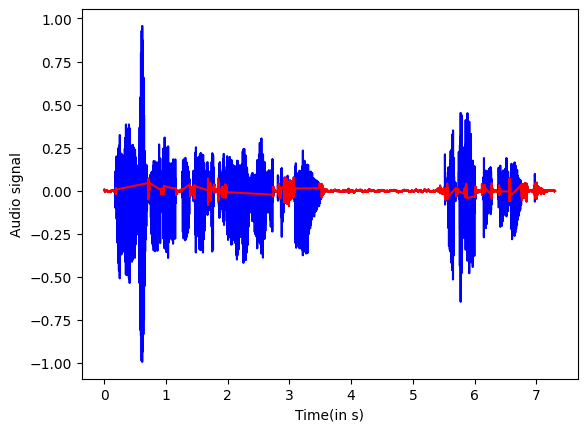

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,25)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

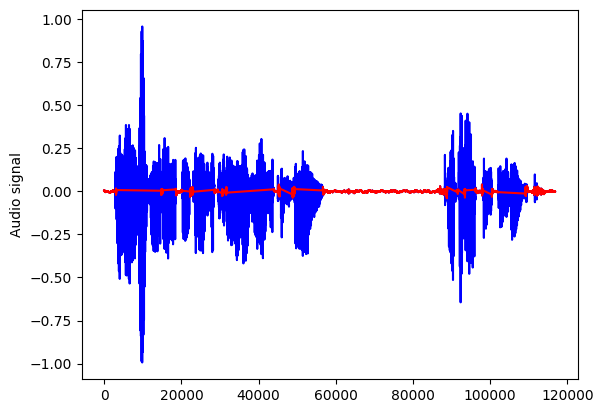

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,30)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

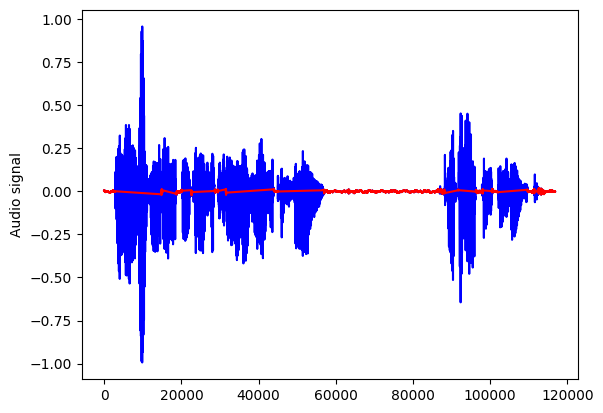

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,35)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

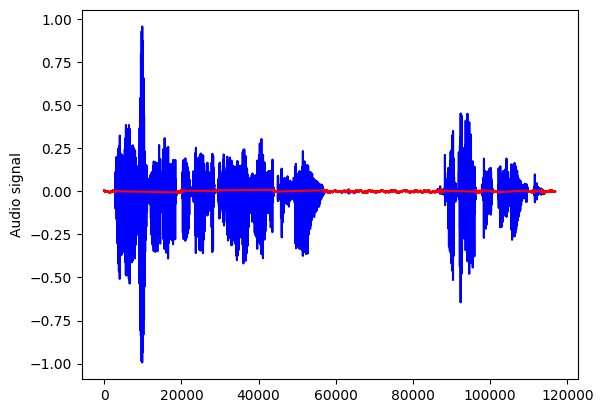

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,40)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

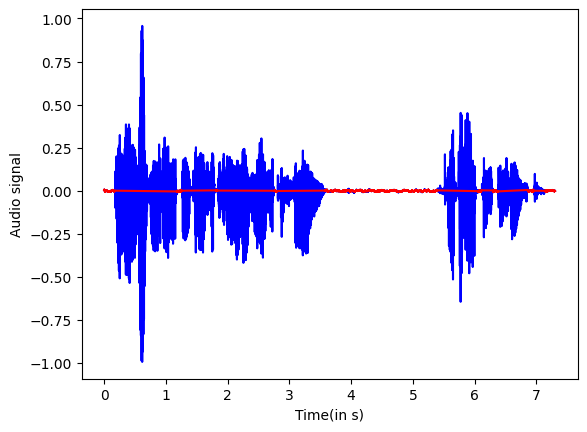

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,45)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

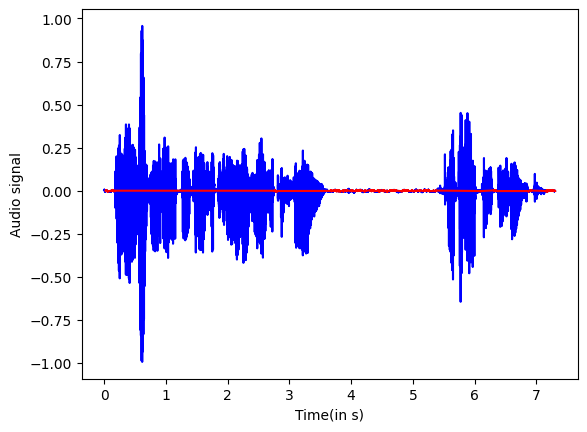

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,50)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

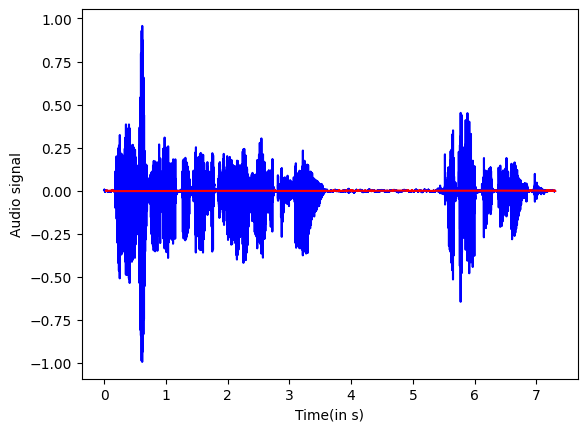

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,55)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

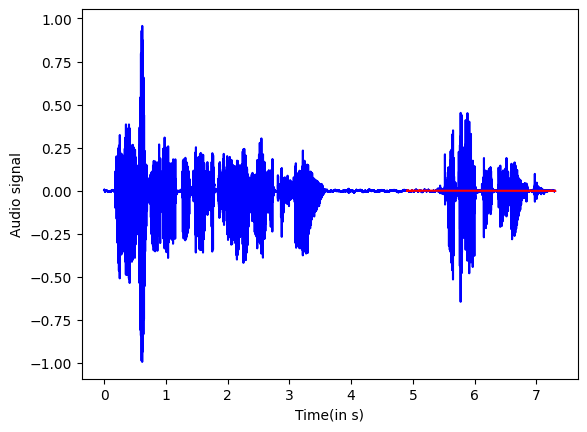

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,60)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

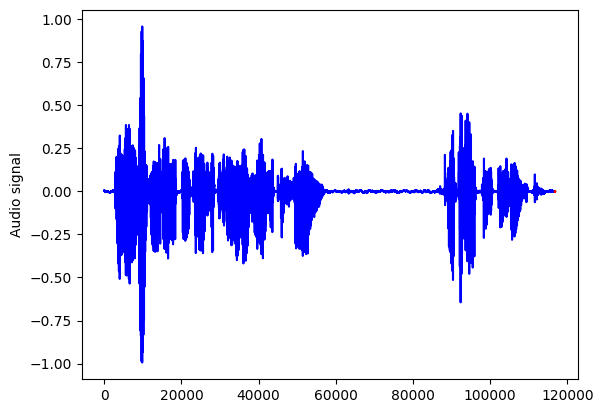

In [ ]:
from scipy.io.wavfile import write

w=winframe_varshift(audio,150)
# print(w.shape)
write("no_silence.wav", sample_rate, w)
Audio('no_silence.wav')

In [ ]:
import os.path


def generate_all_files(path,th, extension):
  files = []
  files_silence=[]
  # files_test=[]
  # files_val=[]
  cnt=0
  for root, dirNames, fileNames in os.walk(path):
      for fileName in fnmatch.filter(fileNames, '*' + extension):

          #print(fileName)
          # if fileName[0:2]==test_speaker:
          #   #print(fileName)
          #   cnt=cnt+1
          #   files_test.append(os.path.join(root, fileName))
          # elif fileName[0:2]==val_speaker:
          #   files_val.append(os.path.join(root, fileName))

          # else:
          t=os.path.join(root, fileName)
          files.append(os.path.join(root, fileName))

          audio, sample_rate = librosa.load(t)

          #this code need to be run only for one time
          # wav = read_audio(t, sampling_rate=SAMPLING_RATE)
          # # get speech timestamps from full audio file
          # speech_timestamps = get_speech_timestamps(wav, model, sampling_rate=SAMPLING_RATE)
          # save_audio(root+'_without_silence/'+fileName,
          # collect_chunks(speech_timestamps, wav), sampling_rate=SAMPLING_RATE)
          # print(fileName)
          # print(root)



          w=winframe_varshift(audio,th)

          if os.path.exists(root+'_without_silence_'+str(th)+'/') == False:
            os.mkdir(root+'_without_silence_'+str(th)+'/')


          write(root+'_without_silence_'+str(th)+'/'+fileName, sample_rate, w)









  #print(cnt)
  return files

In [ ]:
input_dir='/content/drive/MyDrive/BTP/EmodB'
# thresh=[x for x in range(20,65,5)]
# for th in thresh:
#   f=generate_all_files('/content/drive/MyDrive/BTP/EmodB',th,'.wav')


In [ ]:
# for th in thresh:
#   f=generate_all_files('/content/drive/MyDrive/BTP/Ravdess',th,'.wav')

In [ ]:
# def load_data(path, extension='.wav'):
#   """
#   Goal : collect all data samples (audio files) with specified data type (extension) that exist in given path
#       and also label samples
#   Output : A pandas dataframe that includes data sample path and its label
#   """
#   if not os.path.isdir(path):
#     print('Dataset path does not exist ')
#     quit()
#   else:

#     audios,audios_silent = get_all_files(path, extension)
#     # Get the file name as its label
#     labels = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios]
#     labels_silent = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios_silent]

#     # labels_test = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios_test]
#     if len(audios) == 0:

#       print('There is no sample in dataset')
#       quit()
#     else:

#       # Encode labels to digits
#       le = preprocessing.LabelEncoder()
#       labels = le.fit_transform(labels)
#       labels_silent = le.fit_transform(labels_silent)
#       # labels_test = le.fit_transform(labels_test)
#       # Create pandas dataframe
#       df = pd.DataFrame({"path": audios, "label": labels})
#       df_silent = pd.DataFrame({"path": audios_silent, "label": labels_silent})
#       # df_test = pd.DataFrame({"path": audios_test, "label": labels_test})

#   return df,df_silent,le

In [ ]:
import random

In [ ]:
def get_all_files(path, extension):
  files = []
  files_test=[]
  files_val=[]
  cnt=0
  for root, dirNames, fileNames in os.walk(path):
      for fileName in fnmatch.filter(fileNames, '*' + extension):

          #print(fileName)
          # if fileName[0:2]==test_speaker:
          #   #print(fileName)
          #   cnt=cnt+1
          #   files_test.append(os.path.join(root, fileName))
          # elif fileName[0:2]==val_speaker:
          #   files_val.append(os.path.join(root, fileName))

          # else:
          # files.append(os.path.join(root, fileName))
          files.append(fileName)
          random.shuffle(files)

  #print(cnt)

  n=len(files)
  n1=int(0.7*n)
  n2=int(0.9*n)

  files1=files[0:n1]
  files_val=files[n1:n2]
  files_test=files[n2:]

  return files1,files_val,files_test

In [ ]:
# input_dir='/content/drive/MyDrive/BTP/EmodB'

# f1,f1_val,f1_test=get_all_files(input_dir,'.wav')

# input_dir='/content/drive/MyDrive/BTP/Ravdess'
# f2,f2_val,f2_test=get_all_files(input_dir,'.wav')


In [ ]:
# with open("file_e.txt", 'w') as f:
#     for s in f1:
#         f.write(str(s) + '\n')

# with open("file_val_e.txt", 'w') as f:
#     for s in f1_val:
#         f.write(str(s) + '\n')


# with open("file_test_e.txt", 'w') as f:
#     for s in f1_test:
#         f.write(str(s) + '\n')

# with open("file_r.txt", 'w') as f:
#     for s in f2:
#         f.write(str(s) + '\n')

# with open("file_val_r.txt", 'w') as f:
#     for s in f2_val:
#         f.write(str(s) + '\n')


# with open("file_test_r.txt", 'w') as f:
#     for s in f2_test:
#         f.write(str(s) + '\n')



In [ ]:
with open("file_e.txt", 'r') as f:
    f1 = [line.rstrip('\n') for line in f]

with open("file_val_e.txt", 'r') as f:
    f1_val = [line.rstrip('\n') for line in f]

with open("file_test_e.txt", 'r') as f:
    f1_test = [line.rstrip('\n') for line in f]

with open("file_r.txt", 'r') as f:
    f2 = [line.rstrip('\n') for line in f]

with open("file_val_r.txt", 'r') as f:
    f2_val = [line.rstrip('\n') for line in f]

with open("file_test_r.txt", 'r') as f:
    f2_test = [line.rstrip('\n') for line in f]

In [ ]:
f2_test[0]

'03-01-02-01-01-02-15.wav'

In [ ]:
def load_data(path,files,files_val,files_test, extension='.wav'):
  """
  Goal : collect all data samples (audio files) with specified data type (extension) that exist in given path
      and also label samples
  Output : A pandas dataframe that includes data sample path and its label
  """
  if not os.path.isdir(path):
    print('Dataset path does not exist ')
    quit()
  else:

    audios=[0]*len(files)
    audios_val=[0]*len(files_val)
    audios_test=[0]*len(files_test)

    # audios,audios_val,audios_test = get_all_files(path, extension)
    for i in range(len(audios)):
      audios[i]=path+'/'+files[i]

    for i in range(len(audios_val)):
      audios_val[i]=path+'/'+files_val[i]

    for i in range(len(audios_test)):
      audios_test[i]=path+'/'+files_test[i]


    # Get the file name as its label
    labels = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios]
    labels_val = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios_val]

    labels_test = [getlabel(os.path.basename(path).replace(extension, '')) for path in audios_test]
    if len(audios) == 0:

      print('There is no sample in dataset')
      quit()
    else:

      # Encode labels to digits
      le = preprocessing.LabelEncoder()
      labels = le.fit_transform(labels)
      labels_val = le.fit_transform(labels_val)
      labels_test = le.fit_transform(labels_test)
      # Create pandas dataframe
      df = pd.DataFrame({"path": audios, "label": labels})
      df_val = pd.DataFrame({"path": audios_val, "label": labels_val})
      df_test = pd.DataFrame({"path": audios_test, "label": labels_test})

  return df,df_val, df_test, le

In [ ]:
# files,files_val,files_test=get_all_files(input_dir,'.wav')

# df,df_val,df_test,_=load_data("/content/drive/MyDrive/BTP/EmodB",f1,f1_val,f1_test)
# # df.head()
# Audio((df.iloc[80].tolist())[0])

In [ ]:
# input_dir="/content/drive/MyDrive/BTP/Ravdess"
# files,files_silent=get_all_files(input_dir,'.wav')
# input_dir="/content/drive/MyDrive/BTP/EmodB"



In [ ]:
# files,files_silent=get_all_files(input_dir,'.wav')

In [ ]:
def split_data(dataframe, train_size=0.7, stratify=None):
  train_df, val_df_temp = train_test_split(dataframe, train_size=train_size, stratify=stratify, shuffle=True)
  train_df = train_df.reset_index(drop=True)
  val_df_temp = val_df_temp.reset_index(drop=True)

  val_df,test_df= train_test_split(val_df_temp, train_size=0.6, stratify=stratify, shuffle=True)

  return train_df, val_df,test_df

In [ ]:
def make_dataset(train_df,val_df,test_df, train_size):
  """
  Goal : Split data
  Output : A Huggingface dataset that includes train and validation sets
  """
  # Split data to train and validation sets  with maintaining classes distribution
  #train_df, val_df = split_data(df, train_size=train_size, stratify=df['label'])
  # Duplicate each data sample in the train set (in order to perform data augmentation methods)
  # --> Also you can use the below code to do random over-sampling in minority classes :
  # </> train_df = random_over_sampling(train_df)
  #train_df = pd.concat([train_df, train_df], axis=0)
  # Save data to csv files
  train_csv_path = "train.csv"
  val_csv_path = "validation.csv"
  test_csv_path="test.csv"
  train_df.to_csv(train_csv_path, sep="\t", encoding="utf-8", index=False)
  val_df.to_csv(val_csv_path, sep="\t", encoding="utf-8", index=False)
  test_df.to_csv(test_csv_path, sep="\t", encoding="utf-8", index=False)
  # Create an (huggingface) dataset
  data_files = {"train": train_csv_path, "validation": val_csv_path,"test":test_csv_path}
  dataset = load_dataset("csv", data_files=data_files, delimiter="\t", )

  return dataset

In [ ]:
def random_over_sampling(data):
  over_sampler = RandomOverSampler(random_state=42, sampling_strategy={1: 152, 2: 804, 5: 762})
  x_train, y_train = over_sampler.fit_resample(data['path'].values.reshape(-1, 1), data['label'].values)
  return pd.DataFrame({"path": x_train.squeeze(), "label": y_train})

In [ ]:
def get_feature_extractor(sampling_rate=16e3):
  return Wav2Vec2FeatureExtractor(feature_size=1, sampling_rate=sampling_rate,
                                  padding_value=0.0, do_normalize=True, return_attention_mask=False)

In [ ]:
def file_to_array(path, target_sampling_rate):
  array, sampling_rate = torchaudio.load(path)
  # print('#'*70)
  # print(array.shape)
  # print('#'*70)
  arr1=array.flatten()
  # "facebook/hubert-base-ls960" pre-trained on 16kHz sampled speech audios. So we resample all audio files to make
  #   sure the model input sampling rate is also 16k .
  resampler = torchaudio.transforms.Resample(sampling_rate, target_sampling_rate)
  return resampler(arr1).squeeze().numpy()

In [ ]:
class EMOdbDataset(Dataset):

  def __init__(self, dataset, train):
      self.dataset = dataset
      self.feature_extractor = get_feature_extractor()
      self.train = train

  def __getitem__(self, item):
      path = self.dataset[item]['path']
      label = self.dataset[item]['label']
      sr = self.feature_extractor.sampling_rate
      # Convert audio file to speech (1d) array
      speech = file_to_array(path, sr)
      # audio time shift augmentation
      # --> The idea is very simple. It just shifts audio to left/right with a random second
      augment = Compose([
          Shift(min_fraction=-1, max_fraction=1, p=0.5),
          # You can shift the sudio pitch too, with below code :
          # </> PitchShift(min_semitones=-2, max_semitones=2, p=0.5),
      ])
      # Do augmentation only on train set samples.
      if self.train:
        speech = augment(samples=speech, sample_rate=sr)

      input_values = self.feature_extractor(speech,
                                            sampling_rate=sr,

                                            ).input_values[0]   # truncation=True,
                                            # max_length=int(sr * 5) # means 5 second

      return input_values, label

  def __len__(self):
    return len(self.dataset)

In [ ]:
def collate_fn(batch):
  """
  Goal: Make the length of all speech arrays (that exist in a batch)
      equal to the longest array ( by padding : adding zeros to the end of arrays).
  Output: A batch of data (Model input and true label ) with specified batch size
  """
  batch = np.array(batch, dtype=object)
  input_values = batch[:, 0]
  labels = batch[:, 1]

  input_features = [{"input_values": feature} for feature in input_values]
  padded_inputs = get_feature_extractor().pad(input_features, padding=True, return_tensors="pt")

  labels = np.vstack(labels).astype(float)
  labels = torch.from_numpy(labels).squeeze().type(torch.LongTensor)

  return padded_inputs['input_values'], labels

In [ ]:
def get_data_loaders(dataset, train_bs, val_bs,test_bs):
  train_dl = DataLoader(EMOdbDataset(dataset['train'], train=True), batch_size=train_bs,
                        collate_fn=collate_fn, shuffle=True)
  val_dl = DataLoader(EMOdbDataset(dataset['validation'], train=False), batch_size=val_bs,
                      collate_fn=collate_fn, shuffle=True)

  test_dl = DataLoader(EMOdbDataset(dataset['test'], train=False), batch_size=test_bs,
                      collate_fn=collate_fn, shuffle=True)
  print(train_dl)
  return train_dl, val_dl,test_dl

In [ ]:
import torch
from torch import nn
from transformers import AutoModel

In [ ]:
class SpeechCLF(nn.Module):
  def __init__(self, model_checkpoint, num_labels):

    super(SpeechCLF, self).__init__()

    self.transformer_model = AutoModel.from_pretrained(model_checkpoint, num_labels=num_labels)
    self.projector = nn.Linear(self.transformer_model.config.hidden_size, self.transformer_model.config.hidden_size)
    self.classifier = nn.Linear(self.transformer_model.config.hidden_size, num_labels)

  def freeze_feature_encoder(self):
    self.transformer_model.feature_extractor._freeze_parameters()

  def merge(self, hidden_states):
    return torch.mean(hidden_states, dim=1)

  def forward(self, input_values, attention_mask=None):
    hidden_states = self.transformer_model(input_values, attention_mask=attention_mask).last_hidden_state
    x = self.merge(hidden_states)
    x = self.projector(x)
    x = torch.tanh(x)
    return self.classifier(x)

In [ ]:
def get_model(check_point, num_classes, device):
  model = SpeechCLF(check_point, num_classes)
  model.freeze_feature_encoder()
  model = model.to(device)
  return model

In [ ]:
import warnings
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import torch

In [ ]:
def plot_dist(df, classes_names):
  classes = np.unique(df['label'].values)
  counts = [df['label'].values.tolist().count(class_) for class_ in classes]
  df = pd.DataFrame({'classes': classes, 'count': counts})

  plt.figure(figsize=(10, 6))
  ax = sns.barplot(x='classes', y='count', data=df)
  ax.set_xticklabels(classes_names, size=12)
  ax.set_xlabel('Class', size=13)
  ax.set_ylabel('Frequency', size=13)
  ax.set_title('Class Distribution of Dataset', size=15)
  ax.bar_label(ax.containers[0])
  plt.show()

In [ ]:
def plotLoss(ax, loss_list, title):
  ax.plot(loss_list[:, 0], label="Train_loss")
  ax.plot(loss_list[:, 1], label="Validation_Loss")
  ax.set_title("Loss Curves - " + title, fontsize=12)
  ax.set_ylabel("Loss", fontsize=10)
  ax.set_xlabel("Epoch", fontsize=10)
  ax.legend(prop={'size': 10})

In [ ]:
def plotAccuracy(ax, metric_list, title):
  ax.plot(metric_list[:, 0], label="Train_Accuracy")
  ax.plot(metric_list[:, 1], label="Validation_Accuracy")
  ax.set_title("Accuracy Curve - " + title, fontsize=12)
  ax.set_ylabel("Score", fontsize=10)
  ax.set_xlabel("Epoch", fontsize=10)
  ax.legend(prop={'size': 10})

In [ ]:
def plot_training(loss_list, metric_list, title):
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
  fig.subplots_adjust(wspace=.2)
  plotLoss(ax1, np.array(loss_list), title)
  plotAccuracy(ax2, np.array(metric_list), title)
  plt.show()

In [ ]:
def plot_cnf_matrix(cm, classes):
  cm_df = pd.DataFrame(cm, classes, classes)
  plt.figure(figsize=(10, 10))
  sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')


In [ ]:
def report(labels, preds, encoder):
  # confusion matrix
  cm = confusion_matrix(labels, preds)
  # decode labels (ids to class name)
  preds = encoder.inverse_transform(preds)
  labels = encoder.inverse_transform(labels)
  # calculate accuracy for each class
  class_accuracies = []
  for class_ in encoder.classes_:
      class_acc = np.mean(preds[labels == class_] == class_)
      class_accuracies.append(class_acc)

  print(list(zip(encoder.classes_, class_accuracies)))
  print(classification_report(labels, preds, labels=encoder.classes_))
  plot_cnf_matrix(cm, encoder.classes_)

In [ ]:
def collect(outputs, labels, predictions, true_labels):
  preds = torch.argmax(outputs, dim=1).cpu().numpy()
  labels = labels.cpu().numpy()
  if len(predictions) == 0:
    predictions = preds
    true_labels = labels
  else:
    predictions = np.concatenate((predictions, preds))
    true_labels = np.concatenate((true_labels, labels))

  return predictions, true_labels

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.utils import class_weight
import torch
import numpy as np
from torch import nn


In [ ]:
def get_classes_weight(labels):

  classes_weight = class_weight.compute_class_weight(class_weight='balanced', classes=np.unique(labels),
                                                      y=np.array(labels))
  return torch.tensor(classes_weight, dtype=torch.float)

In [ ]:
def train(model, dataloader, optimizer, criterion, epoch, device):
  # put the model on train mode

  torch.set_grad_enabled(True)
  model.train()
  losses, predictions, true_labels = [], [], []

  for iter, (inputs, labels) in enumerate(dataloader):


    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = model(inputs)
    # print(inputs.shape,labels.shape,outputs.shape)
    # print(labels)
    # print(outputs)




    if inputs.shape[0]!=1:

      loss = criterion(outputs, labels)
      losses.append(loss.item())

      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      # Collect predictions and true labels
      predictions, true_labels = collect(outputs, labels, predictions, true_labels)

      if iter % round((len(dataloader) / 5)) == 0:
        print(f'[Epoch][Batch] = [{epoch + 1}][{iter}] -> Loss = {np.mean(losses):.4f} ')

  return np.mean(losses), accuracy_score(true_labels, predictions), predictions, true_labels


In [ ]:
def evaluate(model, dataloader, criterion, device):
  # put the model on evaluation mode
  model.eval()
  losses, predictions, true_labels = [], [], []

  for iter, (inputs, labels) in enumerate(dataloader):

    inputs = inputs.to(device)
    labels = labels.to(device)

    # print(inputs.shape)
    # print(labels.shape)


    outputs = model(inputs)
    # print(outputs.shape)

    if(outputs.shape[0]!=1):

      loss = criterion(outputs, labels)
      losses.append(loss.item())

      # Collect predictions and true labels
      predictions, true_labels = collect(outputs, labels, predictions, true_labels)
      #print(true_labels)

  return np.mean(losses), accuracy_score(true_labels, predictions), predictions, true_labels

In [ ]:
your_google_drive_path = "/content/drive/MyDrive/BTP/EmodB_checkpoints/"

import os
# assert os.path.isdir(your_google_drive_path), f"{your_google_drive_path} is not a valid location"

In [ ]:
# def trainModel(data_path, check_point, lr, start_epoch,end_epoch, weight_decay, sch_gamma, sch_step, train_size, title='', train_bs=2,val_bs=2,test_bs=2):
#   # load data
#   #print(test_speaker,val_speaker)
#   df1,df1_silent, label_encoder = load_data(data_path)
#   print('-' * 70)
#   print('Data loaded successfully')
#   print('-' * 70)

#   df,df_val,df_test=split_data(df1_silent)

#   # Plot data class distribution
#   # </> plot_dist(df, label_encoder.classes_)

#   # create dataset
#   dataset = make_dataset(df,df_val,df_test, train_size)
#   print('-' * 70)
#   print('Number of Train samples =', len(dataset['train']))
#   print('Number of Validation samples =', len(dataset['validation']))
#   print('Number of Test samples =', len(dataset['test']))

#   # instantiate data loaders
#   train_dataloader, val_dataloader,test_dataloader = get_data_loaders(dataset, train_bs, val_bs,test_bs)
#   print('-' * 40)
#   print('Number of Train batches =', len(train_dataloader), '| batch size =', train_bs)
#   print('Number of Validation batches =', len(val_dataloader), '| batch size =', val_bs)
#   print('Number of Test batches =', len(test_dataloader), '| batch size =', test_bs)


#   # Specify processor device
#   device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#   print('-' * 40)
#   print(device, 'is available')

#   # Instantiate model
#   num_classes = len(label_encoder.classes_)
#   model = get_model(check_point, num_classes, device)
#   print('-' * 40)
#   print('Model loaded successfully')

#   # Determine the type of : optimizer, scheduler and loss function

#   optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

#   scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=sch_step, gamma=sch_gamma)

#   fc_weights = get_classes_weight(dataset['train'][:]['label']).to(device)

#   criterion = nn.CrossEntropyLoss(weight=fc_weights)

#   best_acc = 0
#   loss_list, acc_list = [], []

#   print('-' * 40)
#   print('Start Training ....\n')
#   for epoch in range(start_epoch,end_epoch):

#     # print('hi6')
#     train_loss, train_acc, _, _ = train(model, train_dataloader, optimizer, criterion, epoch, device)
#     # print('hi7')
#     val_loss, val_acc, _, _ = evaluate(model, val_dataloader, criterion, device)
#     #print('hi8')
#     scheduler.step()

#     loss_list.append([train_loss, val_loss])
#     acc_list.append([train_acc,val_acc])

#     if val_acc > best_acc:



#       best_acc = val_acc
#       print('best_acc  ',end="")
#       print(best_acc)
#       torch.save(model, 'best-model.pt')

#       torch.save(
#             {'epoch':epoch,
#              'model_state_dict': model.state_dict(),
#              'optimizer_state_dict': optimizer.state_dict()
#              },

#              your_google_drive_path+'best_model.pth')

#     torch.save(
#         {'epoch':epoch,
#          'model_state_dict': model.state_dict(),
#          'optimizer_state_dict': optimizer.state_dict()
#          },
#          your_google_drive_path+'checkpoint.pth')

#     print(f'\tTrain -> Loss = {train_loss:.4f} /  accuracy = {train_acc:.4f}')
#     print(f'\tValidation -> Loss = {val_loss:.4f} /  accuracy = {val_acc:.4f}')

#   plot_training(np.array(loss_list), np.array(acc_list), title)

#   # best_model = torch.load('best-model.pt')
#   best_model=get_model(check_point, num_classes, device)
#   checkpoint = torch.load(your_google_drive_path+'best_model.pth')
#   best_model.load_state_dict(checkpoint['model_state_dict'])

#   val_loss, val_acc, val_preds, val_labels = evaluate(best_model, val_dataloader, criterion, device)
#   print('-' * 30, '\nBest result on validation set -> Loss =', val_loss, f'Accuracy = {val_acc * 100:.2f} %')
#   print('Validation Report')
#   report(val_labels, val_preds, label_encoder)


#   print('Test Report')
#   test_loss, test_acc, test_preds, test_labels = evaluate(best_model, test_dataloader, criterion, device)
#   print('-' * 30, '\nResult on Test set -> Loss =', test_loss, f'Accuracy = {test_acc * 100:.2f} %')
#   report(test_labels, test_preds, label_encoder)

#   return val_acc,test_acc




In [ ]:
def trainModel(files,files_val,files_test,data_path, check_point, lr, start_epoch,end_epoch, weight_decay, sch_gamma, sch_step, train_size, title='', train_bs=2,val_bs=2,test_bs=2):
  # load data
  #print(test_speaker,val_speaker)
  df,df_val,df_test, label_encoder = load_data(data_path,files,files_val,files_test)
  print('-' * 70)
  print('Data loaded successfully')
  print('-' * 70)

  # Plot data class distribution
  # </> plot_dist(df, label_encoder.classes_)

  # create dataset
  dataset = make_dataset(df,df_val,df_test, train_size)
  print('-' * 70)
  print('Number of Train samples =', len(dataset['train']))
  print('Number of Validation samples =', len(dataset['validation']))
  print('Number of Test samples =', len(dataset['test']))

  # instantiate data loaders
  train_dataloader, val_dataloader,test_dataloader = get_data_loaders(dataset, train_bs, val_bs,test_bs)
  print('-' * 40)
  print('Number of Train batches =', len(train_dataloader), '| batch size =', train_bs)
  print('Number of Validation batches =', len(val_dataloader), '| batch size =', val_bs)
  print('Number of Test batches =', len(test_dataloader), '| batch size =', test_bs)


  # Specify processor device
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  print('-' * 40)
  print(device, 'is available')

  # Instantiate model
  num_classes = len(label_encoder.classes_)
  model = get_model(check_point, num_classes, device)
  print('-' * 40)
  print('Model loaded successfully')

  # Determine the type of : optimizer, scheduler and loss function

  optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

  scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=sch_step, gamma=sch_gamma)

  fc_weights = get_classes_weight(dataset['train'][:]['label']).to(device)

  criterion = nn.CrossEntropyLoss(weight=fc_weights)

  best_acc = 0
  loss_list, acc_list = [], []

  # checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
  # start_epoch = checkpoint['epoch']+1
  # model.load_state_dict(checkpoint['model_state_dict'])
  # optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

  print('-' * 40)
  print('Start Training ....\n')
  for epoch in range(start_epoch,end_epoch):

    #print('hi6')
    train_loss, train_acc, _, _ = train(model, train_dataloader, optimizer, criterion, epoch, device)
    #print('hi7')
    val_loss, val_acc, _, _ = evaluate(model, val_dataloader, criterion, device)
    #print('hi8')
    scheduler.step()

    loss_list.append([train_loss, val_loss])
    acc_list.append([train_acc,val_acc])

    if val_acc > best_acc:



      best_acc = val_acc
      print('best_acc  ',end="")
      print(best_acc)
      torch.save(model, 'best-model.pt')

      # torch.save(
      #       {'epoch':epoch,
      #        'model_state_dict': model.state_dict(),
      #        'optimizer_state_dict': optimizer.state_dict()
      #        },

      #        your_google_drive_path+'best_model.pth')


    # torch.save(
    #   {'epoch':epoch,
    #     'model_state_dict': model.state_dict(),
    #     'optimizer_state_dict': optimizer.state_dict()
    #     },
    #     your_google_drive_path+'checkpoint.pth')





    print(f'\tTrain -> Loss = {train_loss:.4f} /  accuracy = {train_acc:.4f}')
    print(f'\tValidation -> Loss = {val_loss:.4f} /  accuracy = {val_acc:.4f}')

  plot_training(np.array(loss_list), np.array(acc_list), title)

  # best_model=get_model(check_point, num_classes, device)
  # checkpoint = torch.load(your_google_drive_path+'best_model.pth')
  # best_model.load_state_dict(checkpoint['model_state_dict'])

  best_model = torch.load('best-model.pt')

  val_loss, val_acc, val_preds, val_labels = evaluate(best_model, val_dataloader, criterion, device)
  print('-' * 30, '\nBest result on validation set -> Loss =', val_loss, f'Accuracy = {val_acc * 100:.2f} %')
  print('Validation Report')
  report(val_labels, val_preds, label_encoder)


  print('Test Report')
  test_loss, test_acc, test_preds, test_labels = evaluate(best_model, test_dataloader, criterion, device)
  print('-' * 30, '\nResult on Test set -> Loss =', test_loss, f'Accuracy = {test_acc * 100:.2f} %')
  report(test_labels, test_preds, label_encoder)

  return val_acc,test_acc




In [ ]:
torch.cuda.empty_cache()

In [ ]:


epochs = 30
# train batch size
bs = 1
# learning rate
lr = 1e-5
# weight decay
wd = 0.002
# Scheduler gamma
sc_g = 0.1
# Scheduler step
sc_s = 10

data_path = input_dir
# train/validation split ratio
train_size = 0.8
# pre-trained transformer based model
model_checkpoint = "facebook/hubert-base-ls960"



In [ ]:
val_acc=[]
test_acc=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-9d896d51e61222a1/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available


----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9395 
[Epoch][Batch] = [1][19] -> Loss = 1.9358 
[Epoch][Batch] = [1][38] -> Loss = 1.9371 
[Epoch][Batch] = [1][57] -> Loss = 1.9330 
[Epoch][Batch] = [1][76] -> Loss = 1.9247 
best_acc  0.5046728971962616
	Train -> Loss = 1.9192 /  accuracy = 0.3476
	Validation -> Loss = 1.8366 /  accuracy = 0.5047
[Epoch][Batch] = [2][0] -> Loss = 1.9397 
[Epoch][Batch] = [2][19] -> Loss = 1.8594 
[Epoch][Batch] = [2][38] -> Loss = 1.8378 
[Epoch][Batch] = [2][57] -> Loss = 1.8000 
[Epoch][Batch] = [2][76] -> Loss = 1.7569 
	Train -> Loss = 1.7303 /  accuracy = 0.4947
	Validation -> Loss = 1.4806 /  accuracy = 0.4019
[Epoch][Batch] = [3][0] -> Loss = 1.6284 
[Epoch][Batch] = [3][19] -> Loss = 1.5865 
[Epoch][Batch] = [3][38] -> Loss = 1.4525 
[Epoch][Batch] = [3][57] -> Loss = 1.4258 
[Epoch][Batch] = [3][76] -> Loss = 1.4085 
best_acc  

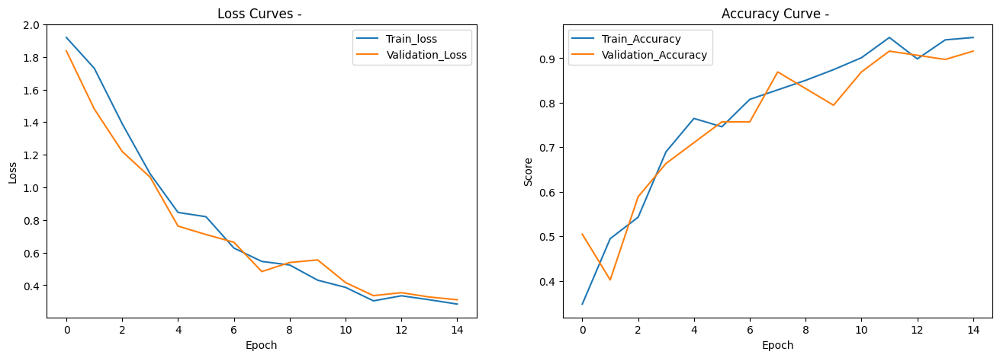

------------------------------ 
Best result on validation set -> Loss = 0.3801479587952296 Accuracy = 89.72 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.75), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.88      0.96      0.92        23
       bored       1.00      0.86      0.92        21
     disgust       0.75      1.00      0.86         6
        fear       1.00      0.80      0.89        15
       happy       0.80      0.75      0.77        16
     neutral       0.86      1.00      0.93        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.90       107
   macro avg       0.90      0.91      0.90       107
weighted avg       0.91      0.90      0.90       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.2749633549579552 Accuracy = 90.74 %
[('angry', 0.875), 

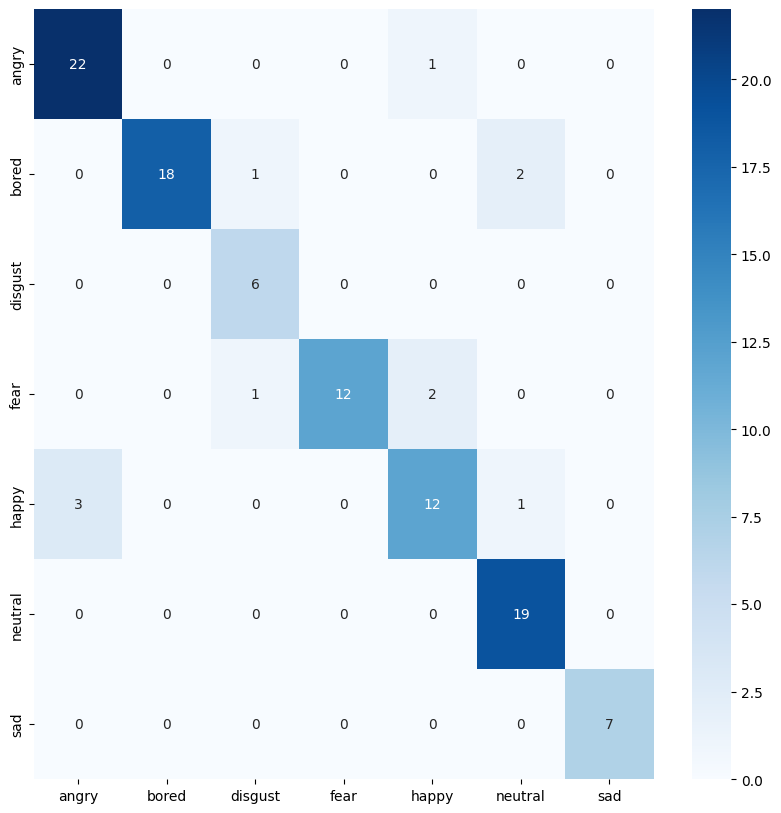

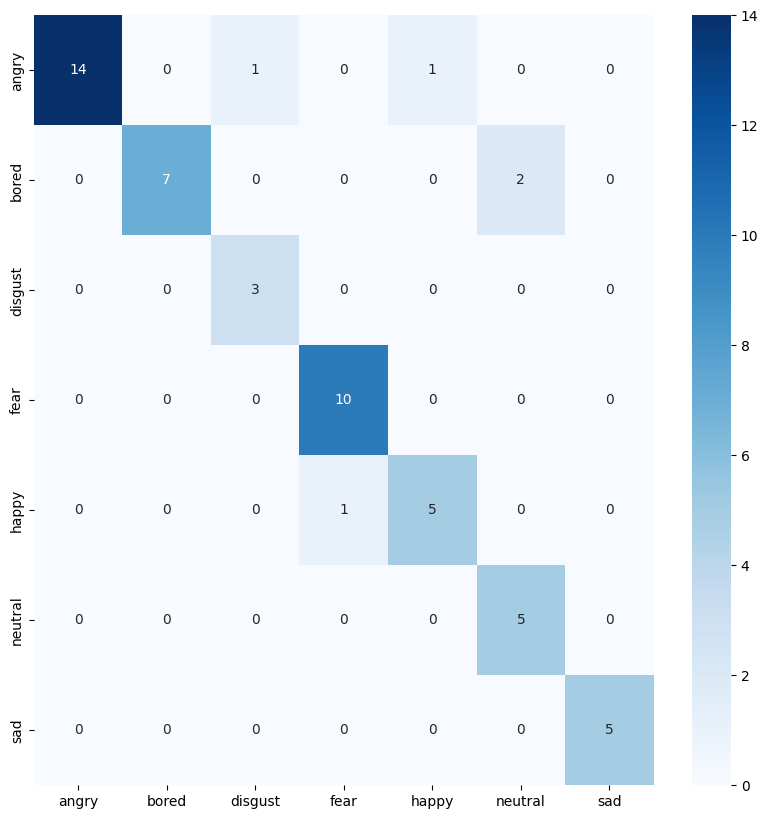

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-471b074a4f5077ee/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.8814 
[Epoch][Batch] = [1][19] -> Loss = 1.9461 
[Epoch][Batch] = [1][38] -> Loss = 1.9409 
[Epoch][Batch] = [1][57] -> Loss = 1.9406 
[Epoch][Batch] = [1][76] -> Loss = 1.9301 
best_acc  0.32710280373831774
	Train -> Loss = 1.9276 /  accuracy = 0.1631
	Validation -> Loss = 1.8932 /  accuracy = 0.3271
[Epoch][Batch] = [2][0] -> Loss = 1.8794 
[Epoch][Batch] = [2][19] -> Loss = 1.8747 
[Epoch][Batch] = [2][38] -> Loss = 1.8715

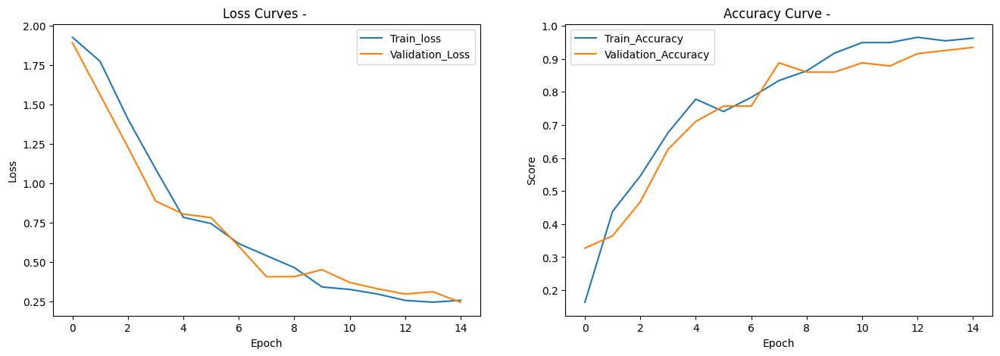

------------------------------ 
Best result on validation set -> Loss = 0.234578435205751 Accuracy = 95.33 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 1.0), ('disgust', 1.0), ('fear', 0.9333333333333333), ('happy', 0.8125), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.92      0.96      0.94        23
       bored       1.00      1.00      1.00        21
     disgust       1.00      1.00      1.00         6
        fear       1.00      0.93      0.97        15
       happy       0.87      0.81      0.84        16
     neutral       0.95      1.00      0.97        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.95       107
   macro avg       0.96      0.96      0.96       107
weighted avg       0.95      0.95      0.95       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.22600072569080762 Accuracy = 88.89 %
[('angry', 0.875)

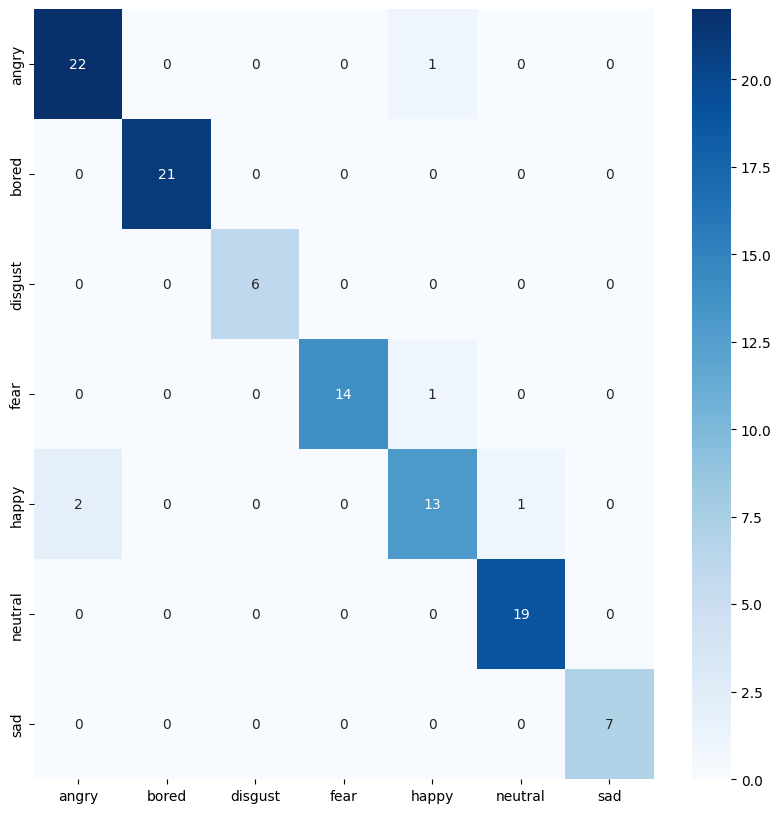

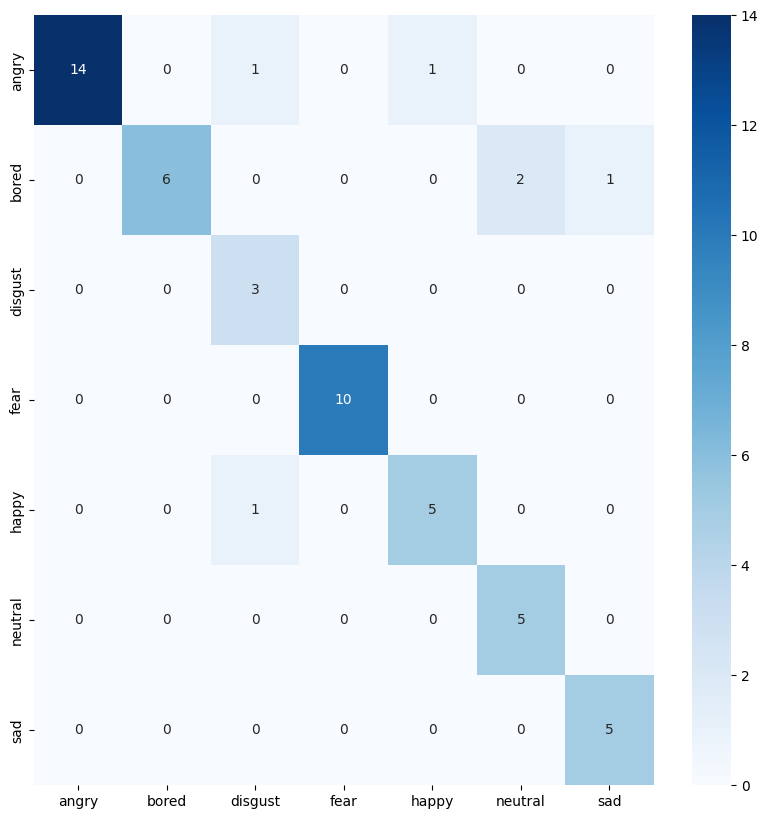

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-c11958c5110f0a42/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9088 
[Epoch][Batch] = [1][19] -> Loss = 1.9416 
[Epoch][Batch] = [1][38] -> Loss = 1.9376 
[Epoch][Batch] = [1][57] -> Loss = 1.9340 
[Epoch][Batch] = [1][76] -> Loss = 1.9259 
best_acc  0.37383177570093457
	Train -> Loss = 1.9201 /  accuracy = 0.3262
	Validation -> Loss = 1.8651 /  accuracy = 0.3738
[Epoch][Batch] = [2][0] -> Loss = 1.9161 
[Epoch][Batch] = [2][19] -> Loss = 1.8644 
[Epoch][Batch] = [2][38] -> Loss = 1.8475

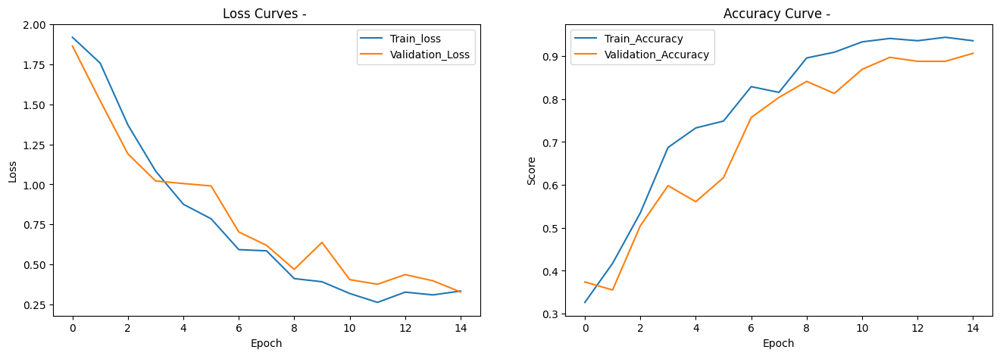

------------------------------ 
Best result on validation set -> Loss = 0.3285146476355968 Accuracy = 88.79 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.625), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.81      0.91      0.86        23
       bored       0.95      0.95      0.95        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.87      0.93        15
       happy       0.71      0.62      0.67        16
     neutral       0.95      0.95      0.95        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.89       107
   macro avg       0.90      0.90      0.90       107
weighted avg       0.89      0.89      0.89       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.13485803401895932 Accura

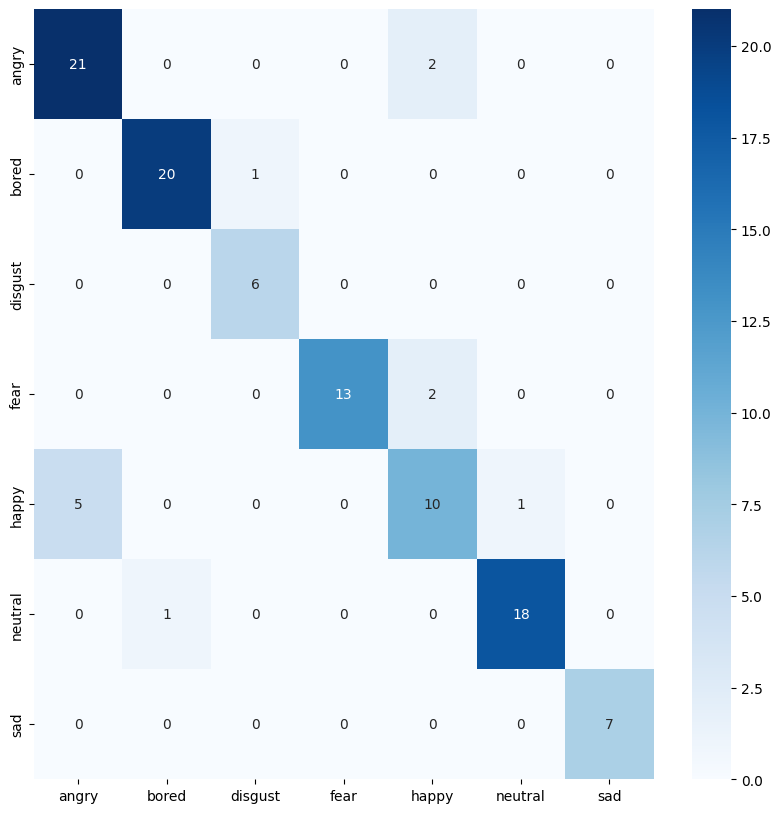

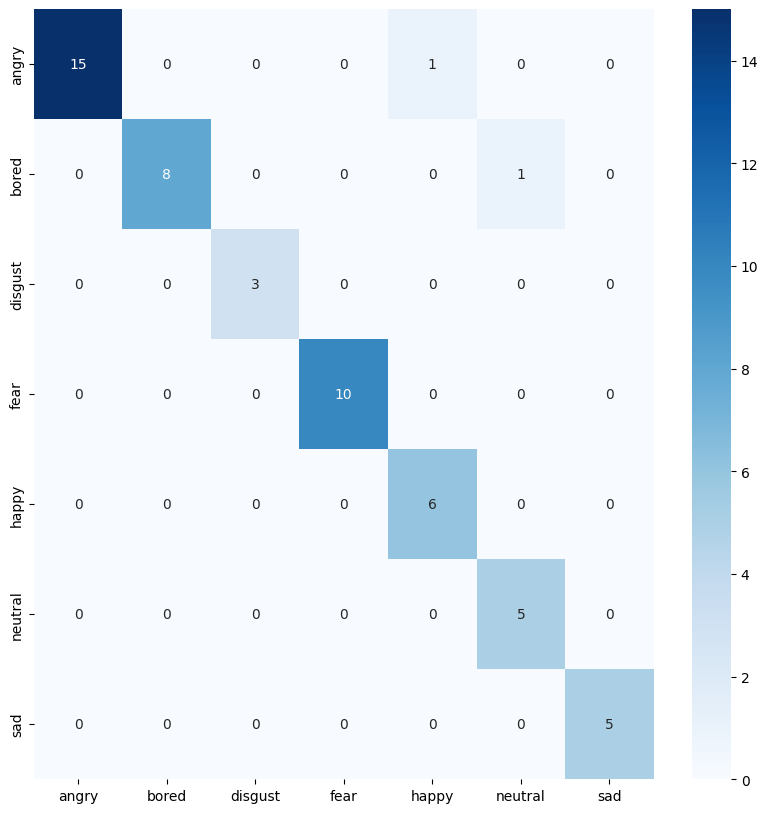

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-63f4dab3feda937c/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9549 
[Epoch][Batch] = [1][19] -> Loss = 1.9398 
[Epoch][Batch] = [1][38] -> Loss = 1.9384 
[Epoch][Batch] = [1][57] -> Loss = 1.9310 
[Epoch][Batch] = [1][76] -> Loss = 1.9278 
best_acc  0.4205607476635514
	Train -> Loss = 1.9193 /  accuracy = 0.2273
	Validation -> Loss = 1.8552 /  accuracy = 0.4206
[Epoch][Batch] = [2][0] -> Loss = 1.8524 
[Epoch][Batch] = [2][19] -> Loss = 1.8728 
[Epoch][Batch] = [2][38] -> Loss = 1.8338 

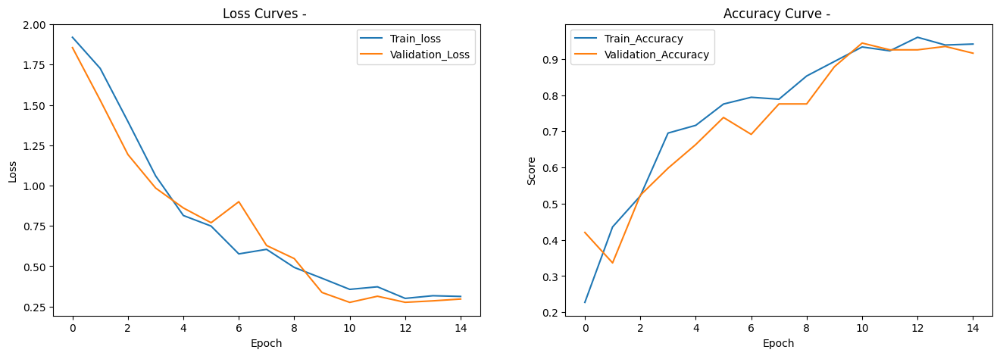

------------------------------ 
Best result on validation set -> Loss = 0.28039266555397596 Accuracy = 91.59 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 1.0), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.75), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.92      0.96      0.94        23
       bored       0.91      1.00      0.95        21
     disgust       1.00      1.00      1.00         6
        fear       0.93      0.87      0.90        15
       happy       0.80      0.75      0.77        16
     neutral       0.94      0.89      0.92        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.92       107
   macro avg       0.93      0.92      0.93       107
weighted avg       0.92      0.92      0.91       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.23895326309970447 Accuracy = 94.44 %
[(

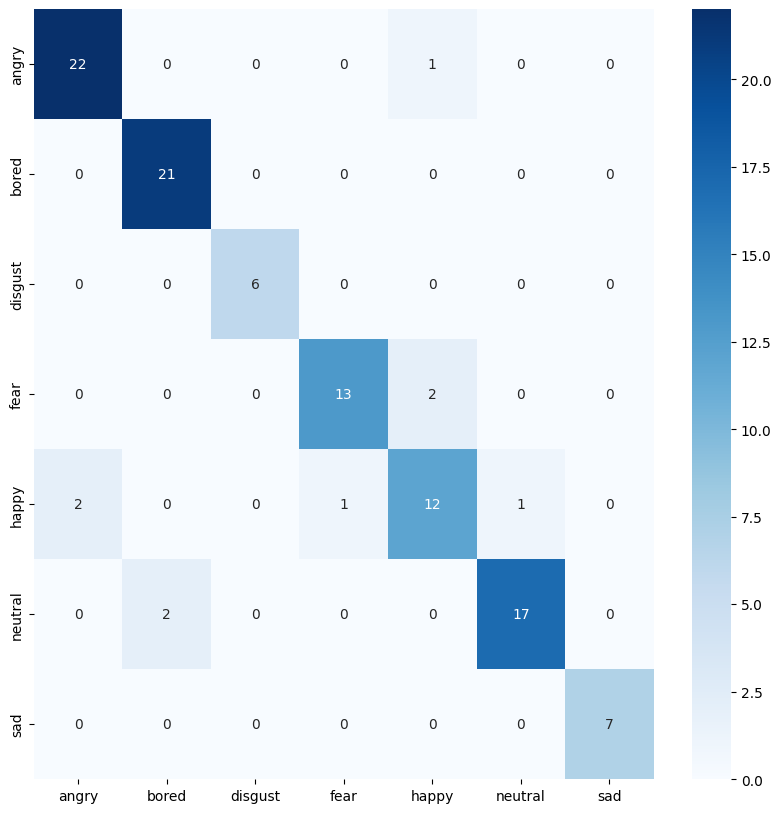

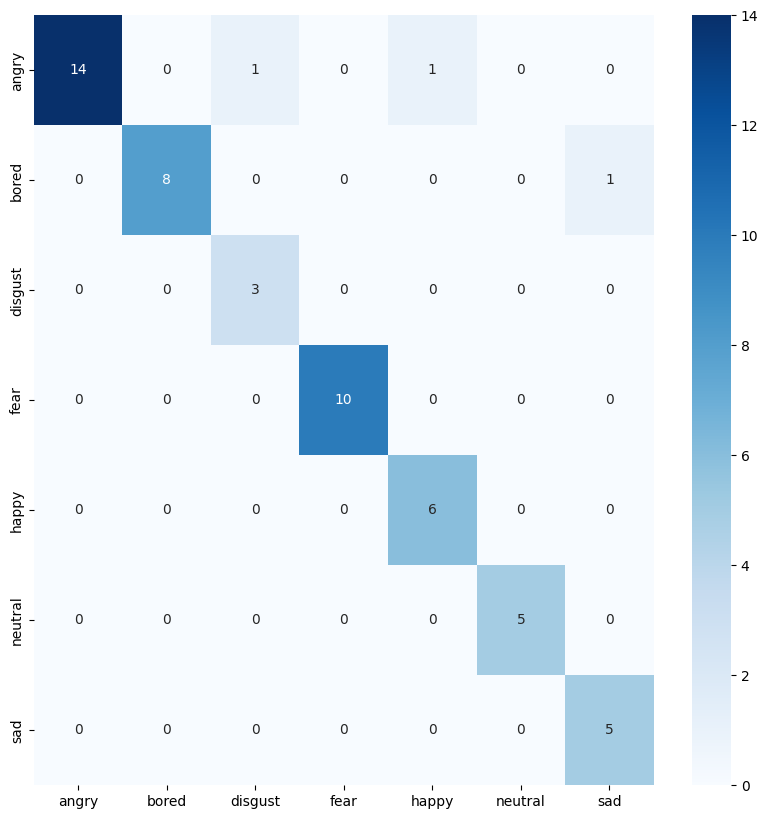

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-696f03809e75d28d/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0261 
[Epoch][Batch] = [1][19] -> Loss = 1.9412 
[Epoch][Batch] = [1][38] -> Loss = 1.9367 
[Epoch][Batch] = [1][57] -> Loss = 1.9317 
[Epoch][Batch] = [1][76] -> Loss = 1.9255 
best_acc  0.45794392523364486
	Train -> Loss = 1.9202 /  accuracy = 0.3048
	Validation -> Loss = 1.8544 /  accuracy = 0.4579
[Epoch][Batch] = [2][0] -> Loss = 1.8313 
[Epoch][Batch] = [2][19] -> Loss = 1.8665 
[Epoch][Batch] = [2][38] -> Loss = 1.8522

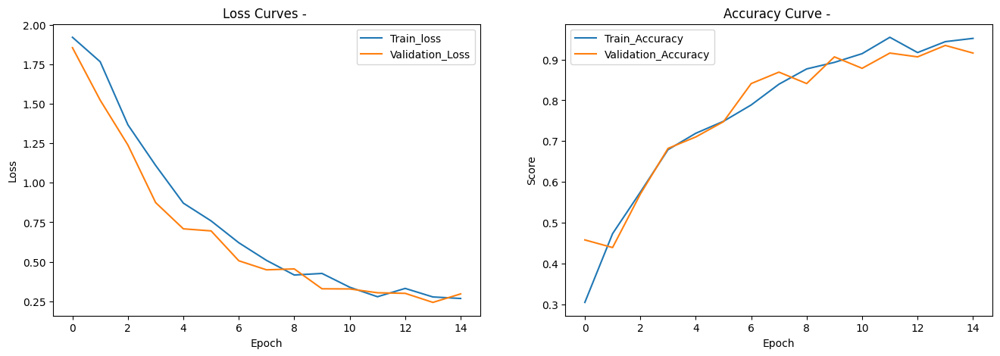

------------------------------ 
Best result on validation set -> Loss = 0.27572074932632623 Accuracy = 92.52 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 1.0), ('disgust', 1.0), ('fear', 0.9333333333333333), ('happy', 0.6875), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.88      0.96      0.92        23
       bored       0.95      1.00      0.98        21
     disgust       1.00      1.00      1.00         6
        fear       1.00      0.93      0.97        15
       happy       0.85      0.69      0.76        16
     neutral       0.90      0.95      0.92        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.93       107
   macro avg       0.94      0.93      0.93       107
weighted avg       0.92      0.93      0.92       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.2535117066332272 Accuracy = 92.59 %
[

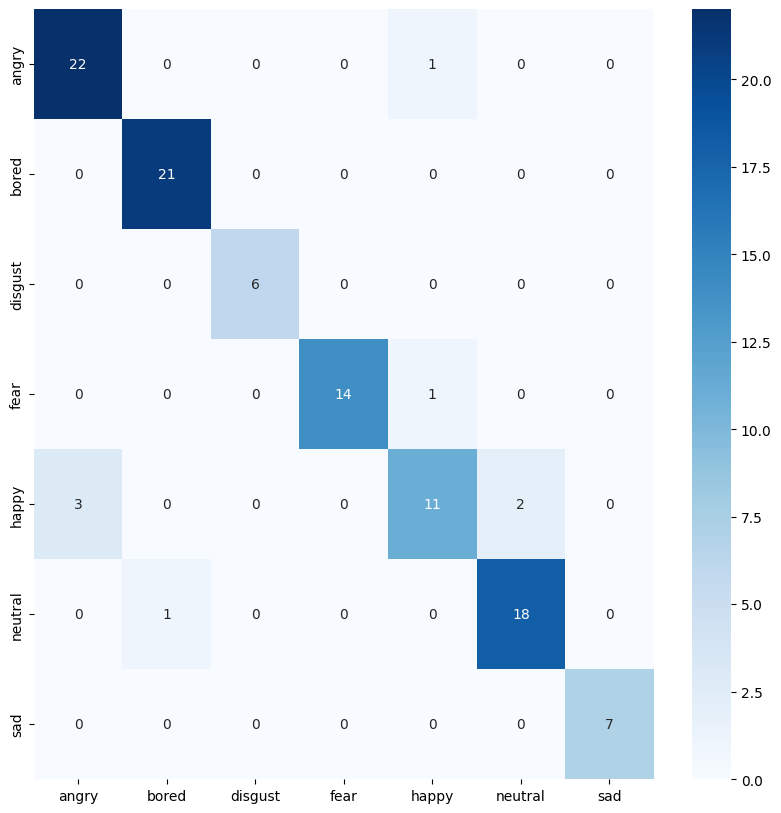

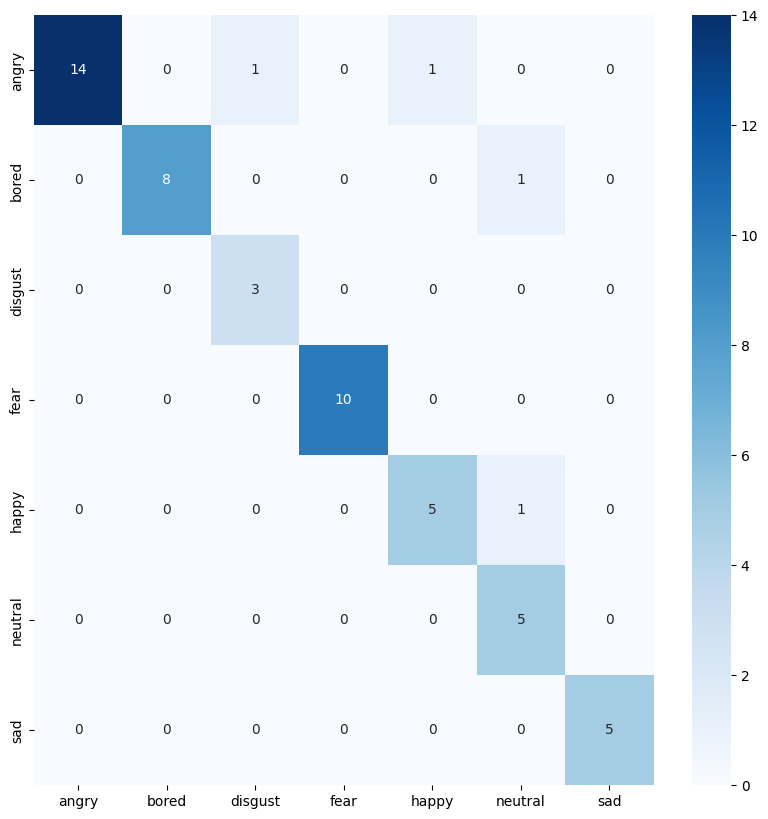

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
print(val_acc,sum(val_acc)/len(val_acc))
print(test_acc,sum(test_acc)/len(test_acc))

[0.897196261682243, 0.9532710280373832, 0.8878504672897196, 0.9158878504672897, 0.9252336448598131] 0.9158878504672897
[0.9074074074074074, 0.8888888888888888, 0.9629629629629629, 0.9444444444444444, 0.9259259259259259] 0.9259259259259258


In [ ]:
lst1=[0.9532710280373832, 0.897196261682243, 0.9345794392523364, 0.8785046728971962, 0.8598130841121495]
lst2=[0.9074074074074074, 0.9259259259259259, 0.9259259259259259, 0.9259259259259259, 0.9259259259259259]

print(sum(lst1)/len(lst1))
print(sum(lst2)/len(lst2))

0.9046728971962616
0.9222222222222223


In [ ]:
val_acc=[]
test_acc=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-17395d79c989c840/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9726 
[Epoch][Batch] = [1][19] -> Loss = 1.9343 
[Epoch][Batch] = [1][38] -> Loss = 1.9332 
[Epoch][Batch] = [1][57] -> Loss = 1.9307 
[Epoch][Batch] = [1][76] -> Loss = 1.9263 
best_acc  0.4485981308411215
	Train -> Loss = 1.9208 /  accuracy = 0.2139
	Validation -> Loss = 1.8632 /  accuracy = 0.4486
[Epoch][Batch] = [2][0] -> Loss = 1.9102 
[Epoch][Batch] = [2][19] -> Loss = 1.8618 
[Epoch][Batch] = [2][38] -> Loss = 1.8413 

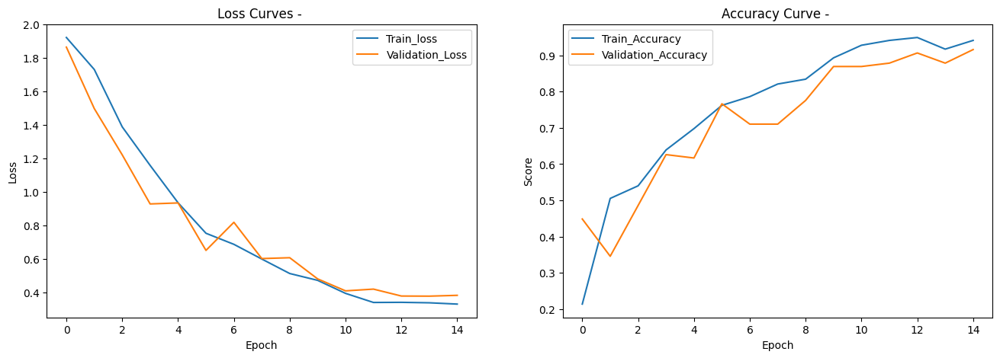

------------------------------ 
Best result on validation set -> Loss = 0.35467454239174173 Accuracy = 90.65 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.875), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.95      0.91      0.93        23
       bored       1.00      0.90      0.95        21
     disgust       0.75      1.00      0.86         6
        fear       1.00      0.73      0.85        15
       happy       0.74      0.88      0.80        16
     neutral       0.90      1.00      0.95        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.91       107
   macro avg       0.91      0.92      0.91       107
weighted avg       0.92      0.91      0.91       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.24220574381096022 Accuracy = 92.59 %
[

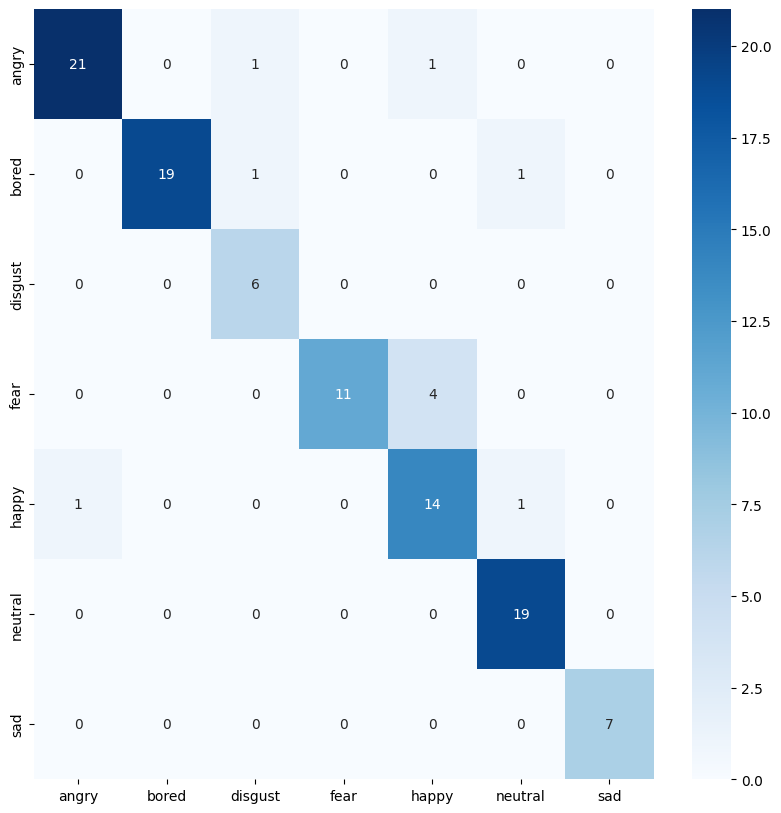

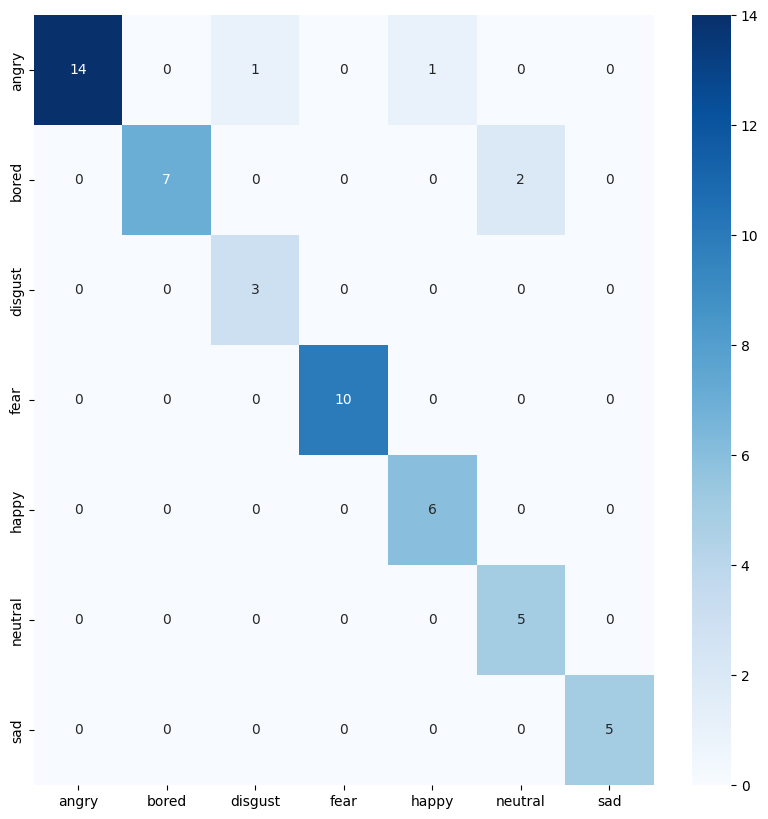

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-0b6ef75c7daf6375/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9643 
[Epoch][Batch] = [1][19] -> Loss = 1.9385 
[Epoch][Batch] = [1][38] -> Loss = 1.9364 
[Epoch][Batch] = [1][57] -> Loss = 1.9365 
[Epoch][Batch] = [1][76] -> Loss = 1.9321 
best_acc  0.40186915887850466
	Train -> Loss = 1.9246 /  accuracy = 0.2674
	Validation -> Loss = 1.8722 /  accuracy = 0.4019
[Epoch][Batch] = [2][0] -> Loss = 1.8525 
[Epoch][Batch] = [2][19] -> Loss = 1.8781 
[Epoch][Batch] = [2][38] -> Loss = 1.8598

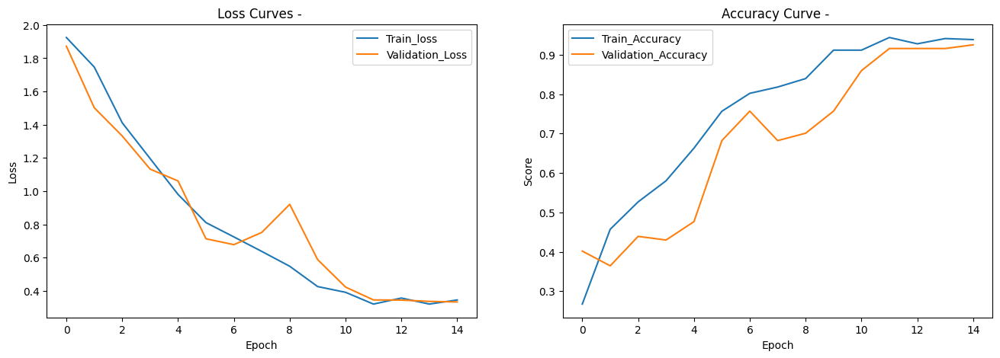

------------------------------ 
Best result on validation set -> Loss = 0.34073204933493223 Accuracy = 90.65 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.6666666666666666), ('happy', 0.875), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.96      0.96      0.96        23
       bored       0.95      0.95      0.95        21
     disgust       1.00      1.00      1.00         6
        fear       1.00      0.67      0.80        15
       happy       0.70      0.88      0.78        16
     neutral       0.95      0.95      0.95        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.91       107
   macro avg       0.92      0.91      0.91       107
weighted avg       0.92      0.91      0.91       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.23996750425015176 Accur

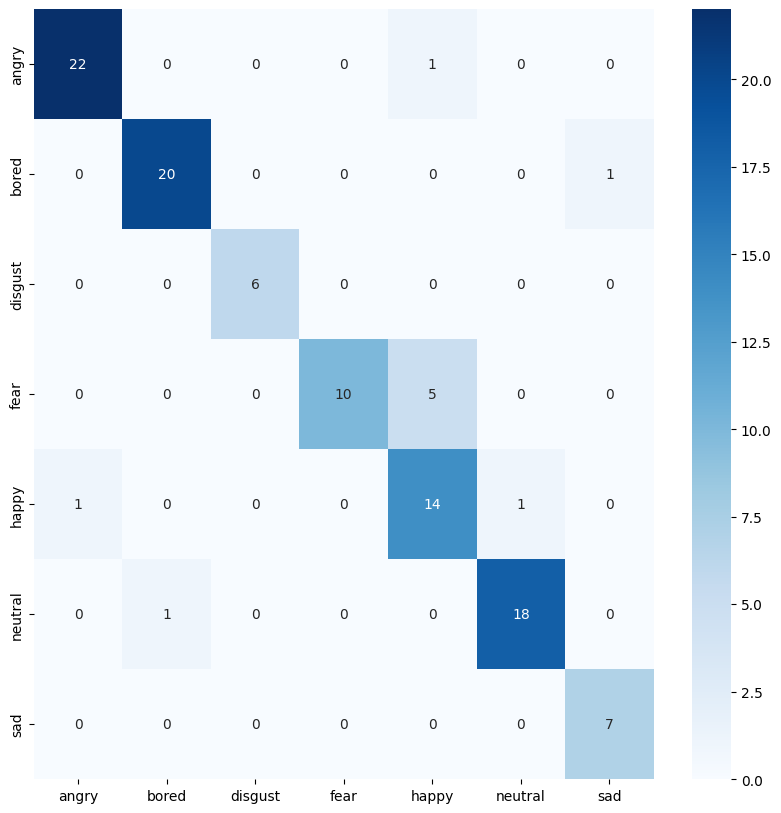

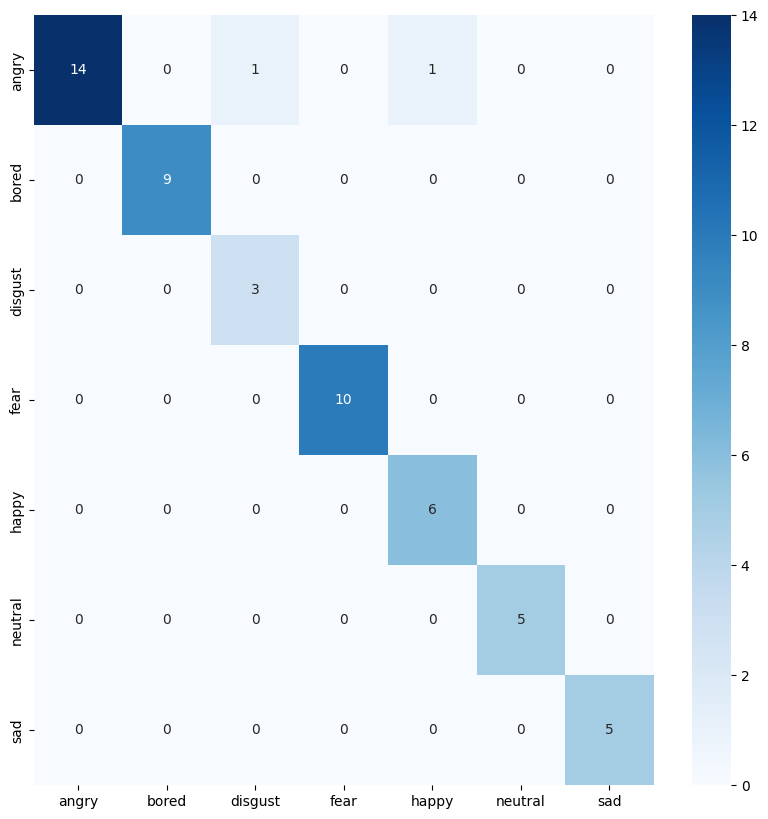

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ecc37e6fb7c48fce/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9817 
[Epoch][Batch] = [1][19] -> Loss = 1.9544 
[Epoch][Batch] = [1][38] -> Loss = 1.9373 
[Epoch][Batch] = [1][57] -> Loss = 1.9363 
[Epoch][Batch] = [1][76] -> Loss = 1.9290 
best_acc  0.34579439252336447
	Train -> Loss = 1.9263 /  accuracy = 0.2406
	Validation -> Loss = 1.8707 /  accuracy = 0.3458
[Epoch][Batch] = [2][0] -> Loss = 1.8989 
[Epoch][Batch] = [2][19] -> Loss = 1.8684 
[Epoch][Batch] = [2][38] -> Loss = 1.8566

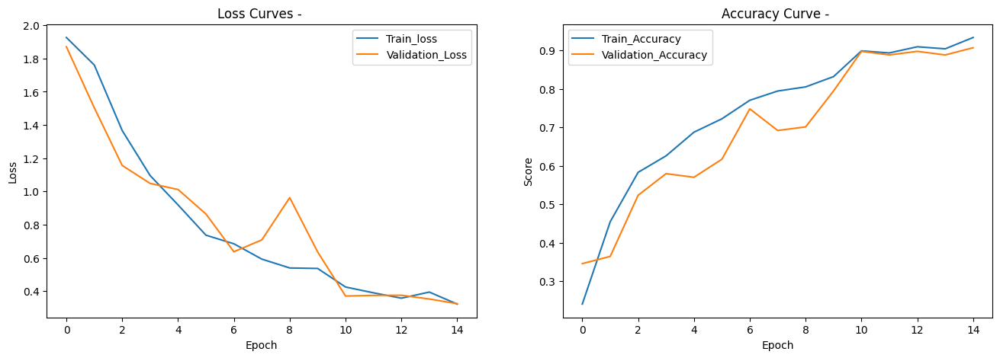

------------------------------ 
Best result on validation set -> Loss = 0.30879721569794194 Accuracy = 91.59 %
Validation Report
[('angry', 1.0), ('bored', 0.8095238095238095), ('disgust', 1.0), ('fear', 0.9333333333333333), ('happy', 0.8125), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.96      1.00      0.98        23
       bored       0.94      0.81      0.87        21
     disgust       1.00      1.00      1.00         6
        fear       0.93      0.93      0.93        15
       happy       0.93      0.81      0.87        16
     neutral       0.86      0.95      0.90        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.92       107
   macro avg       0.91      0.93      0.92       107
weighted avg       0.92      0.92      0.92       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.37021011859178543 Accuracy = 87.04 %


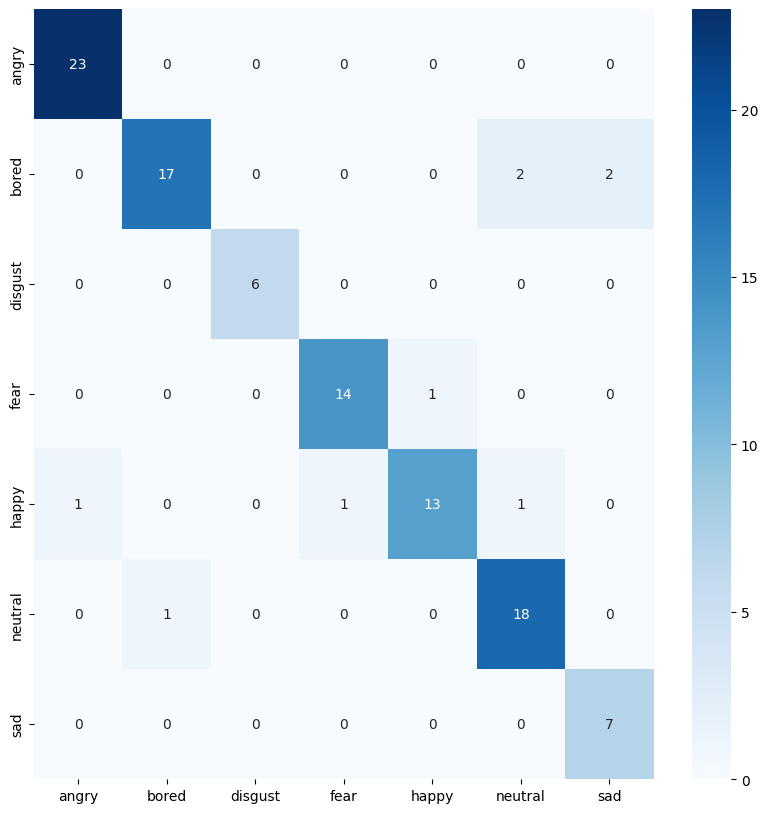

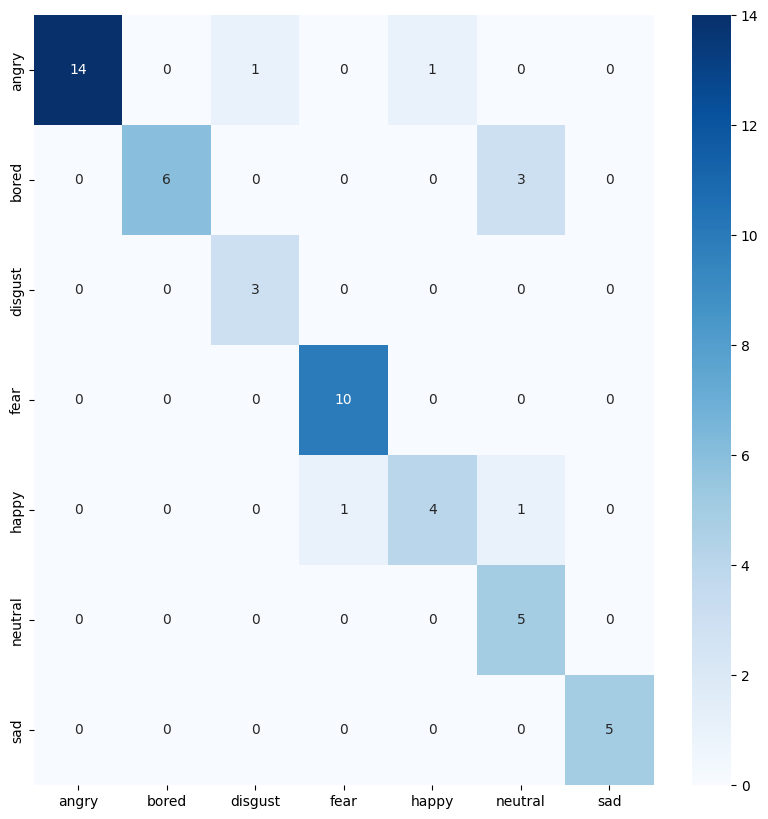

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-9d1989f3a1a278e9/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9331 
[Epoch][Batch] = [1][19] -> Loss = 1.9395 
[Epoch][Batch] = [1][38] -> Loss = 1.9409 
[Epoch][Batch] = [1][57] -> Loss = 1.9381 
[Epoch][Batch] = [1][76] -> Loss = 1.9300 
best_acc  0.4953271028037383
	Train -> Loss = 1.9236 /  accuracy = 0.2219
	Validation -> Loss = 1.8406 /  accuracy = 0.4953
[Epoch][Batch] = [2][0] -> Loss = 1.8689 
[Epoch][Batch] = [2][19] -> Loss = 1.8813 
[Epoch][Batch] = [2][38] -> Loss = 1.8475 

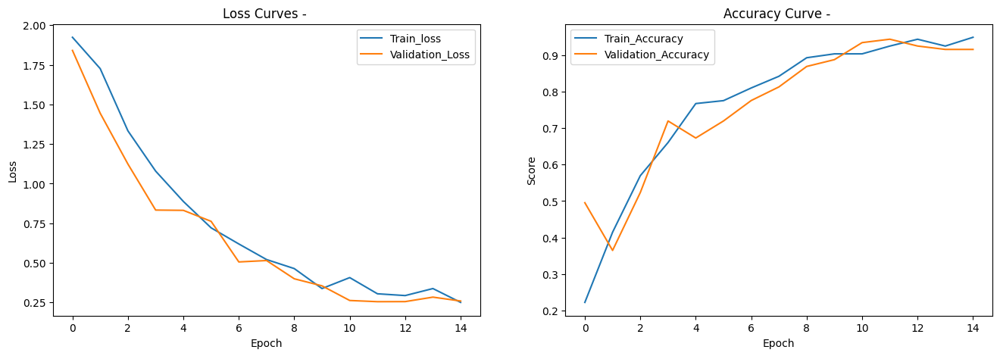

------------------------------ 
Best result on validation set -> Loss = 0.2626470604704486 Accuracy = 92.52 %
Validation Report
[('angry', 1.0), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.9333333333333333), ('happy', 0.6875), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.82      1.00      0.90        23
       bored       1.00      0.90      0.95        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.93      0.97        15
       happy       0.92      0.69      0.79        16
     neutral       1.00      1.00      1.00        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.93       107
   macro avg       0.92      0.93      0.92       107
weighted avg       0.93      0.93      0.92       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.23700563503163202 Accuracy = 92.59 %
[('angry', 0.875

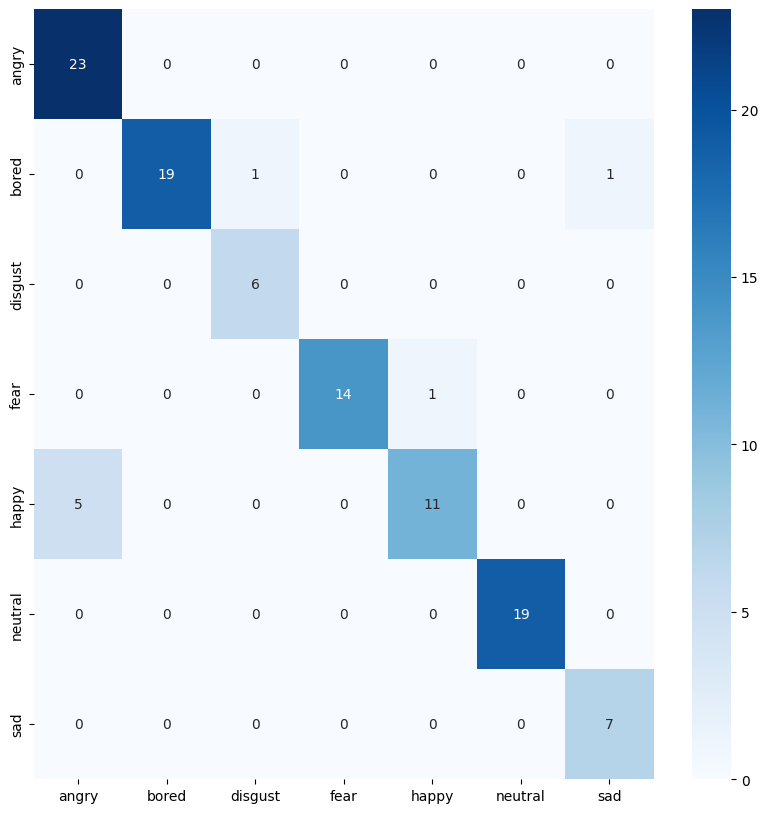

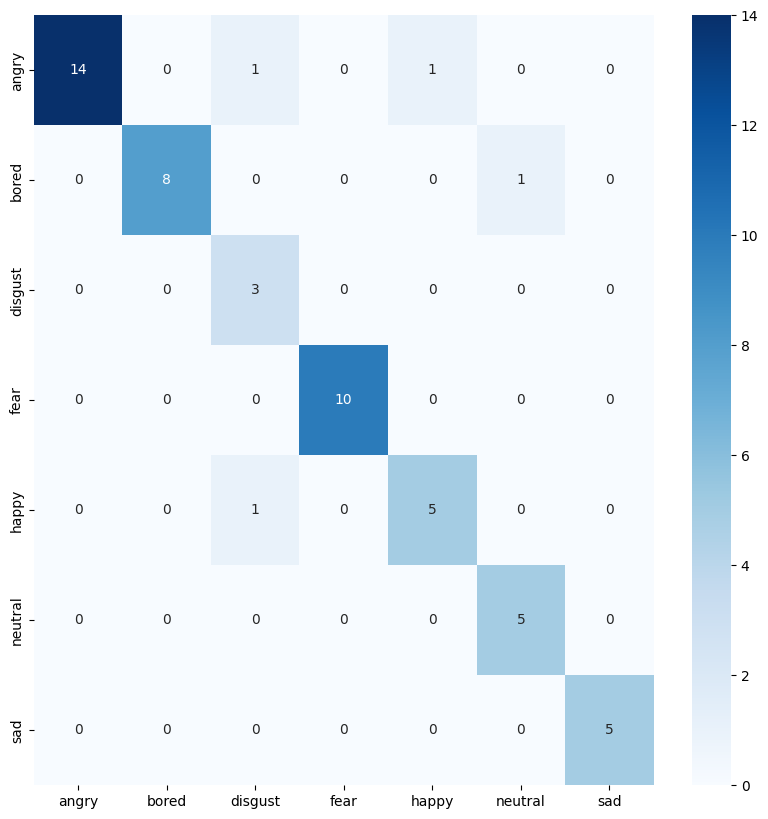

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-a08d800a73fff8d8/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9333 
[Epoch][Batch] = [1][19] -> Loss = 1.9397 
[Epoch][Batch] = [1][38] -> Loss = 1.9401 
[Epoch][Batch] = [1][57] -> Loss = 1.9303 
[Epoch][Batch] = [1][76] -> Loss = 1.9244 
best_acc  0.5514018691588785
	Train -> Loss = 1.9162 /  accuracy = 0.3342
	Validation -> Loss = 1.8281 /  accuracy = 0.5514
[Epoch][Batch] = [2][0] -> Loss = 1.8355 
[Epoch][Batch] = [2][19] -> Loss = 1.8475 
[Epoch][Batch] = [2][38] -> Loss = 1.8174 

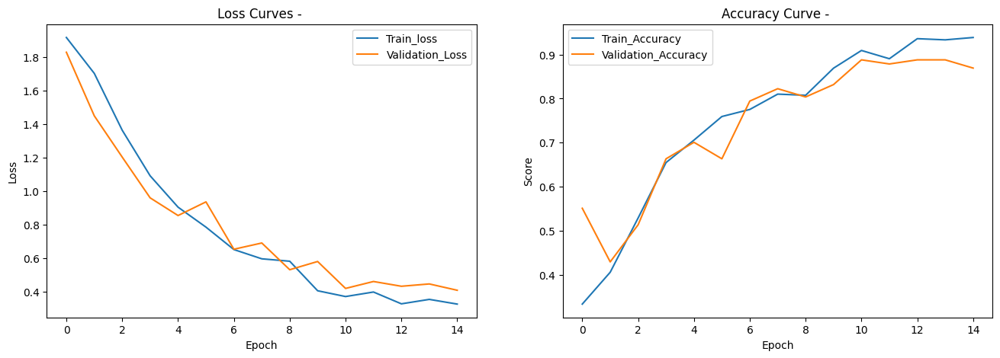

------------------------------ 
Best result on validation set -> Loss = 0.4429803411993716 Accuracy = 87.85 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.8125), ('neutral', 0.7894736842105263), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.92      0.96      0.94        23
       bored       0.82      0.86      0.84        21
     disgust       0.75      1.00      0.86         6
        fear       1.00      0.87      0.93        15
       happy       0.93      0.81      0.87        16
     neutral       0.88      0.79      0.83        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.88       107
   macro avg       0.87      0.90      0.88       107
weighted avg       0.89      0.88      0.88       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.34058337073240963 Accur

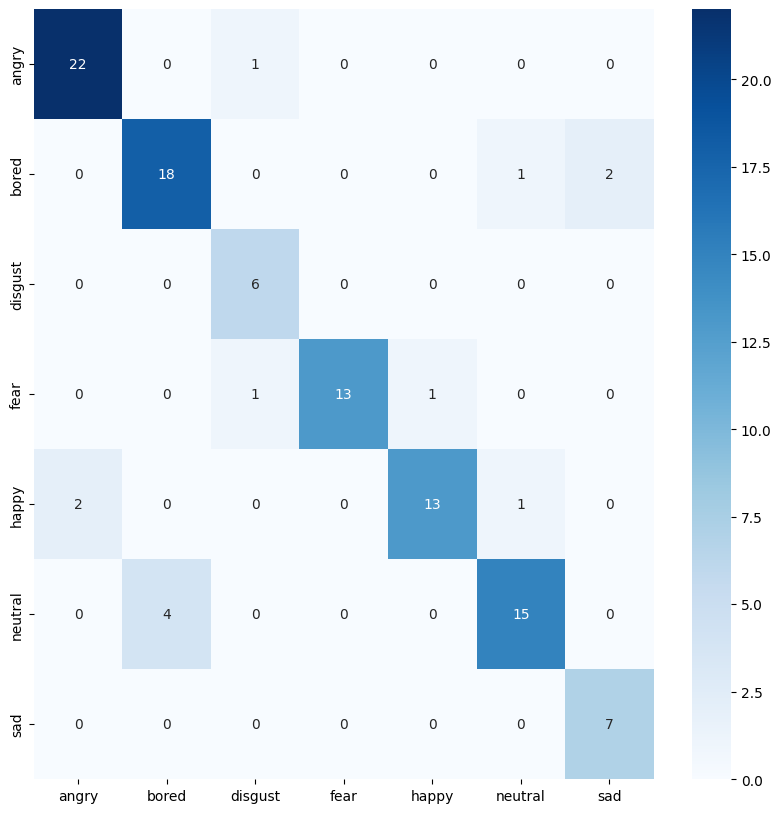

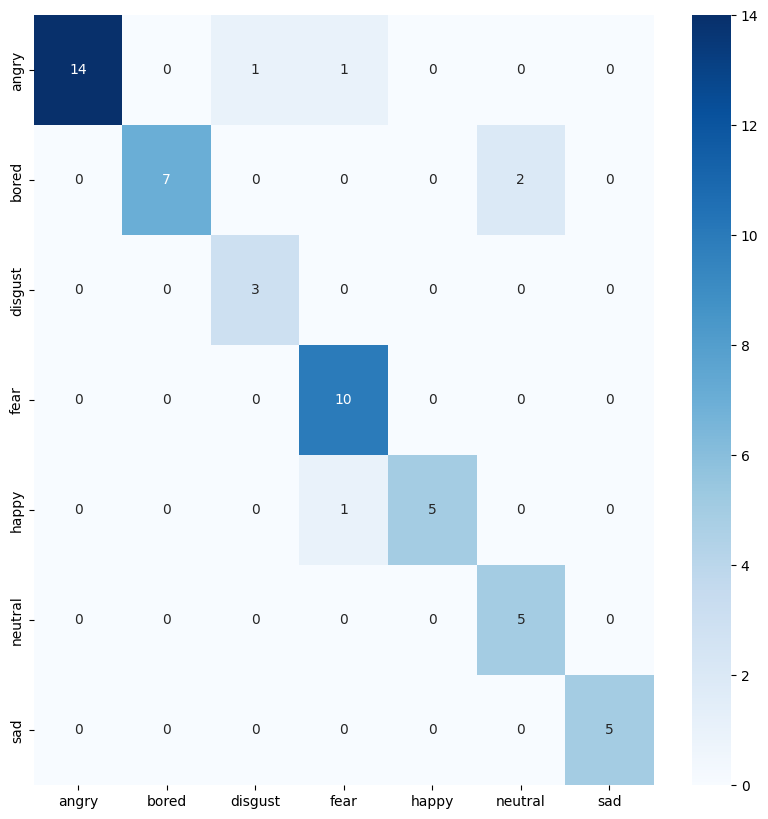

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
print(val_acc)
print(sum(val_acc)/len(val_acc))
print(test_acc,sum(test_acc)/len(test_acc))
print(sum(test_acc)/len(test_acc))

[0.897196261682243, 0.897196261682243, 0.9065420560747663, 0.8691588785046729, 0.8785046728971962] 0.8897196261682243
[0.9074074074074074, 0.9074074074074074, 0.8888888888888888, 0.9074074074074074, 0.9259259259259259] 0.9074074074074074


----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-e46bd690f3ad0697/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9662 
[Epoch][Batch] = [1][19] -> Loss = 1.9523 
[Epoch][Batch] = [1][38] -> Loss = 1.9430 
[Epoch][Batch] = [1][57] -> Loss = 1.9430 
[Epoch][Batch] = [1][76] -> Loss = 1.9396 
best_acc  0.37383177570093457
	Train -> Loss = 1.9317 /  accuracy = 0.2513
	Validation -> Loss = 1.8753 /  accuracy = 0.3738
[Epoch][Batch] = [2][0] -> Loss = 1.8179 
[Epoch][Batch] = [2][19] -> Loss = 1.8736 
[Epoch][Batch] = [2][38] -> Loss = 1.8690

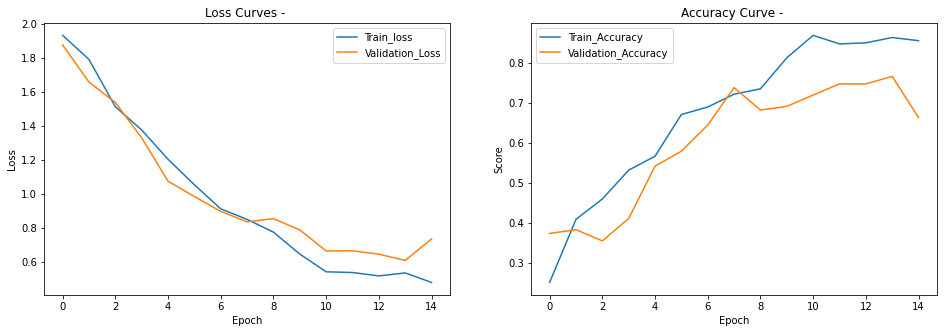

------------------------------ 
Best result on validation set -> Loss = 0.6283952971851384 Accuracy = 75.70 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.8095238095238095), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.25), ('neutral', 0.7368421052631579), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.69      0.96      0.80        23
       bored       0.77      0.81      0.79        21
     disgust       0.60      1.00      0.75         6
        fear       0.92      0.73      0.81        15
       happy       0.50      0.25      0.33        16
     neutral       0.88      0.74      0.80        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.76       107
   macro avg       0.76      0.78      0.76       107
weighted avg       0.76      0.76      0.74       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.4997006601520947 Accuracy

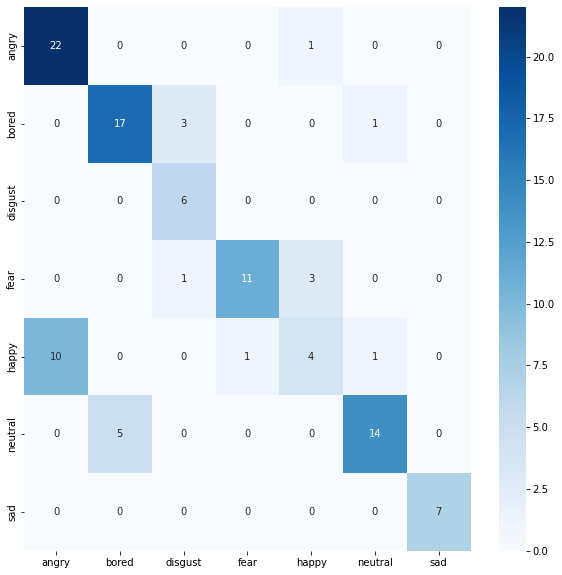

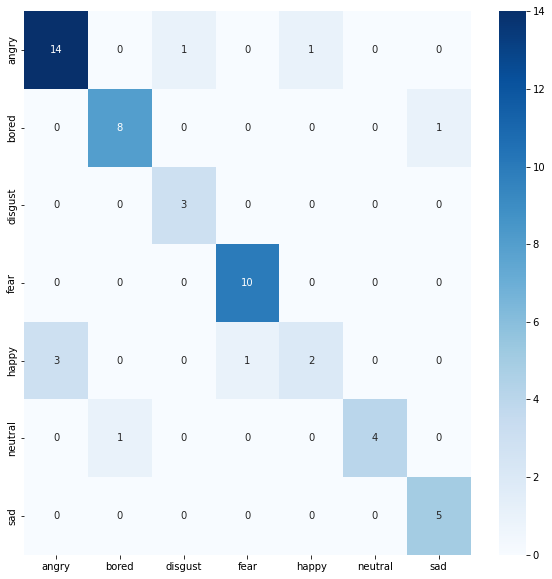

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_20"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-d80e1dc23890ddc8/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9851 
[Epoch][Batch] = [1][19] -> Loss = 1.9495 
[Epoch][Batch] = [1][38] -> Loss = 1.9390 
[Epoch][Batch] = [1][57] -> Loss = 1.9332 
[Epoch][Batch] = [1][76] -> Loss = 1.9288 
best_acc  0.2897196261682243
	Train -> Loss = 1.9232 /  accuracy = 0.2406
	Validation -> Loss = 1.8414 /  accuracy = 0.2897
[Epoch][Batch] = [2][0] -> Loss = 1.8818 
[Epoch][Batch] = [2][19] -> Loss = 1.8610 
[Epoch][Batch] = [2][38] -> Loss = 1.8369 

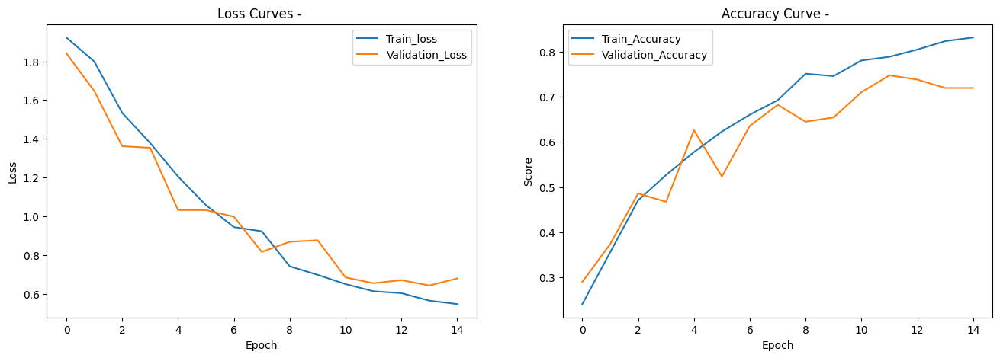

------------------------------ 
Best result on validation set -> Loss = 0.6784177036197098 Accuracy = 74.77 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.7619047619047619), ('disgust', 0.8333333333333334), ('fear', 0.6666666666666666), ('happy', 0.25), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.70      0.91      0.79        23
       bored       0.89      0.76      0.82        21
     disgust       0.71      0.83      0.77         6
        fear       0.71      0.67      0.69        15
       happy       0.67      0.25      0.36        16
     neutral       0.77      0.89      0.83        19
         sad       0.70      1.00      0.82         7

    accuracy                           0.75       107
   macro avg       0.74      0.76      0.73       107
weighted avg       0.75      0.75      0.73       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.4490000946

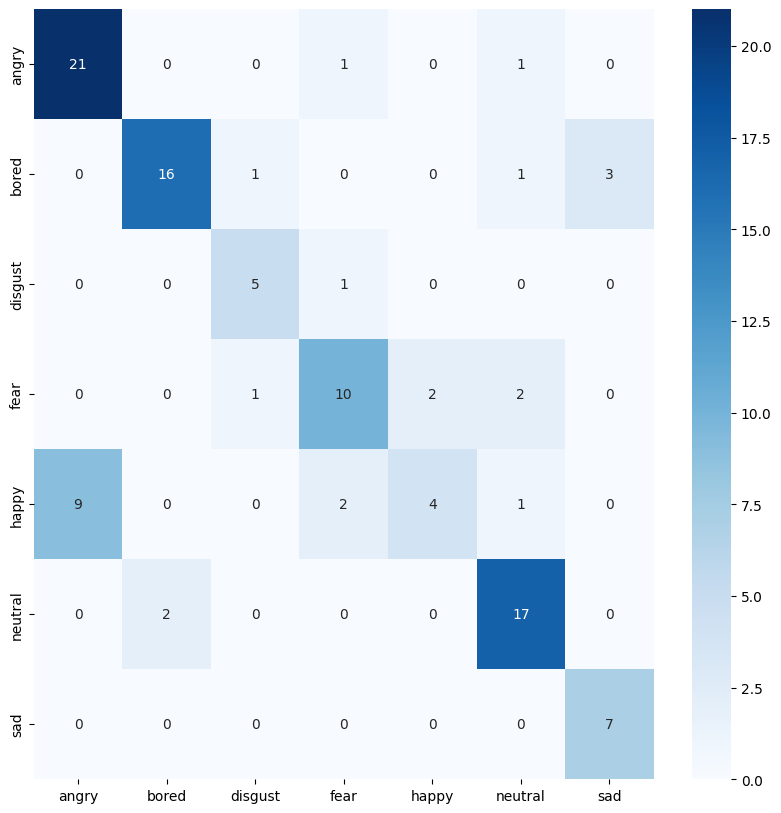

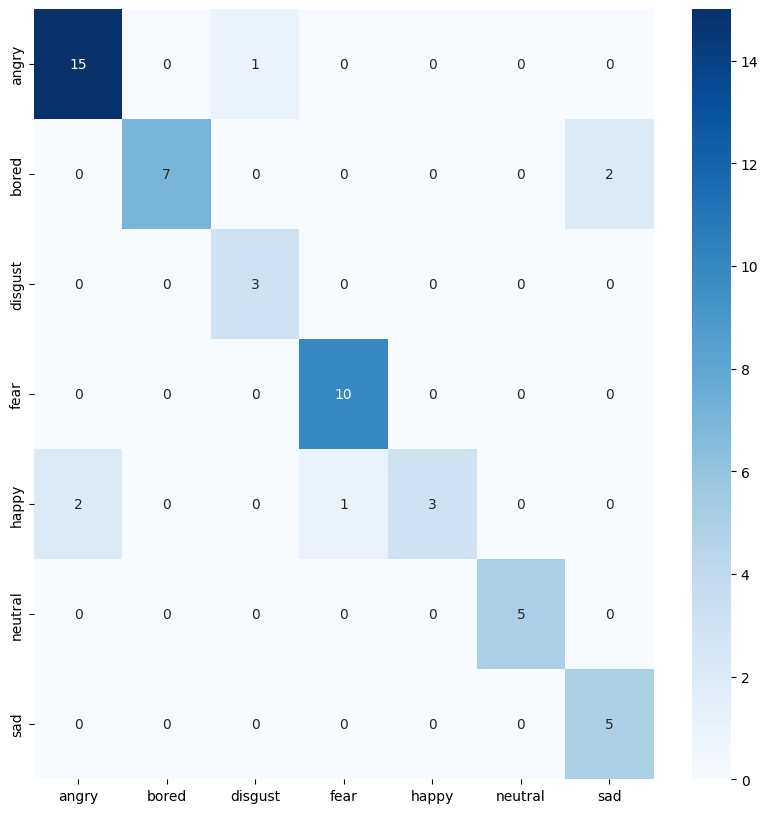

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_20"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-33f48a090806a47e/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9461 
[Epoch][Batch] = [1][19] -> Loss = 1.9462 
[Epoch][Batch] = [1][38] -> Loss = 1.9405 
[Epoch][Batch] = [1][57] -> Loss = 1.9377 
[Epoch][Batch] = [1][76] -> Loss = 1.9339 
best_acc  0.45794392523364486
	Train -> Loss = 1.9260 /  accuracy = 0.2647
	Validation -> Loss = 1.8627 /  accuracy = 0.4579
[Epoch][Batch] = [2][0] -> Loss = 1.8917 
[Epoch][Batch] = [2][19] -> Loss = 1.8907 
[Epoch][Batch] = [2][38] -> Loss = 1.8650

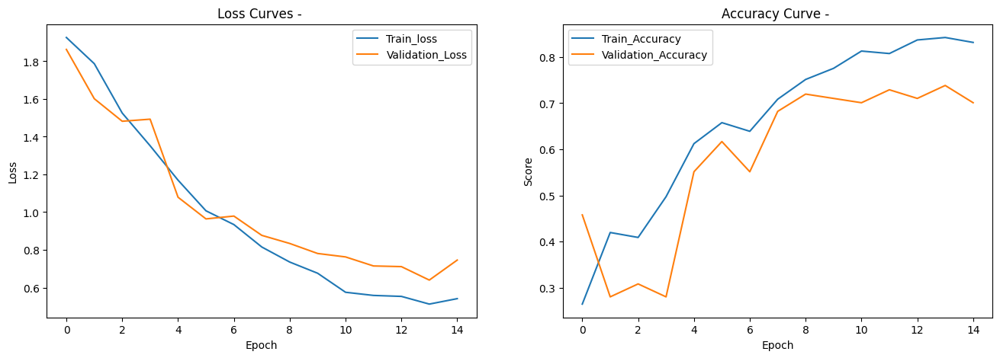

------------------------------ 
Best result on validation set -> Loss = 0.6292774660719765 Accuracy = 74.77 %
Validation Report
[('angry', 0.8695652173913043), ('bored', 0.8095238095238095), ('disgust', 1.0), ('fear', 0.6), ('happy', 0.3125), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.69      0.87      0.77        23
       bored       0.85      0.81      0.83        21
     disgust       0.75      1.00      0.86         6
        fear       0.82      0.60      0.69        15
       happy       0.50      0.31      0.38        16
     neutral       0.80      0.84      0.82        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.75       107
   macro avg       0.74      0.78      0.75       107
weighted avg       0.74      0.75      0.73       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.47119422097291264 Accuracy = 81.48 %
[

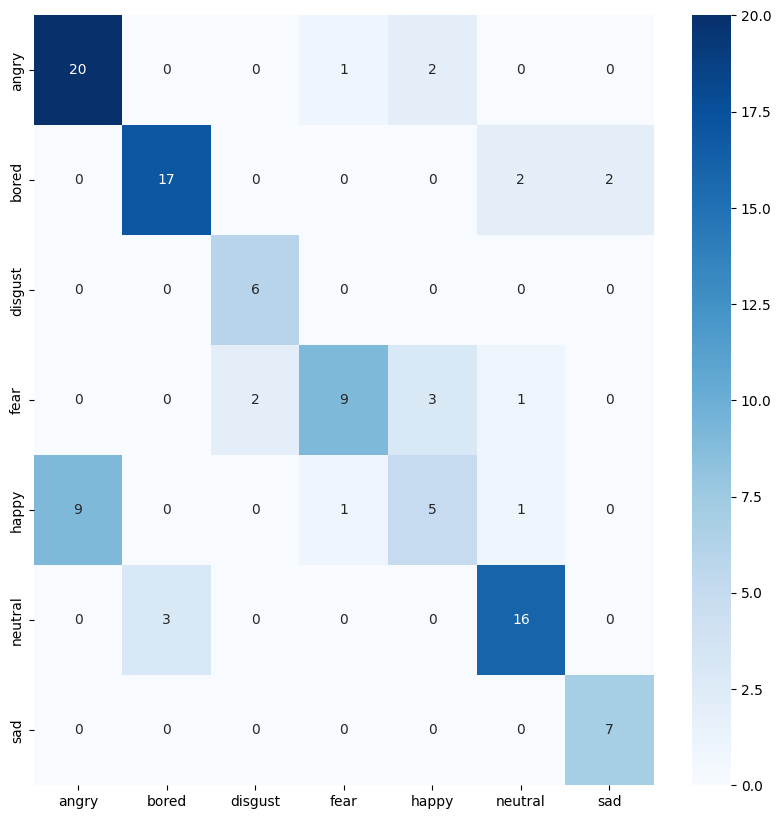

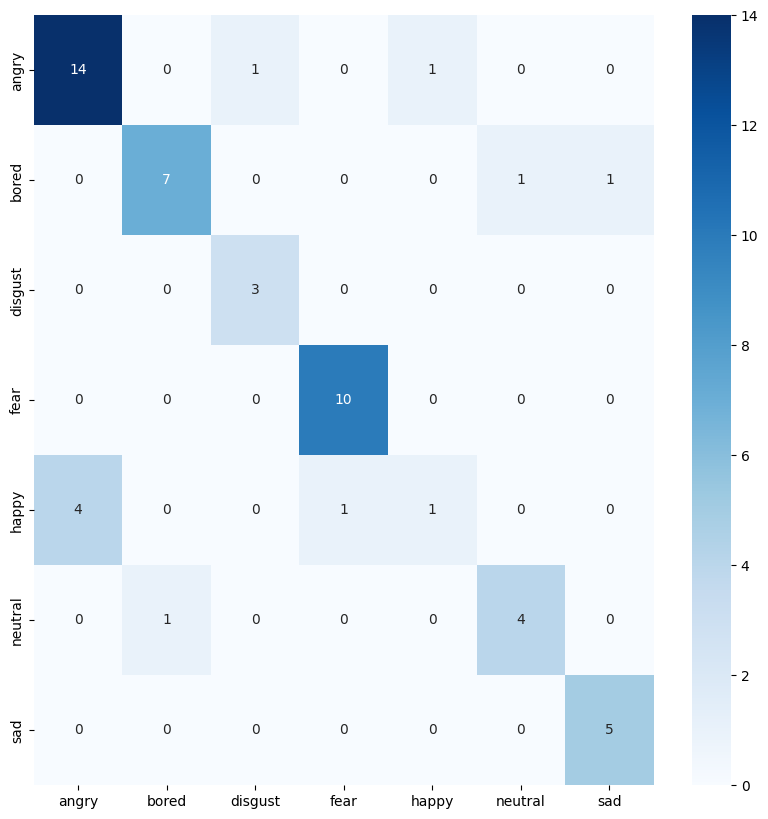

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_20"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-758836352ff3c36f/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9618 
[Epoch][Batch] = [1][19] -> Loss = 1.9517 
[Epoch][Batch] = [1][38] -> Loss = 1.9429 
[Epoch][Batch] = [1][57] -> Loss = 1.9328 
[Epoch][Batch] = [1][76] -> Loss = 1.9227 
best_acc  0.4485981308411215
	Train -> Loss = 1.9162 /  accuracy = 0.2460
	Validation -> Loss = 1.8357 /  accuracy = 0.4486
[Epoch][Batch] = [2][0] -> Loss = 1.8246 
[Epoch][Batch] = [2][19] -> Loss = 1.8817 
[Epoch][Batch] = [2][38] -> Loss = 1.8412 

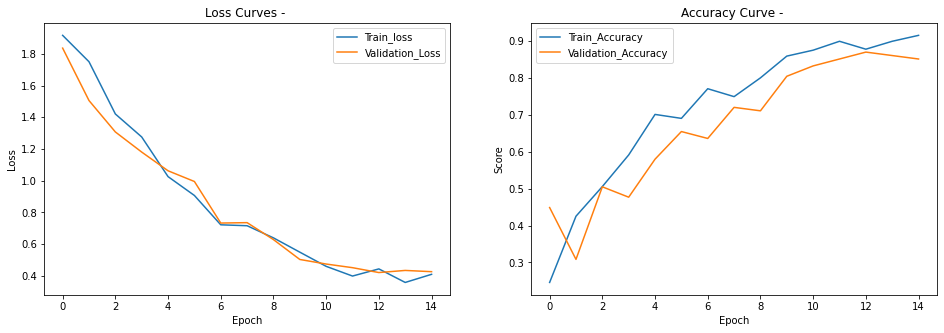

------------------------------ 
Best result on validation set -> Loss = 0.4452355995222374 Accuracy = 85.05 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.5), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.78      0.91      0.84        23
       bored       1.00      0.86      0.92        21
     disgust       0.86      1.00      0.92         6
        fear       0.92      0.80      0.86        15
       happy       0.73      0.50      0.59        16
     neutral       0.83      1.00      0.90        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.85       107
   macro avg       0.86      0.87      0.85       107
weighted avg       0.85      0.85      0.84       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.33037274117980686 Accuracy = 94.44 %
[('angry', 0.875), 

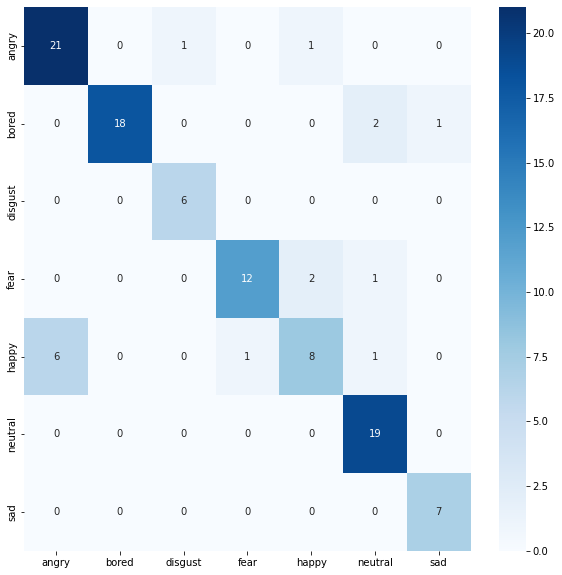

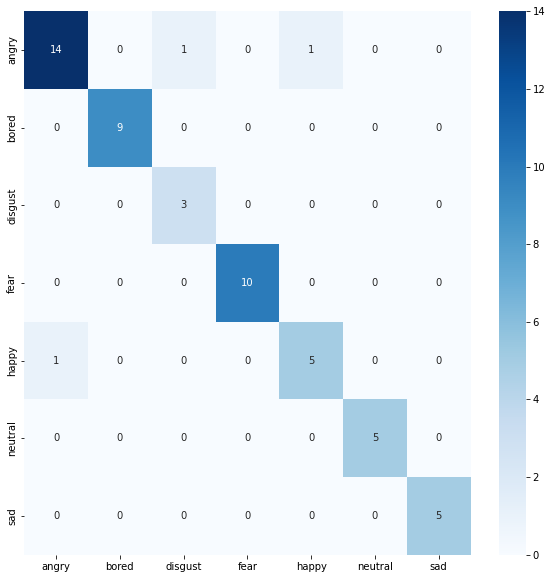

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_25"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-a736ba8e268acabb/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9214 
[Epoch][Batch] = [1][19] -> Loss = 1.9407 
[Epoch][Batch] = [1][38] -> Loss = 1.9428 
[Epoch][Batch] = [1][57] -> Loss = 1.9350 
[Epoch][Batch] = [1][76] -> Loss = 1.9256 
best_acc  0.37383177570093457
	Train -> Loss = 1.9201 /  accuracy = 0.1925
	Validation -> Loss = 1.8538 /  accuracy = 0.3738
[Epoch][Batch] = [2][0] -> Loss = 1.8070 
[Epoch][Batch] = [2][19] -> Loss = 1.8041 
[Epoch][Batch] = [2][38] -> Loss = 1.7961

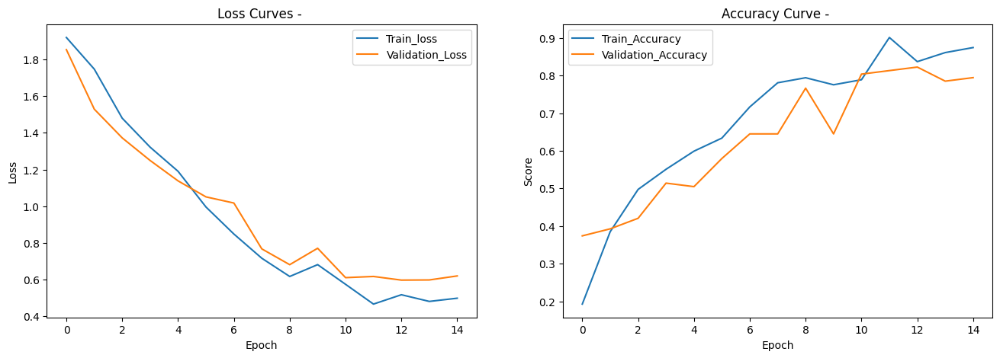

------------------------------ 
Best result on validation set -> Loss = 0.6090394004627511 Accuracy = 82.24 %
Validation Report
[('angry', 0.8695652173913043), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.5), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.77      0.87      0.82        23
       bored       0.90      0.86      0.88        21
     disgust       0.75      1.00      0.86         6
        fear       0.86      0.80      0.83        15
       happy       0.89      0.50      0.64        16
     neutral       0.81      0.89      0.85        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.82       107
   macro avg       0.82      0.85      0.82       107
weighted avg       0.83      0.82      0.82       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.43492858537605833 Accuracy = 90.74 %
[('a

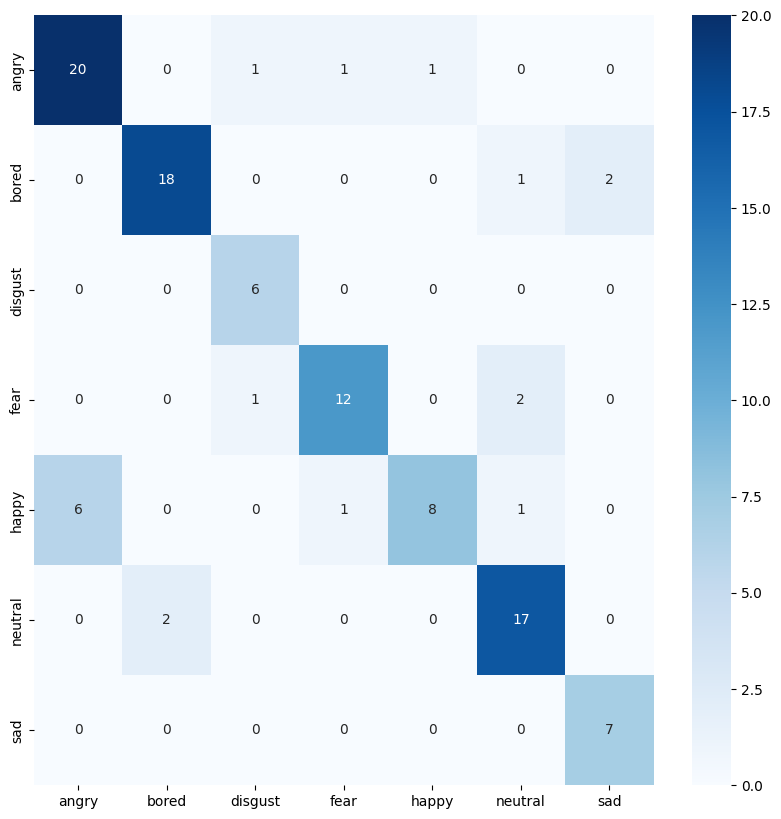

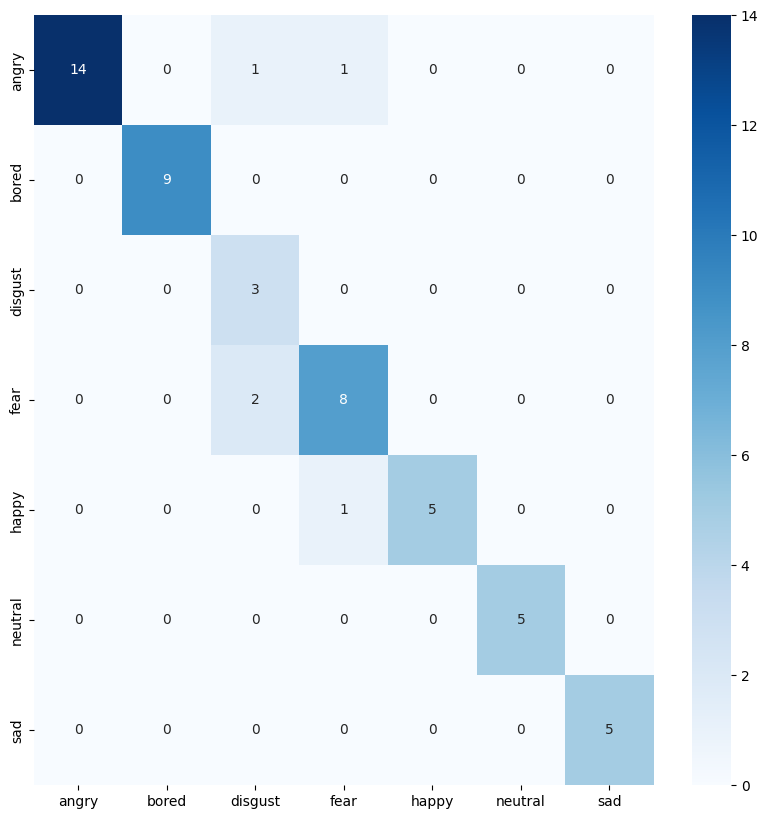

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_25"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-023bc2b5d85f0d5d/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9341 
[Epoch][Batch] = [1][19] -> Loss = 1.9501 
[Epoch][Batch] = [1][38] -> Loss = 1.9449 
[Epoch][Batch] = [1][57] -> Loss = 1.9435 
[Epoch][Batch] = [1][76] -> Loss = 1.9369 
best_acc  0.411214953271028
	Train -> Loss = 1.9339 /  accuracy = 0.2487
	Validation -> Loss = 1.8963 /  accuracy = 0.4112
[Epoch][Batch] = [2][0] -> Loss = 1.8749 
[Epoch][Batch] = [2][19] -> Loss = 1.8998 
[Epoch][Batch] = [2][38] -> Loss = 1.8875 


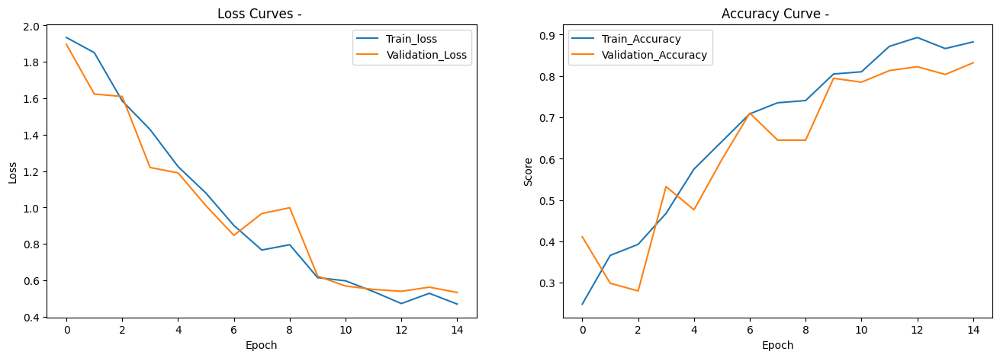

------------------------------ 
Best result on validation set -> Loss = 0.5316290424929725 Accuracy = 83.18 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.7619047619047619), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.5), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.79      0.96      0.86        23
       bored       0.94      0.76      0.84        21
     disgust       0.67      1.00      0.80         6
        fear       0.92      0.80      0.86        15
       happy       0.73      0.50      0.59        16
     neutral       0.86      0.95      0.90        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.83       107
   macro avg       0.83      0.85      0.83       107
weighted avg       0.84      0.83      0.83       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.3960749996559961 Accuracy = 85.19 %
[('an

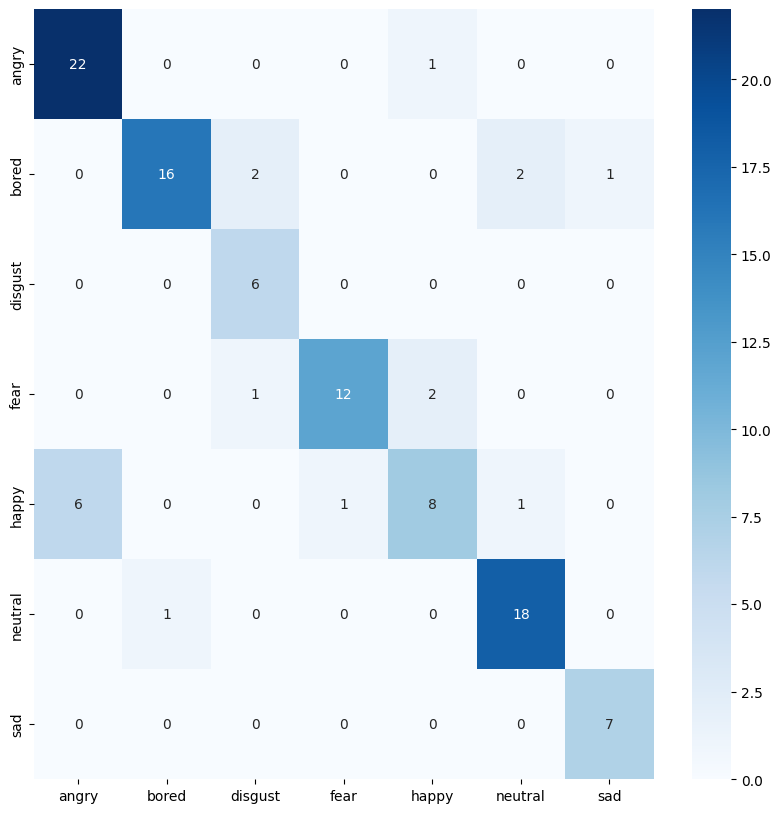

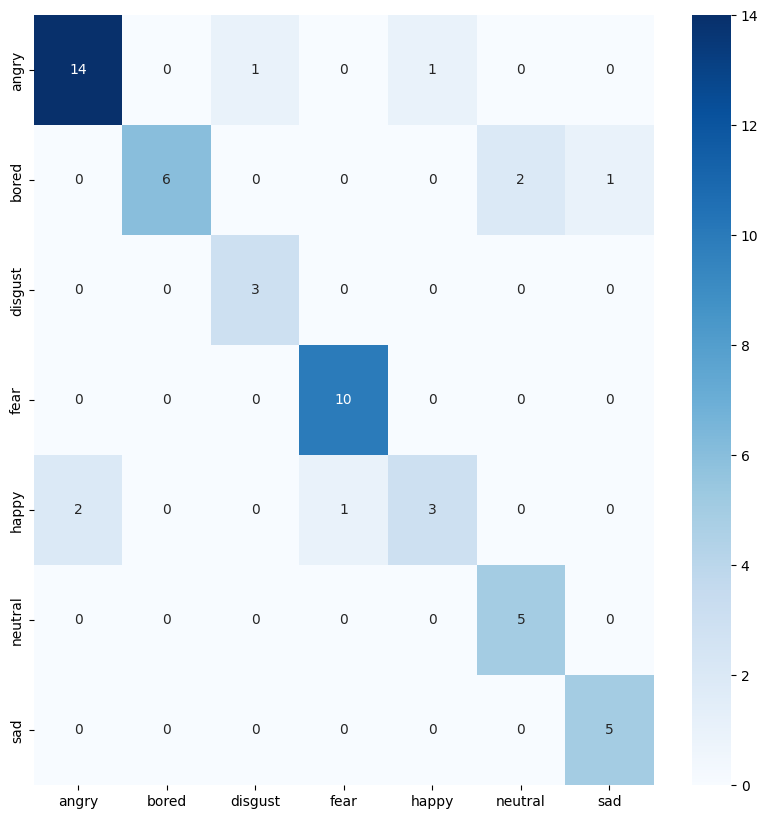

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_25"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-88a61a4de69fda9d/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9177 
[Epoch][Batch] = [1][19] -> Loss = 1.9468 
[Epoch][Batch] = [1][38] -> Loss = 1.9454 
[Epoch][Batch] = [1][57] -> Loss = 1.9410 
[Epoch][Batch] = [1][76] -> Loss = 1.9370 
best_acc  0.3644859813084112
	Train -> Loss = 1.9317 /  accuracy = 0.1604
	Validation -> Loss = 1.8773 /  accuracy = 0.3645
[Epoch][Batch] = [2][0] -> Loss = 1.8933 
[Epoch][Batch] = [2][19] -> Loss = 1.8769 
[Epoch][Batch] = [2][38] -> Loss = 1.8707 

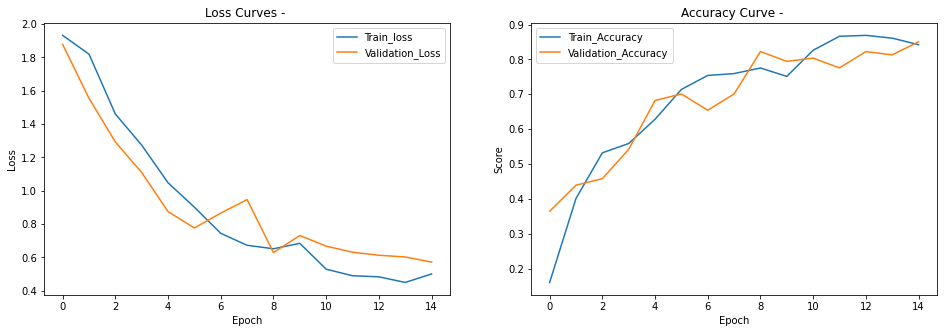

------------------------------ 
Best result on validation set -> Loss = 0.5556753564763952 Accuracy = 84.11 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.6875), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.88      0.91      0.89        23
       bored       0.86      0.86      0.86        21
     disgust       1.00      1.00      1.00         6
        fear       0.92      0.73      0.81        15
       happy       0.79      0.69      0.73        16
     neutral       0.70      0.84      0.76        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.84       107
   macro avg       0.88      0.86      0.87       107
weighted avg       0.85      0.84      0.84       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.44719249861580984 Accur

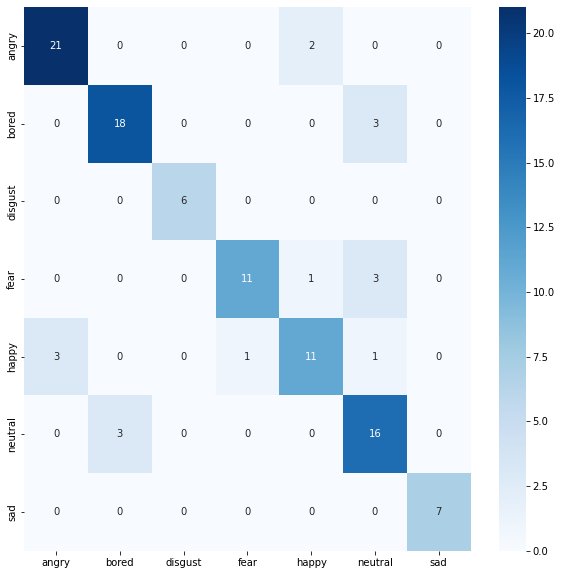

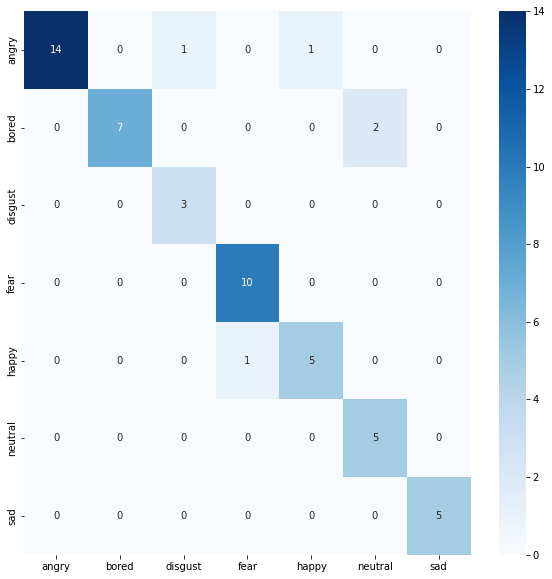

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_30"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-4aad8d74e66e8db4/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9440 
[Epoch][Batch] = [1][19] -> Loss = 1.9315 
[Epoch][Batch] = [1][38] -> Loss = 1.9304 
[Epoch][Batch] = [1][57] -> Loss = 1.9300 
[Epoch][Batch] = [1][76] -> Loss = 1.9228 
best_acc  0.48598130841121495
	Train -> Loss = 1.9151 /  accuracy = 0.2380
	Validation -> Loss = 1.8305 /  accuracy = 0.4860
[Epoch][Batch] = [2][0] -> Loss = 1.8311 
[Epoch][Batch] = [2][19] -> Loss = 1.8423 
[Epoch][Batch] = [2][38] -> Loss = 1.8367

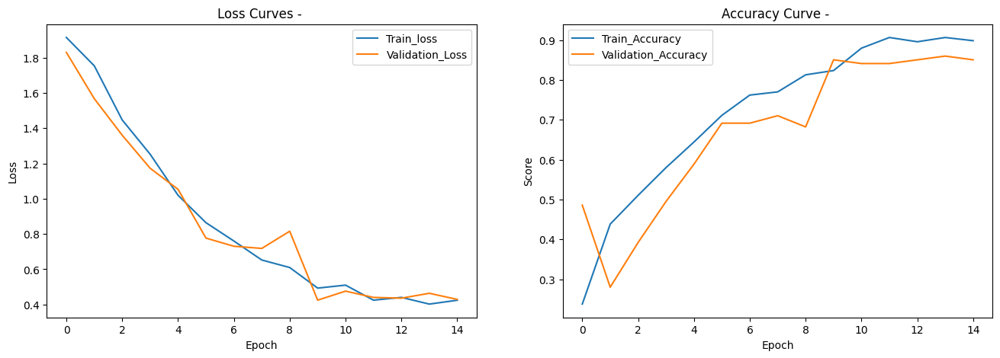

------------------------------ 
Best result on validation set -> Loss = 0.4448319110605452 Accuracy = 84.11 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.8095238095238095), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.5625), ('neutral', 0.8947368421052632), ('sad', 0.8571428571428571)]
              precision    recall  f1-score   support

       angry       0.81      0.96      0.88        23
       bored       0.85      0.81      0.83        21
     disgust       0.75      1.00      0.86         6
        fear       0.93      0.87      0.90        15
       happy       0.82      0.56      0.67        16
     neutral       0.89      0.89      0.89        19
         sad       0.75      0.86      0.80         7

    accuracy                           0.84       107
   macro avg       0.83      0.85      0.83       107
weighted avg       0.84      0.84      0.84       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.41156934

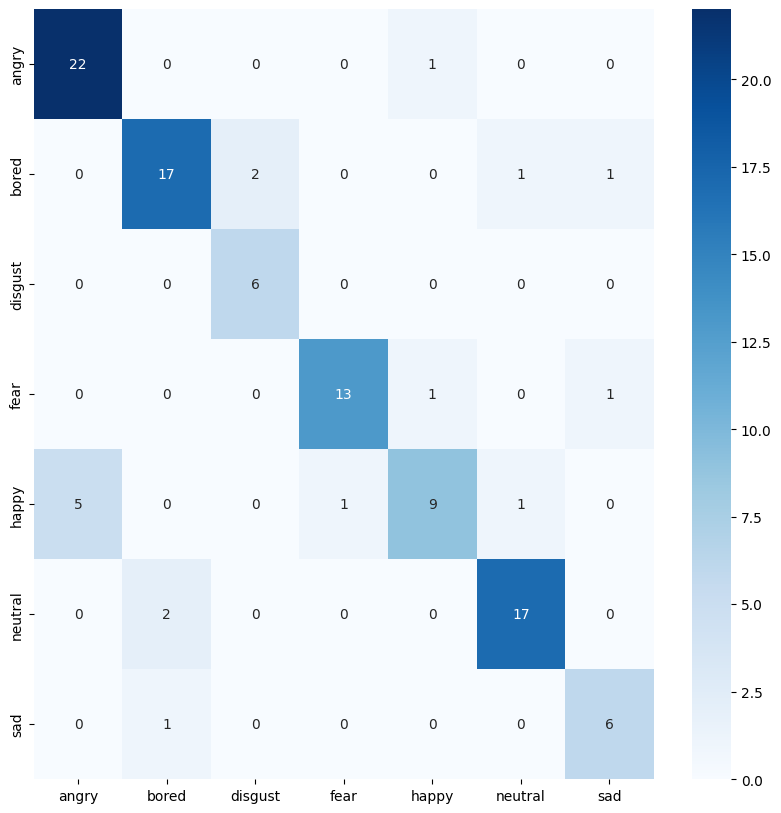

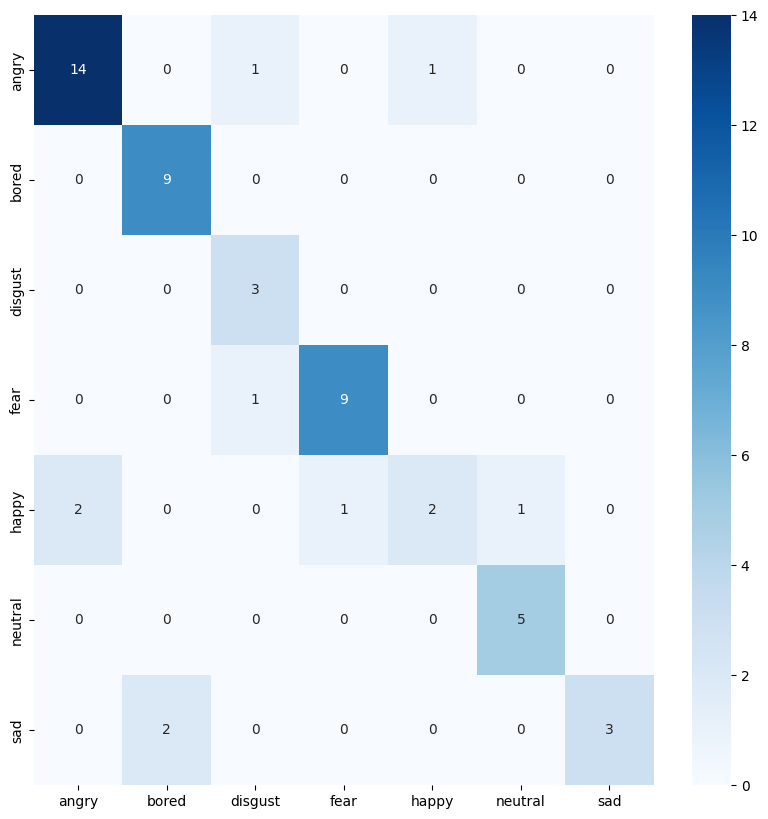

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_30"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-34cf56f77419674f/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9861 
[Epoch][Batch] = [1][19] -> Loss = 1.9459 
[Epoch][Batch] = [1][38] -> Loss = 1.9464 
[Epoch][Batch] = [1][57] -> Loss = 1.9302 
[Epoch][Batch] = [1][76] -> Loss = 1.9251 
best_acc  0.2803738317757009
	Train -> Loss = 1.9279 /  accuracy = 0.2567
	Validation -> Loss = 1.8711 /  accuracy = 0.2804
[Epoch][Batch] = [2][0] -> Loss = 1.9191 
[Epoch][Batch] = [2][19] -> Loss = 1.8860 
[Epoch][Batch] = [2][38] -> Loss = 1.8710 

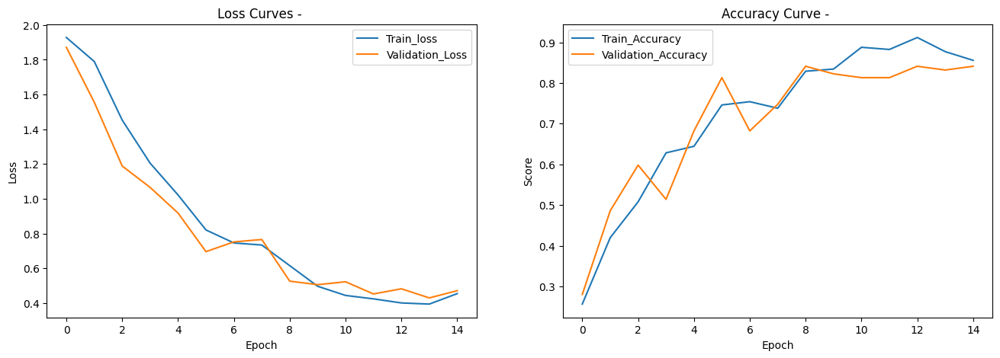

------------------------------ 
Best result on validation set -> Loss = 0.5163661600263031 Accuracy = 81.31 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.4375), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.75      0.91      0.82        23
       bored       0.90      0.86      0.88        21
     disgust       0.75      1.00      0.86         6
        fear       0.92      0.73      0.81        15
       happy       0.78      0.44      0.56        16
     neutral       0.77      0.89      0.83        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.81       107
   macro avg       0.82      0.83      0.81       107
weighted avg       0.82      0.81      0.80       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.4650205501488277 Accura

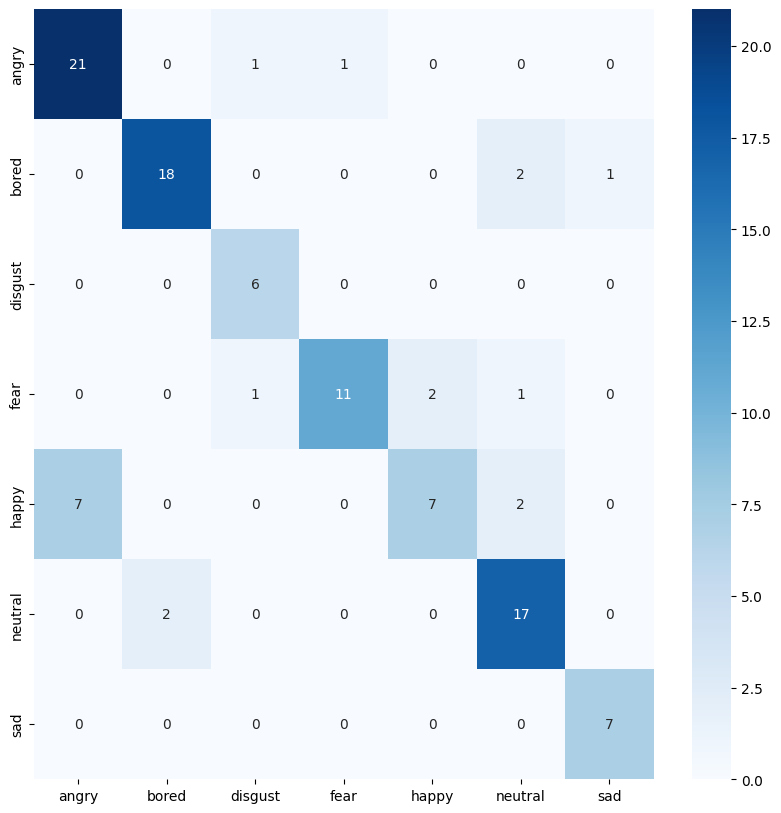

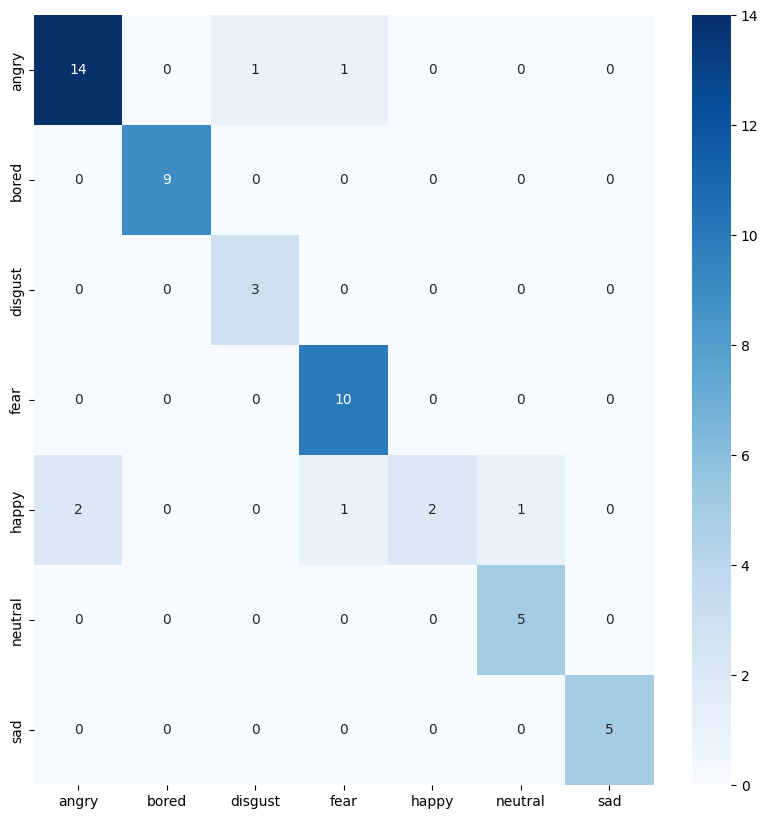

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_30"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-aa36804a4a406ea2/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9535 
[Epoch][Batch] = [1][19] -> Loss = 1.9391 
[Epoch][Batch] = [1][38] -> Loss = 1.9334 
[Epoch][Batch] = [1][57] -> Loss = 1.9332 
[Epoch][Batch] = [1][76] -> Loss = 1.9253 
best_acc  0.4485981308411215
	Train -> Loss = 1.9194 /  accuracy = 0.2941
	Validation -> Loss = 1.8490 /  accuracy = 0.4486
[Epoch][Batch] = [2][0] -> Loss = 1.8612 
[Epoch][Batch] = [2][19] -> Loss = 1.8558 
[Epoch][Batch] = [2][38] -> Loss = 1.8458 

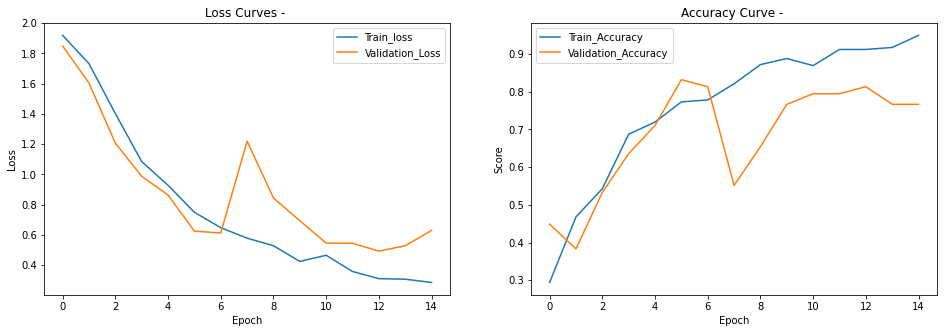

------------------------------ 
Best result on validation set -> Loss = 0.6576282613807254 Accuracy = 81.31 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.375), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.78      0.91      0.84        23
       bored       0.86      0.86      0.86        21
     disgust       0.86      1.00      0.92         6
        fear       0.76      0.87      0.81        15
       happy       0.86      0.38      0.52        16
     neutral       0.76      0.84      0.80        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.81       107
   macro avg       0.84      0.84      0.82       107
weighted avg       0.82      0.81      0.80       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.5105494473661695 Accurac

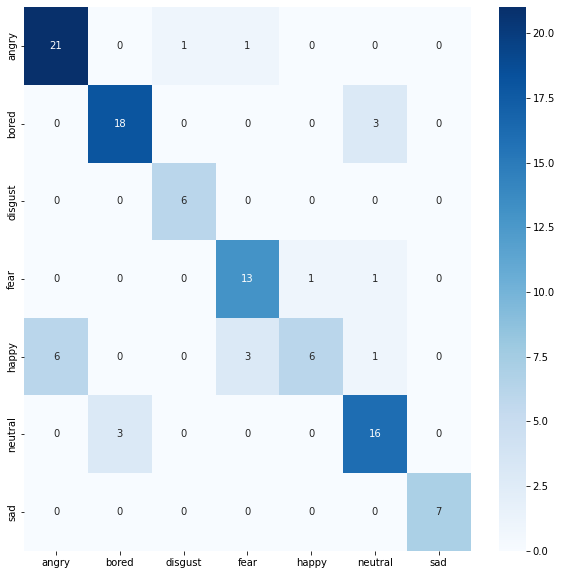

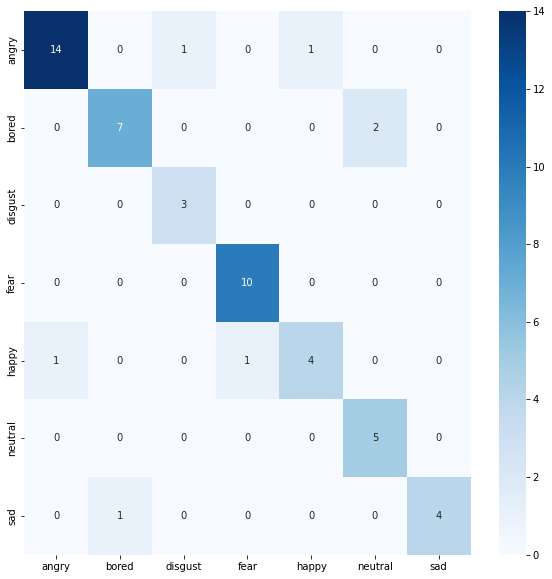

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_35"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ba73f734da4d0cf3/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9151 
[Epoch][Batch] = [1][19] -> Loss = 1.9489 
[Epoch][Batch] = [1][38] -> Loss = 1.9440 
[Epoch][Batch] = [1][57] -> Loss = 1.9360 
[Epoch][Batch] = [1][76] -> Loss = 1.9309 
best_acc  0.29906542056074764
	Train -> Loss = 1.9251 /  accuracy = 0.2834
	Validation -> Loss = 1.8710 /  accuracy = 0.2991
[Epoch][Batch] = [2][0] -> Loss = 1.9668 
[Epoch][Batch] = [2][19] -> Loss = 1.8886 
[Epoch][Batch] = [2][38] -> Loss = 1.8736

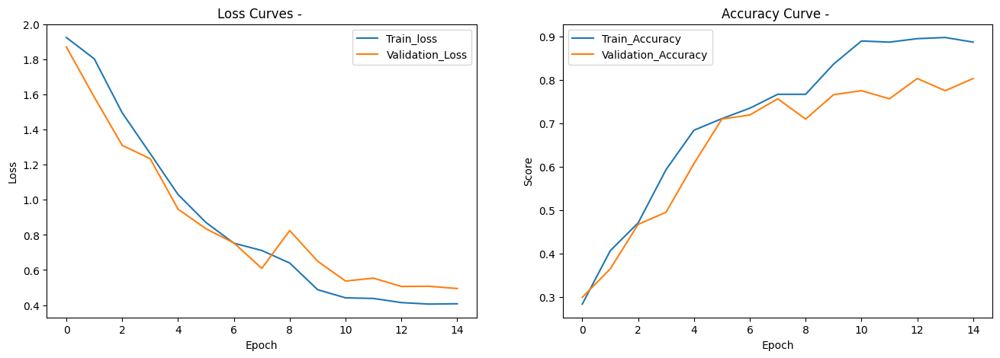

------------------------------ 
Best result on validation set -> Loss = 0.47324047099660943 Accuracy = 82.24 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.6666666666666666), ('happy', 0.3125), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.69      0.96      0.80        23
       bored       0.95      0.95      0.95        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.67      0.80        15
       happy       0.50      0.31      0.38        16
     neutral       0.90      0.95      0.92        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.82       107
   macro avg       0.84      0.83      0.83       107
weighted avg       0.82      0.82      0.81       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.4468529128602573 Accur

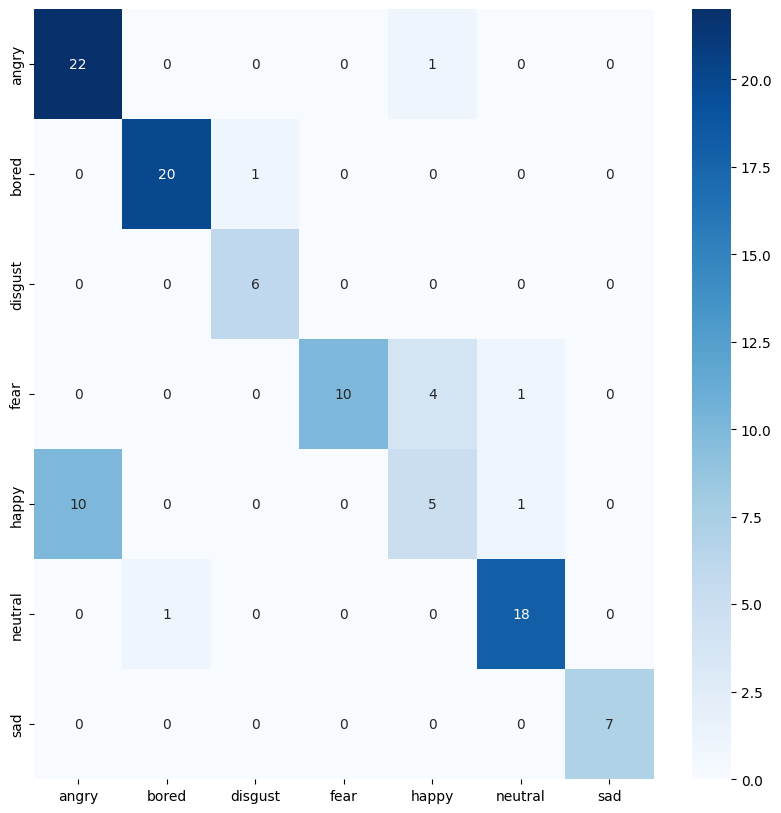

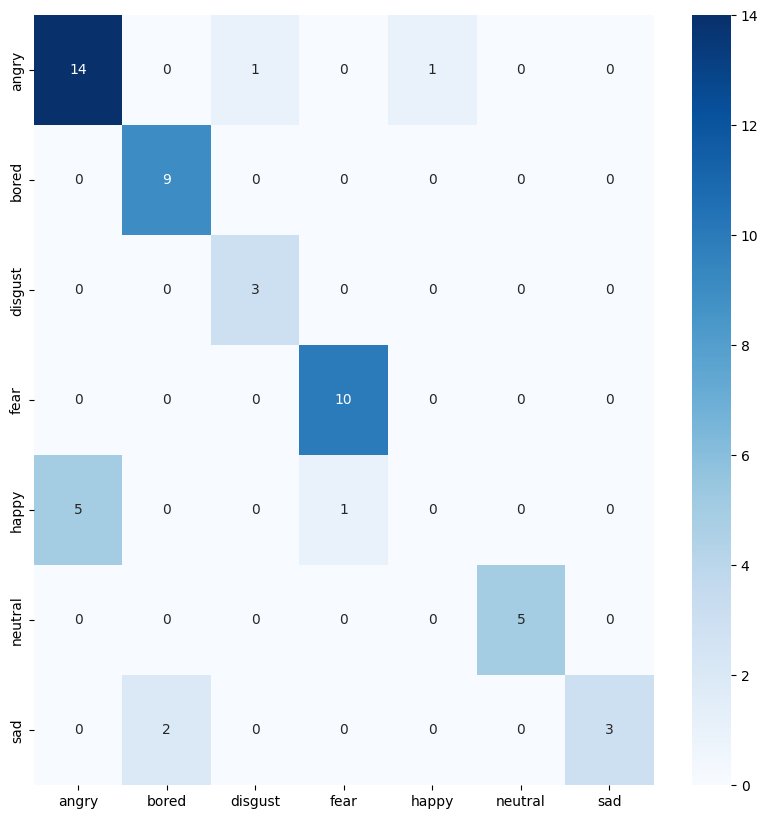

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_35"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-488d31e7c3487e5c/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9527 
[Epoch][Batch] = [1][19] -> Loss = 1.9473 
[Epoch][Batch] = [1][38] -> Loss = 1.9407 
[Epoch][Batch] = [1][57] -> Loss = 1.9360 
[Epoch][Batch] = [1][76] -> Loss = 1.9322 
best_acc  0.34579439252336447
	Train -> Loss = 1.9284 /  accuracy = 0.1872
	Validation -> Loss = 1.8796 /  accuracy = 0.3458
[Epoch][Batch] = [2][0] -> Loss = 1.8898 
[Epoch][Batch] = [2][19] -> Loss = 1.8785 
[Epoch][Batch] = [2][38] -> Loss = 1.8688

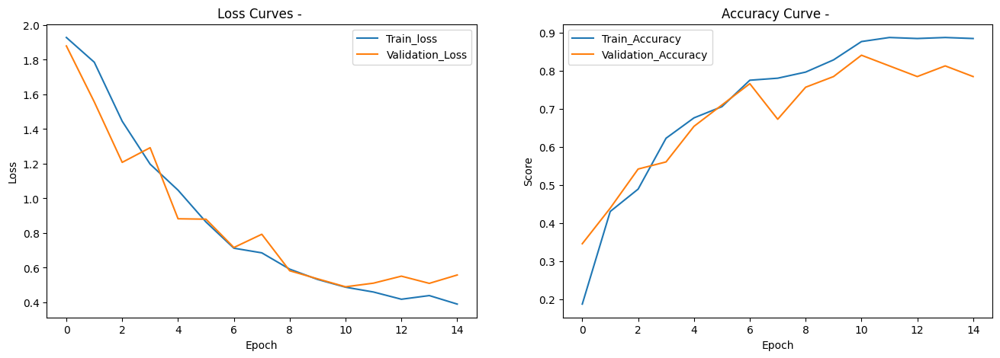

------------------------------ 
Best result on validation set -> Loss = 0.4644809700548649 Accuracy = 81.31 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.6190476190476191), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.85      0.96      0.90        23
       bored       0.87      0.62      0.72        21
     disgust       1.00      1.00      1.00         6
        fear       1.00      0.80      0.89        15
       happy       0.77      0.62      0.69        16
     neutral       0.63      0.89      0.74        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.81       107
   macro avg       0.86      0.84      0.84       107
weighted avg       0.83      0.81      0.81       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.36559505068830084 Accuracy = 85.19 %
[(

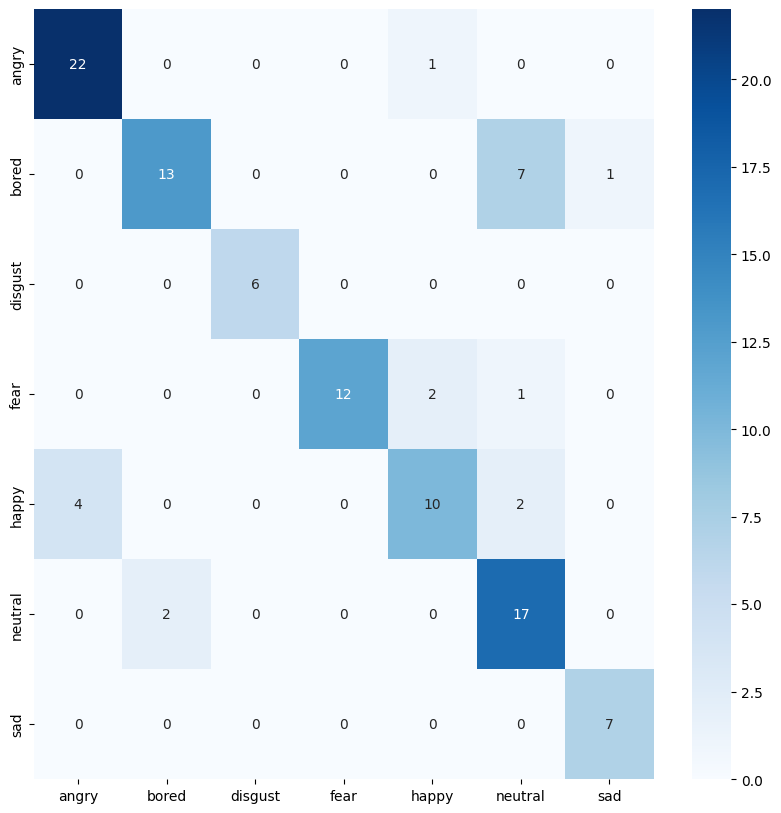

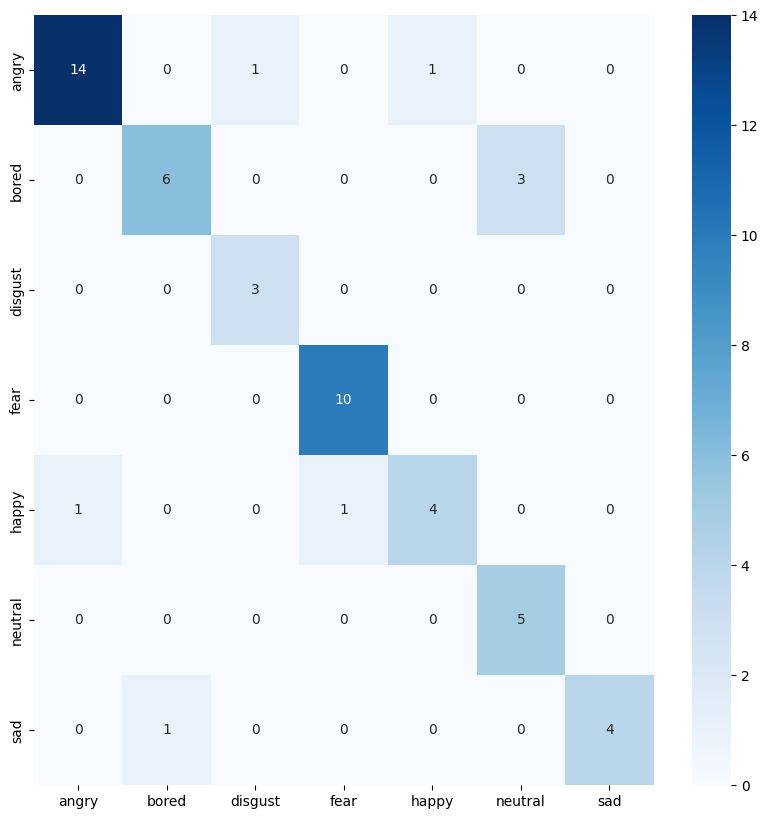

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_35"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-5765cd6baaa9fb17/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.8906 
[Epoch][Batch] = [1][19] -> Loss = 1.9417 
[Epoch][Batch] = [1][38] -> Loss = 1.9392 
[Epoch][Batch] = [1][57] -> Loss = 1.9320 
[Epoch][Batch] = [1][76] -> Loss = 1.9246 
best_acc  0.37383177570093457
	Train -> Loss = 1.9211 /  accuracy = 0.3262
	Validation -> Loss = 1.8708 /  accuracy = 0.3738
[Epoch][Batch] = [2][0] -> Loss = 1.8458 
[Epoch][Batch] = [2][19] -> Loss = 1.8667 
[Epoch][Batch] = [2][38] -> Loss = 1.8388

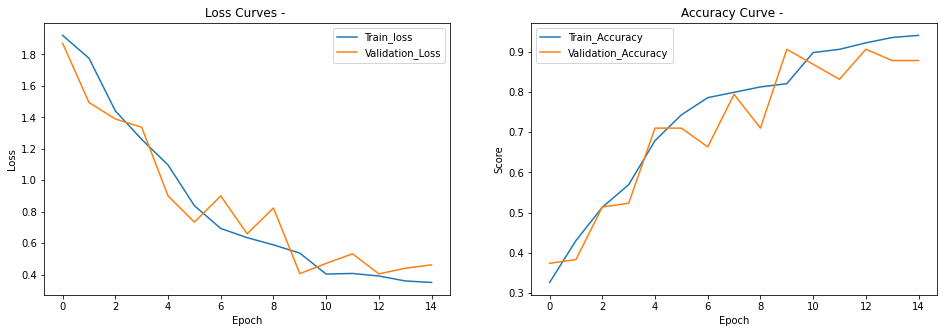

------------------------------ 
Best result on validation set -> Loss = 0.41635340617762673 Accuracy = 89.72 %
Validation Report
[('angry', 1.0), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 1.0), ('happy', 0.5625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.79      1.00      0.88        23
       bored       0.90      0.90      0.90        21
     disgust       1.00      1.00      1.00         6
        fear       0.94      1.00      0.97        15
       happy       1.00      0.56      0.72        16
     neutral       0.89      0.89      0.89        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.90       107
   macro avg       0.93      0.91      0.91       107
weighted avg       0.91      0.90      0.89       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.4082143037979092 Accuracy = 90.74 %
[('angry', 0.937

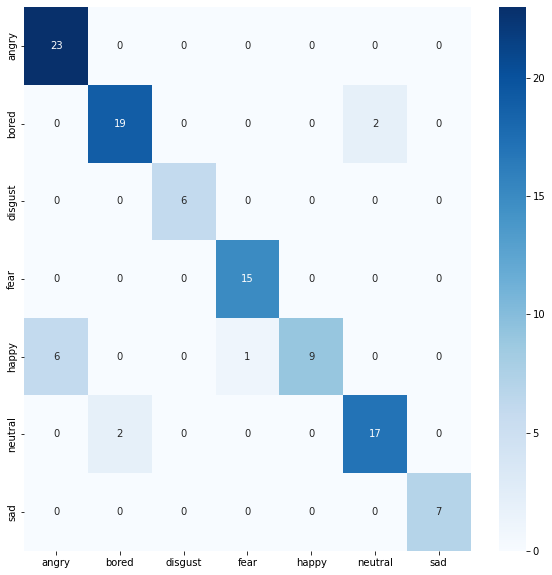

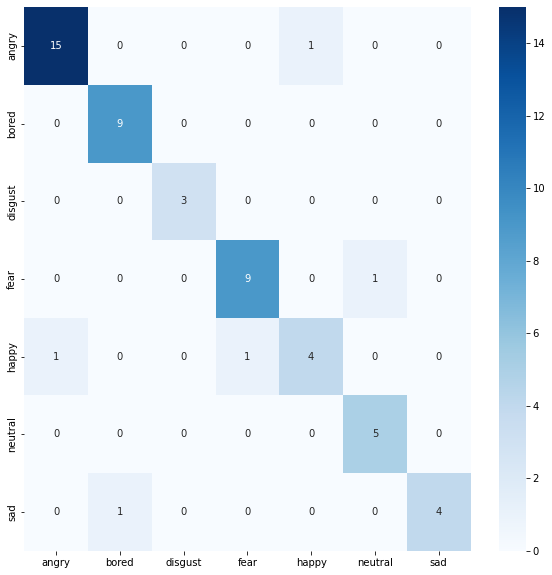

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_40"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-4c572d1297675906/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9192 
[Epoch][Batch] = [1][19] -> Loss = 1.9313 
[Epoch][Batch] = [1][38] -> Loss = 1.9272 
[Epoch][Batch] = [1][57] -> Loss = 1.9209 
[Epoch][Batch] = [1][76] -> Loss = 1.9190 
best_acc  0.37383177570093457
	Train -> Loss = 1.9150 /  accuracy = 0.2406
	Validation -> Loss = 1.8509 /  accuracy = 0.3738
[Epoch][Batch] = [2][0] -> Loss = 1.8756 
[Epoch][Batch] = [2][19] -> Loss = 1.8735 
[Epoch][Batch] = [2][38] -> Loss = 1.8560

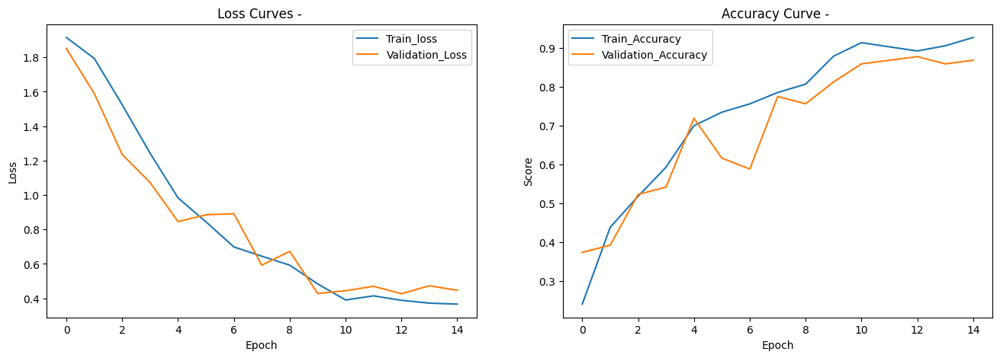

------------------------------ 
Best result on validation set -> Loss = 0.42432024743821883 Accuracy = 86.92 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.6875), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.88      0.91      0.89        23
       bored       1.00      0.86      0.92        21
     disgust       0.67      1.00      0.80         6
        fear       1.00      0.73      0.85        15
       happy       0.79      0.69      0.73        16
     neutral       0.83      1.00      0.90        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.87       107
   macro avg       0.86      0.88      0.86       107
weighted avg       0.88      0.87      0.87       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.3709867639201028 Accuracy = 90.74 %
[

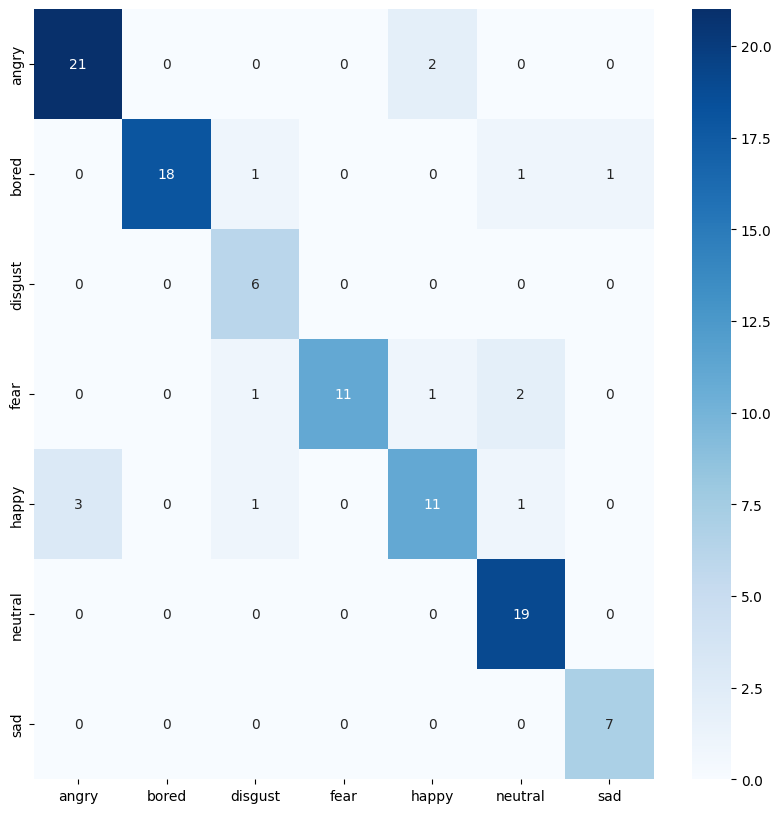

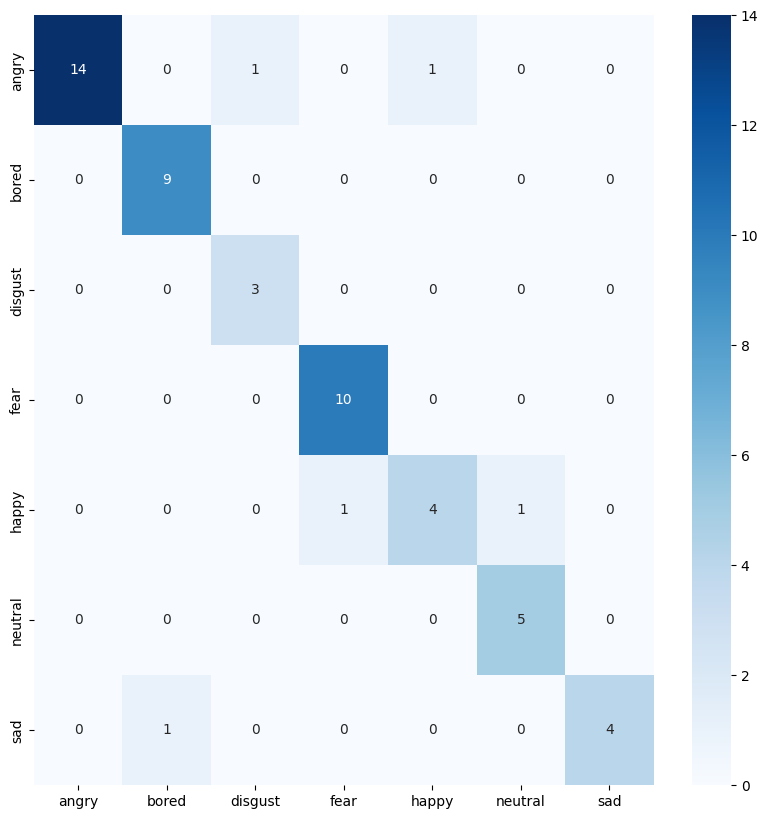

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_40"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ef032cd83f45b128/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9058 
[Epoch][Batch] = [1][19] -> Loss = 1.9552 
[Epoch][Batch] = [1][38] -> Loss = 1.9419 
[Epoch][Batch] = [1][57] -> Loss = 1.9384 
[Epoch][Batch] = [1][76] -> Loss = 1.9344 
best_acc  0.27102803738317754
	Train -> Loss = 1.9296 /  accuracy = 0.2380
	Validation -> Loss = 1.8808 /  accuracy = 0.2710
[Epoch][Batch] = [2][0] -> Loss = 1.9078 
[Epoch][Batch] = [2][19] -> Loss = 1.8609 
[Epoch][Batch] = [2][38] -> Loss = 1.8593

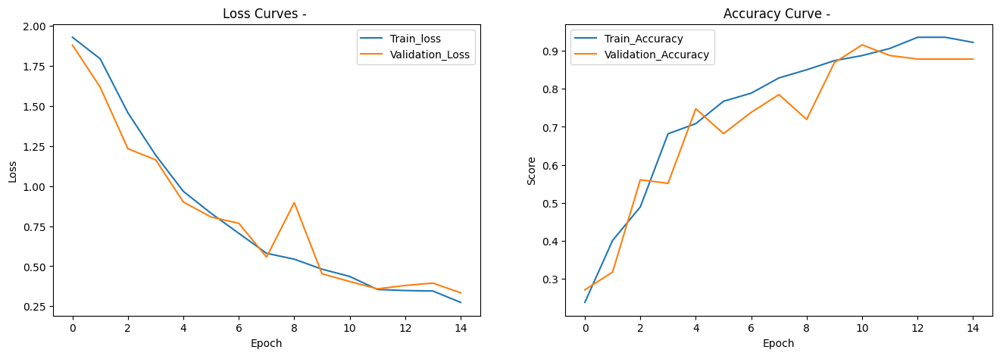

------------------------------ 
Best result on validation set -> Loss = 0.38575654062959885 Accuracy = 89.72 %
Validation Report
[('angry', 1.0), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.625), ('neutral', 0.9473684210526315), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.85      1.00      0.92        23
       bored       0.95      0.90      0.93        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.87      0.93        15
       happy       0.83      0.62      0.71        16
     neutral       0.90      0.95      0.92        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.90       107
   macro avg       0.90      0.91      0.90       107
weighted avg       0.90      0.90      0.89       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.36373586314065115 Accuracy = 88.89 %
[

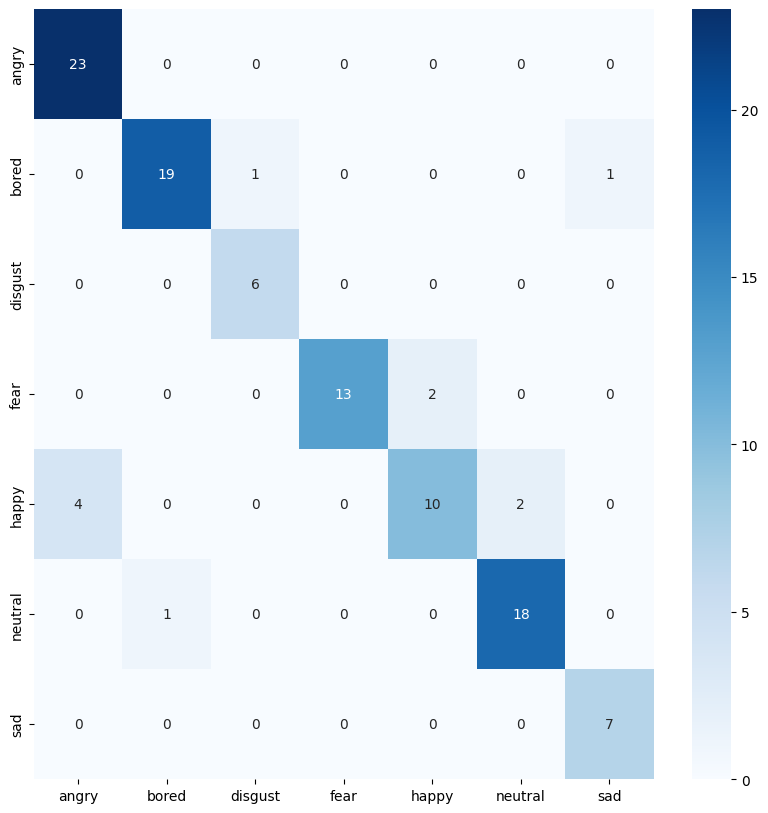

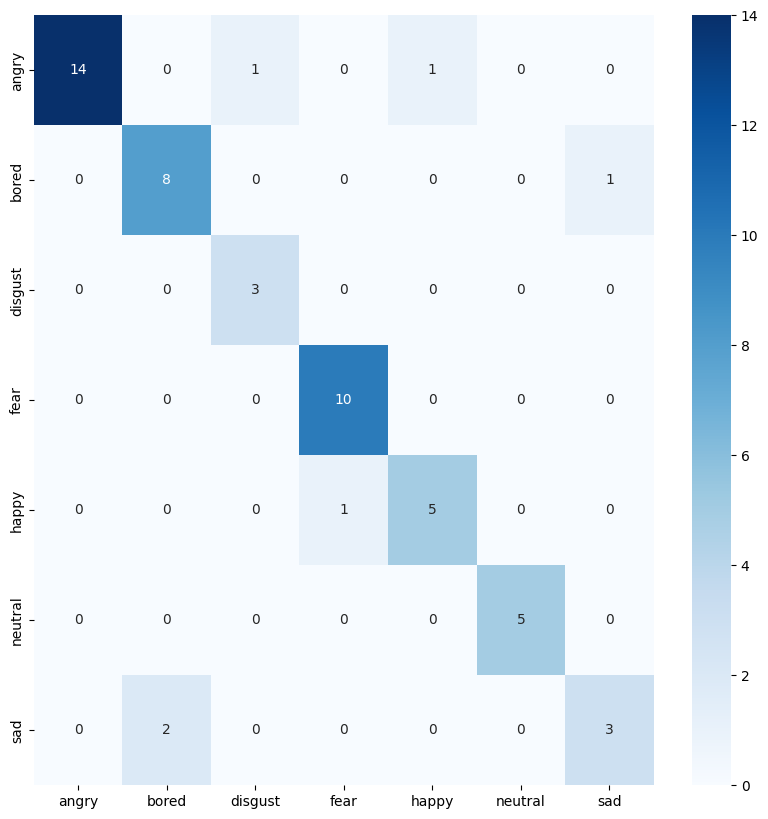

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_40"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-b1b71bbf49b980ee/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9319 
[Epoch][Batch] = [1][19] -> Loss = 1.9394 
[Epoch][Batch] = [1][38] -> Loss = 1.9408 
[Epoch][Batch] = [1][57] -> Loss = 1.9291 
[Epoch][Batch] = [1][76] -> Loss = 1.9269 
best_acc  0.514018691588785
	Train -> Loss = 1.9204 /  accuracy = 0.2834
	Validation -> Loss = 1.8524 /  accuracy = 0.5140
[Epoch][Batch] = [2][0] -> Loss = 1.9165 
[Epoch][Batch] = [2][19] -> Loss = 1.8698 
[Epoch][Batch] = [2][38] -> Loss = 1.8523 


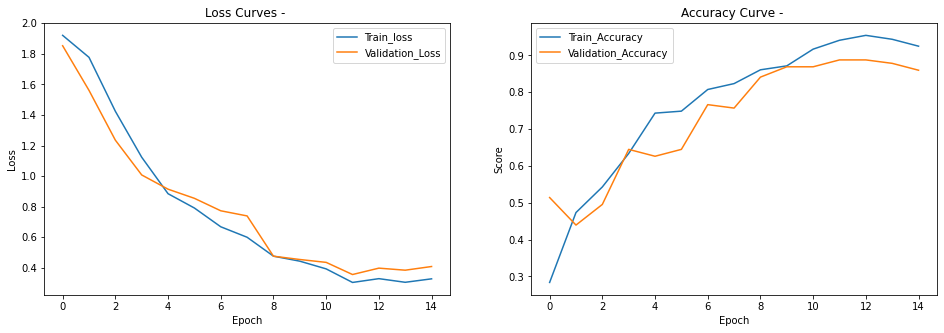

------------------------------ 
Best result on validation set -> Loss = 0.35959856101760157 Accuracy = 90.65 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.75), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.92      0.96      0.94        23
       bored       0.90      0.90      0.90        21
     disgust       0.86      1.00      0.92         6
        fear       0.92      0.80      0.86        15
       happy       0.80      0.75      0.77        16
     neutral       0.95      1.00      0.97        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.91       107
   macro avg       0.91      0.92      0.91       107
weighted avg       0.91      0.91      0.90       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.2827591129711696 Accuracy = 94.44 %
[('angry', 0.875),

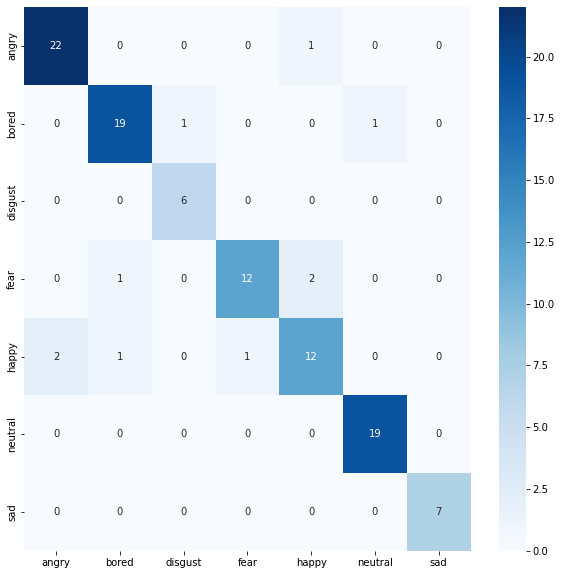

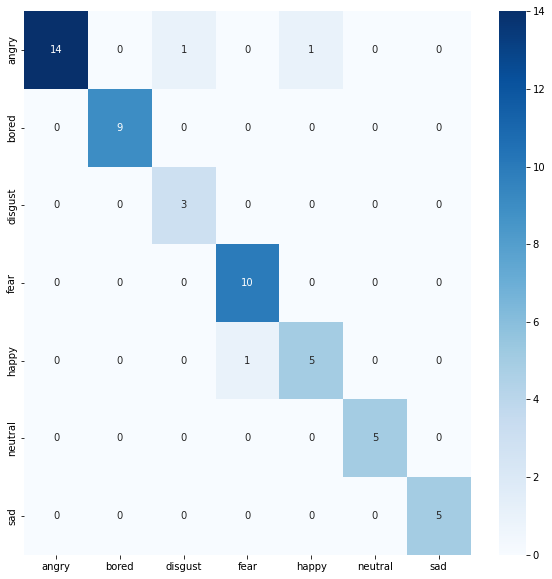

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_45"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-7fadeb69c8d67739/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9204 
[Epoch][Batch] = [1][19] -> Loss = 1.9417 
[Epoch][Batch] = [1][38] -> Loss = 1.9377 
[Epoch][Batch] = [1][57] -> Loss = 1.9367 
[Epoch][Batch] = [1][76] -> Loss = 1.9304 
best_acc  0.38317757009345793
	Train -> Loss = 1.9252 /  accuracy = 0.2139
	Validation -> Loss = 1.8653 /  accuracy = 0.3832
[Epoch][Batch] = [2][0] -> Loss = 1.8326 
[Epoch][Batch] = [2][19] -> Loss = 1.8802 
[Epoch][Batch] = [2][38] -> Loss = 1.8573

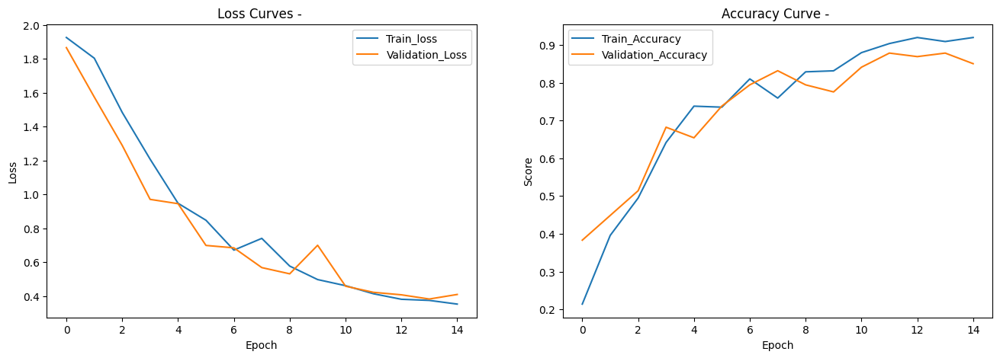

------------------------------ 
Best result on validation set -> Loss = 0.4031543922093179 Accuracy = 87.85 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 1.0), ('happy', 0.5625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.84      0.91      0.87        23
       bored       0.90      0.90      0.90        21
     disgust       0.86      1.00      0.92         6
        fear       0.88      1.00      0.94        15
       happy       0.90      0.56      0.69        16
     neutral       0.85      0.89      0.87        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.88       107
   macro avg       0.89      0.90      0.89       107
weighted avg       0.88      0.88      0.87       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.281598870243345 Accuracy = 92.59 %
[('

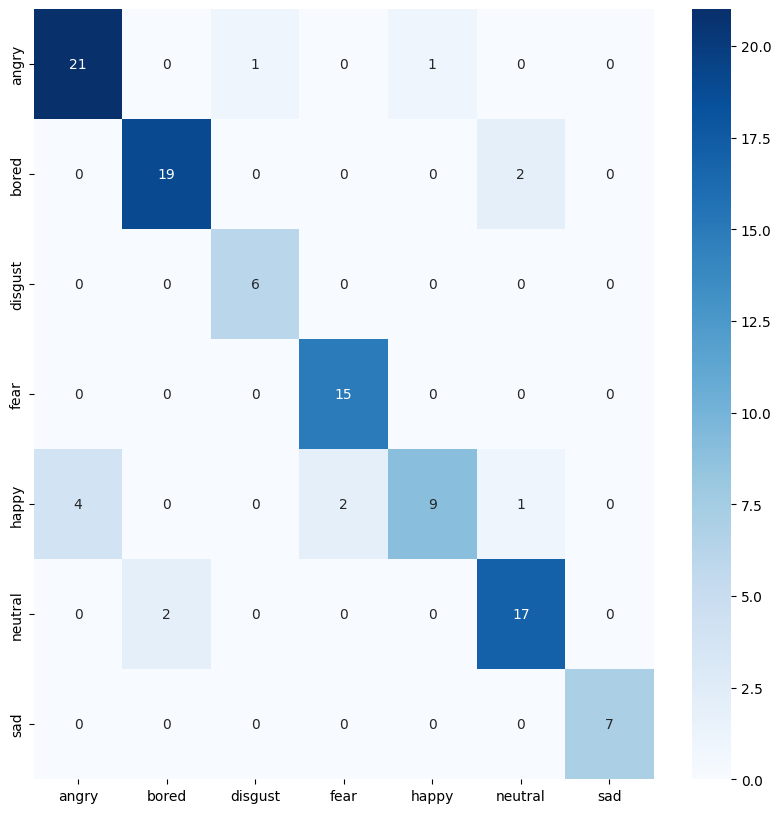

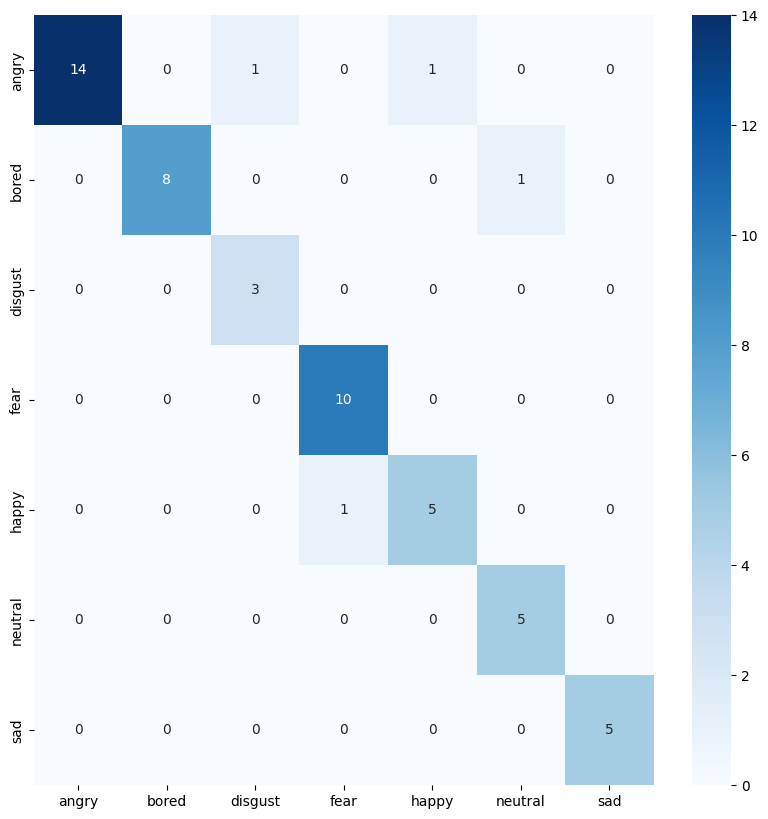

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_45"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-64fa6443d1ca746b/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9356 
[Epoch][Batch] = [1][19] -> Loss = 1.9403 
[Epoch][Batch] = [1][38] -> Loss = 1.9356 
[Epoch][Batch] = [1][57] -> Loss = 1.9388 
[Epoch][Batch] = [1][76] -> Loss = 1.9347 
best_acc  0.38317757009345793
	Train -> Loss = 1.9312 /  accuracy = 0.2460
	Validation -> Loss = 1.8942 /  accuracy = 0.3832
[Epoch][Batch] = [2][0] -> Loss = 1.9372 
[Epoch][Batch] = [2][19] -> Loss = 1.8759 
[Epoch][Batch] = [2][38] -> Loss = 1.8721

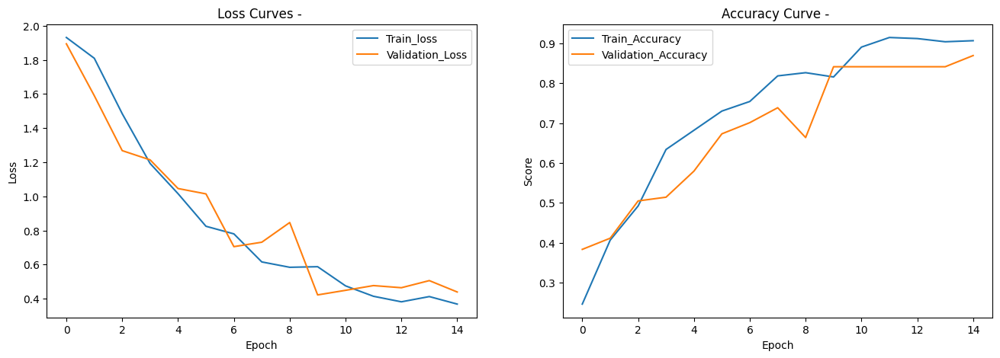

------------------------------ 
Best result on validation set -> Loss = 0.45755496593537154 Accuracy = 83.18 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.6666666666666666), ('happy', 0.625), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.84      0.91      0.87        23
       bored       0.86      0.90      0.88        21
     disgust       0.86      1.00      0.92         6
        fear       0.91      0.67      0.77        15
       happy       0.67      0.62      0.65        16
     neutral       0.84      0.84      0.84        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.83       107
   macro avg       0.84      0.85      0.84       107
weighted avg       0.83      0.83      0.83       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.28135573491454124 Accur

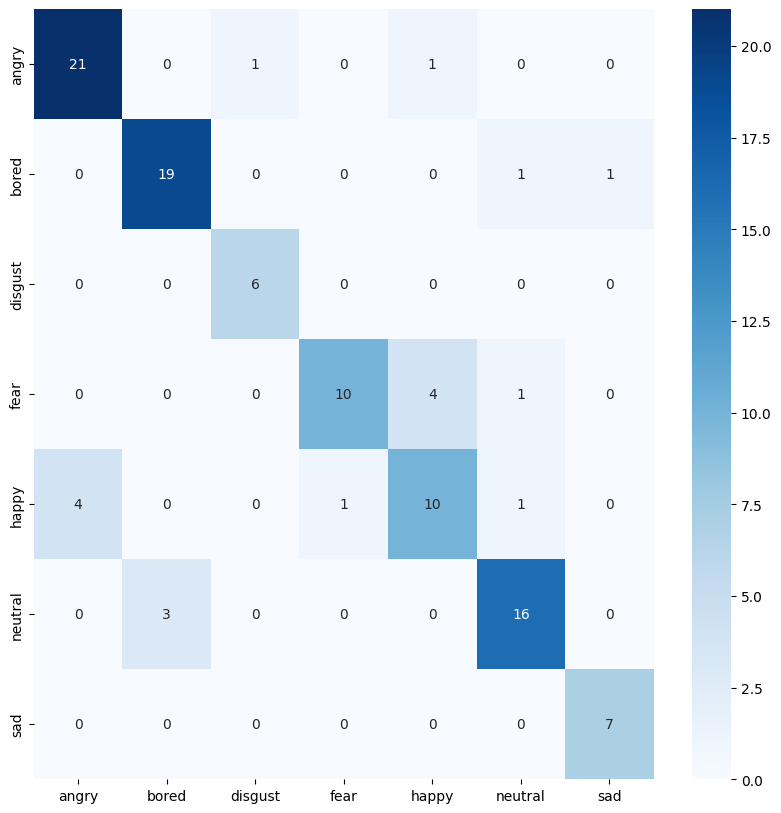

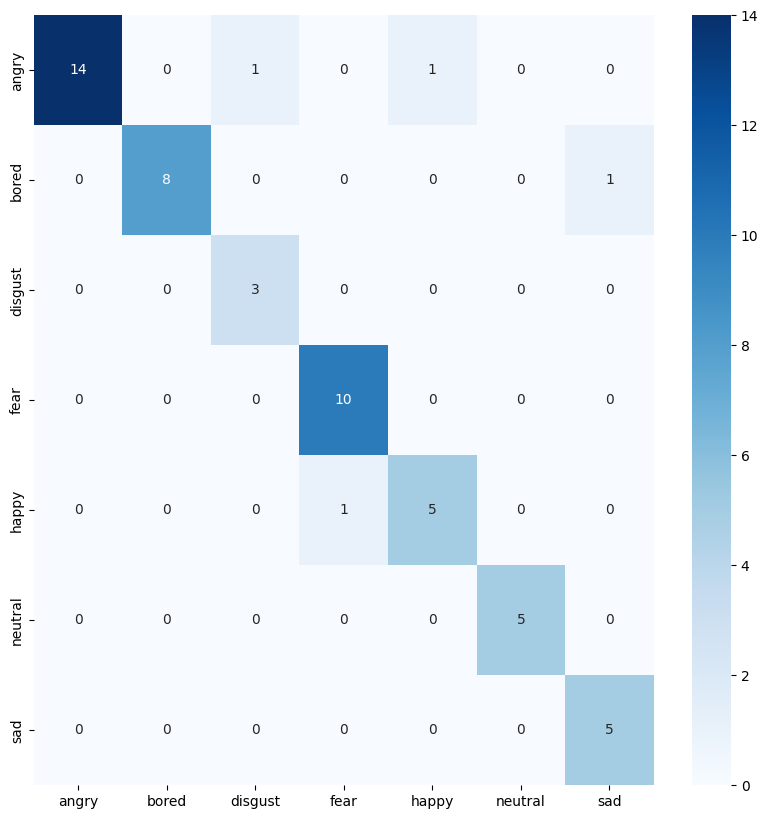

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_45"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-45c5d4ce319d3d4c/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9436 
[Epoch][Batch] = [1][19] -> Loss = 1.9520 
[Epoch][Batch] = [1][38] -> Loss = 1.9545 
[Epoch][Batch] = [1][57] -> Loss = 1.9450 
[Epoch][Batch] = [1][76] -> Loss = 1.9372 
best_acc  0.40186915887850466
	Train -> Loss = 1.9308 /  accuracy = 0.1417
	Validation -> Loss = 1.8555 /  accuracy = 0.4019
[Epoch][Batch] = [2][0] -> Loss = 1.8162 
[Epoch][Batch] = [2][19] -> Loss = 1.8465 
[Epoch][Batch] = [2][38] -> Loss = 1.8387

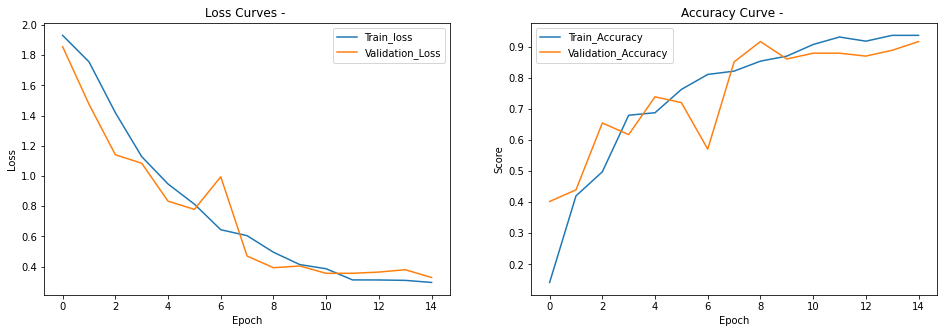

------------------------------ 
Best result on validation set -> Loss = 0.3921989114196212 Accuracy = 92.52 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 1.0), ('disgust', 1.0), ('fear', 1.0), ('happy', 0.8125), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.95      0.91      0.93        23
       bored       0.88      1.00      0.93        21
     disgust       0.86      1.00      0.92         6
        fear       0.94      1.00      0.97        15
       happy       0.93      0.81      0.87        16
     neutral       0.94      0.84      0.89        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.93       107
   macro avg       0.93      0.94      0.93       107
weighted avg       0.93      0.93      0.92       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.3587229757436684 Accuracy = 87.04 %
[('angry', 0.875)

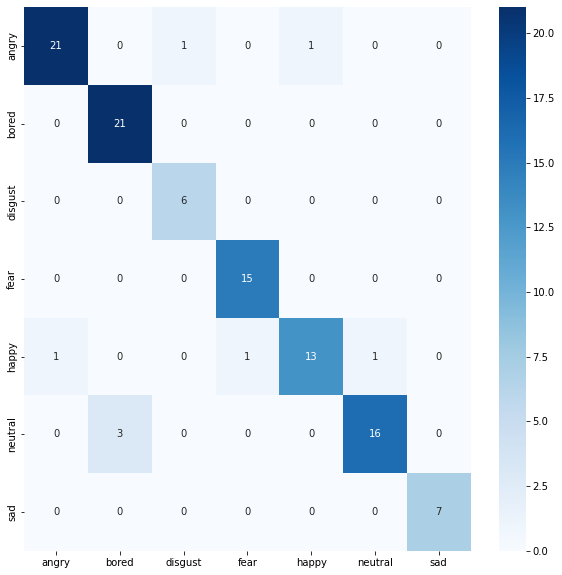

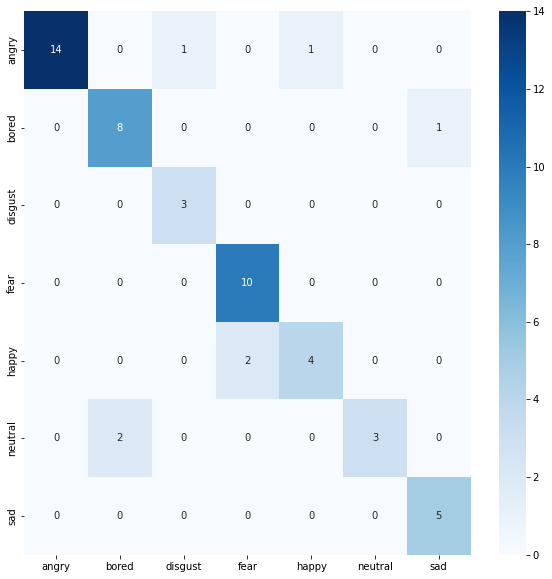

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_50"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-0275808af8909624/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9326 
[Epoch][Batch] = [1][19] -> Loss = 1.9327 
[Epoch][Batch] = [1][38] -> Loss = 1.9396 
[Epoch][Batch] = [1][57] -> Loss = 1.9365 
[Epoch][Batch] = [1][76] -> Loss = 1.9345 
best_acc  0.3925233644859813
	Train -> Loss = 1.9293 /  accuracy = 0.2273
	Validation -> Loss = 1.8758 /  accuracy = 0.3925
[Epoch][Batch] = [2][0] -> Loss = 1.8621 
[Epoch][Batch] = [2][19] -> Loss = 1.9001 
[Epoch][Batch] = [2][38] -> Loss = 1.8736 

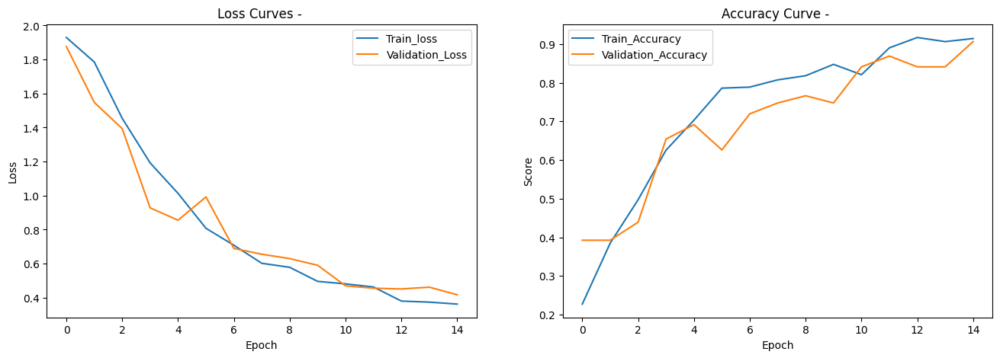

------------------------------ 
Best result on validation set -> Loss = 0.4425566855956007 Accuracy = 86.92 %
Validation Report
[('angry', 1.0), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 0.8666666666666667), ('happy', 0.5625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.82      1.00      0.90        23
       bored       0.90      0.86      0.88        21
     disgust       1.00      1.00      1.00         6
        fear       0.93      0.87      0.90        15
       happy       0.82      0.56      0.67        16
     neutral       0.89      0.89      0.89        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.87       107
   macro avg       0.88      0.88      0.87       107
weighted avg       0.87      0.87      0.86       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.30161623284220695 Accuracy = 90.74 %
[

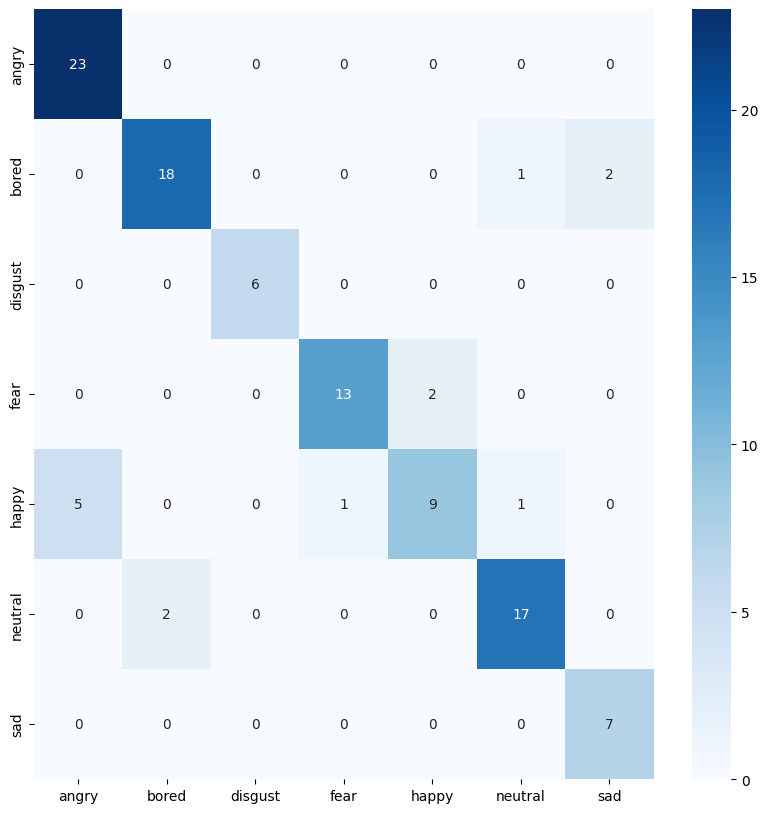

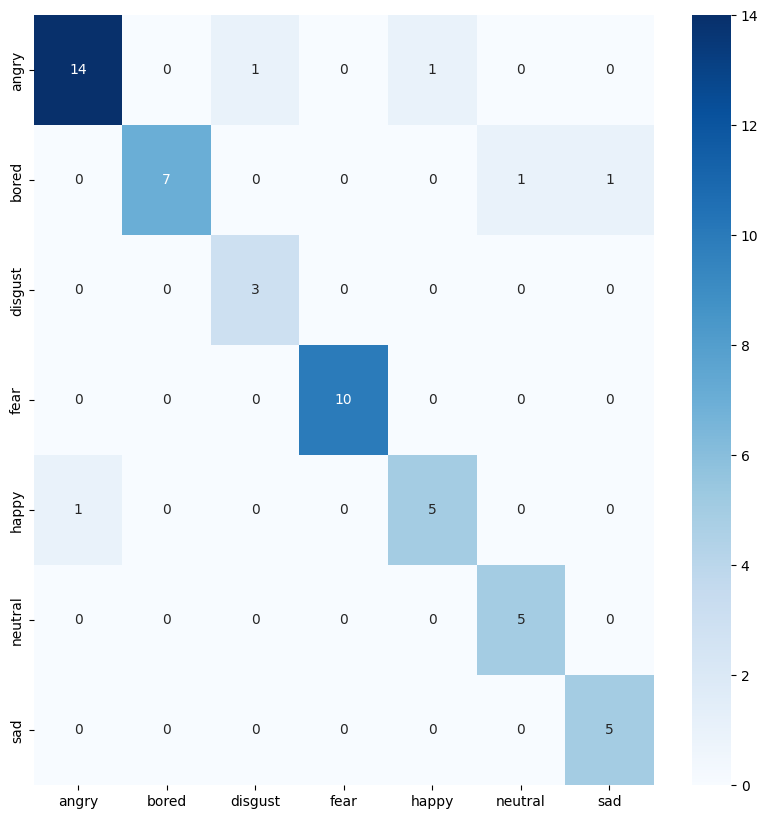

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_50"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-91025787e1905826/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9632 
[Epoch][Batch] = [1][19] -> Loss = 1.9397 
[Epoch][Batch] = [1][38] -> Loss = 1.9390 
[Epoch][Batch] = [1][57] -> Loss = 1.9383 
[Epoch][Batch] = [1][76] -> Loss = 1.9340 
best_acc  0.35514018691588783
	Train -> Loss = 1.9301 /  accuracy = 0.1952
	Validation -> Loss = 1.8821 /  accuracy = 0.3551
[Epoch][Batch] = [2][0] -> Loss = 1.9018 
[Epoch][Batch] = [2][19] -> Loss = 1.8921 
[Epoch][Batch] = [2][38] -> Loss = 1.8729

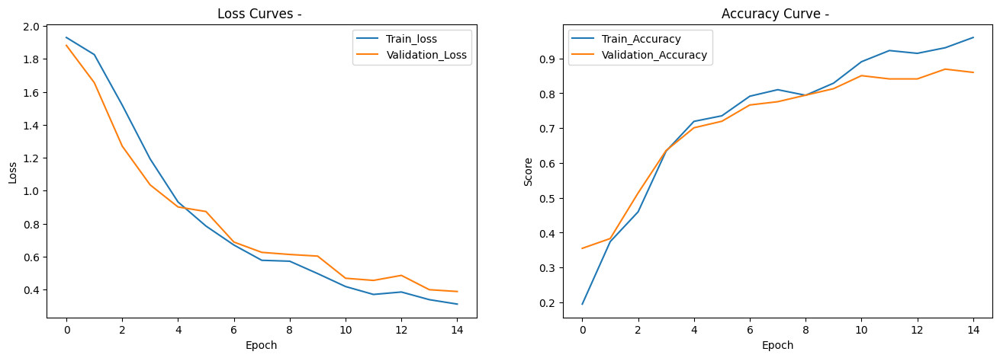

------------------------------ 
Best result on validation set -> Loss = 0.37941388068375764 Accuracy = 85.98 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8095238095238095), ('disgust', 1.0), ('fear', 0.9333333333333333), ('happy', 0.625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.84      0.91      0.87        23
       bored       0.89      0.81      0.85        21
     disgust       1.00      1.00      1.00         6
        fear       0.93      0.93      0.93        15
       happy       0.83      0.62      0.71        16
     neutral       0.85      0.89      0.87        19
         sad       0.70      1.00      0.82         7

    accuracy                           0.86       107
   macro avg       0.86      0.88      0.87       107
weighted avg       0.86      0.86      0.86       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.3329102982367788 Accura

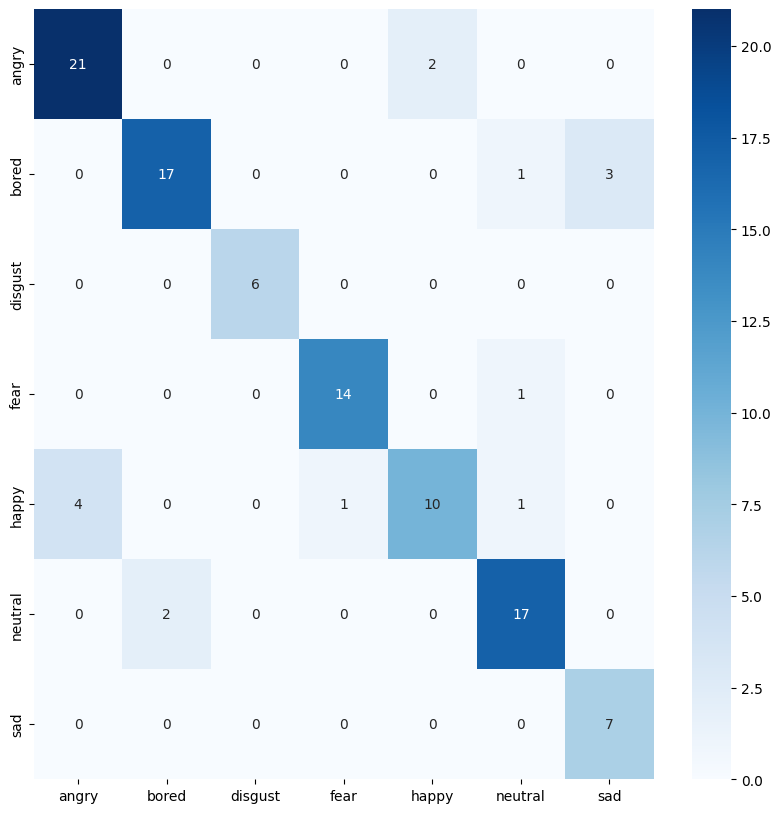

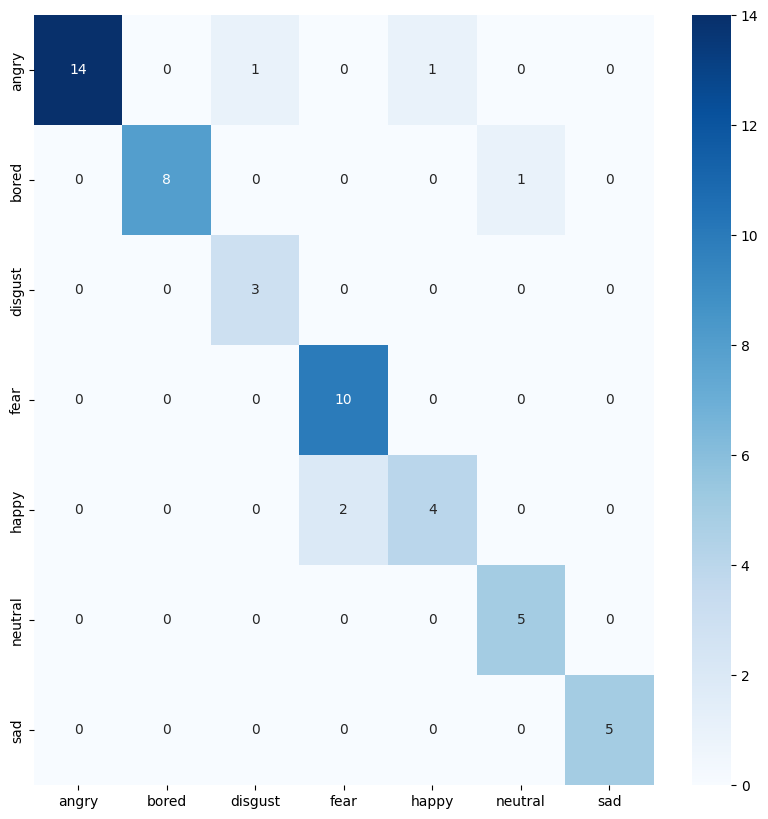

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_50"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-5a756d3439cdab30/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9625 
[Epoch][Batch] = [1][19] -> Loss = 1.9466 
[Epoch][Batch] = [1][38] -> Loss = 1.9454 
[Epoch][Batch] = [1][57] -> Loss = 1.9370 
[Epoch][Batch] = [1][76] -> Loss = 1.9292 
best_acc  0.4672897196261682
	Train -> Loss = 1.9248 /  accuracy = 0.2193
	Validation -> Loss = 1.8589 /  accuracy = 0.4673
[Epoch][Batch] = [2][0] -> Loss = 1.8721 
[Epoch][Batch] = [2][19] -> Loss = 1.8562 
[Epoch][Batch] = [2][38] -> Loss = 1.8382 

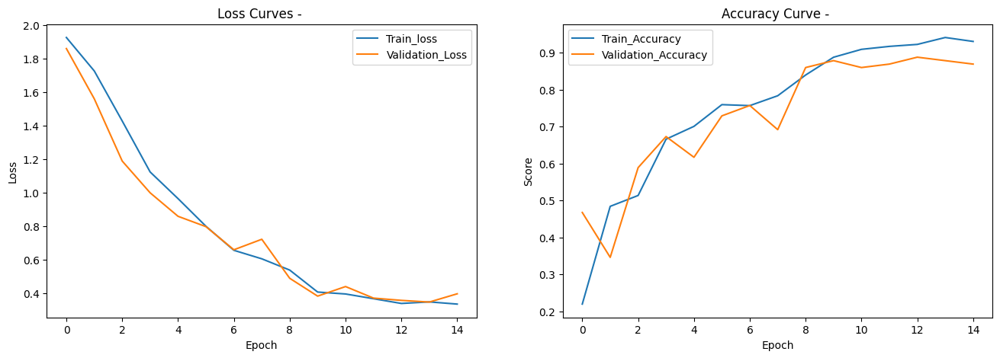

------------------------------ 
Best result on validation set -> Loss = 0.33855693842525836 Accuracy = 88.79 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.8571428571428571), ('disgust', 1.0), ('fear', 1.0), ('happy', 0.6875), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.84      0.91      0.87        23
       bored       0.90      0.86      0.88        21
     disgust       1.00      1.00      1.00         6
        fear       1.00      1.00      1.00        15
       happy       0.85      0.69      0.76        16
     neutral       0.89      0.89      0.89        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.89       107
   macro avg       0.89      0.91      0.90       107
weighted avg       0.89      0.89      0.89       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.26823693034904345 Accuracy = 90.74 %


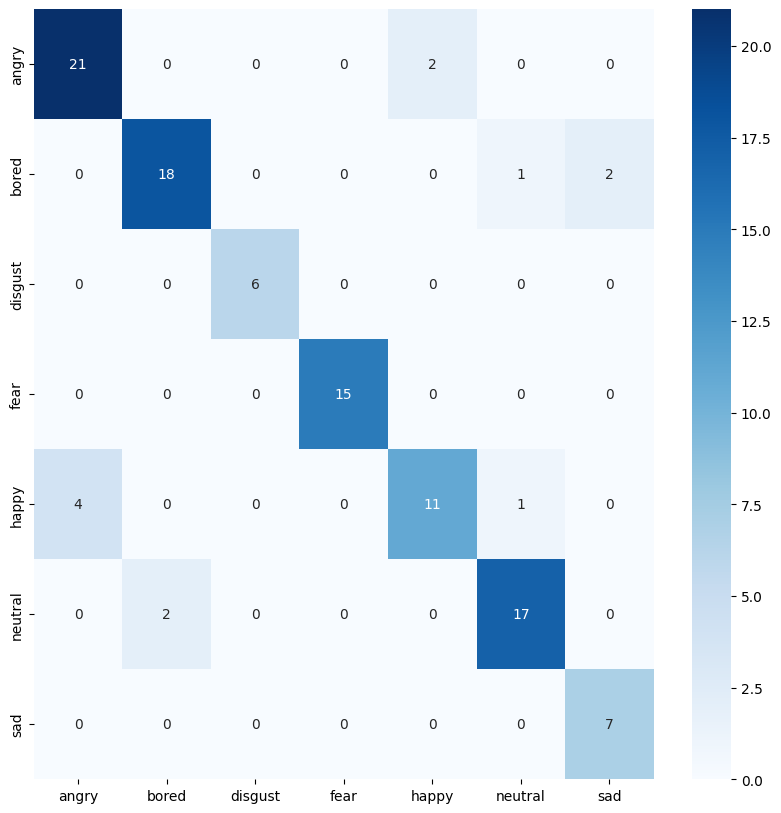

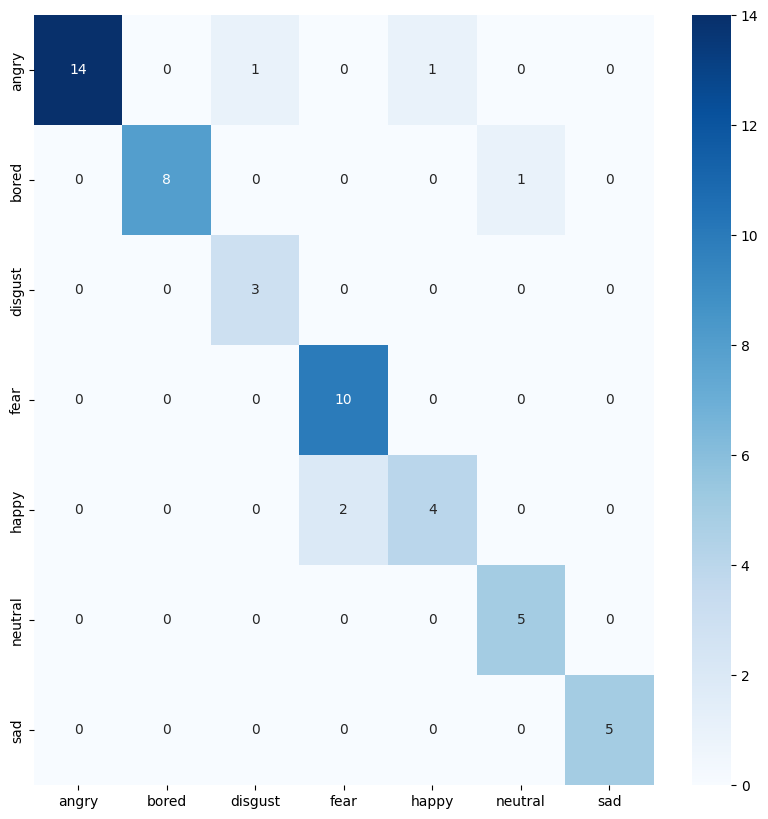

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_55"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-6266d793758c8c70/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9205 
[Epoch][Batch] = [1][19] -> Loss = 1.9482 
[Epoch][Batch] = [1][38] -> Loss = 1.9380 
[Epoch][Batch] = [1][57] -> Loss = 1.9367 
[Epoch][Batch] = [1][76] -> Loss = 1.9336 
best_acc  0.42990654205607476
	Train -> Loss = 1.9299 /  accuracy = 0.1818
	Validation -> Loss = 1.8660 /  accuracy = 0.4299
[Epoch][Batch] = [2][0] -> Loss = 1.7984 
[Epoch][Batch] = [2][19] -> Loss = 1.8632 
[Epoch][Batch] = [2][38] -> Loss = 1.8604

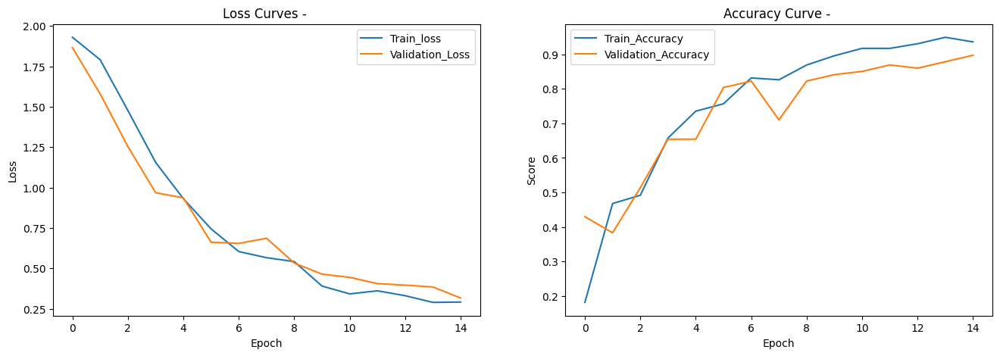

------------------------------ 
Best result on validation set -> Loss = 0.34404939592436506 Accuracy = 88.79 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.875), ('neutral', 0.7894736842105263), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.96      0.96      0.96        23
       bored       0.83      0.95      0.89        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.73      0.85        15
       happy       0.82      0.88      0.85        16
     neutral       0.83      0.79      0.81        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.89       107
   macro avg       0.90      0.90      0.90       107
weighted avg       0.89      0.89      0.89       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.20892701856791973 Accur

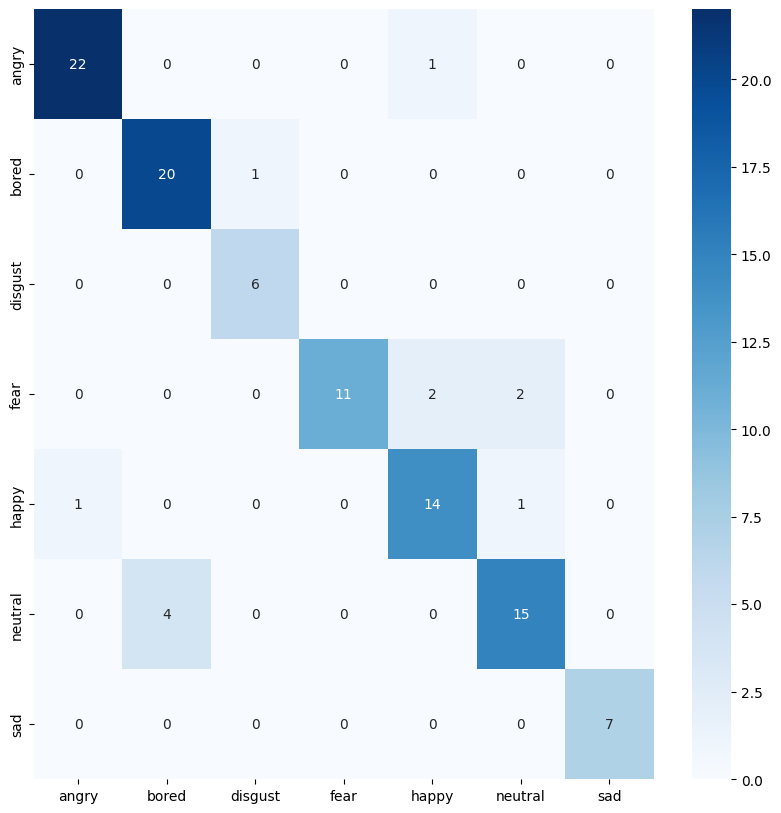

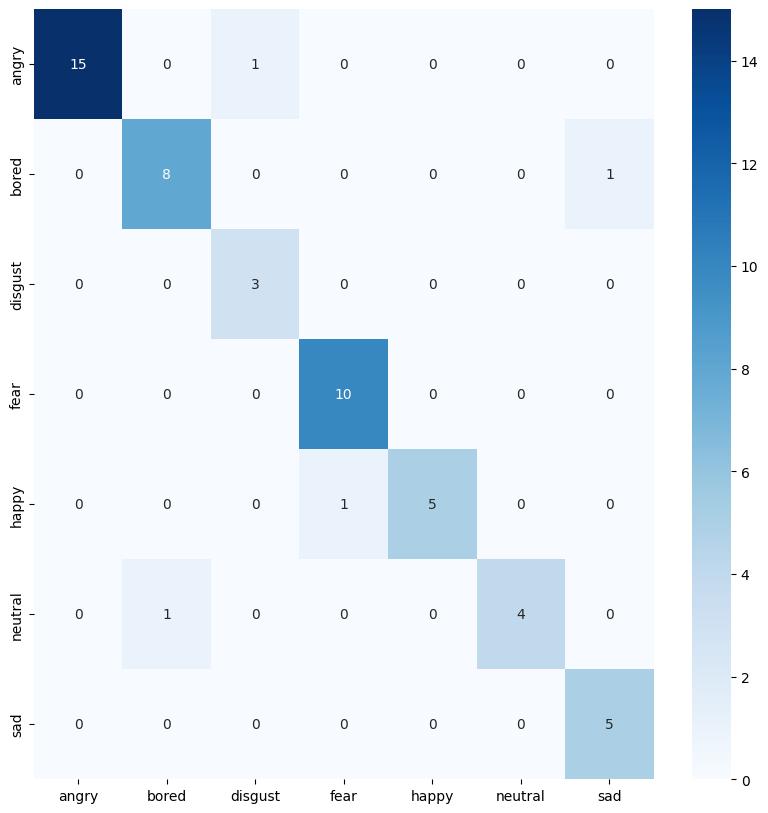

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_55"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-1837fc377e590116/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9344 
[Epoch][Batch] = [1][19] -> Loss = 1.9487 
[Epoch][Batch] = [1][38] -> Loss = 1.9393 
[Epoch][Batch] = [1][57] -> Loss = 1.9342 
[Epoch][Batch] = [1][76] -> Loss = 1.9341 
best_acc  0.42990654205607476
	Train -> Loss = 1.9288 /  accuracy = 0.2888
	Validation -> Loss = 1.8801 /  accuracy = 0.4299
[Epoch][Batch] = [2][0] -> Loss = 1.8600 
[Epoch][Batch] = [2][19] -> Loss = 1.8719 
[Epoch][Batch] = [2][38] -> Loss = 1.8656

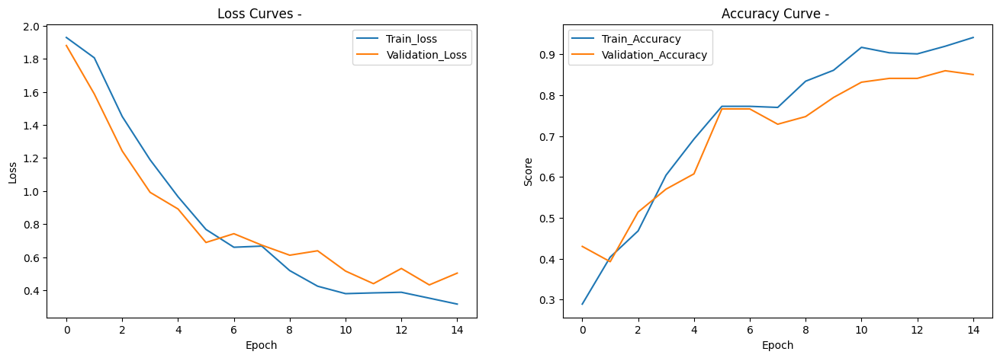

------------------------------ 
Best result on validation set -> Loss = 0.4221234616857988 Accuracy = 85.98 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.7333333333333333), ('happy', 0.625), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.81      0.96      0.88        23
       bored       0.90      0.90      0.90        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.73      0.85        15
       happy       0.77      0.62      0.69        16
     neutral       0.89      0.89      0.89        19
         sad       0.78      1.00      0.88         7

    accuracy                           0.86       107
   macro avg       0.86      0.87      0.86       107
weighted avg       0.87      0.86      0.86       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.2219544712986265 Accurac

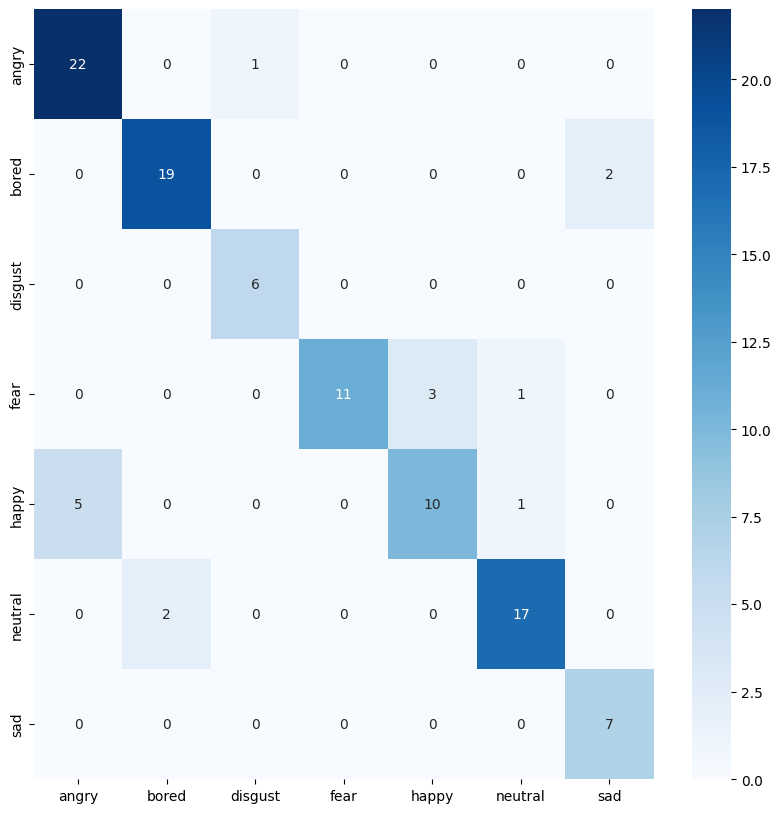

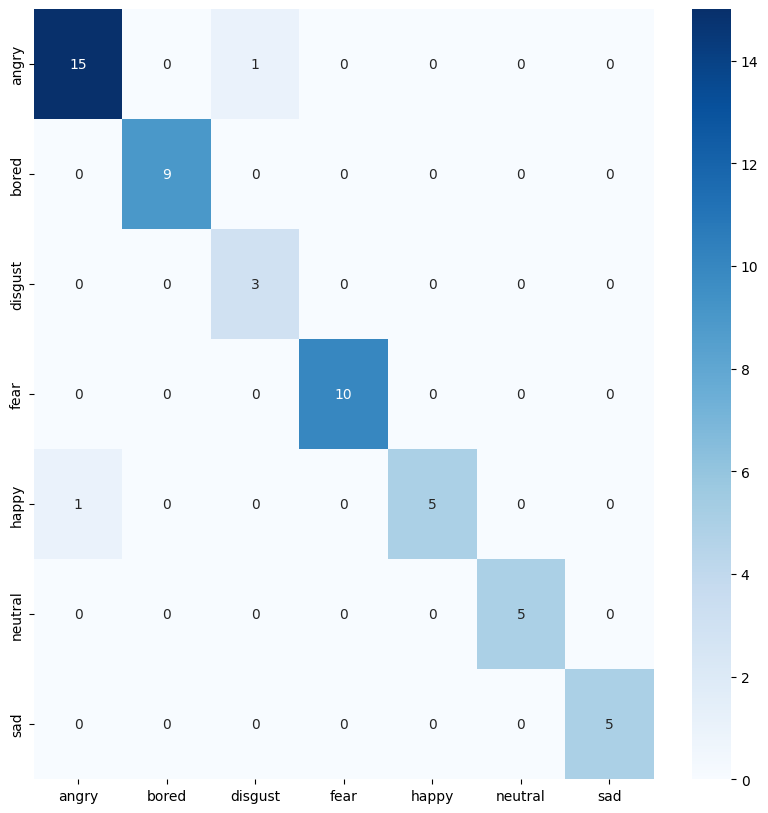

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_55"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-f35ec788f28c1cd1/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9574 
[Epoch][Batch] = [1][19] -> Loss = 1.9452 
[Epoch][Batch] = [1][38] -> Loss = 1.9470 
[Epoch][Batch] = [1][57] -> Loss = 1.9404 
[Epoch][Batch] = [1][76] -> Loss = 1.9345 
best_acc  0.4766355140186916
	Train -> Loss = 1.9293 /  accuracy = 0.1898
	Validation -> Loss = 1.8738 /  accuracy = 0.4766
[Epoch][Batch] = [2][0] -> Loss = 1.8773 
[Epoch][Batch] = [2][19] -> Loss = 1.8669 
[Epoch][Batch] = [2][38] -> Loss = 1.8689 

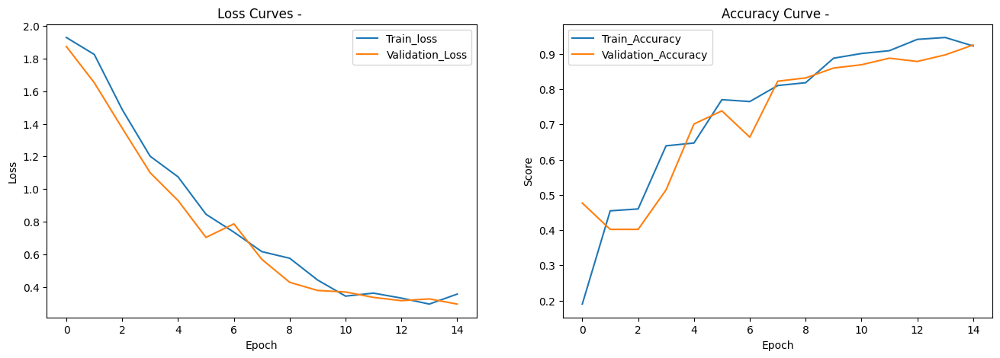

------------------------------ 
Best result on validation set -> Loss = 0.27103705179912074 Accuracy = 91.59 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.75), ('neutral', 1.0), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.88      0.96      0.92        23
       bored       1.00      0.95      0.98        21
     disgust       0.86      1.00      0.92         6
        fear       1.00      0.80      0.89        15
       happy       0.75      0.75      0.75        16
     neutral       0.95      1.00      0.97        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.92       107
   macro avg       0.92      0.92      0.92       107
weighted avg       0.92      0.92      0.92       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.21920865401625633 Accuracy = 94.44 %
[('angry', 0.9375

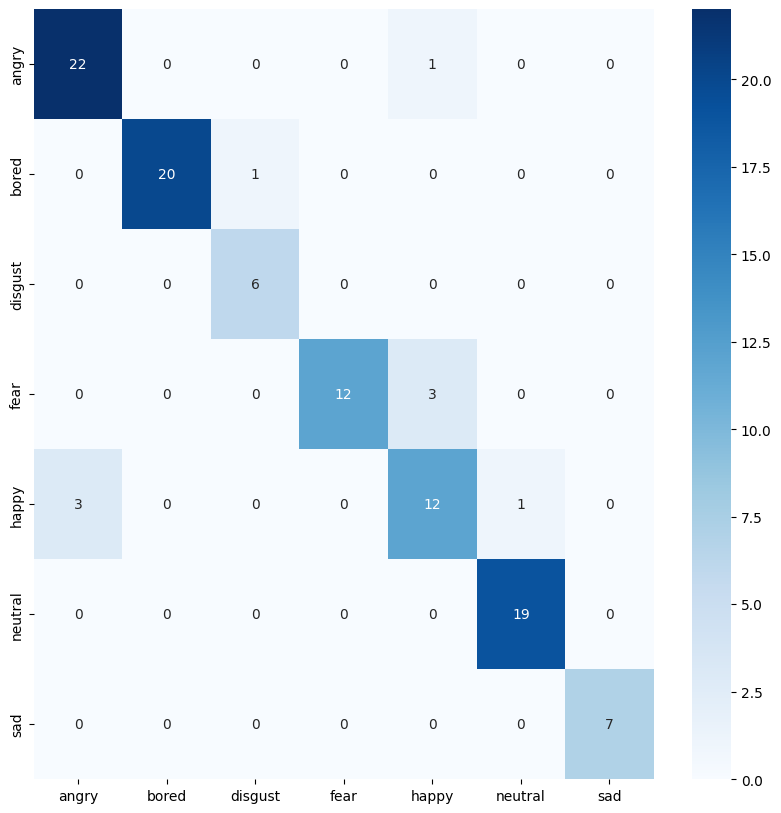

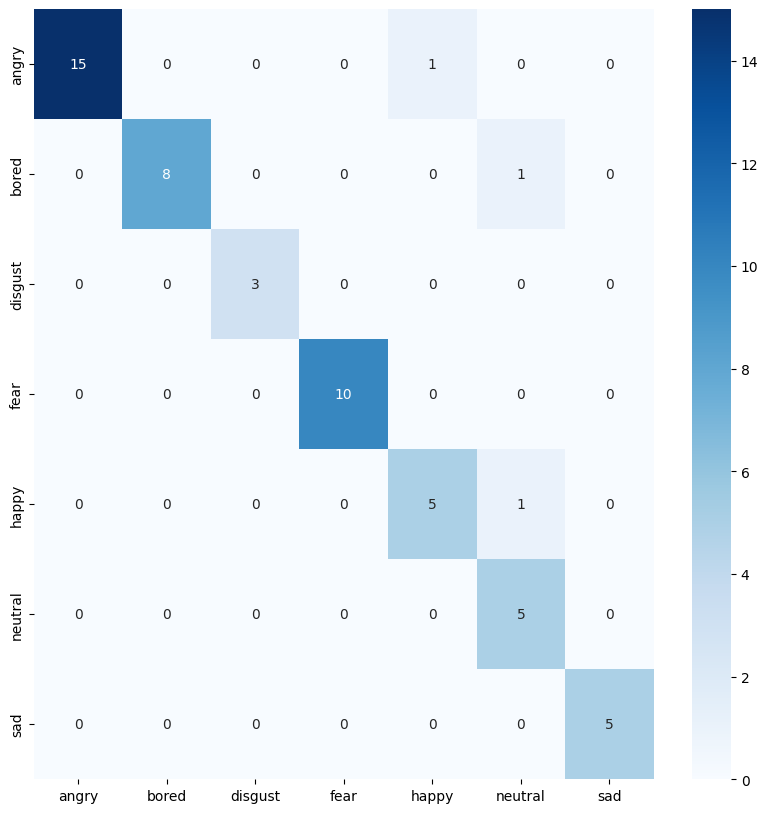

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_60"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-a5a75cfd9ed6d128/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9734 
[Epoch][Batch] = [1][19] -> Loss = 1.9423 
[Epoch][Batch] = [1][38] -> Loss = 1.9367 
[Epoch][Batch] = [1][57] -> Loss = 1.9360 
[Epoch][Batch] = [1][76] -> Loss = 1.9337 
best_acc  0.4485981308411215
	Train -> Loss = 1.9284 /  accuracy = 0.2567
	Validation -> Loss = 1.8770 /  accuracy = 0.4486
[Epoch][Batch] = [2][0] -> Loss = 1.8489 
[Epoch][Batch] = [2][19] -> Loss = 1.8772 
[Epoch][Batch] = [2][38] -> Loss = 1.8627 

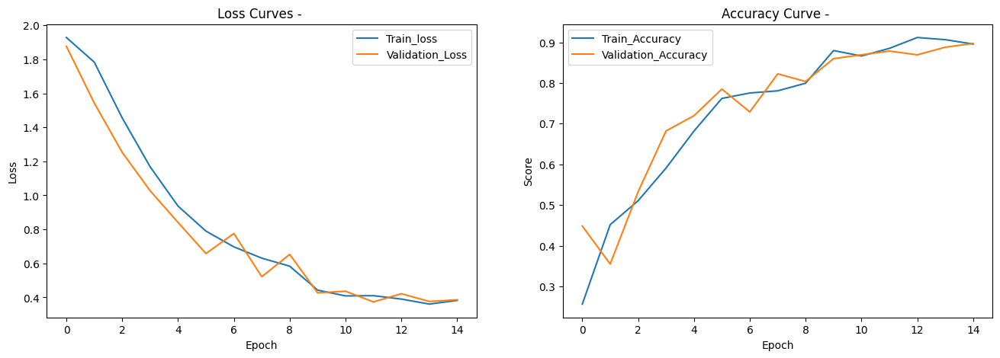

------------------------------ 
Best result on validation set -> Loss = 0.36585952810667177 Accuracy = 86.92 %
Validation Report
[('angry', 0.9565217391304348), ('bored', 0.9523809523809523), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.625), ('neutral', 0.8421052631578947), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.85      0.96      0.90        23
       bored       0.87      0.95      0.91        21
     disgust       1.00      1.00      1.00         6
        fear       0.92      0.80      0.86        15
       happy       0.77      0.62      0.69        16
     neutral       0.84      0.84      0.84        19
         sad       1.00      1.00      1.00         7

    accuracy                           0.87       107
   macro avg       0.89      0.88      0.89       107
weighted avg       0.87      0.87      0.87       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.258777166051524 Accuracy = 96.30 %
[('

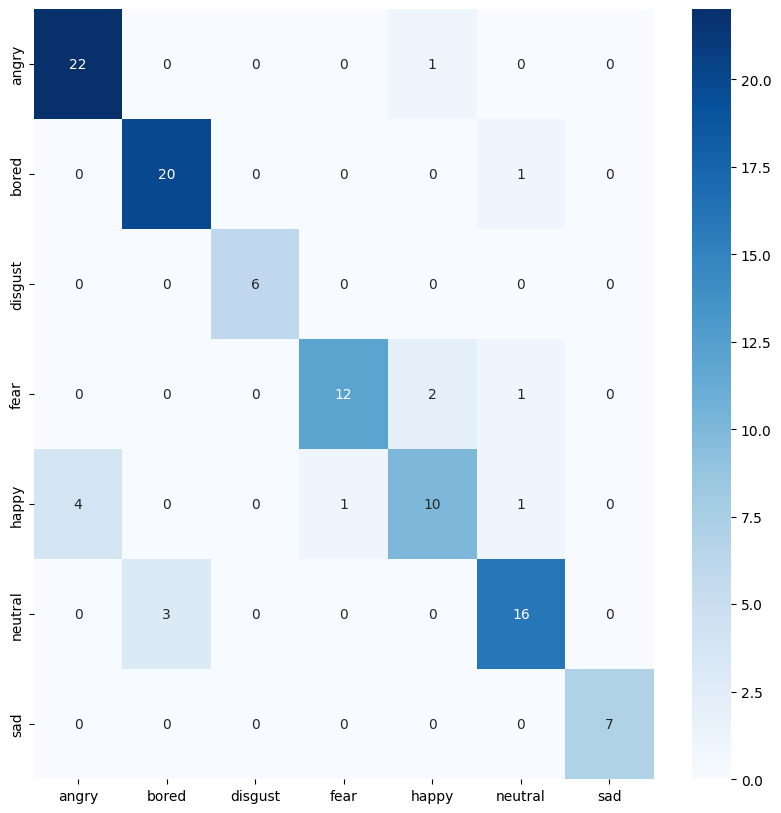

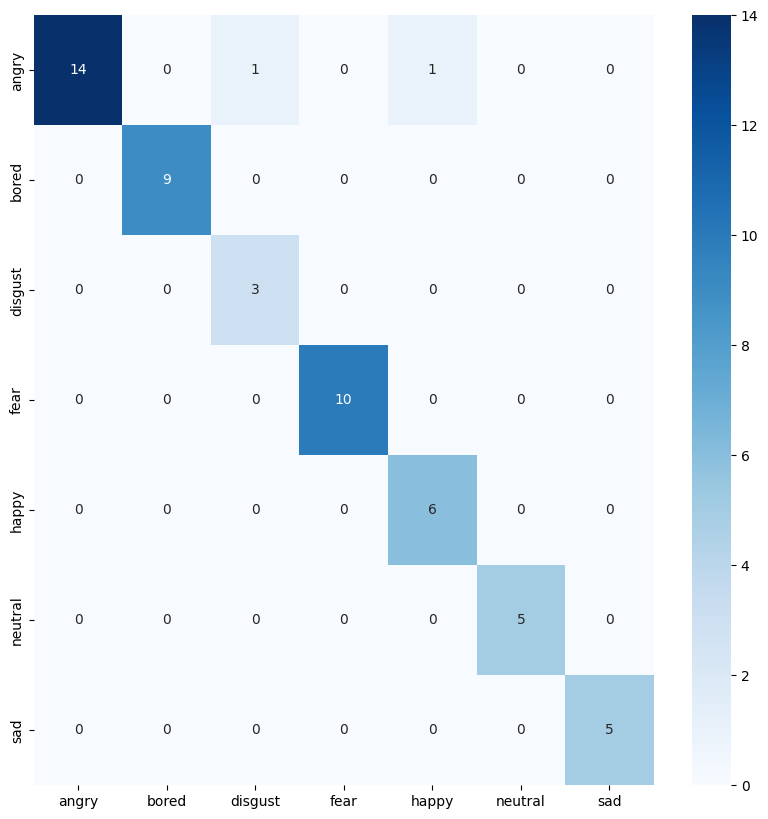

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_60"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-27bf05aca8953542/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 374
Number of Validation samples = 107
Number of Test samples = 54
----------------------------------------
Number of Train batches = 94 | batch size = 4
Number of Validation batches = 27 | batch size = 4
Number of Test batches = 14 | batch size = 4
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 1.9510 
[Epoch][Batch] = [1][19] -> Loss = 1.9571 
[Epoch][Batch] = [1][38] -> Loss = 1.9481 
[Epoch][Batch] = [1][57] -> Loss = 1.9426 
[Epoch][Batch] = [1][76] -> Loss = 1.9355 
best_acc  0.27102803738317754
	Train -> Loss = 1.9326 /  accuracy = 0.2032
	Validation -> Loss = 1.8930 /  accuracy = 0.2710
[Epoch][Batch] = [2][0] -> Loss = 1.9422 
[Epoch][Batch] = [2][19] -> Loss = 1.9073 
[Epoch][Batch] = [2][38] -> Loss = 1.8908

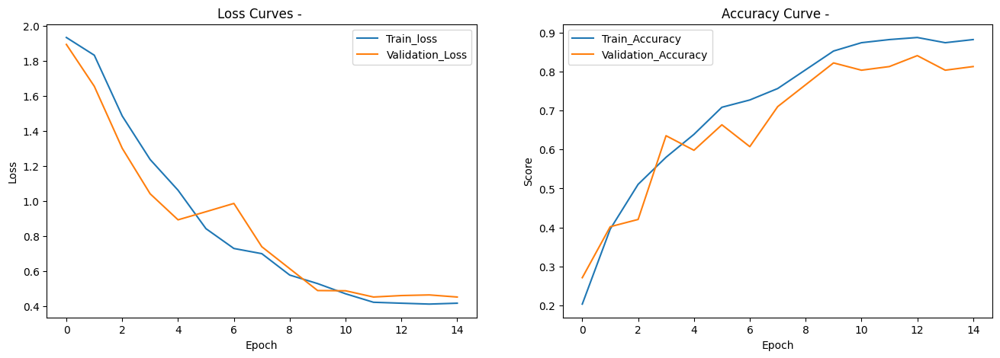

------------------------------ 
Best result on validation set -> Loss = 0.46258959615672074 Accuracy = 82.24 %
Validation Report
[('angry', 0.9130434782608695), ('bored', 0.9047619047619048), ('disgust', 1.0), ('fear', 0.8), ('happy', 0.375), ('neutral', 0.8947368421052632), ('sad', 1.0)]
              precision    recall  f1-score   support

       angry       0.70      0.91      0.79        23
       bored       0.90      0.90      0.90        21
     disgust       0.75      1.00      0.86         6
        fear       1.00      0.80      0.89        15
       happy       0.60      0.38      0.46        16
     neutral       0.94      0.89      0.92        19
         sad       0.88      1.00      0.93         7

    accuracy                           0.82       107
   macro avg       0.82      0.84      0.82       107
weighted avg       0.82      0.82      0.81       107

Test Report
------------------------------ 
Result on Test set -> Loss = 0.36119909957051277 Accuracy = 90.74 %
[

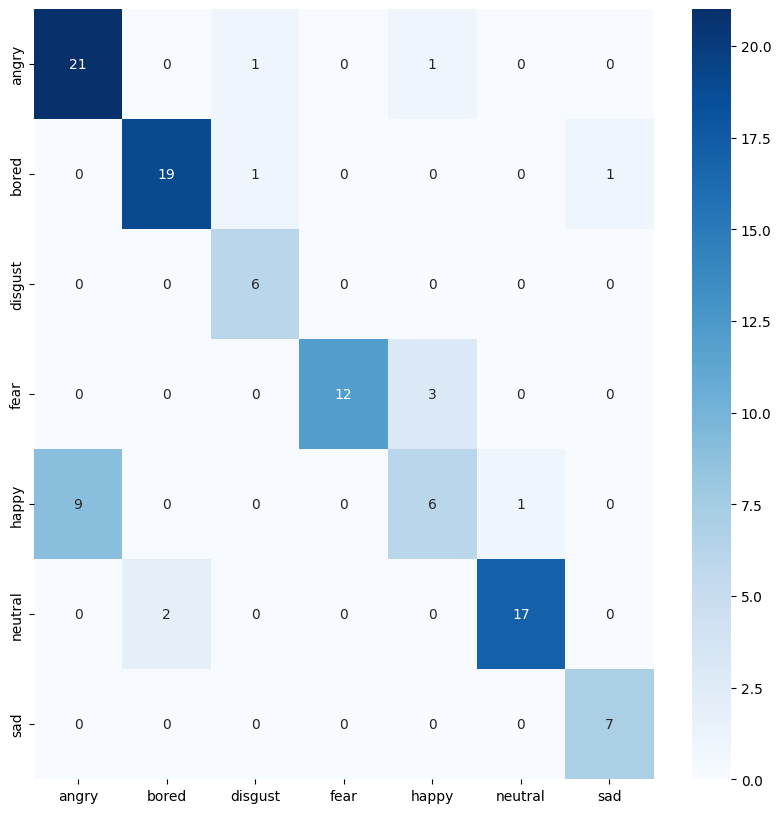

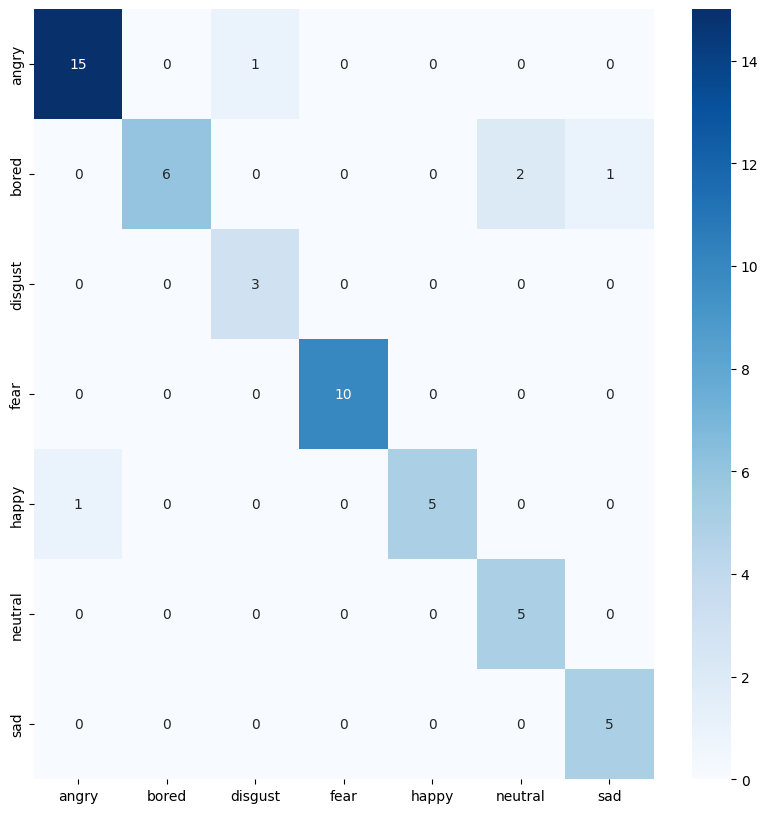

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/EmodB_without_silence_60"


v1,v2=trainModel(f1,
                 f1_val,
                 f1_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=4,
              val_bs=4,
              test_bs=4
              )
val_acc.append(v1)
test_acc.append(v2)


print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
input_dir="/content/drive/MyDrive/BTP/Ravdess_without_silence"

if os.path.exists(input_dir)==False:
    try:
      os.mkdir(input_dir)
      print("Directory \"wav_data\" created.")

    except OSError as error:
      print(error)


In [ ]:
for dirname, _, filenames in os.walk(input_dir):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-08-01-02-02-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-07-01-02-02-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-06-02-01-02-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-07-02-02-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-07-02-01-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-08-01-02-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-06-02-01-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-08-02-01-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-06-01-01-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-06-02-02-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-07-01-02-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-08-01-01-01-15.wav
/content/drive/MyDrive/BTP/Ravdess_without_silence/03-01-08-01-01-02-15.wav
/content/dri

In [ ]:
def getlabel2(name):

  x='unknown'
  if name[6:8]=='01':
    x='neutral'
  elif name[6:8]=='02':
    x='calm'
  elif name[6:8]=='03':
    x='happy'
  elif name[6:8]=='04':
    x='sad'
  elif name[6:8]=='05':
    x='angry'
  elif name[6:8]=='06':
    x='fearful'
  elif name[6:8]=='07':
    x='disgust'
  elif name[6:8]=='08':
    x='surprised'
  #print(name,x)
  return x

In [ ]:
epochs = 30
# train batch size
bs = 1
# learning rate
lr = 1e-5
# weight decay
wd = 0.002
# Scheduler gamma
sc_g = 0.1
# Scheduler step
sc_s = 10

data_path = input_dir
# train/validation split ratio
train_size = 0.8

# pre-trained transformer based model
model_checkpoint = "facebook/hubert-base-ls960"

In [ ]:
# def load_data2(path, extension='.wav'):
#   """
#   Goal : collect all data samples (audio files) with specified data type (extension) that exist in given path
#       and also label samples
#   Output : A pandas dataframe that includes data sample path and its label
#   """
#   if not os.path.isdir(path):
#     print('Dataset path does not exist ')
#     quit()
#   else:

#     audios,audios_val,audios_test = get_all_files(path, extension)
#     # Get the file name as its label
#     labels = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios]
#     labels_val = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios_val]

#     labels_test = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios_test]
#     if len(audios) == 0:

#       print('There is no sample in dataset')
#       quit()
#     else:

#       # Encode labels to digits
#       le = preprocessing.LabelEncoder()
#       labels = le.fit_transform(labels)
#       labels_val = le.fit_transform(labels_val)
#       labels_test = le.fit_transform(labels_test)
#       # Create pandas dataframe
#       df = pd.DataFrame({"path": audios, "label": labels})
#       df_val = pd.DataFrame({"path": audios_val, "label": labels_val})
#       df_test = pd.DataFrame({"path": audios_test, "label": labels_test})

#   return df,df_val, df_test, le

In [ ]:
def load_data2(path,files,files_val,files_test, extension='.wav'):
  """
  Goal : collect all data samples (audio files) with specified data type (extension) that exist in given path
      and also label samples
  Output : A pandas dataframe that includes data sample path and its label
  """
  if not os.path.isdir(path):
    print('Dataset path does not exist ')
    quit()
  else:

    audios=[0]*len(files)
    audios_val=[0]*len(files_val)
    audios_test=[0]*len(files_test)

    # audios,audios_val,audios_test = get_all_files(path, extension)
    for i in range(len(audios)):
      audios[i]=path+'/'+files[i]

    for i in range(len(audios_val)):
      audios_val[i]=path+'/'+files_val[i]

    for i in range(len(audios_test)):
      audios_test[i]=path+'/'+files_test[i]


    # Get the file name as its label
    labels = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios]
    labels_val = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios_val]

    labels_test = [getlabel2(os.path.basename(path).replace(extension, '')) for path in audios_test]
    if len(audios) == 0:

      print('There is no sample in dataset')
      quit()
    else:

      # Encode labels to digits
      le = preprocessing.LabelEncoder()
      labels = le.fit_transform(labels)
      labels_val = le.fit_transform(labels_val)
      labels_test = le.fit_transform(labels_test)
      # Create pandas dataframe
      df = pd.DataFrame({"path": audios, "label": labels})
      df_val = pd.DataFrame({"path": audios_val, "label": labels_val})
      df_test = pd.DataFrame({"path": audios_test, "label": labels_test})

  return df,df_val, df_test, le

In [ ]:
# def trainModel2(your_google_drive_path,data_path, check_point, lr, start_epoch,end_epoch, weight_decay, sch_gamma, sch_step, train_size, title='', train_bs=2,val_bs=2,test_bs=2):
#   # load data
#   #print(test_speaker,val_speaker)
#   df,df_val,df_test, label_encoder = load_data2(data_path)
#   print('-' * 70)
#   print('Data loaded successfully')
#   print('-' * 70)

#   # Plot data class distribution
#   # </> plot_dist(df, label_encoder.classes_)

#   # create dataset
#   dataset = make_dataset(df,df_val,df_test, train_size)
#   print('-' * 70)
#   print('Number of Train samples =', len(dataset['train']))
#   print('Number of Validation samples =', len(dataset['validation']))
#   print('Number of Test samples =', len(dataset['test']))

#   # instantiate data loaders
#   train_dataloader, val_dataloader,test_dataloader = get_data_loaders(dataset, train_bs, val_bs,test_bs)
#   print('-' * 40)
#   print('Number of Train batches =', len(train_dataloader), '| batch size =', train_bs)
#   print('Number of Validation batches =', len(val_dataloader), '| batch size =', val_bs)
#   print('Number of Test batches =', len(test_dataloader), '| batch size =', test_bs)


#   # Specify processor device
#   device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#   print('-' * 40)
#   print(device, 'is available')

#   # Instantiate model
#   num_classes = len(label_encoder.classes_)
#   model = get_model(check_point, num_classes, device)
#   print('-' * 40)
#   print('Model loaded successfully')

#   # Determine the type of : optimizer, scheduler and loss function

#   optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

#   scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=sch_step, gamma=sch_gamma)

#   fc_weights = get_classes_weight(dataset['train'][:]['label']).to(device)

#   criterion = nn.CrossEntropyLoss(weight=fc_weights)

#   best_acc = 0
#   loss_list, acc_list = [], []

#   # checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
#   # start_epoch = checkpoint['epoch']+1
#   # model.load_state_dict(checkpoint['model_state_dict'])
#   # optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

#   print('-' * 40)
#   print('Start Training ....\n')
#   for epoch in range(start_epoch,end_epoch):

#     #print('hi6')
#     train_loss, train_acc, _, _ = train(model, train_dataloader, optimizer, criterion, epoch, device)
#     #print('hi7')
#     val_loss, val_acc, _, _ = evaluate(model, val_dataloader, criterion, device)
#     #print('hi8')
#     scheduler.step()

#     loss_list.append([train_loss, val_loss])
#     acc_list.append([train_acc,val_acc])

#     if val_acc > best_acc:



#       best_acc = val_acc
#       print('best_acc  ',end="")
#       print(best_acc)
#       # torch.save(model, 'best-model.pt')

#       torch.save(
#             {'epoch':epoch,
#              'model_state_dict': model.state_dict(),
#              'optimizer_state_dict': optimizer.state_dict()
#              },

#              your_google_drive_path+'best_model.pth')


#     # torch.save(
#     #   {'epoch':epoch,
#     #     'model_state_dict': model.state_dict(),
#     #     'optimizer_state_dict': optimizer.state_dict()
#     #     },
#     #     your_google_drive_path+'checkpoint.pth')





#     print(f'\tTrain -> Loss = {train_loss:.4f} /  accuracy = {train_acc:.4f}')
#     print(f'\tValidation -> Loss = {val_loss:.4f} /  accuracy = {val_acc:.4f}')

#   plot_training(np.array(loss_list), np.array(acc_list), title)

#   best_model=get_model(check_point, num_classes, device)
#   checkpoint = torch.load(your_google_drive_path+'best_model.pth')
#   best_model.load_state_dict(checkpoint['model_state_dict'])

#   val_loss, val_acc, val_preds, val_labels = evaluate(best_model, val_dataloader, criterion, device)
#   print('-' * 30, '\nBest result on validation set -> Loss =', val_loss, f'Accuracy = {val_acc * 100:.2f} %')
#   print('Validation Report')
#   report(val_labels, val_preds, label_encoder)


#   print('Test Report')
#   test_loss, test_acc, test_preds, test_labels = evaluate(best_model, test_dataloader, criterion, device)
#   print('-' * 30, '\nResult on Test set -> Loss =', test_loss, f'Accuracy = {test_acc * 100:.2f} %')
#   report(test_labels, test_preds, label_encoder)

#   return val_acc,test_acc




In [ ]:
def trainModel2(df,df_val,df_test, label_encoder,files,files_val,files_test,data_path, check_point, lr, start_epoch,end_epoch, weight_decay, sch_gamma, sch_step, train_size, title='', train_bs=2,val_bs=2,test_bs=2):
  # load data
  #print(test_speaker,val_speaker)
  # df,df_val,df_test, label_encoder = load_data2(data_path,files,files_val,files_test)
  print('-' * 70)
  print('Data loaded successfully')
  print('-' * 70)

  # Plot data class distribution
  # </> plot_dist(df, label_encoder.classes_)

  # create dataset
  dataset = make_dataset(df,df_val,df_test, train_size)
  print('-' * 70)
  print('Number of Train samples =', len(dataset['train']))
  print('Number of Validation samples =', len(dataset['validation']))
  print('Number of Test samples =', len(dataset['test']))

  # instantiate data loaders
  train_dataloader, val_dataloader,test_dataloader = get_data_loaders(dataset, train_bs, val_bs,test_bs)
  print('-' * 40)
  print('Number of Train batches =', len(train_dataloader), '| batch size =', train_bs)
  print('Number of Validation batches =', len(val_dataloader), '| batch size =', val_bs)
  print('Number of Test batches =', len(test_dataloader), '| batch size =', test_bs)


  # Specify processor device
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  print('-' * 40)
  print(device, 'is available')

  # Instantiate model
  num_classes = len(label_encoder.classes_)
  model = get_model(check_point, num_classes, device)
  print('-' * 40)
  print('Model loaded successfully')

  # Determine the type of : optimizer, scheduler and loss function

  optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

  scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=sch_step, gamma=sch_gamma)

  fc_weights = get_classes_weight(dataset['train'][:]['label']).to(device)

  criterion = nn.CrossEntropyLoss(weight=fc_weights)

  best_acc = 0
  loss_list, acc_list = [], []

  # checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
  # start_epoch = checkpoint['epoch']+1
  # model.load_state_dict(checkpoint['model_state_dict'])
  # optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

  print('-' * 40)
  print('Start Training ....\n')
  for epoch in range(start_epoch,end_epoch):

    #print('hi6')
    train_loss, train_acc, _, _ = train(model, train_dataloader, optimizer, criterion, epoch, device)
    #print('hi7')
    val_loss, val_acc, _, _ = evaluate(model, val_dataloader, criterion, device)
    #print('hi8')
    scheduler.step()

    loss_list.append([train_loss, val_loss])
    acc_list.append([train_acc,val_acc])

    if val_acc > best_acc:



      best_acc = val_acc
      print('best_acc  ',end="")
      print(best_acc)
      torch.save(model, 'best-model.pt')

      # torch.save(
      #       {'epoch':epoch,
      #        'model_state_dict': model.state_dict(),
      #        'optimizer_state_dict': optimizer.state_dict()
      #        },

      #        your_google_drive_path+'best_model.pth')


    # torch.save(
    #   {'epoch':epoch,
    #     'model_state_dict': model.state_dict(),
    #     'optimizer_state_dict': optimizer.state_dict()
    #     },
    #     your_google_drive_path+'checkpoint.pth')





    print(f'\tTrain -> Loss = {train_loss:.4f} /  accuracy = {train_acc:.4f}')
    print(f'\tValidation -> Loss = {val_loss:.4f} /  accuracy = {val_acc:.4f}')

  plot_training(np.array(loss_list), np.array(acc_list), title)

  # best_model=get_model(check_point, num_classes, device)
  # checkpoint = torch.load(your_google_drive_path+'best_model.pth')
  # best_model.load_state_dict(checkpoint['model_state_dict'])

  best_model = torch.load('best-model.pt')

  val_loss, val_acc, val_preds, val_labels = evaluate(best_model, val_dataloader, criterion, device)
  print('-' * 30, '\nBest result on validation set -> Loss =', val_loss, f'Accuracy = {val_acc * 100:.2f} %')
  print('Validation Report')
  report(val_labels, val_preds, label_encoder)


  print('Test Report')
  test_loss, test_acc, test_preds, test_labels = evaluate(best_model, test_dataloader, criterion, device)
  print('-' * 30, '\nResult on Test set -> Loss =', test_loss, f'Accuracy = {test_acc * 100:.2f} %')
  report(test_labels, test_preds, label_encoder)

  return val_acc,test_acc,val_labels,val_preds,test_labels,test_preds




In [ ]:
# start_epoch=0
# end_epoch=30

# # checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# # start_epoch = checkpoint['epoch']+1
# # model.load_state_dict(checkpoint['model_state_dict'])
# # optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
# your_google_drive_path = "/content/drive/MyDrive/BTP/Ravdess_checkpoints/"


# v1,v2=trainModel2(your_google_drive_path,
#               data_path,
#               model_checkpoint,
#               lr,  # learning rate
#               start_epoch,
#               end_epoch,
#               wd,  # weight decay
#               sc_g,  # Scheduler gamma
#               sc_s,  # Scheduler step
#               train_size,
#               train_bs=4,
#               val_bs=4,
#               test_bs=4
#               )

In [ ]:
epochs = 30
# train batch size
bs = 1
# learning rate
lr = 1e-5
# weight decay
wd = 0.002
# Scheduler gamma
sc_g = 0.1
# Scheduler step
sc_s = 10

data_path = input_dir
# train/validation split ratio
train_size = 0.8
# pre-trained transformer based model
model_checkpoint = "facebook/hubert-base-ls960"

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]


----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-cdeb584a1143636b/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0870 
[Epoch][Batch] = [1][13] -> Loss = 2.0799 
[Epoch][Batch] = [1][26] -> Loss = 2.0779 
[Epoch][Batch] = [1][39] -> Loss = 2.0777 
[Epoch][Batch] = [1][52] -> Loss = 2.0760 
best_acc  0.4097222222222222
	Train -> Loss = 2.0743 /  accuracy = 0.1748
	Validation -> Loss = 2.0446 /  accuracy = 0.4097
[Epoch][Batch] = [2][0] -> Loss = 2.0521 
[Epoch][Batch] = [2][13] -> Loss = 2.0511 
[Epoch][Batch] = [2][26] -> Loss = 2.0

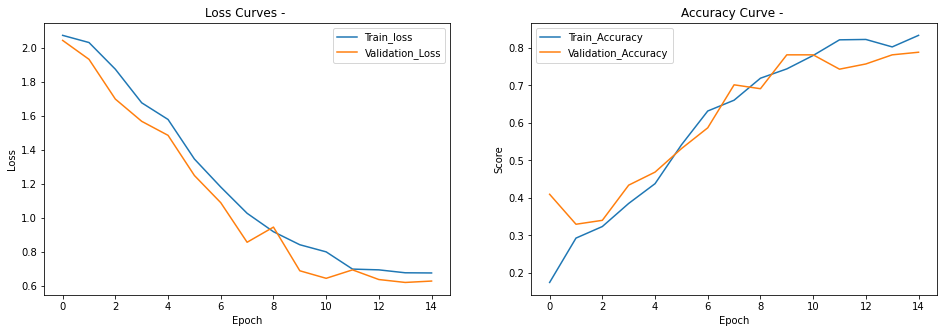

------------------------------ 
Best result on validation set -> Loss = 0.6271491878562503 Accuracy = 79.17 %
Validation Report
[('angry', 0.9230769230769231), ('calm', 0.9285714285714286), ('disgust', 0.972972972972973), ('fearful', 0.7209302325581395), ('happy', 0.696969696969697), ('neutral', 0.6666666666666666), ('sad', 0.46511627906976744), ('surprised', 0.8974358974358975)]
              precision    recall  f1-score   support

       angry       0.90      0.92      0.91        39
        calm       0.67      0.93      0.78        42
     disgust       0.90      0.97      0.94        37
     fearful       0.84      0.72      0.77        43
       happy       0.72      0.70      0.71        33
     neutral       0.62      0.67      0.64        12
         sad       0.74      0.47      0.57        43
   surprised       0.85      0.90      0.88        39

    accuracy                           0.79       288
   macro avg       0.78      0.78      0.77       288
weighted avg       0.

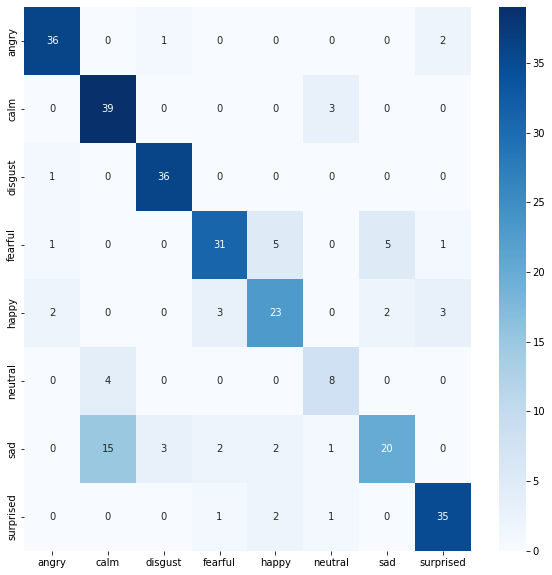

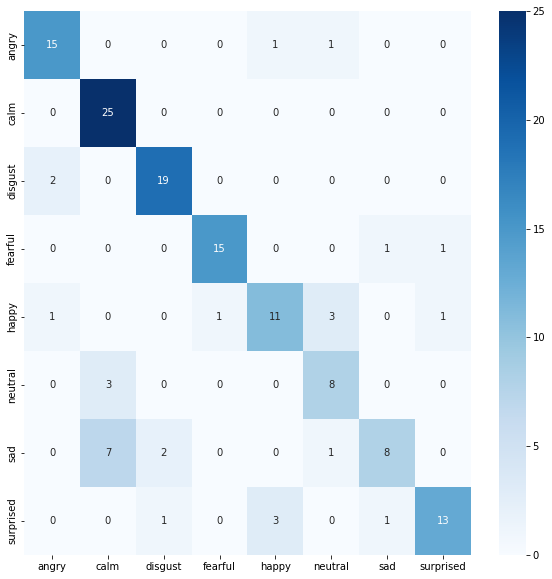

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-40ca49b6d8e6370a/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0818 
[Epoch][Batch] = [1][13] -> Loss = 2.0788 
[Epoch][Batch] = [1][26] -> Loss = 2.0762 
[Epoch][Batch] = [1][39] -> Loss = 2.0749 
[Epoch][Batch] = [1][52] -> Loss = 2.0725 
best_acc  0.3020833333333333
	Train -> Loss = 2.0699 /  accuracy = 0.1768
	Validation -> Loss = 2.0428 /  accuracy = 0.3021
[Epoch][Batch] = [2][0] -> Loss = 2.0484 
[Epoch][Batch] = [2][13] -> Loss = 2.0411 
[Epoch][Batch] = [2][26] -> Loss = 2.0

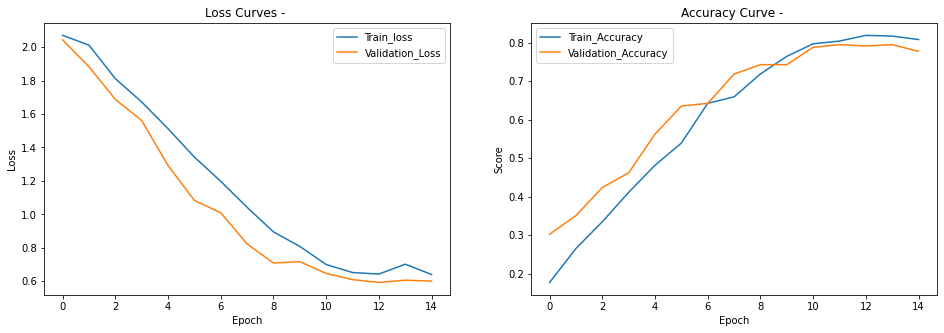

------------------------------ 
Best result on validation set -> Loss = 0.614064269595676 Accuracy = 79.17 %
Validation Report
[('angry', 0.8974358974358975), ('calm', 0.9285714285714286), ('disgust', 0.9210526315789473), ('fearful', 0.7906976744186046), ('happy', 0.53125), ('neutral', 0.75), ('sad', 0.5116279069767442), ('surprised', 0.9487179487179487)]
              precision    recall  f1-score   support

       angry       0.88      0.90      0.89        39
        calm       0.72      0.93      0.81        42
     disgust       0.88      0.92      0.90        38
     fearful       0.87      0.79      0.83        43
       happy       0.63      0.53      0.58        32
     neutral       0.60      0.75      0.67        12
         sad       0.69      0.51      0.59        43
   surprised       0.90      0.95      0.92        39

    accuracy                           0.79       288
   macro avg       0.77      0.78      0.77       288
weighted avg       0.79      0.79      0.79   

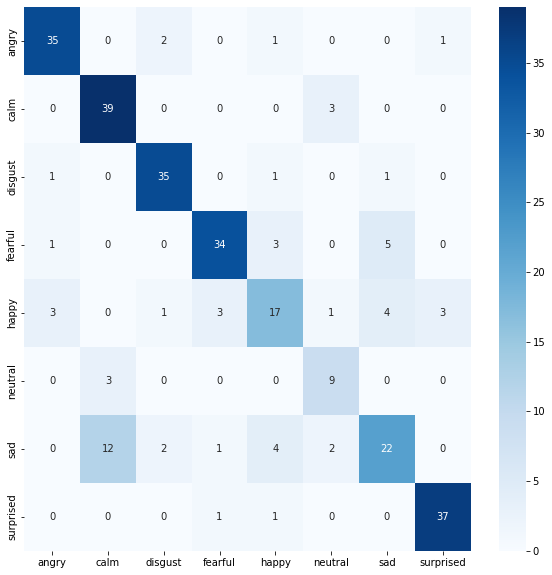

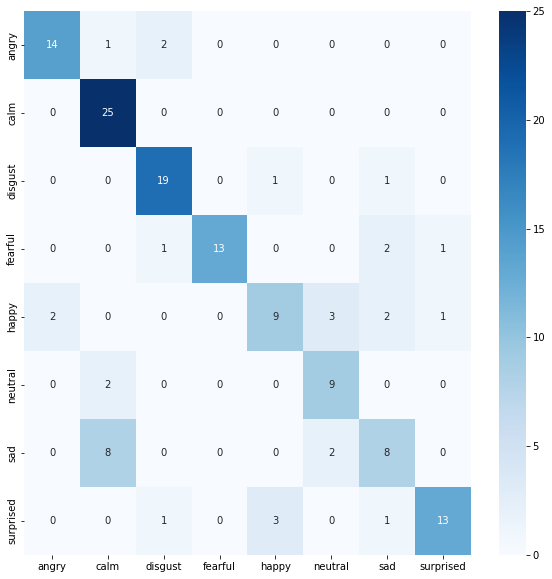

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-b6516ef26d4b6da9/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0883 
[Epoch][Batch] = [1][13] -> Loss = 2.0780 
[Epoch][Batch] = [1][26] -> Loss = 2.0790 
[Epoch][Batch] = [1][39] -> Loss = 2.0766 
[Epoch][Batch] = [1][52] -> Loss = 2.0732 
best_acc  0.2986111111111111
	Train -> Loss = 2.0723 /  accuracy = 0.1847
	Validation -> Loss = 2.0491 /  accuracy = 0.2986
[Epoch][Batch] = [2][0] -> Loss = 2.0470 
[Epoch][Batch] = [2][13] -> Loss = 2.0577 
[Epoch][Batch] = [2][26] -> Loss = 2.0

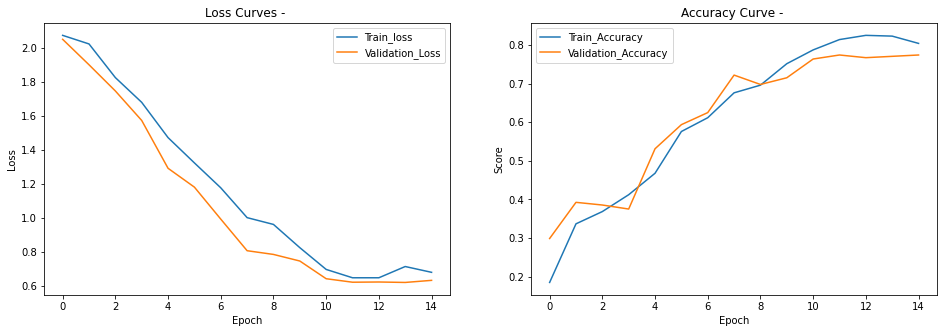

------------------------------ 
Best result on validation set -> Loss = 0.6311027672555711 Accuracy = 76.39 %
Validation Report
[('angry', 0.9230769230769231), ('calm', 0.8095238095238095), ('disgust', 0.972972972972973), ('fearful', 0.6976744186046512), ('happy', 0.5757575757575758), ('neutral', 0.8333333333333334), ('sad', 0.5116279069767442), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.88      0.92      0.90        39
        calm       0.67      0.81      0.73        42
     disgust       0.88      0.97      0.92        37
     fearful       0.81      0.70      0.75        43
       happy       0.68      0.58      0.62        33
     neutral       0.59      0.83      0.69        12
         sad       0.59      0.51      0.55        43
   surprised       0.92      0.85      0.88        39

    accuracy                           0.76       288
   macro avg       0.75      0.77      0.76       288
weighted avg       0.

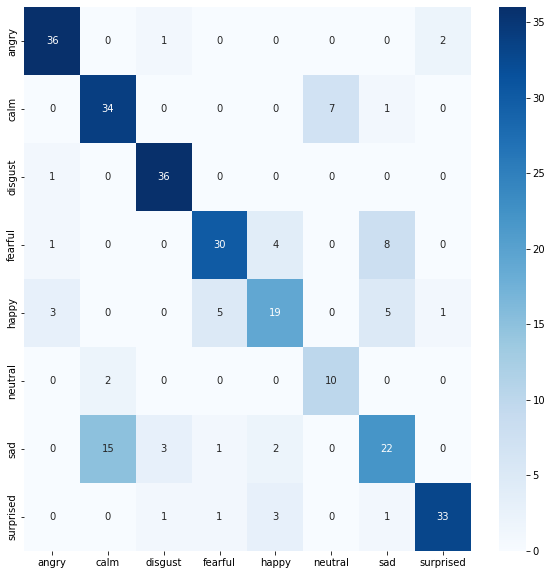

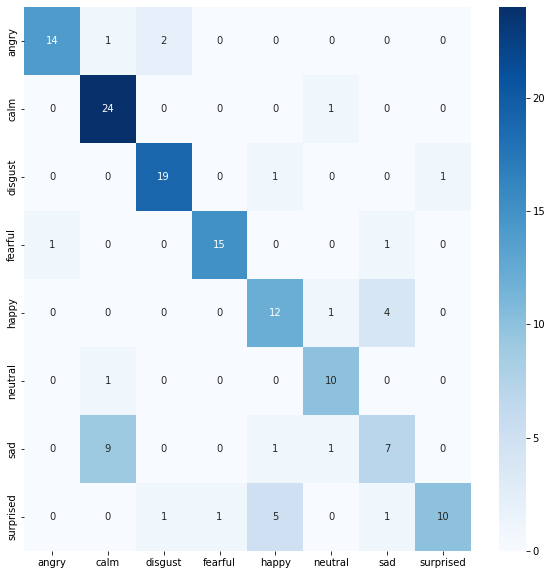

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-445cf61314b5eb67/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0976 
[Epoch][Batch] = [1][13] -> Loss = 2.0813 
[Epoch][Batch] = [1][26] -> Loss = 2.0792 
[Epoch][Batch] = [1][39] -> Loss = 2.0745 
[Epoch][Batch] = [1][52] -> Loss = 2.0709 
best_acc  0.28125
	Train -> Loss = 2.0675 /  accuracy = 0.1619
	Validation -> Loss = 2.0433 /  accuracy = 0.2812
[Epoch][Batch] = [2][0] -> Loss = 2.0330 
[Epoch][Batch] = [2][13] -> Loss = 2.0371 
[Epoch][Batch] = [2][26] -> Loss = 2.0322 
[Epoch

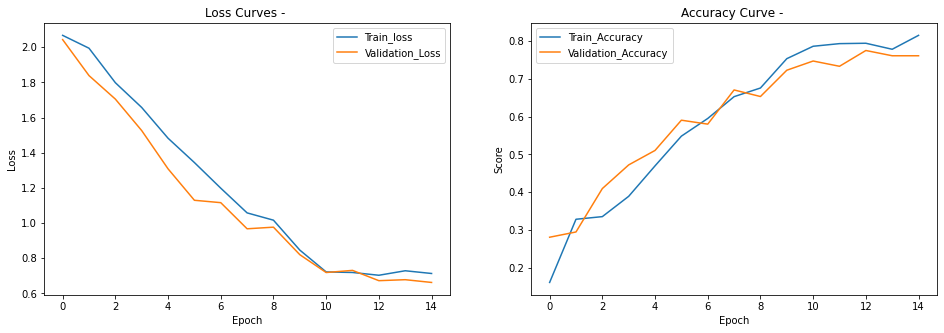

------------------------------ 
Best result on validation set -> Loss = 0.6736927810642455 Accuracy = 77.78 %
Validation Report
[('angry', 0.9230769230769231), ('calm', 0.9047619047619048), ('disgust', 0.9459459459459459), ('fearful', 0.6744186046511628), ('happy', 0.6060606060606061), ('neutral', 0.5833333333333334), ('sad', 0.5581395348837209), ('surprised', 0.8974358974358975)]
              precision    recall  f1-score   support

       angry       0.90      0.92      0.91        39
        calm       0.68      0.90      0.78        42
     disgust       0.88      0.95      0.91        37
     fearful       0.76      0.67      0.72        43
       happy       0.74      0.61      0.67        33
     neutral       0.58      0.58      0.58        12
         sad       0.65      0.56      0.60        43
   surprised       0.92      0.90      0.91        39

    accuracy                           0.78       288
   macro avg       0.76      0.76      0.76       288
weighted avg       0

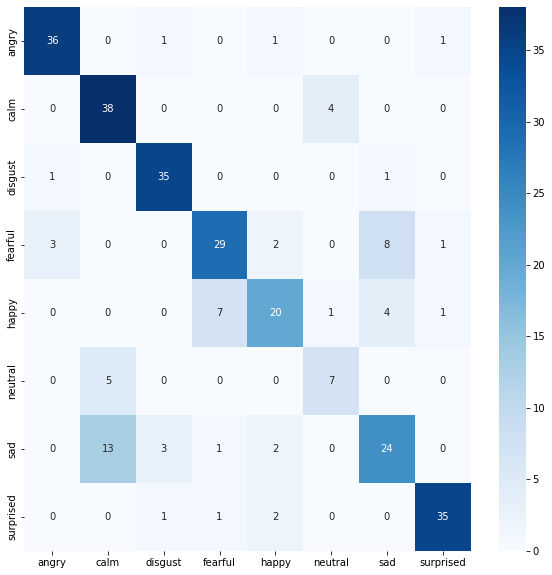

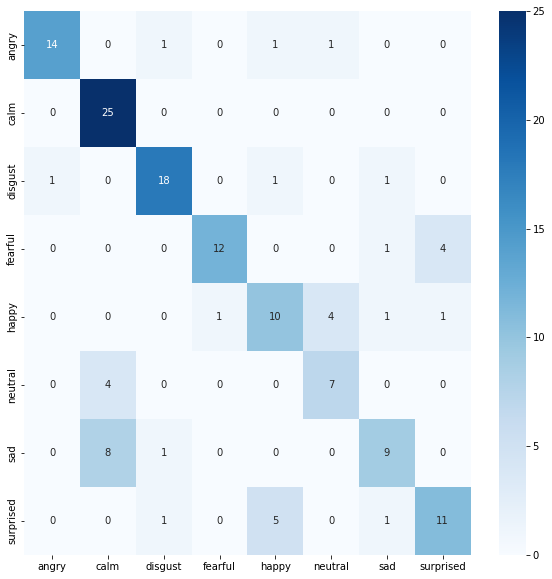

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-9af81a26dc8eba4f/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0853 
[Epoch][Batch] = [1][13] -> Loss = 2.0872 
[Epoch][Batch] = [1][26] -> Loss = 2.0815 
[Epoch][Batch] = [1][39] -> Loss = 2.0803 
[Epoch][Batch] = [1][52] -> Loss = 2.0788 
best_acc  0.3020833333333333
	Train -> Loss = 2.0770 /  accuracy = 0.1291
	Validation -> Loss = 2.0504 /  accuracy = 0.3021
[Epoch][Batch] = [2][0] -> Loss = 2.0400 
[Epoch][Batch] = [2][13] -> Loss = 2.0504 
[Epoch][Batch] = [2][26] -> Loss = 2.0

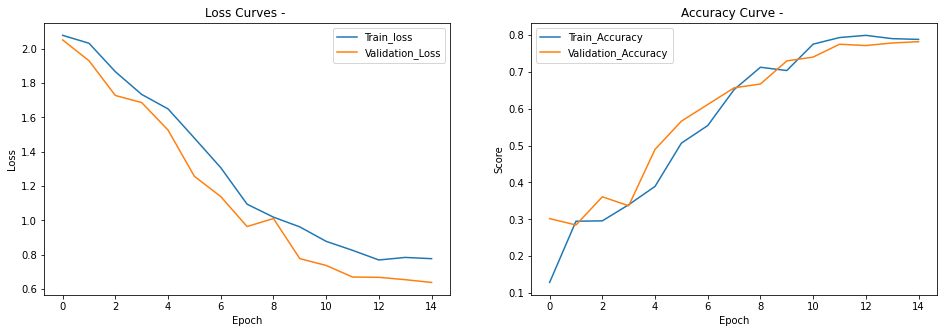

------------------------------ 
Best result on validation set -> Loss = 0.6357318229145474 Accuracy = 78.47 %
Validation Report
[('angry', 0.8974358974358975), ('calm', 0.8536585365853658), ('disgust', 0.9210526315789473), ('fearful', 0.7674418604651163), ('happy', 0.45454545454545453), ('neutral', 0.8333333333333334), ('sad', 0.6744186046511628), ('surprised', 0.8717948717948718)]
              precision    recall  f1-score   support

       angry       0.88      0.90      0.89        39
        calm       0.80      0.85      0.82        41
     disgust       0.90      0.92      0.91        38
     fearful       0.77      0.77      0.77        43
       happy       0.71      0.45      0.56        33
     neutral       0.59      0.83      0.69        12
         sad       0.63      0.67      0.65        43
   surprised       0.89      0.87      0.88        39

    accuracy                           0.78       288
   macro avg       0.77      0.78      0.77       288
weighted avg       

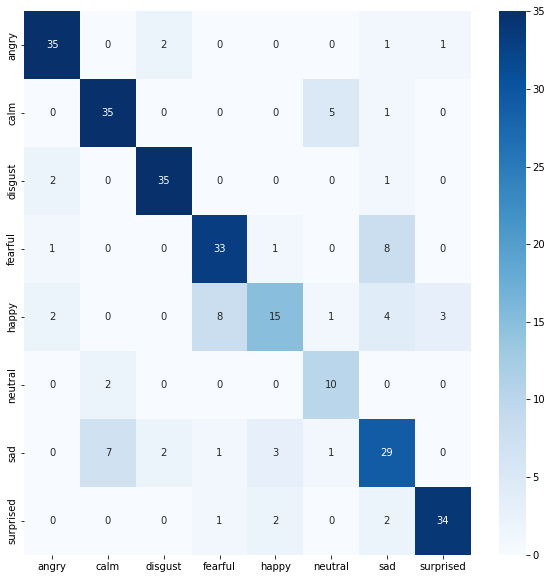

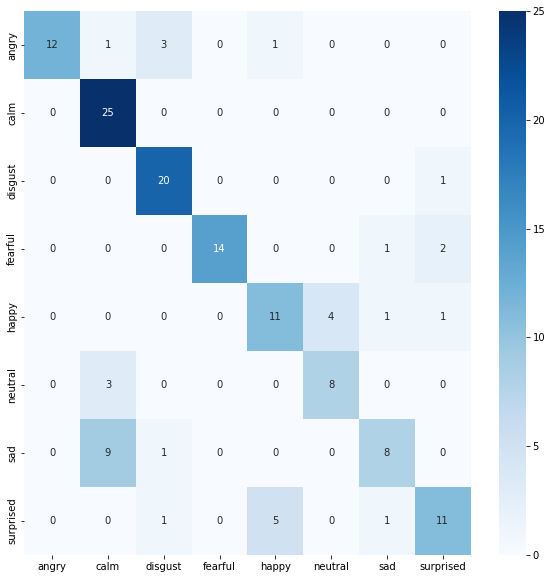

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:

val_preds = np.asarray(val_preds, dtype = 'int')
val_labels = np.asarray(val_labels, dtype = 'int')

test_preds = np.asarray(test_preds, dtype = 'int')
test_labels = np.asarray(test_labels, dtype = 'int')

[('angry', 0.9128205128205128), ('calm', 0.8851674641148325), ('disgust', 0.946524064171123), ('fearful', 0.7302325581395349), ('happy', 0.573170731707317), ('neutral', 0.7333333333333333), ('sad', 0.5441860465116279), ('surprised', 0.8923076923076924)]
              precision    recall  f1-score   support

       angry       0.89      0.91      0.90       195
        calm       0.70      0.89      0.78       209
     disgust       0.89      0.95      0.91       187
     fearful       0.81      0.73      0.77       215
       happy       0.70      0.57      0.63       164
     neutral       0.59      0.73      0.66        60
         sad       0.65      0.54      0.59       215
   surprised       0.90      0.89      0.89       195

    accuracy                           0.78      1440
   macro avg       0.77      0.78      0.77      1440
weighted avg       0.78      0.78      0.78      1440



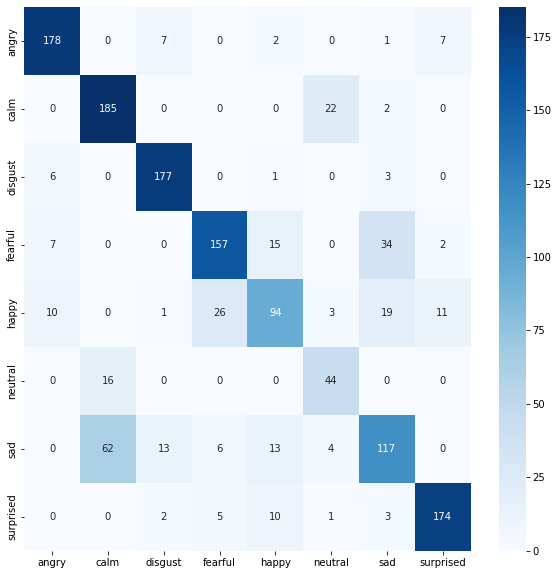

In [ ]:
report(val_labels, val_preds, label_encoder)

[('angry', 0.8117647058823529), ('calm', 0.992), ('disgust', 0.9047619047619048), ('fearful', 0.8117647058823529), ('happy', 0.6235294117647059), ('neutral', 0.7636363636363637), ('sad', 0.4444444444444444), ('surprised', 0.6444444444444445)]
              precision    recall  f1-score   support

       angry       0.91      0.81      0.86        85
        calm       0.69      0.99      0.81       125
     disgust       0.84      0.90      0.87       105
     fearful       0.96      0.81      0.88        85
       happy       0.65      0.62      0.64        85
     neutral       0.66      0.76      0.71        55
         sad       0.66      0.44      0.53        90
   surprised       0.81      0.64      0.72        90

    accuracy                           0.76       720
   macro avg       0.77      0.75      0.75       720
weighted avg       0.77      0.76      0.76       720



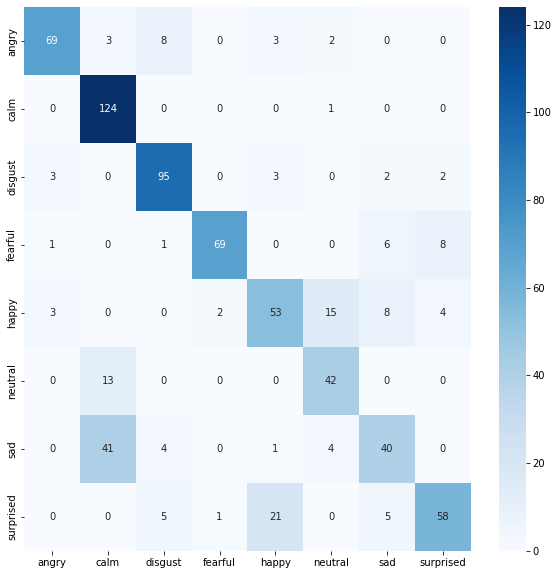

In [ ]:
report(test_labels, test_preds, label_encoder)

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-0cfb0138893fb442/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available


----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0657 
[Epoch][Batch] = [1][13] -> Loss = 2.0788 
[Epoch][Batch] = [1][26] -> Loss = 2.0766 
[Epoch][Batch] = [1][39] -> Loss = 2.0717 
[Epoch][Batch] = [1][52] -> Loss = 2.0705 
best_acc  0.2847222222222222
	Train -> Loss = 2.0677 /  accuracy = 0.1966
	Validation -> Loss = 2.0434 /  accuracy = 0.2847
[Epoch][Batch] = [2][0] -> Loss = 2.0291 
[Epoch][Batch] = [2][13] -> Loss = 2.0433 
[Epoch][Batch] = [2][26] -> Loss = 2.0371 
[Epoch][Batch] = [2][39] -> Loss = 2.0316 
[Epoch][Batch] = [2][52] -> Loss = 2.0245 
best_acc  0.3090277777777778
	Train -> Loss = 2.0192 /  accuracy = 0.3208
	Validation -> Loss = 1.9321 /  accuracy = 0.3090
[Epoch][Batch] = [3][0] -> Loss = 1.9505 
[Epoch][Batch] = [3][13] -> Loss = 1.9493 
[Epoch][Batch] = [3][26] -> Loss = 1.8867 
[Epoch][Batch] = [3][39] -> Loss = 1.8685 
[Epoch][Batch] = [3][52]

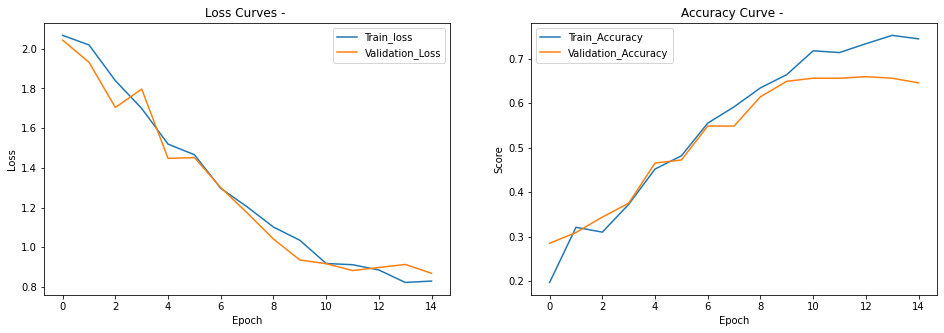

------------------------------ 
Best result on validation set -> Loss = 0.9267462922467126 Accuracy = 62.85 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.8292682926829268), ('disgust', 0.7631578947368421), ('fearful', 0.2558139534883721), ('happy', 0.6666666666666666), ('neutral', 0.75), ('sad', 0.27906976744186046), ('surprised', 0.7692307692307693)]
              precision    recall  f1-score   support

       angry       0.83      0.87      0.85        39
        calm       0.67      0.83      0.74        41
     disgust       0.88      0.76      0.82        38
     fearful       0.79      0.26      0.39        43
       happy       0.37      0.67      0.48        33
     neutral       0.28      0.75      0.41        12
         sad       0.48      0.28      0.35        43
   surprised       0.91      0.77      0.83        39

    accuracy                           0.63       288
   macro avg       0.65      0.65      0.61       288
weighted avg       0.69      0.63

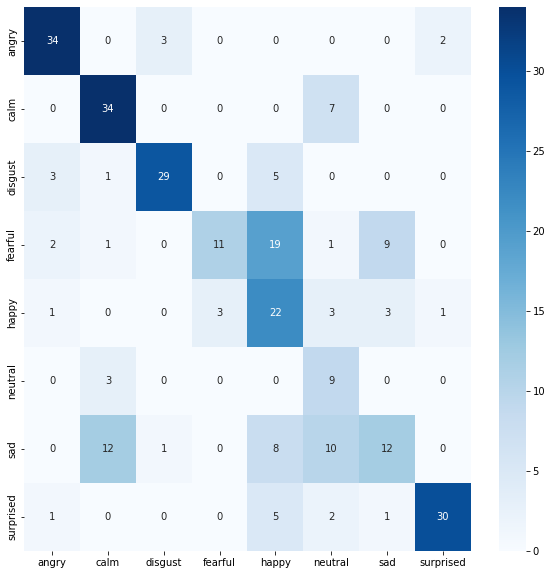

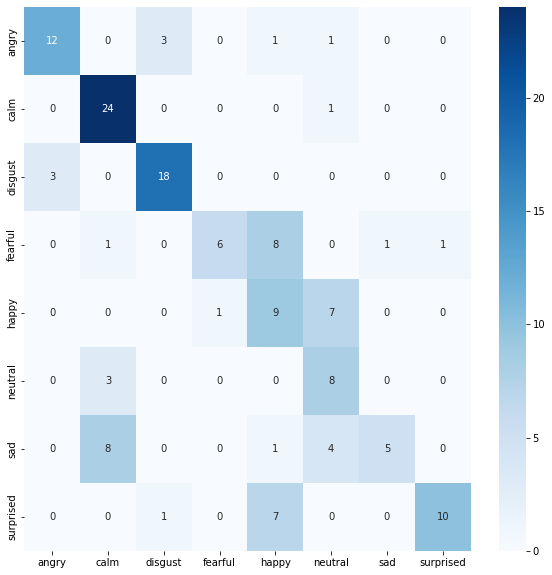

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-4d0208d8e0922254/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0640 
[Epoch][Batch] = [1][13] -> Loss = 2.0701 
[Epoch][Batch] = [1][26] -> Loss = 2.0706 
[Epoch][Batch] = [1][39] -> Loss = 2.0663 
[Epoch][Batch] = [1][52] -> Loss = 2.0661 
best_acc  0.24305555555555555
	Train -> Loss = 2.0629 /  accuracy = 0.1202
	Validation -> Loss = 2.0425 /  accuracy = 0.2431
[Epoch][Batch] = [2][0] -> Loss = 2.0401 
[Epoch][Batch] = [2][13] -> Loss = 2.0353 
[Epoch][Batch] = [2][26] -> Loss = 2.

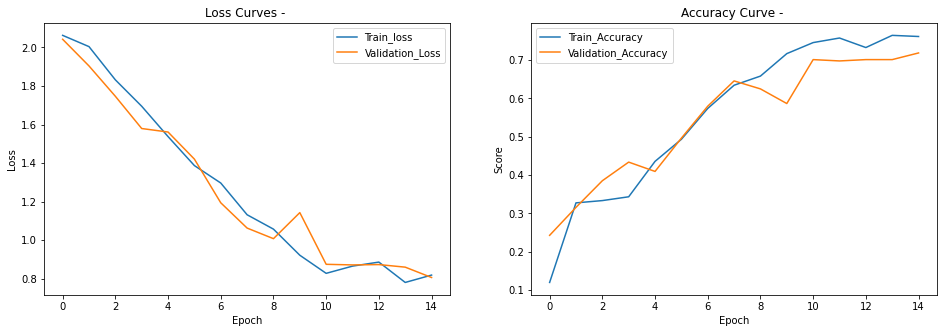

------------------------------ 
Best result on validation set -> Loss = 0.8057918416129218 Accuracy = 73.61 %
Validation Report
[('angry', 0.8421052631578947), ('calm', 0.9761904761904762), ('disgust', 0.9210526315789473), ('fearful', 0.5581395348837209), ('happy', 0.6666666666666666), ('neutral', 0.5833333333333334), ('sad', 0.46511627906976744), ('surprised', 0.7948717948717948)]
              precision    recall  f1-score   support

       angry       0.86      0.84      0.85        38
        calm       0.71      0.98      0.82        42
     disgust       0.85      0.92      0.89        38
     fearful       0.80      0.56      0.66        43
       happy       0.48      0.67      0.56        33
     neutral       0.54      0.58      0.56        12
         sad       0.71      0.47      0.56        43
   surprised       0.89      0.79      0.84        39

    accuracy                           0.74       288
   macro avg       0.73      0.73      0.72       288
weighted avg       

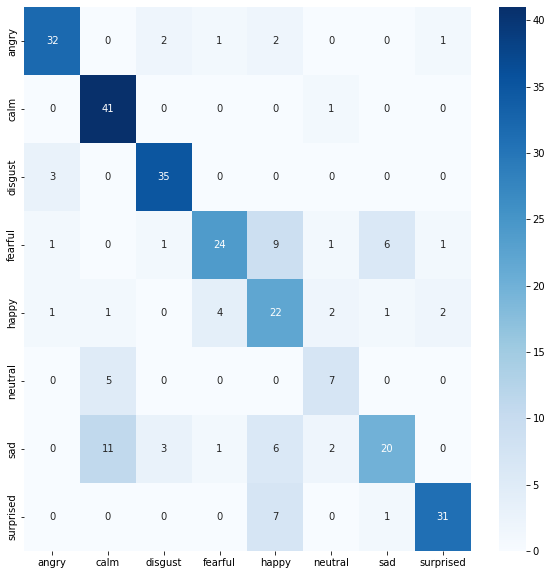

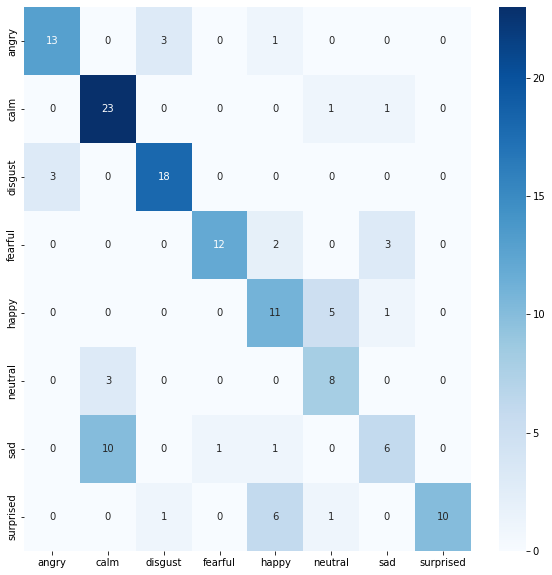

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-00c55d5fee638c87/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0716 
[Epoch][Batch] = [1][13] -> Loss = 2.0882 
[Epoch][Batch] = [1][26] -> Loss = 2.0839 
[Epoch][Batch] = [1][39] -> Loss = 2.0801 
[Epoch][Batch] = [1][52] -> Loss = 2.0764 
best_acc  0.2743055555555556
	Train -> Loss = 2.0738 /  accuracy = 0.1599
	Validation -> Loss = 2.0483 /  accuracy = 0.2743
[Epoch][Batch] = [2][0] -> Loss = 2.0415 
[Epoch][Batch] = [2][13] -> Loss = 2.0432 
[Epoch][Batch] = [2][26] -> Loss = 2.0

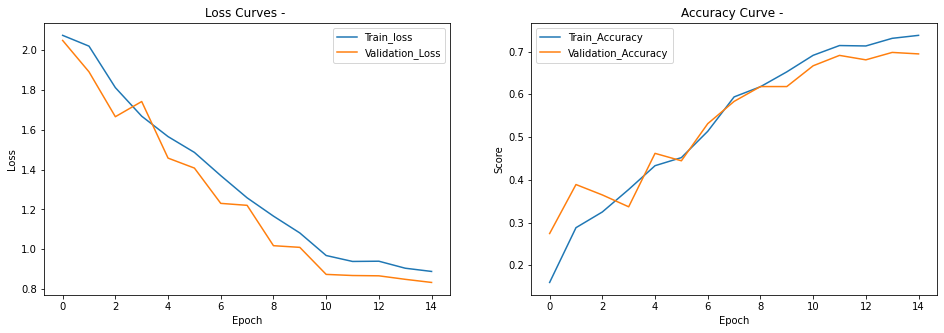

------------------------------ 
Best result on validation set -> Loss = 0.8649256842003928 Accuracy = 67.01 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.9024390243902439), ('disgust', 0.9473684210526315), ('fearful', 0.3023255813953488), ('happy', 0.5151515151515151), ('neutral', 0.5833333333333334), ('sad', 0.3953488372093023), ('surprised', 0.8205128205128205)]
              precision    recall  f1-score   support

       angry       0.79      0.87      0.83        39
        calm       0.66      0.90      0.76        41
     disgust       0.88      0.95      0.91        38
     fearful       0.76      0.30      0.43        43
       happy       0.36      0.52      0.43        33
     neutral       0.47      0.58      0.52        12
         sad       0.57      0.40      0.47        43
   surprised       0.82      0.82      0.82        39

    accuracy                           0.67       288
   macro avg       0.66      0.67      0.65       288
weighted avg       0

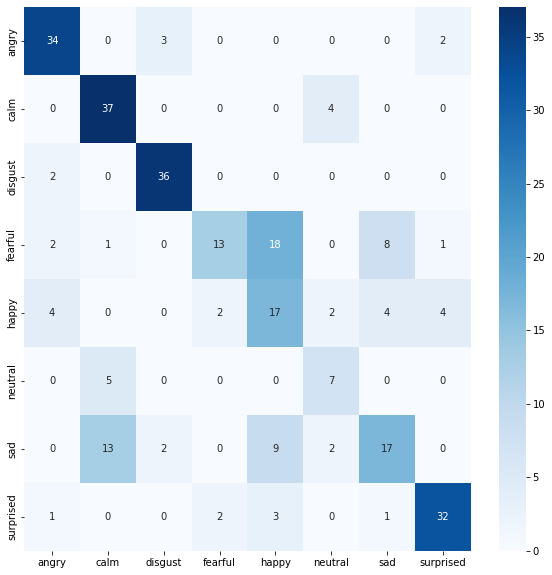

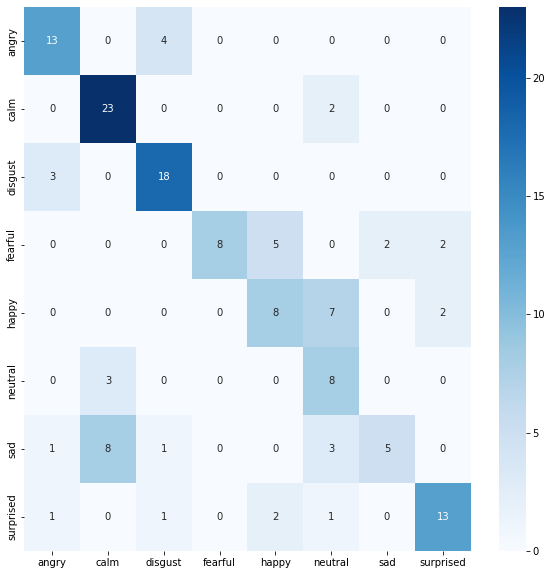

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-6a2fdbc83b22e46d/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0671 
[Epoch][Batch] = [1][13] -> Loss = 2.0788 
[Epoch][Batch] = [1][26] -> Loss = 2.0772 
[Epoch][Batch] = [1][39] -> Loss = 2.0752 
[Epoch][Batch] = [1][52] -> Loss = 2.0738 
best_acc  0.16319444444444445
	Train -> Loss = 2.0716 /  accuracy = 0.1768
	Validation -> Loss = 2.0508 /  accuracy = 0.1632
[Epoch][Batch] = [2][0] -> Loss = 2.0244 
[Epoch][Batch] = [2][13] -> Loss = 2.0452 
[Epoch][Batch] = [2][26] -> Loss = 2.

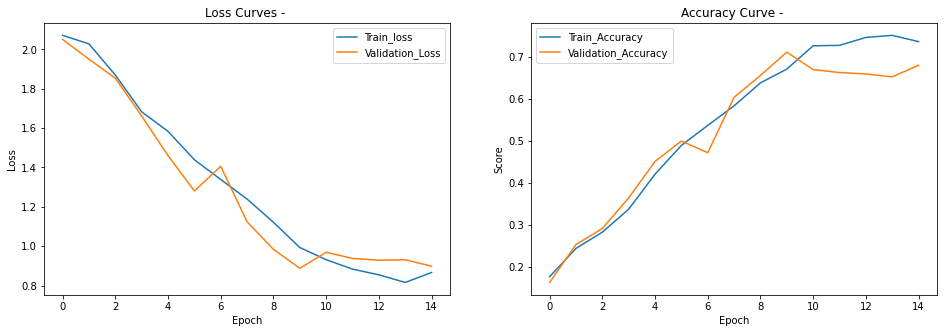

------------------------------ 
Best result on validation set -> Loss = 0.8798809614446428 Accuracy = 69.79 %
Validation Report
[('angry', 0.8205128205128205), ('calm', 0.9047619047619048), ('disgust', 0.9736842105263158), ('fearful', 0.6511627906976745), ('happy', 0.375), ('neutral', 0.6666666666666666), ('sad', 0.32558139534883723), ('surprised', 0.8205128205128205)]
              precision    recall  f1-score   support

       angry       0.82      0.82      0.82        39
        calm       0.69      0.90      0.78        42
     disgust       0.79      0.97      0.87        38
     fearful       0.70      0.65      0.67        43
       happy       0.50      0.38      0.43        32
     neutral       0.44      0.67      0.53        12
         sad       0.70      0.33      0.44        43
   surprised       0.71      0.82      0.76        39

    accuracy                           0.70       288
   macro avg       0.67      0.69      0.66       288
weighted avg       0.70      0.7

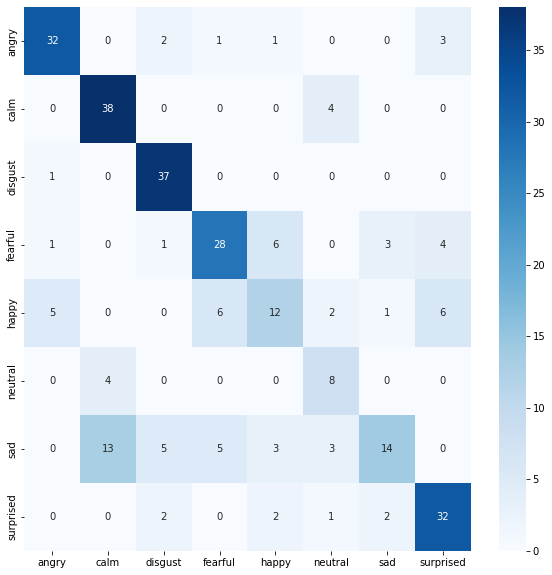

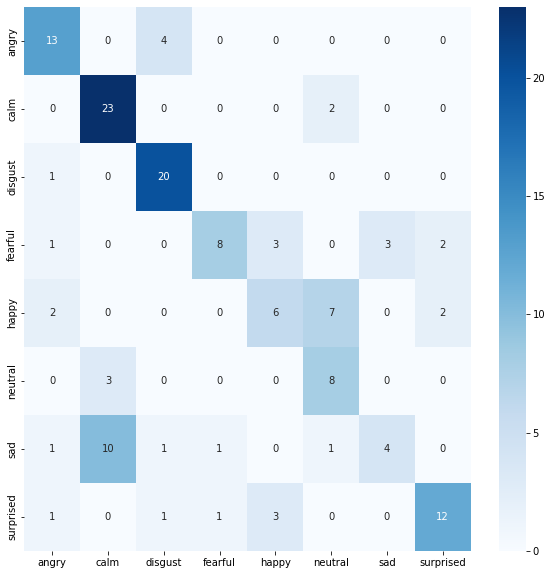

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-3abf2dc6648d8903/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0723 
[Epoch][Batch] = [1][13] -> Loss = 2.0771 
[Epoch][Batch] = [1][26] -> Loss = 2.0724 
[Epoch][Batch] = [1][39] -> Loss = 2.0701 
[Epoch][Batch] = [1][52] -> Loss = 2.0676 
best_acc  0.3090277777777778
	Train -> Loss = 2.0648 /  accuracy = 0.1678
	Validation -> Loss = 2.0452 /  accuracy = 0.3090
[Epoch][Batch] = [2][0] -> Loss = 2.0486 
[Epoch][Batch] = [2][13] -> Loss = 2.0412 
[Epoch][Batch] = [2][26] -> Loss = 2.0

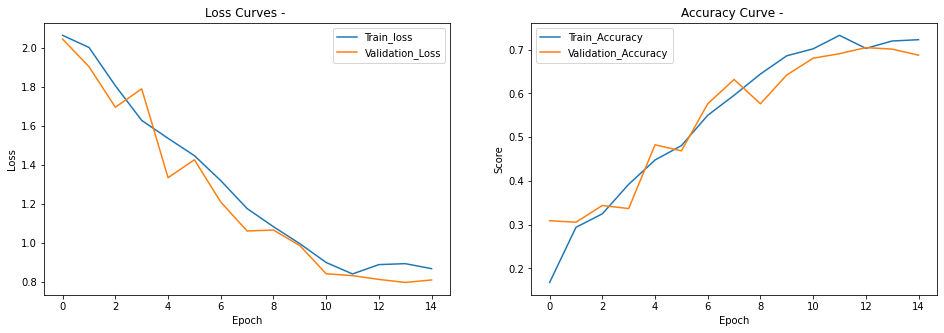

------------------------------ 
Best result on validation set -> Loss = 0.8311324533489015 Accuracy = 69.44 %
Validation Report
[('angry', 0.8974358974358975), ('calm', 0.9285714285714286), ('disgust', 1.0), ('fearful', 0.5813953488372093), ('happy', 0.2727272727272727), ('neutral', 0.6666666666666666), ('sad', 0.32558139534883723), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.81      0.90      0.85        39
        calm       0.65      0.93      0.76        42
     disgust       0.86      1.00      0.92        37
     fearful       0.62      0.58      0.60        43
       happy       0.47      0.27      0.35        33
     neutral       0.47      0.67      0.55        12
         sad       0.58      0.33      0.42        43
   surprised       0.79      0.85      0.81        39

    accuracy                           0.69       288
   macro avg       0.66      0.69      0.66       288
weighted avg       0.68      0.69 

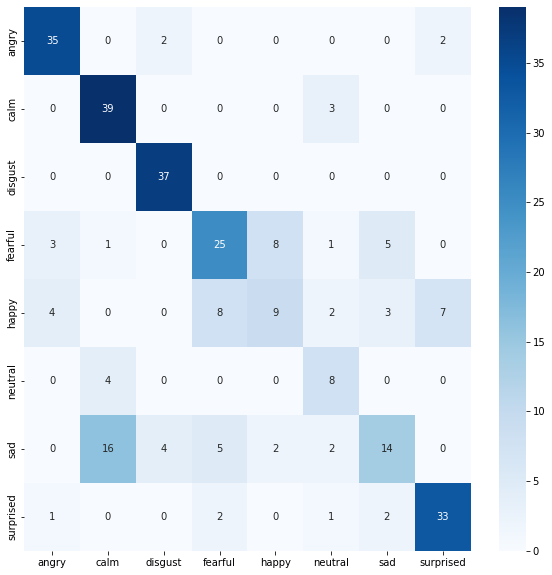

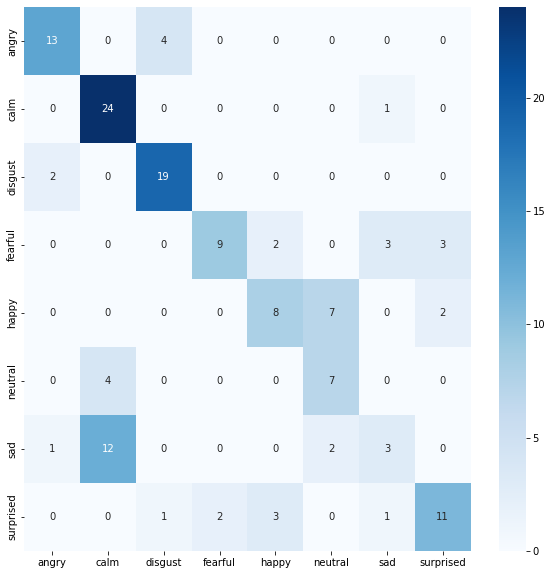

In [ ]:
v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_preds = np.asarray(val_preds, dtype = 'int')
val_labels = np.asarray(val_labels, dtype = 'int')

test_preds = np.asarray(test_preds, dtype = 'int')
test_labels = np.asarray(test_labels, dtype = 'int')

[('angry', 0.8608247422680413), ('calm', 0.9086538461538461), ('disgust', 0.9206349206349206), ('fearful', 0.4697674418604651), ('happy', 0.5), ('neutral', 0.65), ('sad', 0.3581395348837209), ('surprised', 0.8102564102564103)]
              precision    recall  f1-score   support

       angry       0.82      0.86      0.84       194
        calm       0.68      0.91      0.77       208
     disgust       0.85      0.92      0.88       189
     fearful       0.72      0.47      0.57       215
       happy       0.42      0.50      0.46       164
     neutral       0.41      0.65      0.50        60
         sad       0.61      0.36      0.45       215
   surprised       0.81      0.81      0.81       195

    accuracy                           0.69      1440
   macro avg       0.66      0.68      0.66      1440
weighted avg       0.69      0.69      0.68      1440



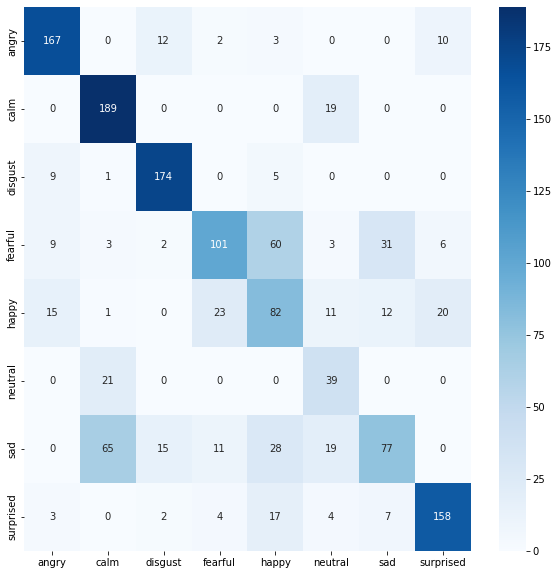

In [ ]:
report(val_labels, val_preds, label_encoder)

[('angry', 0.7529411764705882), ('calm', 0.936), ('disgust', 0.8857142857142857), ('fearful', 0.5058823529411764), ('happy', 0.49411764705882355), ('neutral', 0.7090909090909091), ('sad', 0.25555555555555554), ('surprised', 0.6222222222222222)]
              precision    recall  f1-score   support

       angry       0.76      0.75      0.76        85
        calm       0.64      0.94      0.76       125
     disgust       0.79      0.89      0.83       105
     fearful       0.88      0.51      0.64        85
       happy       0.48      0.49      0.49        85
     neutral       0.43      0.71      0.53        55
         sad       0.59      0.26      0.36        90
   surprised       0.80      0.62      0.70        90

    accuracy                           0.66       720
   macro avg       0.67      0.65      0.63       720
weighted avg       0.68      0.66      0.65       720



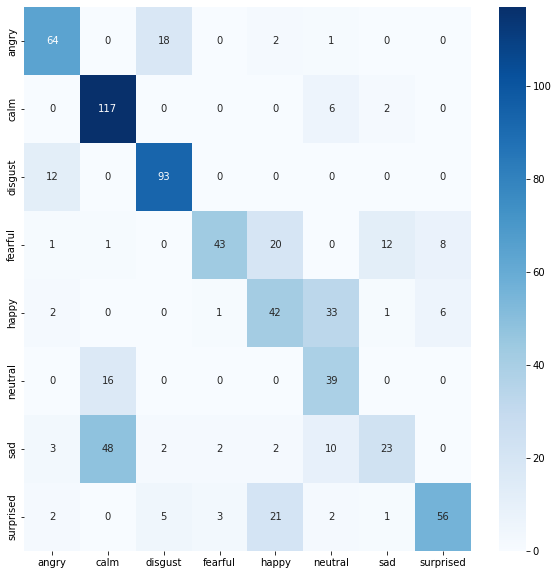

In [ ]:
report(test_labels, test_preds, label_encoder)

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ad6622c15b8b080d/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0811 
[Epoch][Batch] = [1][13] -> Loss = 2.0872 
[Epoch][Batch] = [1][26] -> Loss = 2.0829 
[Epoch][Batch] = [1][39] -> Loss = 2.0783 
[Epoch][Batch] = [1][52] -> Loss = 2.0767 
best_acc  0.2222222222222222
	Train -> Loss = 2.0747 /  accuracy = 0.1519
	Validation -> Loss = 2.0611 /  accuracy = 0.2222
[Epoch][Batch] = [2][0] -> Loss = 2.0500 
[Epoch][Batch] = [2][13] -> Loss = 2.0598 
[Epoch][Batch] = [2][26] -> Loss = 2.0

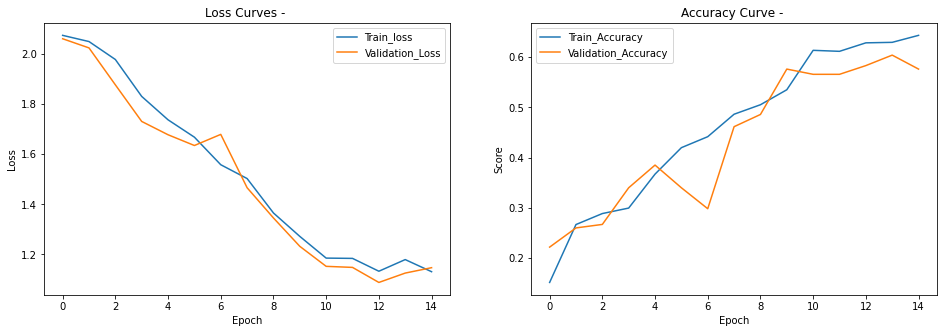

------------------------------ 
Best result on validation set -> Loss = 1.1146674089961581 Accuracy = 59.38 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.7857142857142857), ('disgust', 0.631578947368421), ('fearful', 0.37209302325581395), ('happy', 0.45454545454545453), ('neutral', 0.6666666666666666), ('sad', 0.23809523809523808), ('surprised', 0.7948717948717948)]
              precision    recall  f1-score   support

       angry       0.67      0.87      0.76        39
        calm       0.69      0.79      0.73        42
     disgust       0.86      0.63      0.73        38
     fearful       0.67      0.37      0.48        43
       happy       0.33      0.45      0.38        33
     neutral       0.24      0.67      0.35        12
         sad       0.48      0.24      0.32        42
   surprised       0.86      0.79      0.83        39

    accuracy                           0.59       288
   macro avg       0.60      0.60      0.57       288
weighted avg      

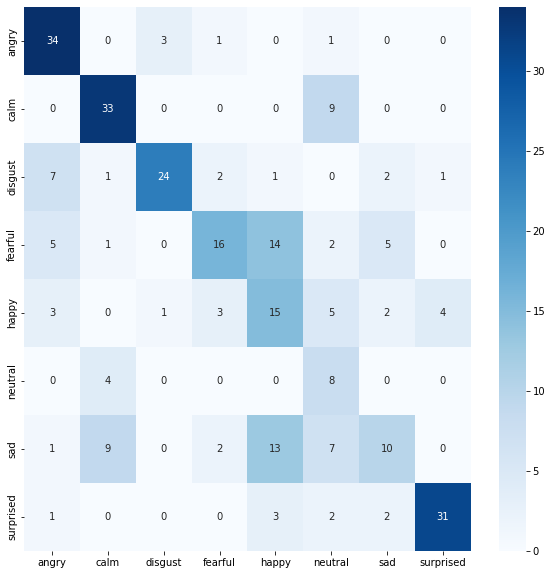

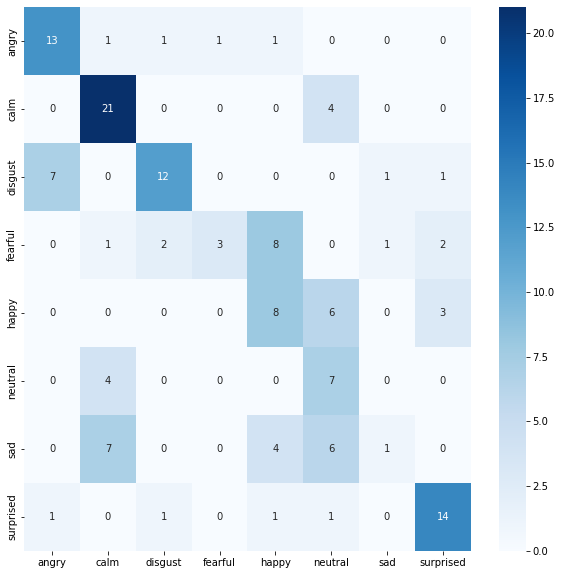

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_20"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-37b16159362d027a/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0910 
[Epoch][Batch] = [1][13] -> Loss = 2.0782 
[Epoch][Batch] = [1][26] -> Loss = 2.0804 
[Epoch][Batch] = [1][39] -> Loss = 2.0766 
[Epoch][Batch] = [1][52] -> Loss = 2.0743 
best_acc  0.2013888888888889
	Train -> Loss = 2.0732 /  accuracy = 0.1768
	Validation -> Loss = 2.0530 /  accuracy = 0.2014
[Epoch][Batch] = [2][0] -> Loss = 2.0610 
[Epoch][Batch] = [2][13] -> Loss = 2.0480 
[Epoch][Batch] = [2][26] -> Loss = 2.0

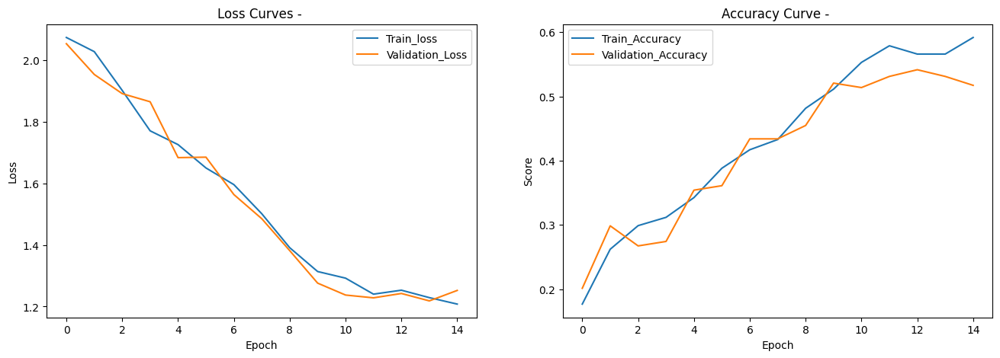

------------------------------ 
Best result on validation set -> Loss = 1.2495578759246402 Accuracy = 52.78 %
Validation Report
[('angry', 0.7948717948717948), ('calm', 0.8571428571428571), ('disgust', 0.631578947368421), ('fearful', 0.06976744186046512), ('happy', 0.5151515151515151), ('neutral', 0.5), ('sad', 0.13953488372093023), ('surprised', 0.7631578947368421)]
              precision    recall  f1-score   support

       angry       0.62      0.79      0.70        39
        calm       0.68      0.86      0.76        42
     disgust       0.80      0.63      0.71        38
     fearful       0.38      0.07      0.12        43
       happy       0.28      0.52      0.37        33
     neutral       0.18      0.50      0.26        12
         sad       0.35      0.14      0.20        43
   surprised       0.81      0.76      0.78        38

    accuracy                           0.53       288
   macro avg       0.51      0.53      0.49       288
weighted avg       0.54      0.53 

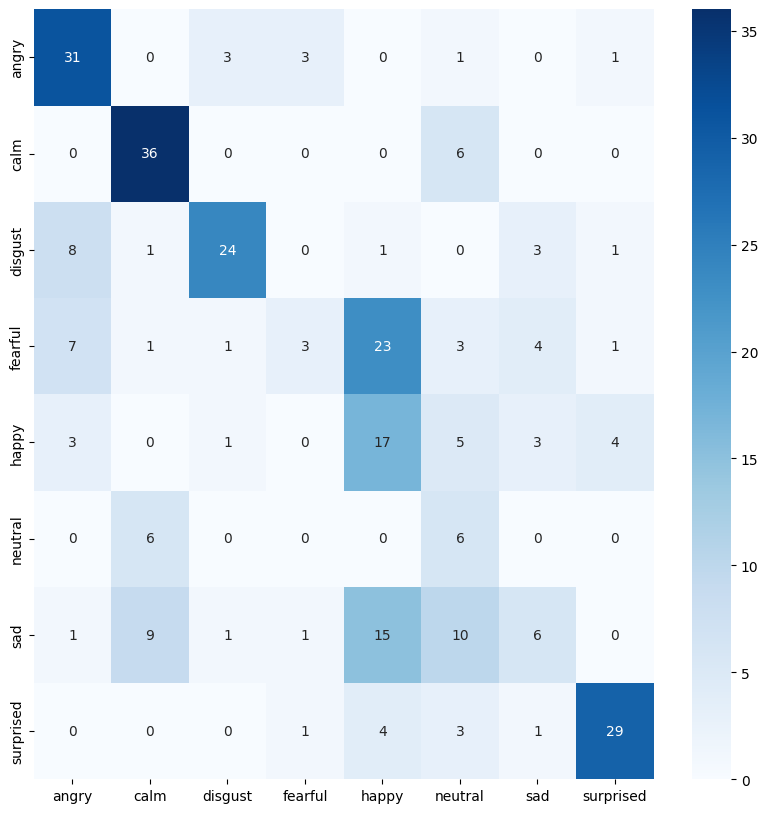

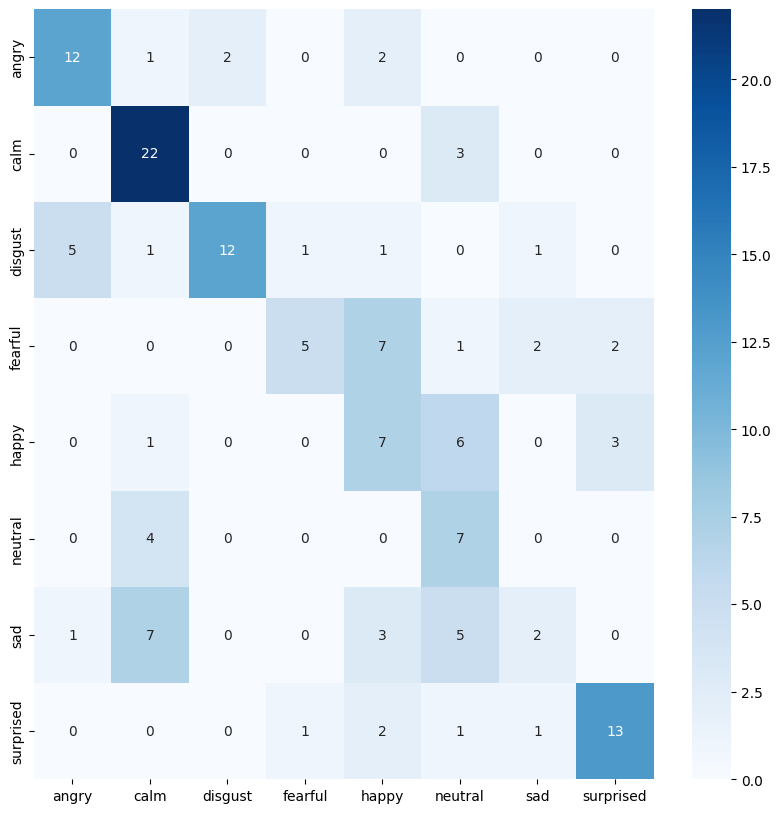

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_20"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ca308d01d9226e8e/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0809 
[Epoch][Batch] = [1][13] -> Loss = 2.0743 
[Epoch][Batch] = [1][26] -> Loss = 2.0787 
[Epoch][Batch] = [1][39] -> Loss = 2.0789 
[Epoch][Batch] = [1][52] -> Loss = 2.0757 
best_acc  0.22916666666666666
	Train -> Loss = 2.0734 /  accuracy = 0.1629
	Validation -> Loss = 2.0573 /  accuracy = 0.2292
[Epoch][Batch] = [2][0] -> Loss = 2.0305 
[Epoch][Batch] = [2][13] -> Loss = 2.0486 
[Epoch][Batch] = [2][26] -> Loss = 2.

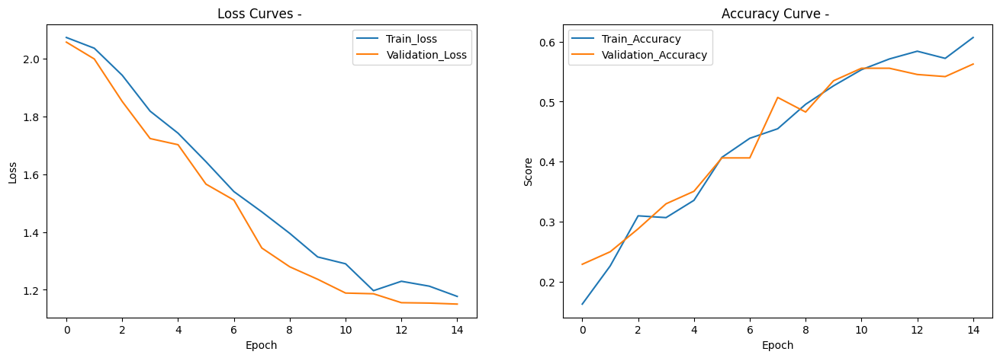

------------------------------ 
Best result on validation set -> Loss = 1.13816417588128 Accuracy = 54.51 %
Validation Report
[('angry', 0.7948717948717948), ('calm', 0.7857142857142857), ('disgust', 0.6842105263157895), ('fearful', 0.20930232558139536), ('happy', 0.25), ('neutral', 0.6666666666666666), ('sad', 0.20930232558139536), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.61      0.79      0.69        39
        calm       0.77      0.79      0.78        42
     disgust       0.70      0.68      0.69        38
     fearful       0.50      0.21      0.30        43
       happy       0.24      0.25      0.25        32
     neutral       0.26      0.67      0.37        12
         sad       0.35      0.21      0.26        43
   surprised       0.67      0.85      0.75        39

    accuracy                           0.55       288
   macro avg       0.51      0.56      0.51       288
weighted avg       0.54      0.55 

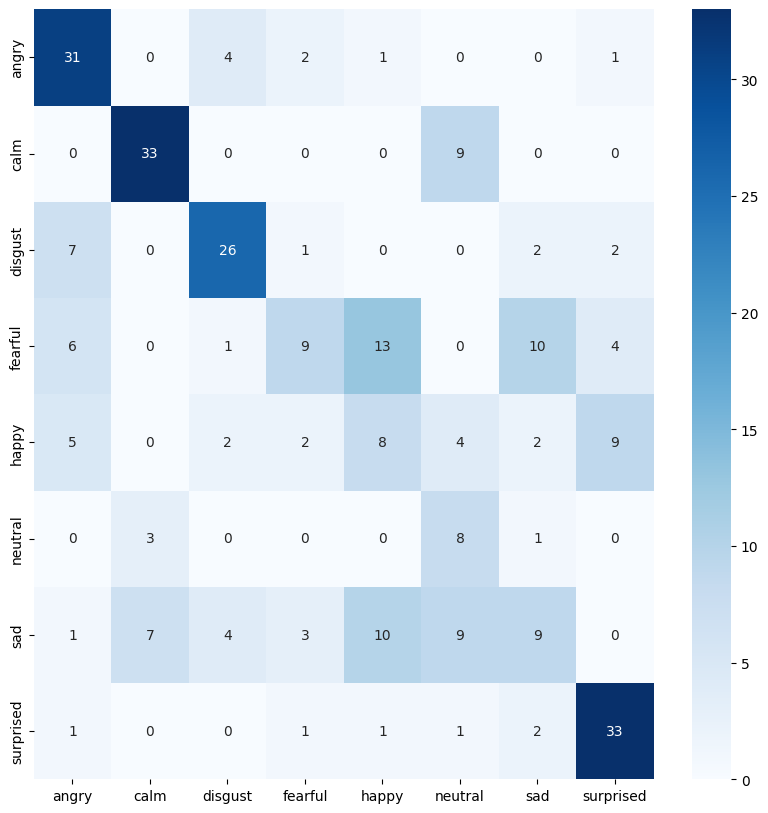

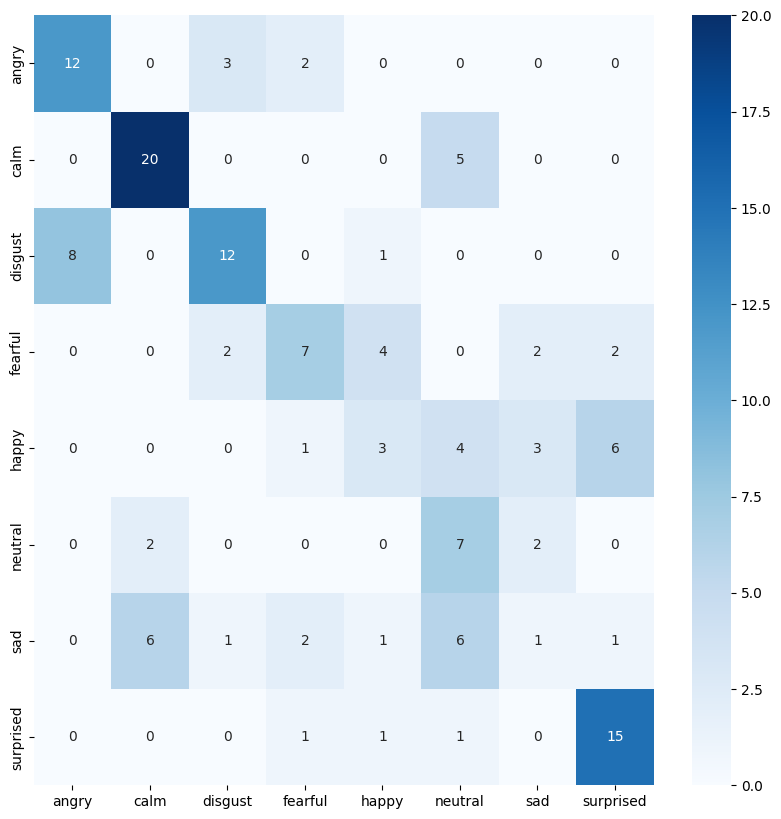

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_20"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-8d5222bb7969d8c6/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0858 
[Epoch][Batch] = [1][13] -> Loss = 2.0787 
[Epoch][Batch] = [1][26] -> Loss = 2.0741 
[Epoch][Batch] = [1][39] -> Loss = 2.0745 
[Epoch][Batch] = [1][52] -> Loss = 2.0715 
best_acc  0.25
	Train -> Loss = 2.0699 /  accuracy = 0.1569
	Validation -> Loss = 2.0478 /  accuracy = 0.2500
[Epoch][Batch] = [2][0] -> Loss = 2.0393 
[Epoch][Batch] = [2][13] -> Loss = 2.0369 
[Epoch][Batch] = [2][26] -> Loss = 2.0383 
[Epoch][B

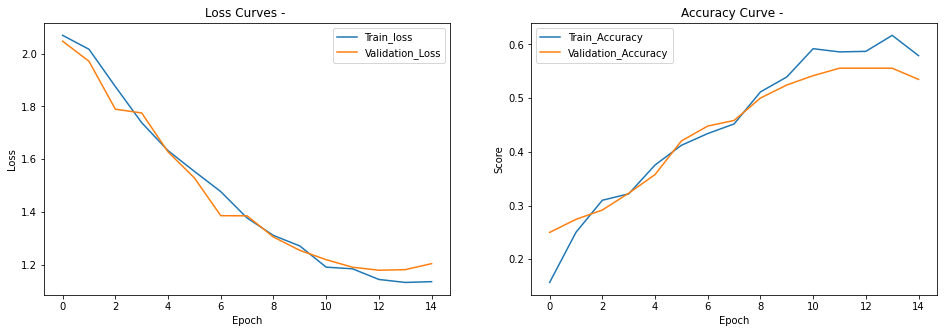

------------------------------ 
Best result on validation set -> Loss = 1.203337464067671 Accuracy = 54.17 %
Validation Report
[('angry', 0.717948717948718), ('calm', 0.9285714285714286), ('disgust', 0.8947368421052632), ('fearful', 0.09523809523809523), ('happy', 0.36363636363636365), ('neutral', 0.16666666666666666), ('sad', 0.18604651162790697), ('surprised', 0.7435897435897436)]
              precision    recall  f1-score   support

       angry       0.67      0.72      0.69        39
        calm       0.57      0.93      0.71        42
     disgust       0.72      0.89      0.80        38
     fearful       0.67      0.10      0.17        42
       happy       0.29      0.36      0.32        33
     neutral       0.09      0.17      0.11        12
         sad       0.50      0.19      0.27        43
   surprised       0.64      0.74      0.69        39

    accuracy                           0.54       288
   macro avg       0.52      0.51      0.47       288
weighted avg      

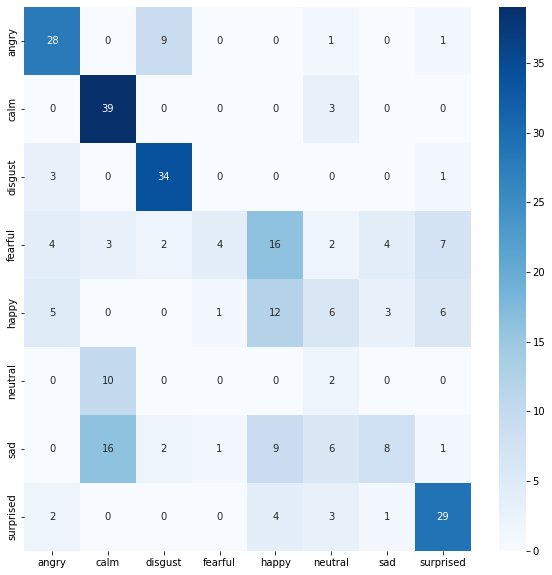

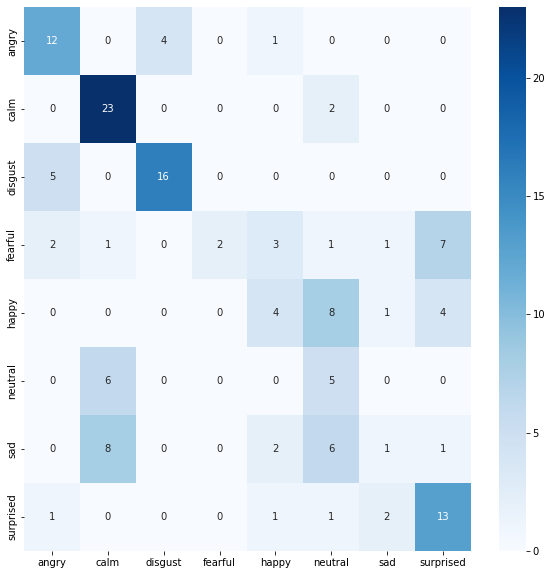

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_25"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-8bc4eccbe2d9dde7/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.1119 
[Epoch][Batch] = [1][13] -> Loss = 2.0792 
[Epoch][Batch] = [1][26] -> Loss = 2.0846 
[Epoch][Batch] = [1][39] -> Loss = 2.0817 
[Epoch][Batch] = [1][52] -> Loss = 2.0793 
best_acc  0.2673611111111111
	Train -> Loss = 2.0773 /  accuracy = 0.1619
	Validation -> Loss = 2.0544 /  accuracy = 0.2674
[Epoch][Batch] = [2][0] -> Loss = 2.0507 
[Epoch][Batch] = [2][13] -> Loss = 2.0589 
[Epoch][Batch] = [2][26] -> Loss = 2.0

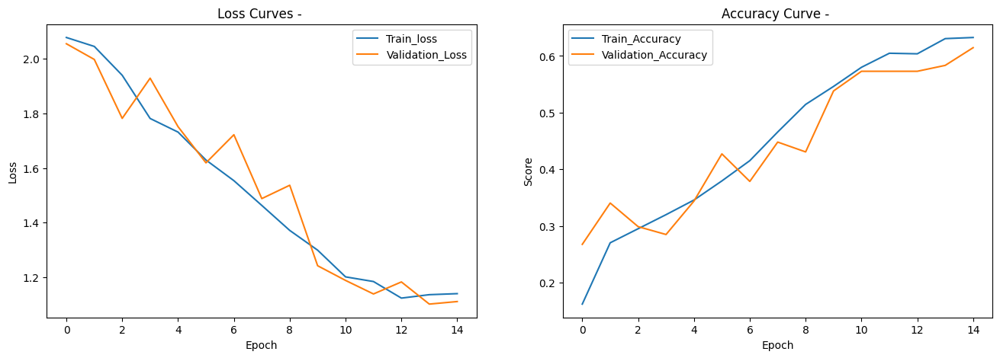

------------------------------ 
Best result on validation set -> Loss = 1.1044166187445323 Accuracy = 60.76 %
Validation Report
[('angry', 0.7692307692307693), ('calm', 0.8809523809523809), ('disgust', 0.7894736842105263), ('fearful', 0.2558139534883721), ('happy', 0.5625), ('neutral', 0.4166666666666667), ('sad', 0.3953488372093023), ('surprised', 0.6923076923076923)]
              precision    recall  f1-score   support

       angry       0.77      0.77      0.77        39
        calm       0.61      0.88      0.72        42
     disgust       0.77      0.79      0.78        38
     fearful       0.61      0.26      0.36        43
       happy       0.39      0.56      0.46        32
     neutral       0.19      0.42      0.26        12
         sad       0.61      0.40      0.48        43
   surprised       0.87      0.69      0.77        39

    accuracy                           0.61       288
   macro avg       0.60      0.60      0.58       288
weighted avg       0.65      0.6

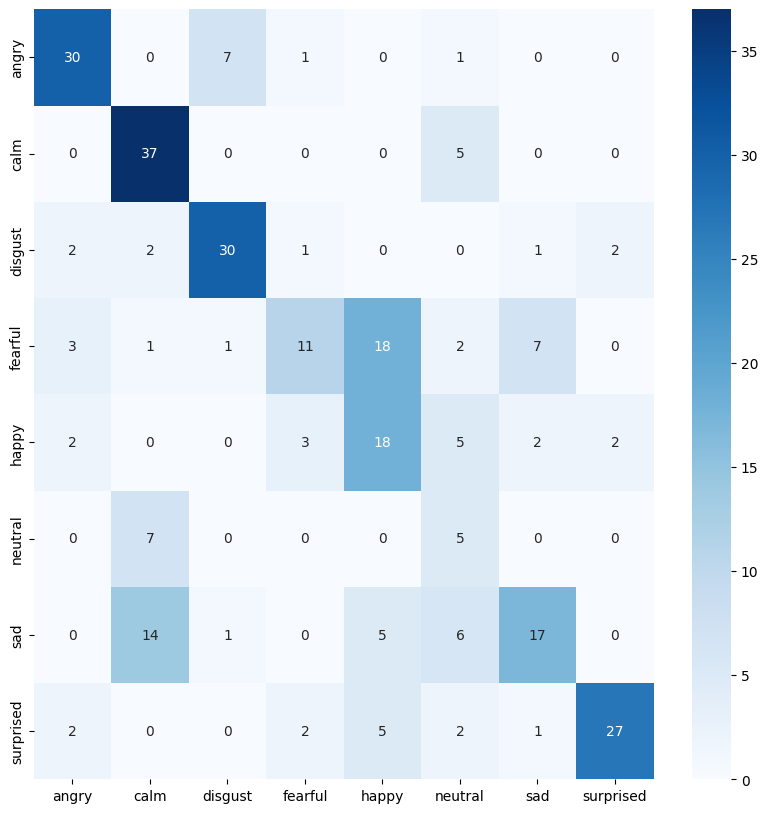

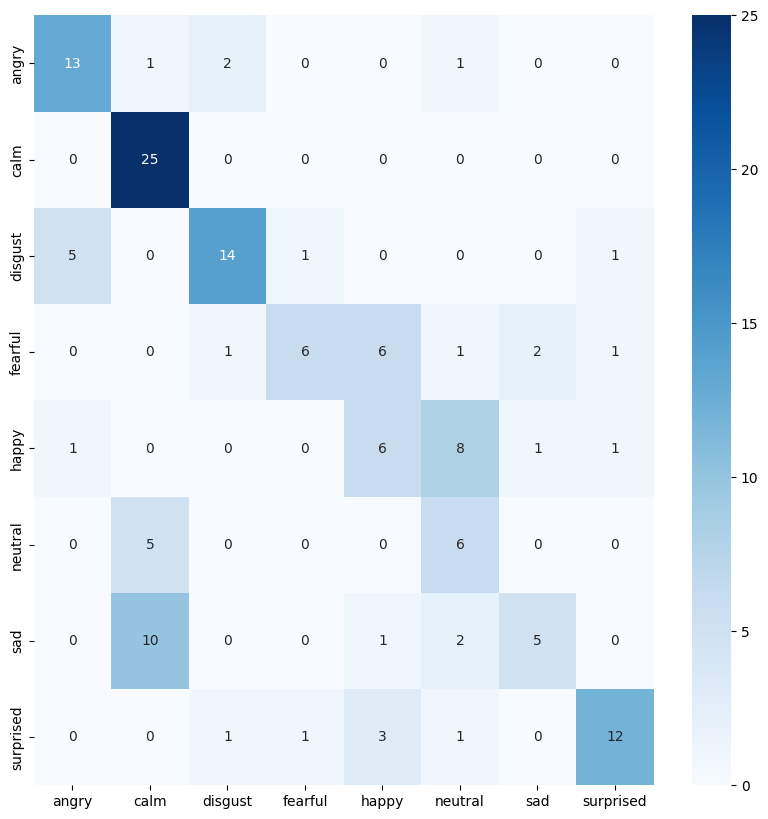

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_25"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-1d7fa36b63762ac9/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0926 
[Epoch][Batch] = [1][13] -> Loss = 2.0813 
[Epoch][Batch] = [1][26] -> Loss = 2.0769 
[Epoch][Batch] = [1][39] -> Loss = 2.0744 
[Epoch][Batch] = [1][52] -> Loss = 2.0720 
best_acc  0.22569444444444445
	Train -> Loss = 2.0688 /  accuracy = 0.1579
	Validation -> Loss = 2.0486 /  accuracy = 0.2257
[Epoch][Batch] = [2][0] -> Loss = 2.0627 
[Epoch][Batch] = [2][13] -> Loss = 2.0561 
[Epoch][Batch] = [2][26] -> Loss = 2.

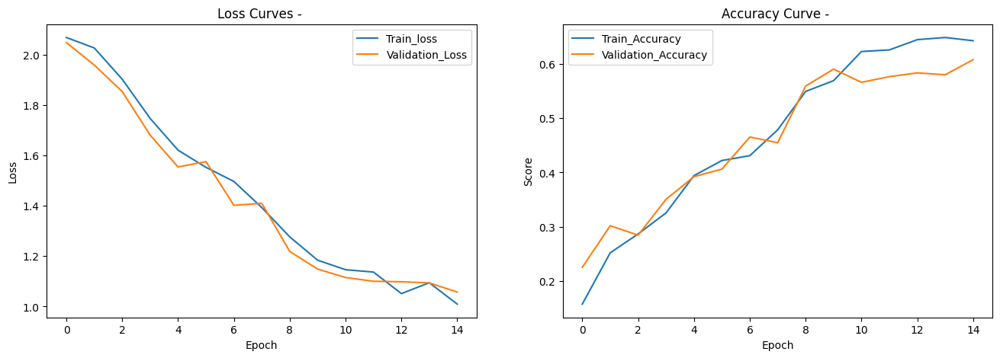

------------------------------ 
Best result on validation set -> Loss = 1.0609536270300548 Accuracy = 60.76 %
Validation Report
[('angry', 0.868421052631579), ('calm', 0.8809523809523809), ('disgust', 0.7105263157894737), ('fearful', 0.37209302325581395), ('happy', 0.18181818181818182), ('neutral', 0.5833333333333334), ('sad', 0.3023255813953488), ('surprised', 0.9230769230769231)]
              precision    recall  f1-score   support

       angry       0.63      0.87      0.73        38
        calm       0.65      0.88      0.75        42
     disgust       0.93      0.71      0.81        38
     fearful       0.73      0.37      0.49        43
       happy       0.27      0.18      0.22        33
     neutral       0.27      0.58      0.37        12
         sad       0.52      0.30      0.38        43
   surprised       0.65      0.92      0.77        39

    accuracy                           0.61       288
   macro avg       0.58      0.60      0.56       288
weighted avg       

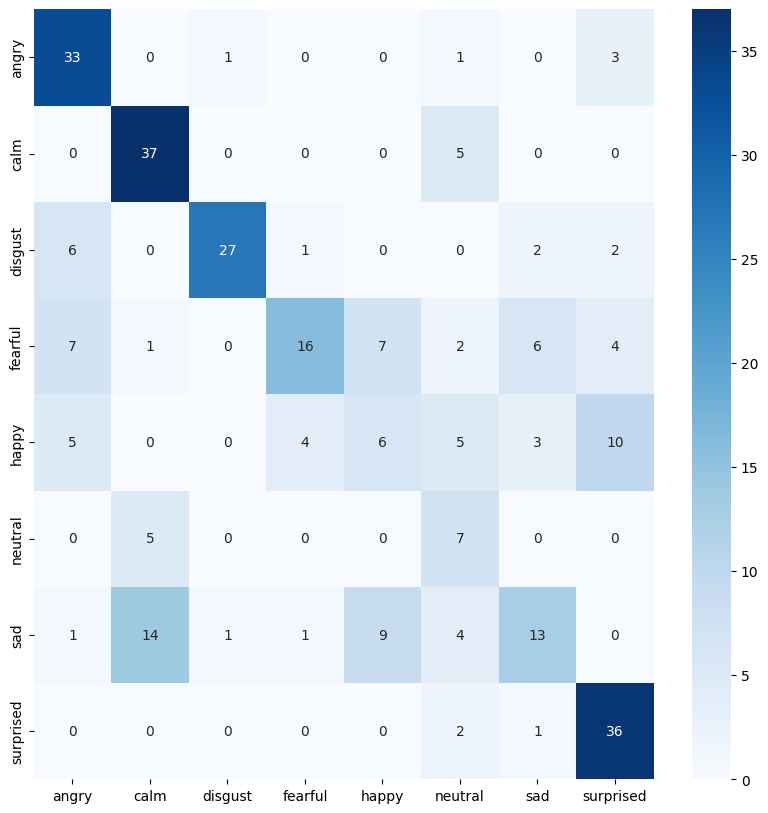

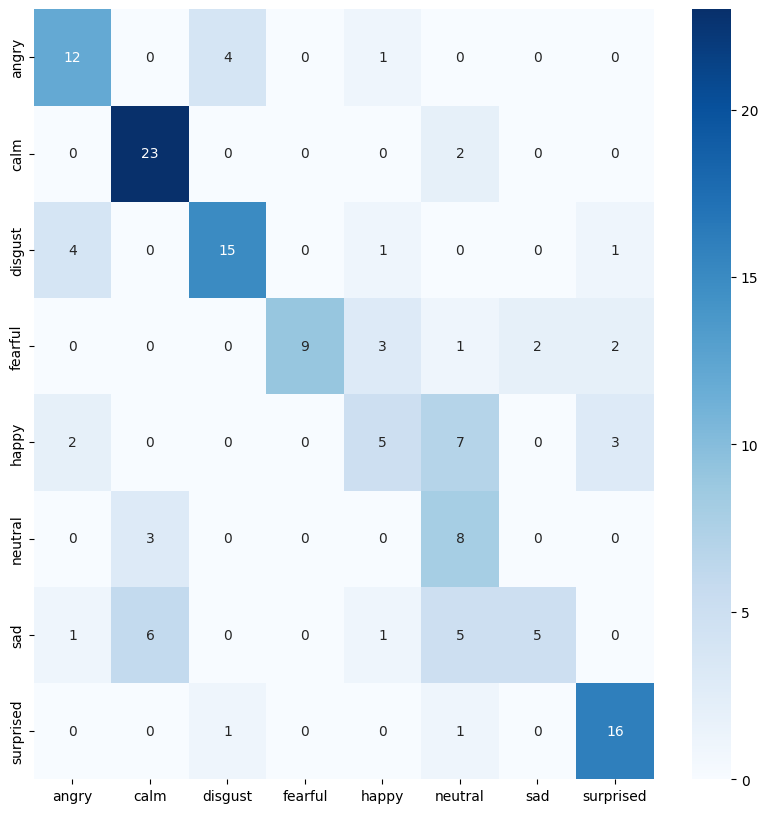

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_25"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-1a4e0e3e606c9434/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available


----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0664 
[Epoch][Batch] = [1][13] -> Loss = 2.0800 
[Epoch][Batch] = [1][26] -> Loss = 2.0795 
[Epoch][Batch] = [1][39] -> Loss = 2.0776 
[Epoch][Batch] = [1][52] -> Loss = 2.0758 
best_acc  0.2569444444444444
	Train -> Loss = 2.0726 /  accuracy = 0.1668
	Validation -> Loss = 2.0534 /  accuracy = 0.2569
[Epoch][Batch] = [2][0] -> Loss = 2.0660 
[Epoch][Batch] = [2][13] -> Loss = 2.0527 
[Epoch][Batch] = [2][26] -> Loss = 2.0485 
[Epoch][Batch] = [2][39] -> Loss = 2.0483 
[Epoch][Batch] = [2][52] -> Loss = 2.0454 
best_acc  0.3368055555555556
	Train -> Loss = 2.0398 /  accuracy = 0.2463
	Validation -> Loss = 1.9868 /  accuracy = 0.3368
[Epoch][Batch] = [3][0] -> Loss = 2.0401 
[Epoch][Batch] = [3][13] -> Loss = 1.9947 
[Epoch][Batch] = [3][26] -> Loss = 1.9827 
[Epoch][Batch] = [3][39] -> Loss = 1.9394 
[Epoch][Batch] = [3][52]

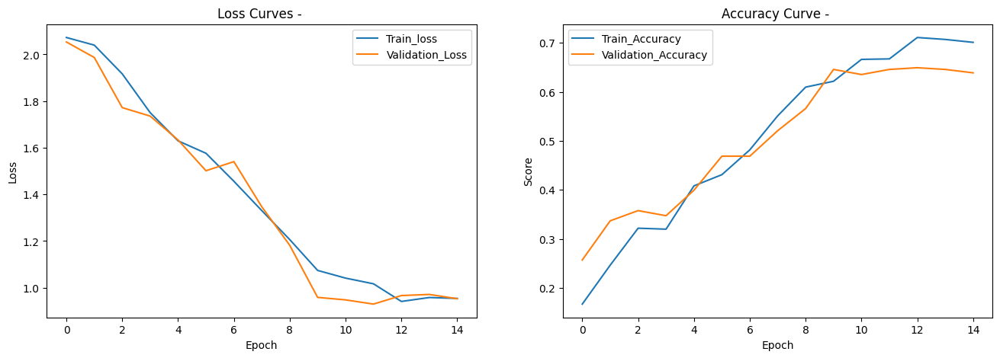

------------------------------ 
Best result on validation set -> Loss = 0.9654017206695344 Accuracy = 65.28 %
Validation Report
[('angry', 0.8461538461538461), ('calm', 0.8571428571428571), ('disgust', 0.9459459459459459), ('fearful', 0.4186046511627907), ('happy', 0.36363636363636365), ('neutral', 0.75), ('sad', 0.3023255813953488), ('surprised', 0.8205128205128205)]
              precision    recall  f1-score   support

       angry       0.72      0.85      0.78        39
        calm       0.67      0.86      0.75        42
     disgust       0.85      0.95      0.90        37
     fearful       0.82      0.42      0.55        43
       happy       0.52      0.36      0.43        33
     neutral       0.29      0.75      0.42        12
         sad       0.48      0.30      0.37        43
   surprised       0.73      0.82      0.77        39

    accuracy                           0.65       288
   macro avg       0.63      0.66      0.62       288
weighted avg       0.67      0.65

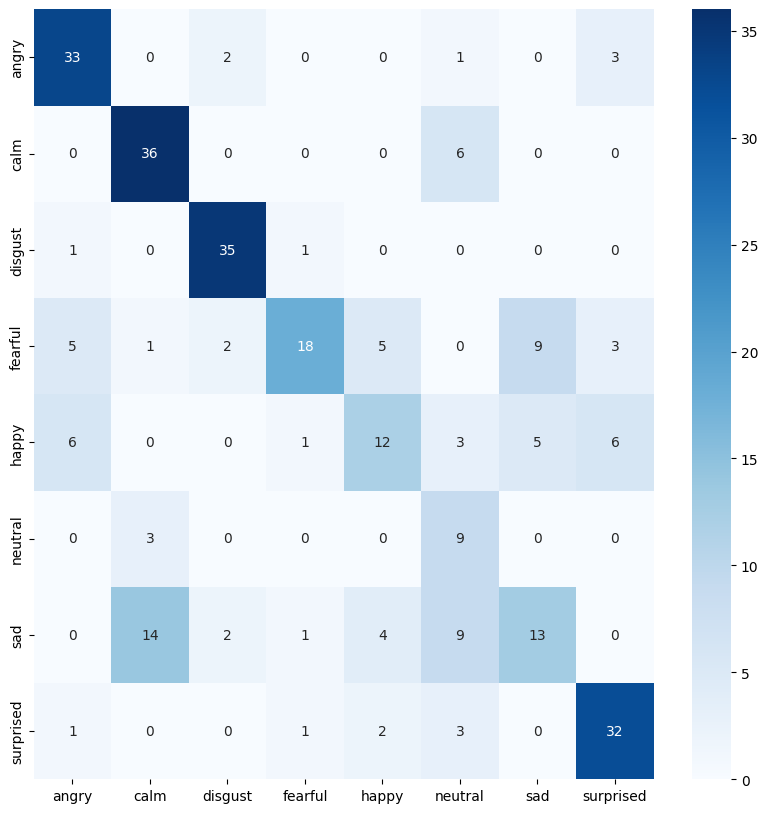

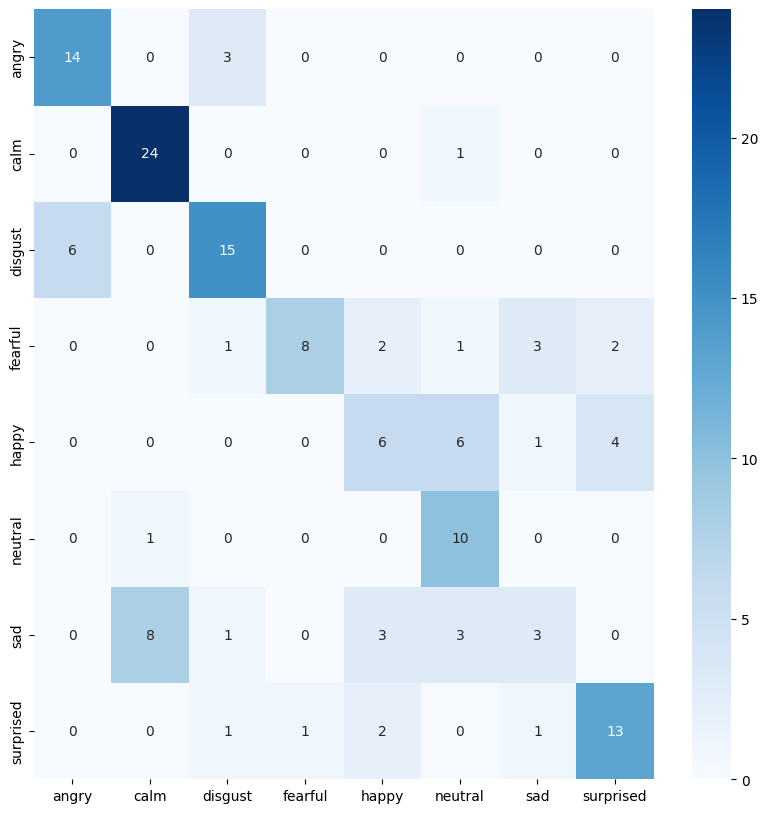

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_30"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-8ab376ec96068c77/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0635 
[Epoch][Batch] = [1][13] -> Loss = 2.0736 
[Epoch][Batch] = [1][26] -> Loss = 2.0714 
[Epoch][Batch] = [1][39] -> Loss = 2.0684 
[Epoch][Batch] = [1][52] -> Loss = 2.0649 
best_acc  0.2534722222222222
	Train -> Loss = 2.0652 /  accuracy = 0.1787
	Validation -> Loss = 2.0400 /  accuracy = 0.2535
[Epoch][Batch] = [2][0] -> Loss = 2.0477 
[Epoch][Batch] = [2][13] -> Loss = 2.0389 
[Epoch][Batch] = [2][26] -> Loss = 2.0

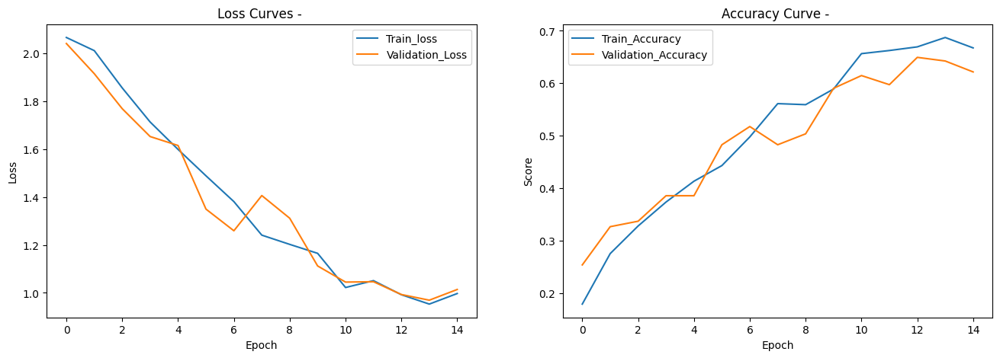

------------------------------ 
Best result on validation set -> Loss = 0.9995681345462799 Accuracy = 62.85 %
Validation Report
[('angry', 0.8974358974358975), ('calm', 0.9024390243902439), ('disgust', 0.8421052631578947), ('fearful', 0.23255813953488372), ('happy', 0.24242424242424243), ('neutral', 0.6666666666666666), ('sad', 0.3953488372093023), ('surprised', 0.8717948717948718)]
              precision    recall  f1-score   support

       angry       0.69      0.90      0.78        39
        calm       0.64      0.90      0.75        41
     disgust       0.91      0.84      0.88        38
     fearful       0.56      0.23      0.33        43
       happy       0.31      0.24      0.27        33
     neutral       0.40      0.67      0.50        12
         sad       0.59      0.40      0.47        43
   surprised       0.67      0.87      0.76        39

    accuracy                           0.63       288
   macro avg       0.59      0.63      0.59       288
weighted avg      

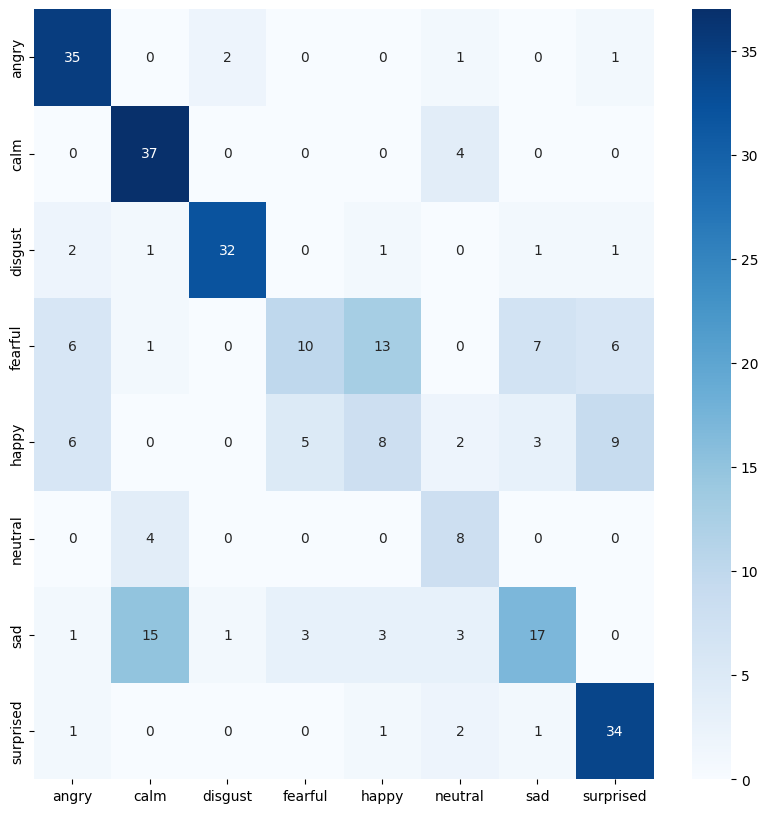

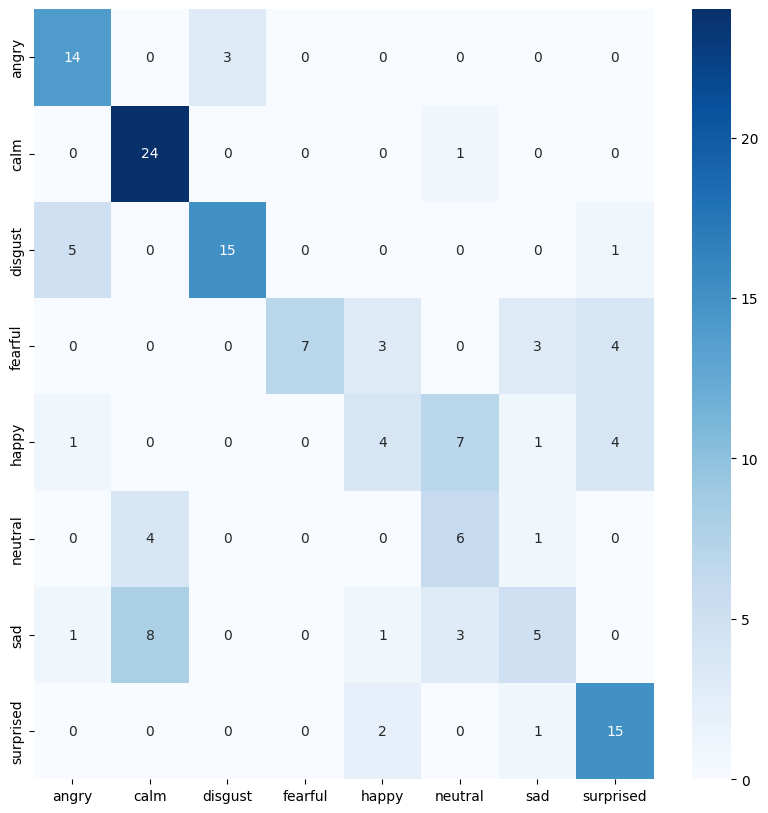

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_30"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-a3d7790c4e43b840/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0743 
[Epoch][Batch] = [1][13] -> Loss = 2.0798 
[Epoch][Batch] = [1][26] -> Loss = 2.0775 
[Epoch][Batch] = [1][39] -> Loss = 2.0767 
[Epoch][Batch] = [1][52] -> Loss = 2.0749 
best_acc  0.28125
	Train -> Loss = 2.0736 /  accuracy = 0.1619
	Validation -> Loss = 2.0522 /  accuracy = 0.2812
[Epoch][Batch] = [2][0] -> Loss = 2.0734 
[Epoch][Batch] = [2][13] -> Loss = 2.0535 
[Epoch][Batch] = [2][26] -> Loss = 2.0488 
[Epoch

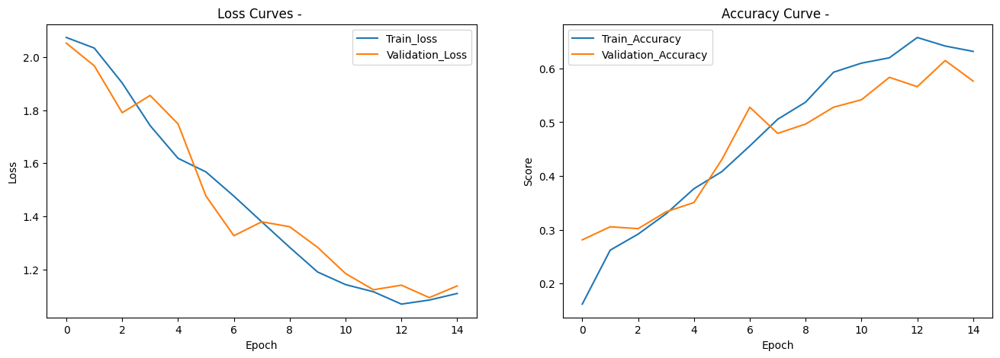

------------------------------ 
Best result on validation set -> Loss = 1.1034813688860998 Accuracy = 58.33 %
Validation Report
[('angry', 0.8205128205128205), ('calm', 0.7857142857142857), ('disgust', 0.7894736842105263), ('fearful', 0.19047619047619047), ('happy', 0.21212121212121213), ('neutral', 0.5833333333333334), ('sad', 0.37209302325581395), ('surprised', 0.8974358974358975)]
              precision    recall  f1-score   support

       angry       0.80      0.82      0.81        39
        calm       0.67      0.79      0.73        42
     disgust       0.83      0.79      0.81        38
     fearful       0.67      0.19      0.30        42
       happy       0.35      0.21      0.26        33
     neutral       0.17      0.58      0.26        12
         sad       0.42      0.37      0.40        43
   surprised       0.67      0.90      0.77        39

    accuracy                           0.58       288
   macro avg       0.57      0.58      0.54       288
weighted avg     

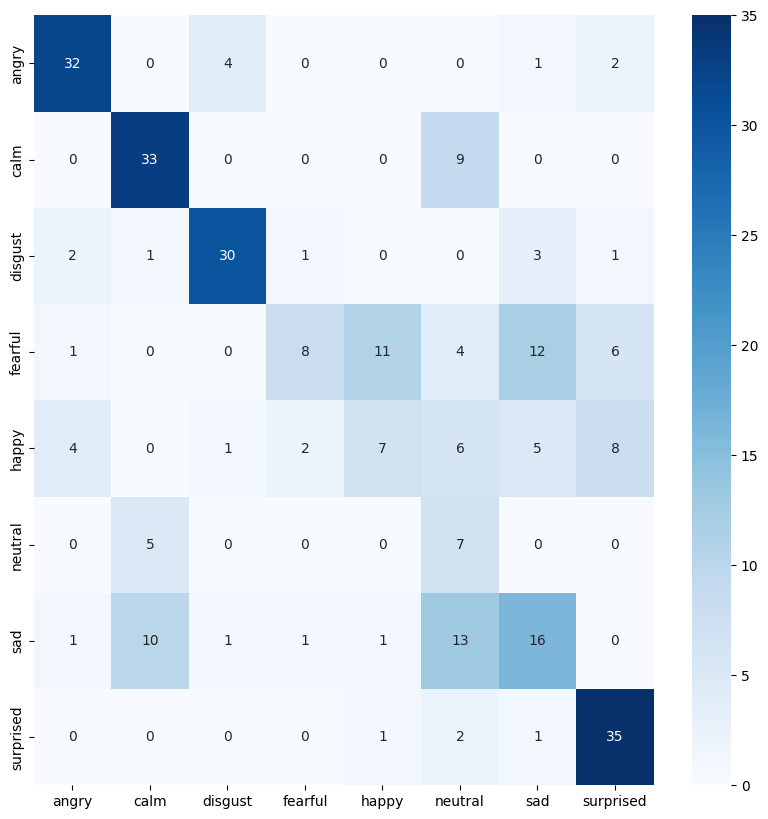

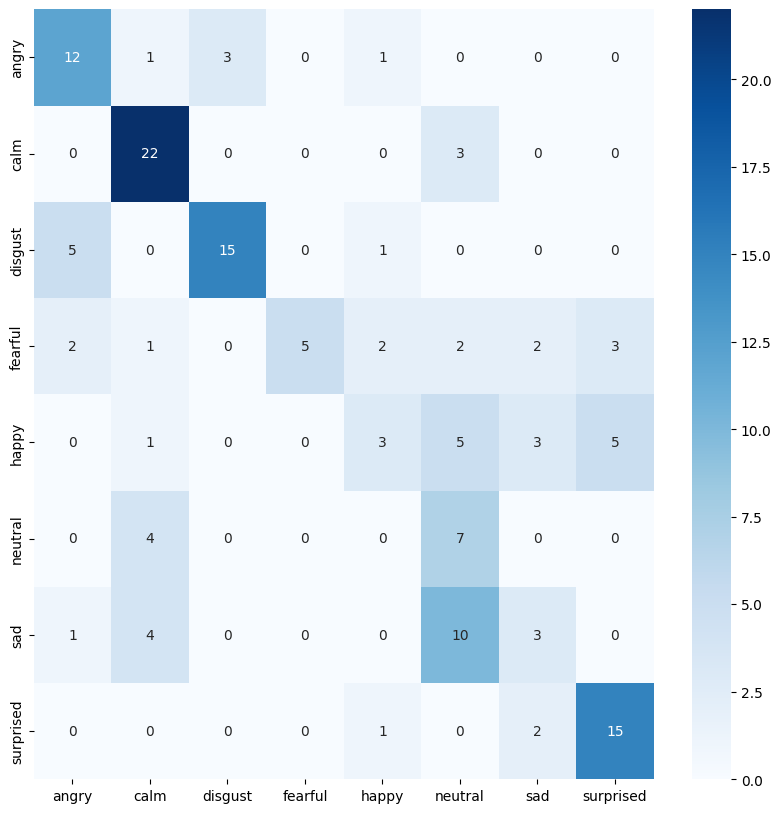

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_30"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-5a10b7d1a0a817c7/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.1097 
[Epoch][Batch] = [1][13] -> Loss = 2.0796 
[Epoch][Batch] = [1][26] -> Loss = 2.0759 
[Epoch][Batch] = [1][39] -> Loss = 2.0728 
[Epoch][Batch] = [1][52] -> Loss = 2.0691 
best_acc  0.3159722222222222
	Train -> Loss = 2.0655 /  accuracy = 0.1609
	Validation -> Loss = 2.0409 /  accuracy = 0.3160
[Epoch][Batch] = [2][0] -> Loss = 2.0298 
[Epoch][Batch] = [2][13] -> Loss = 2.0503 
[Epoch][Batch] = [2][26] -> Loss = 2.0

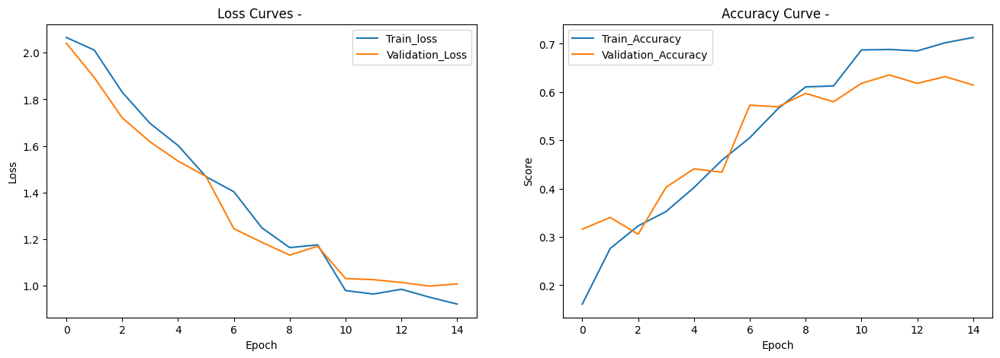

------------------------------ 
Best result on validation set -> Loss = 1.0247962408595614 Accuracy = 62.85 %
Validation Report
[('angry', 0.8461538461538461), ('calm', 0.9285714285714286), ('disgust', 0.8157894736842105), ('fearful', 0.2619047619047619), ('happy', 0.3939393939393939), ('neutral', 0.6666666666666666), ('sad', 0.3023255813953488), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.70      0.85      0.77        39
        calm       0.63      0.93      0.75        42
     disgust       0.86      0.82      0.84        38
     fearful       0.73      0.26      0.39        42
       happy       0.37      0.39      0.38        33
     neutral       0.31      0.67      0.42        12
         sad       0.52      0.30      0.38        43
   surprised       0.79      0.85      0.81        39

    accuracy                           0.63       288
   macro avg       0.61      0.63      0.59       288
weighted avg       0

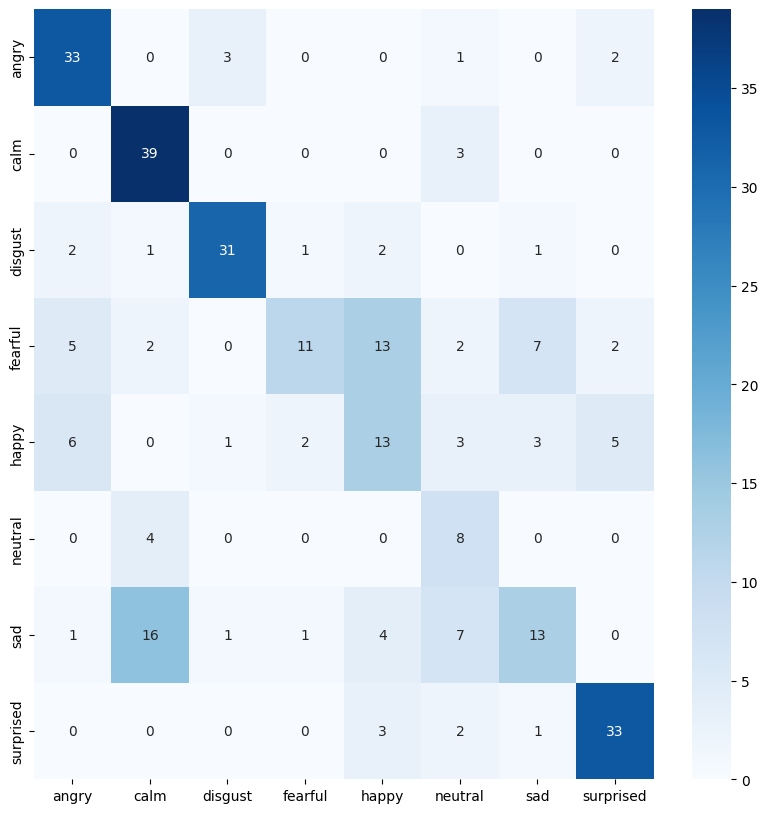

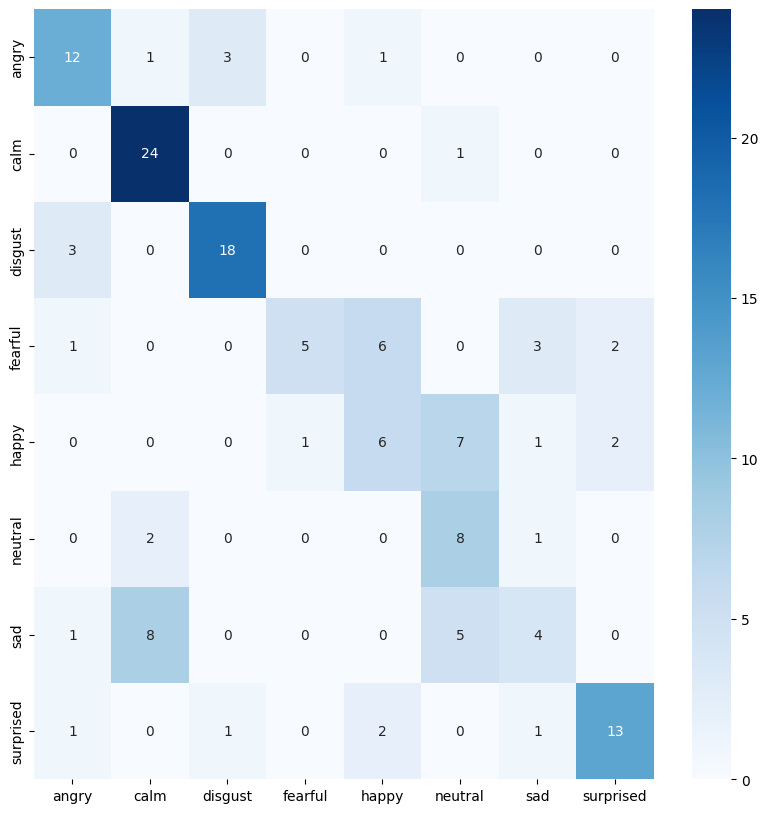

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_35"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-7c5b6758994da5b3/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0777 
[Epoch][Batch] = [1][13] -> Loss = 2.0796 
[Epoch][Batch] = [1][26] -> Loss = 2.0755 
[Epoch][Batch] = [1][39] -> Loss = 2.0737 
[Epoch][Batch] = [1][52] -> Loss = 2.0712 
best_acc  0.3298611111111111
	Train -> Loss = 2.0682 /  accuracy = 0.1738
	Validation -> Loss = 2.0487 /  accuracy = 0.3299
[Epoch][Batch] = [2][0] -> Loss = 2.0618 
[Epoch][Batch] = [2][13] -> Loss = 2.0431 
[Epoch][Batch] = [2][26] -> Loss = 2.0

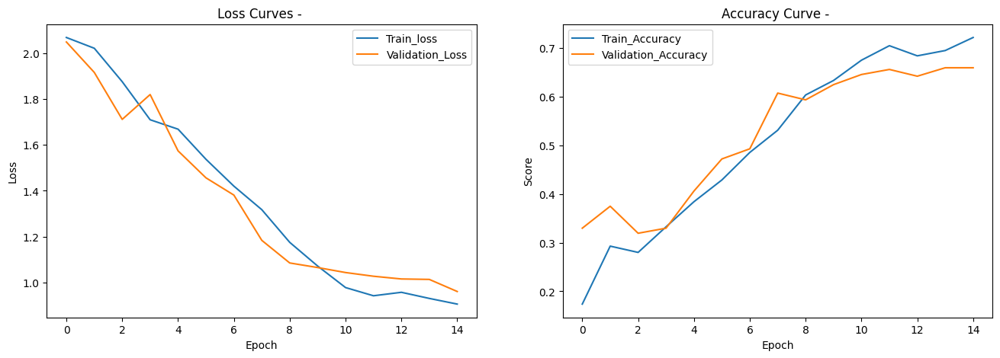

------------------------------ 
Best result on validation set -> Loss = 1.014186915424135 Accuracy = 64.24 %
Validation Report
[('angry', 0.8205128205128205), ('calm', 0.9523809523809523), ('disgust', 0.8421052631578947), ('fearful', 0.5476190476190477), ('happy', 0.2727272727272727), ('neutral', 0.5833333333333334), ('sad', 0.32558139534883723), ('surprised', 0.717948717948718)]
              precision    recall  f1-score   support

       angry       0.71      0.82      0.76        39
        calm       0.65      0.95      0.77        42
     disgust       0.84      0.84      0.84        38
     fearful       0.74      0.55      0.63        42
       happy       0.38      0.27      0.32        33
     neutral       0.24      0.58      0.34        12
         sad       0.61      0.33      0.42        43
   surprised       0.78      0.72      0.75        39

    accuracy                           0.64       288
   macro avg       0.62      0.63      0.60       288
weighted avg       0.

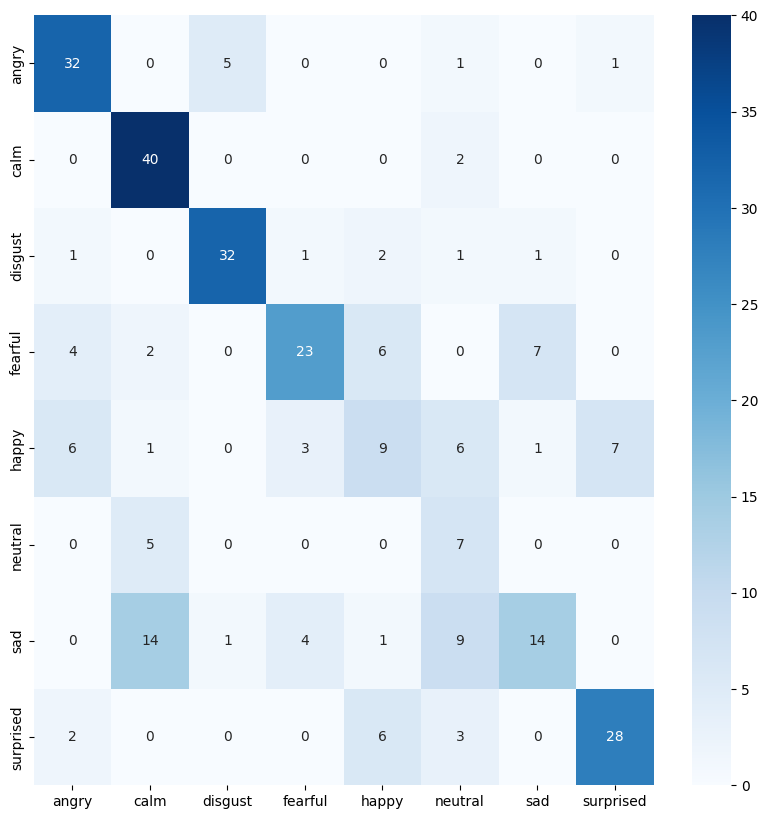

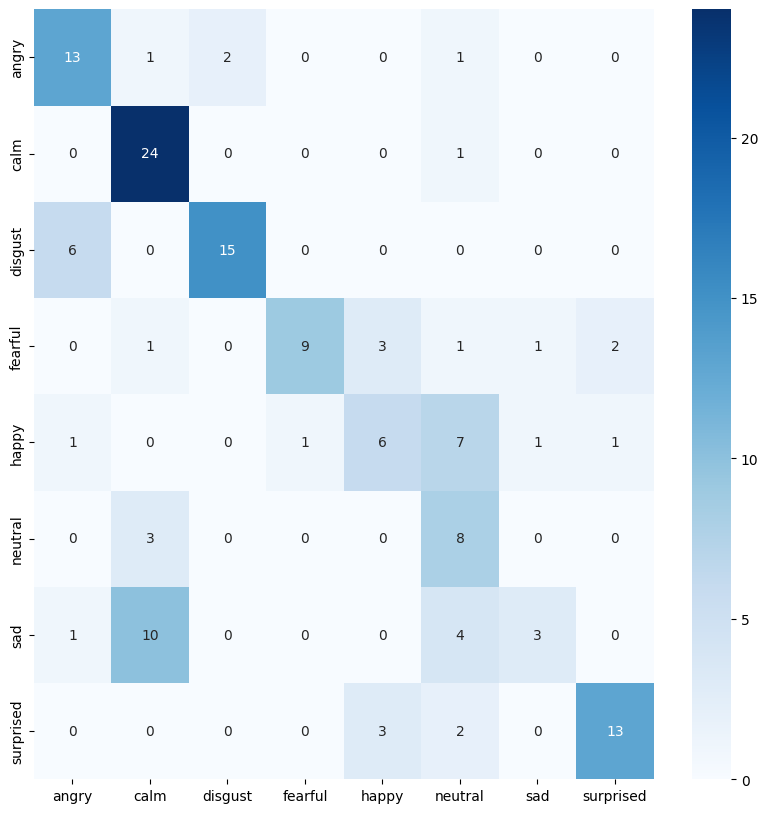

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_35"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-2ae3397d381bb8c5/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.1015 
[Epoch][Batch] = [1][13] -> Loss = 2.0792 
[Epoch][Batch] = [1][26] -> Loss = 2.0789 
[Epoch][Batch] = [1][39] -> Loss = 2.0759 
[Epoch][Batch] = [1][52] -> Loss = 2.0727 
best_acc  0.19444444444444445
	Train -> Loss = 2.0702 /  accuracy = 0.1648
	Validation -> Loss = 2.0512 /  accuracy = 0.1944
[Epoch][Batch] = [2][0] -> Loss = 2.0429 
[Epoch][Batch] = [2][13] -> Loss = 2.0414 
[Epoch][Batch] = [2][26] -> Loss = 2.

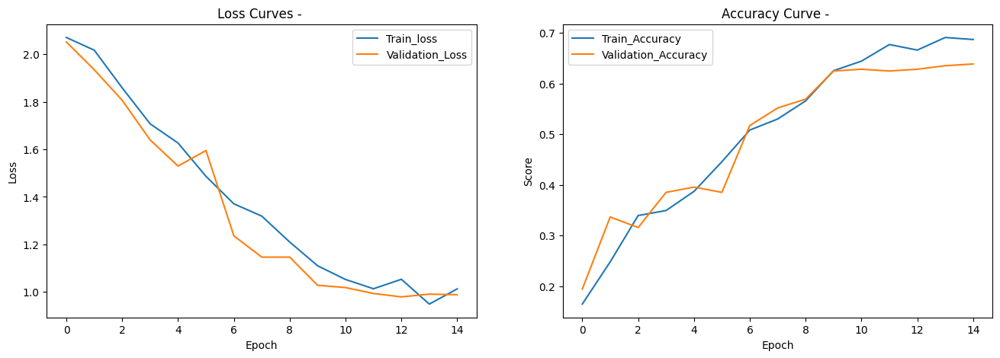

------------------------------ 
Best result on validation set -> Loss = 1.0010964969793956 Accuracy = 61.46 %
Validation Report
[('angry', 0.7692307692307693), ('calm', 0.9285714285714286), ('disgust', 0.9459459459459459), ('fearful', 0.20930232558139536), ('happy', 0.48484848484848486), ('neutral', 0.6666666666666666), ('sad', 0.20930232558139536), ('surprised', 0.7948717948717948)]
              precision    recall  f1-score   support

       angry       0.75      0.77      0.76        39
        calm       0.65      0.93      0.76        42
     disgust       0.78      0.95      0.85        37
     fearful       0.64      0.21      0.32        43
       happy       0.34      0.48      0.40        33
     neutral       0.30      0.67      0.41        12
         sad       0.53      0.21      0.30        43
   surprised       0.82      0.79      0.81        39

    accuracy                           0.61       288
   macro avg       0.60      0.63      0.58       288
weighted avg     

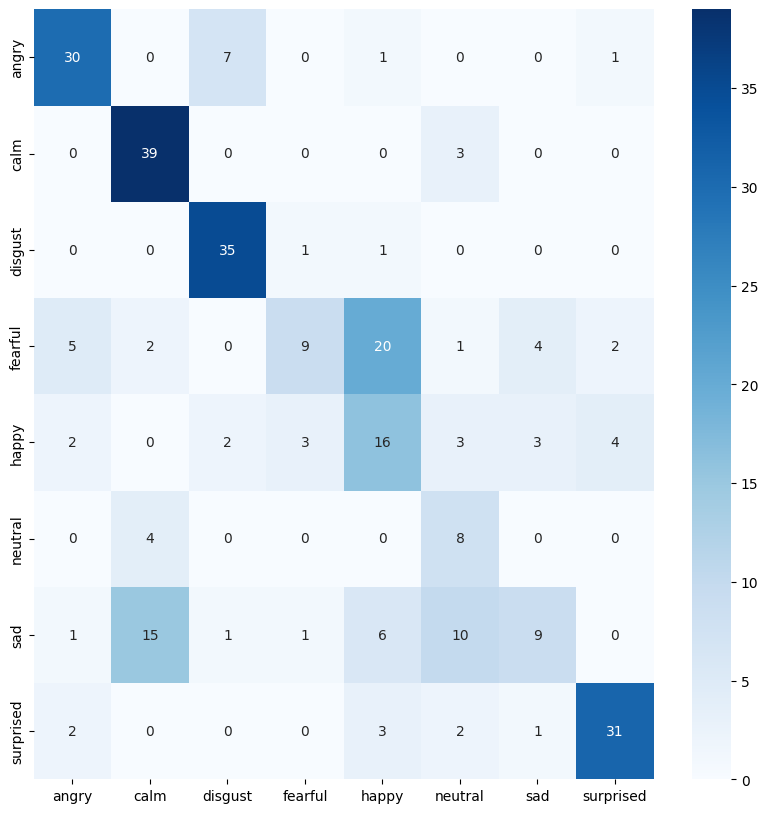

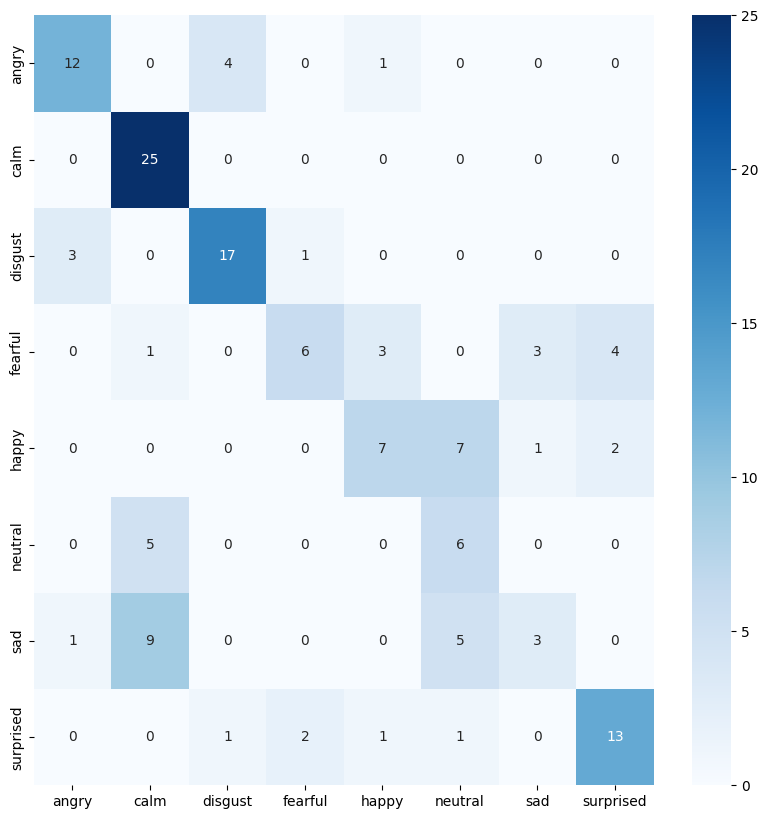

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_35"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-ced896d34d423b3a/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0711 
[Epoch][Batch] = [1][13] -> Loss = 2.0781 
[Epoch][Batch] = [1][26] -> Loss = 2.0744 
[Epoch][Batch] = [1][39] -> Loss = 2.0718 
[Epoch][Batch] = [1][52] -> Loss = 2.0715 
best_acc  0.22569444444444445
	Train -> Loss = 2.0704 /  accuracy = 0.1549
	Validation -> Loss = 2.0435 /  accuracy = 0.2257
[Epoch][Batch] = [2][0] -> Loss = 2.0590 
[Epoch][Batch] = [2][13] -> Loss = 2.0485 
[Epoch][Batch] = [2][26] -> Loss = 2.

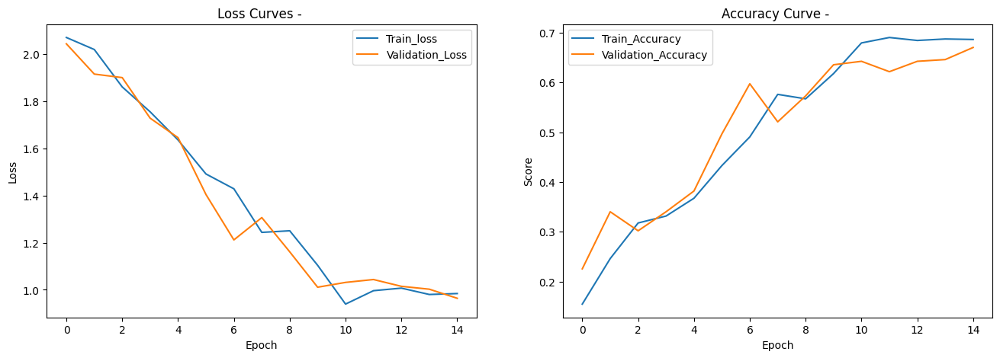

------------------------------ 
Best result on validation set -> Loss = 0.9743386142783694 Accuracy = 66.67 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.926829268292683), ('disgust', 0.868421052631579), ('fearful', 0.46511627906976744), ('happy', 0.3333333333333333), ('neutral', 0.5), ('sad', 0.3953488372093023), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.69      0.87      0.77        39
        calm       0.66      0.93      0.77        41
     disgust       0.87      0.87      0.87        38
     fearful       0.74      0.47      0.57        43
       happy       0.46      0.33      0.39        33
     neutral       0.26      0.50      0.34        12
         sad       0.61      0.40      0.48        43
   surprised       0.80      0.85      0.83        39

    accuracy                           0.67       288
   macro avg       0.64      0.65      0.63       288
weighted avg       0.68      0.67   

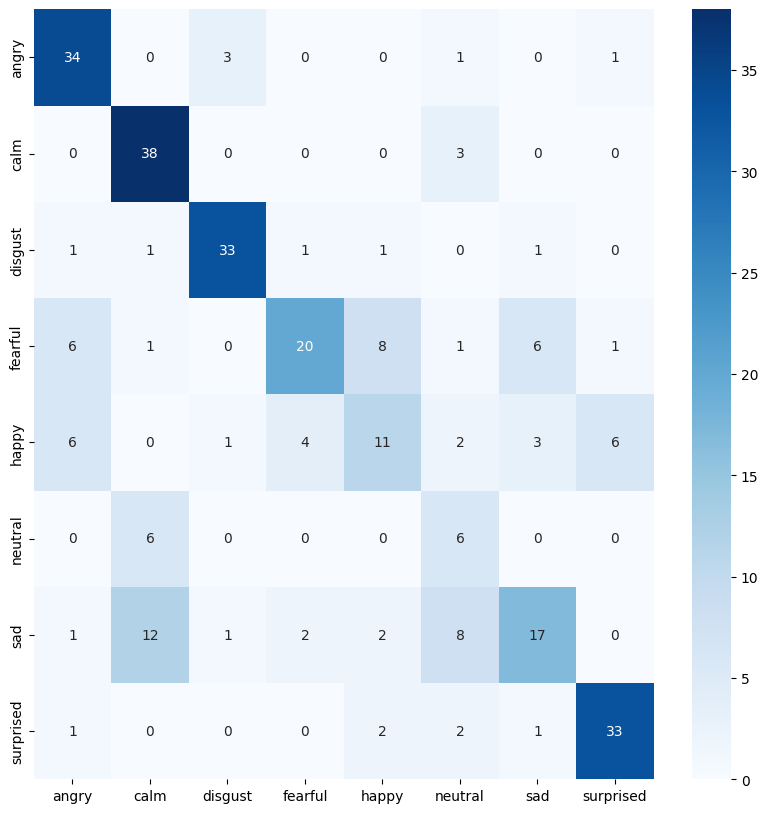

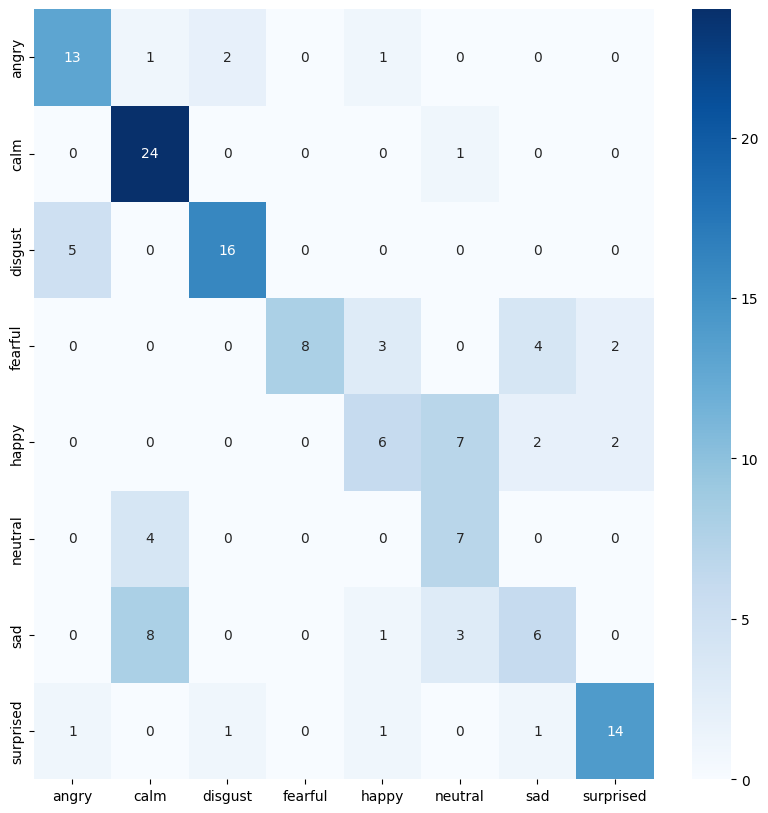

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_40"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-f5703ae9438a15bd/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0647 
[Epoch][Batch] = [1][13] -> Loss = 2.0779 
[Epoch][Batch] = [1][26] -> Loss = 2.0734 
[Epoch][Batch] = [1][39] -> Loss = 2.0716 
[Epoch][Batch] = [1][52] -> Loss = 2.0696 
best_acc  0.1909722222222222
	Train -> Loss = 2.0681 /  accuracy = 0.1599
	Validation -> Loss = 2.0444 /  accuracy = 0.1910
[Epoch][Batch] = [2][0] -> Loss = 2.0539 
[Epoch][Batch] = [2][13] -> Loss = 2.0438 
[Epoch][Batch] = [2][26] -> Loss = 2.0

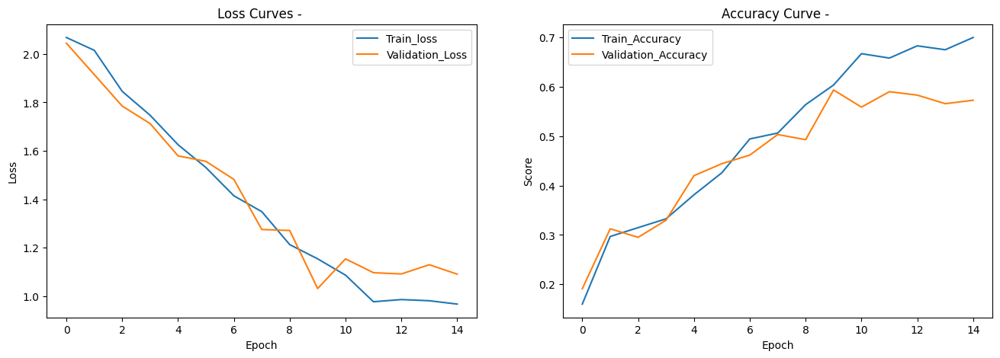

------------------------------ 
Best result on validation set -> Loss = 1.0504656533400218 Accuracy = 59.03 %
Validation Report
[('angry', 0.717948717948718), ('calm', 0.8809523809523809), ('disgust', 0.868421052631579), ('fearful', 0.16279069767441862), ('happy', 0.5454545454545454), ('neutral', 0.75), ('sad', 0.4523809523809524), ('surprised', 0.48717948717948717)]
              precision    recall  f1-score   support

       angry       0.80      0.72      0.76        39
        calm       0.67      0.88      0.76        42
     disgust       0.80      0.87      0.84        38
     fearful       0.50      0.16      0.25        43
       happy       0.30      0.55      0.38        33
     neutral       0.43      0.75      0.55        12
         sad       0.50      0.45      0.48        42
   surprised       0.83      0.49      0.61        39

    accuracy                           0.59       288
   macro avg       0.60      0.61      0.58       288
weighted avg       0.62      0.59 

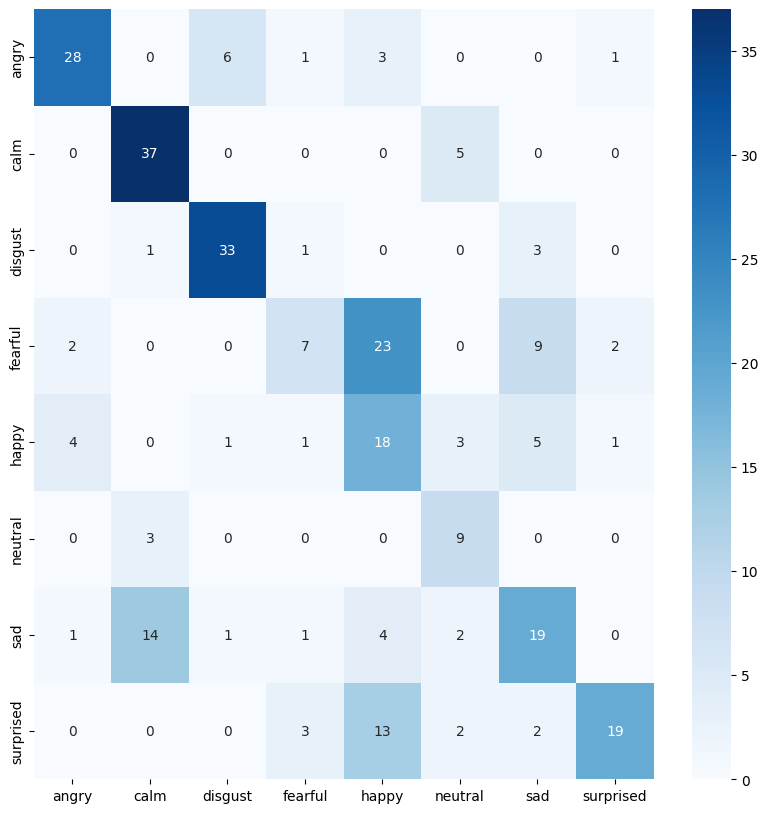

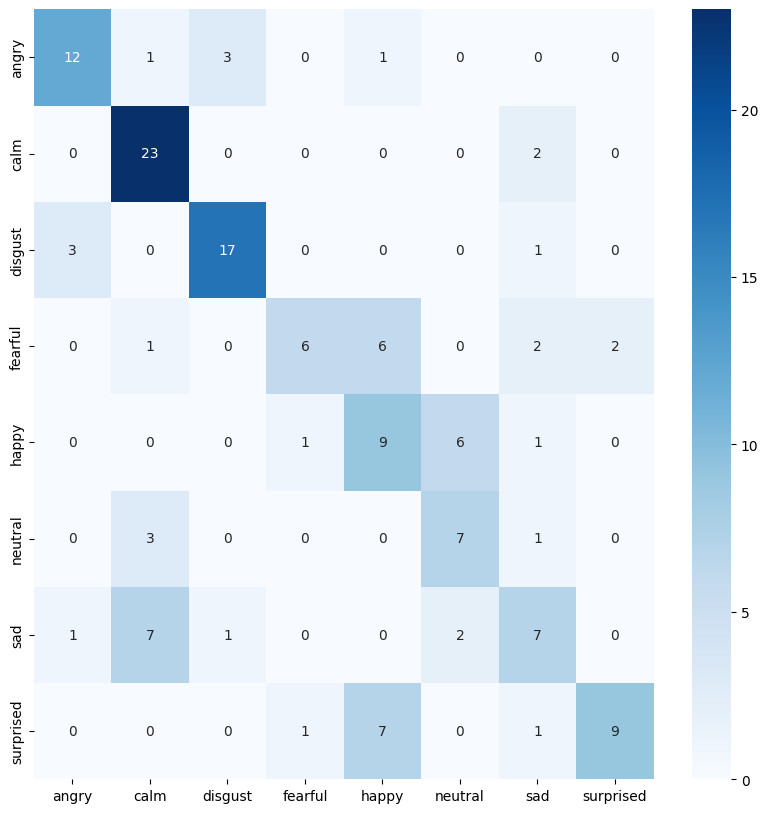

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_40"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-8241efcdf5f5d1d6/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0732 
[Epoch][Batch] = [1][13] -> Loss = 2.0822 
[Epoch][Batch] = [1][26] -> Loss = 2.0772 
[Epoch][Batch] = [1][39] -> Loss = 2.0758 
[Epoch][Batch] = [1][52] -> Loss = 2.0725 
best_acc  0.19444444444444445
	Train -> Loss = 2.0699 /  accuracy = 0.1678
	Validation -> Loss = 2.0508 /  accuracy = 0.1944
[Epoch][Batch] = [2][0] -> Loss = 2.0504 
[Epoch][Batch] = [2][13] -> Loss = 2.0489 
[Epoch][Batch] = [2][26] -> Loss = 2.

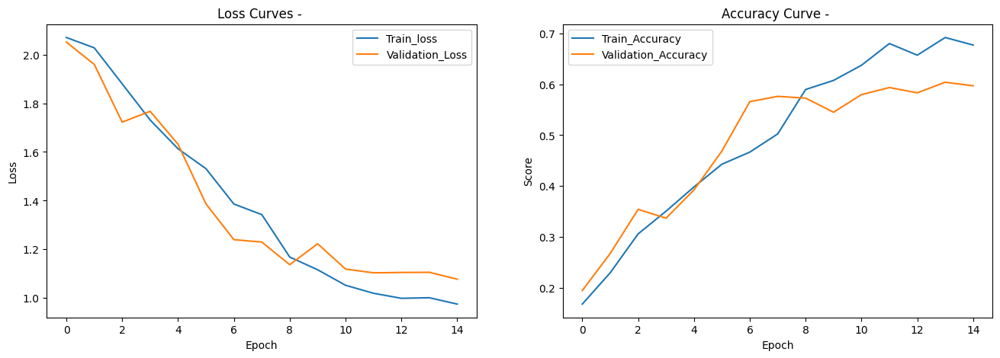

------------------------------ 
Best result on validation set -> Loss = 1.1247738500436146 Accuracy = 59.03 %
Validation Report
[('angry', 0.8157894736842105), ('calm', 0.9523809523809523), ('disgust', 0.8157894736842105), ('fearful', 0.11627906976744186), ('happy', 0.5151515151515151), ('neutral', 0.6666666666666666), ('sad', 0.3023255813953488), ('surprised', 0.6410256410256411)]
              precision    recall  f1-score   support

       angry       0.69      0.82      0.75        38
        calm       0.62      0.95      0.75        42
     disgust       0.82      0.82      0.82        38
     fearful       0.62      0.12      0.20        43
       happy       0.33      0.52      0.40        33
     neutral       0.30      0.67      0.41        12
         sad       0.54      0.30      0.39        43
   surprised       0.83      0.64      0.72        39

    accuracy                           0.59       288
   macro avg       0.59      0.60      0.55       288
weighted avg       

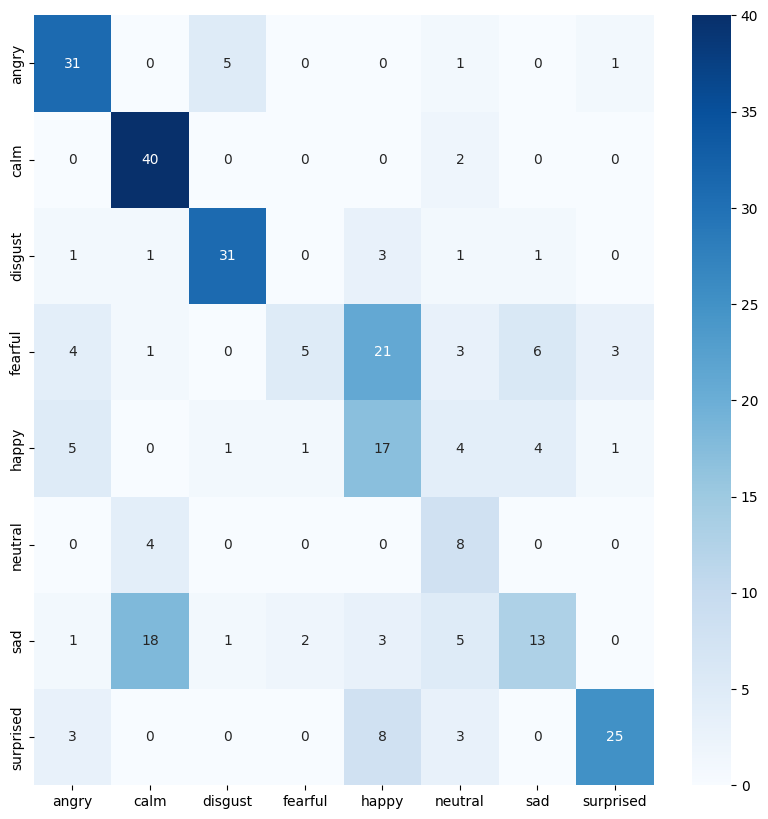

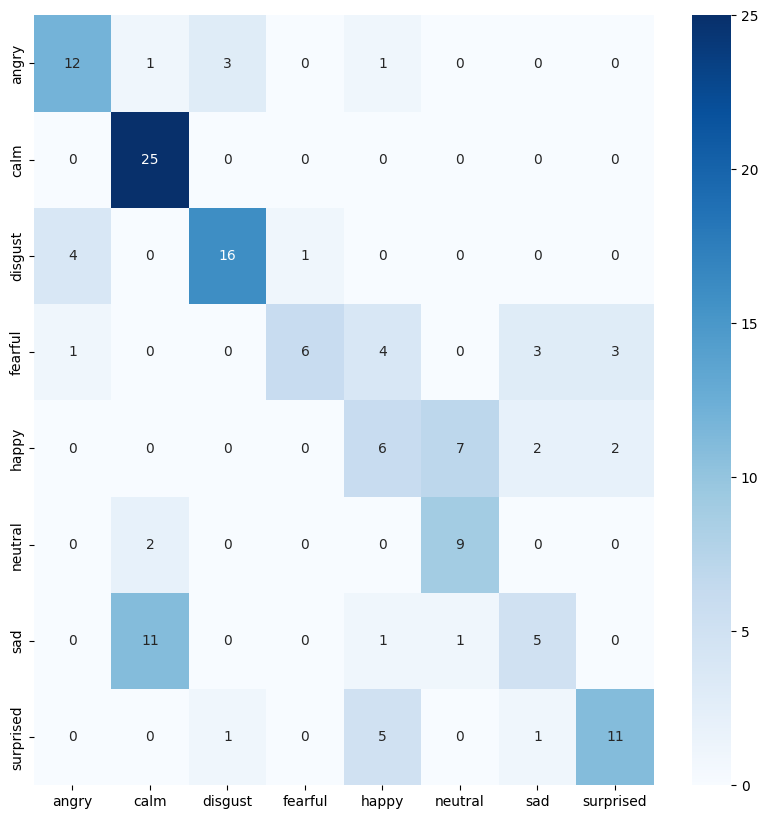

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_40"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-f11352866613492e/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0879 
[Epoch][Batch] = [1][13] -> Loss = 2.0757 
[Epoch][Batch] = [1][26] -> Loss = 2.0729 
[Epoch][Batch] = [1][39] -> Loss = 2.0697 
[Epoch][Batch] = [1][52] -> Loss = 2.0674 
best_acc  0.3194444444444444
	Train -> Loss = 2.0651 /  accuracy = 0.2165
	Validation -> Loss = 2.0430 /  accuracy = 0.3194
[Epoch][Batch] = [2][0] -> Loss = 2.0516 
[Epoch][Batch] = [2][13] -> Loss = 2.0416 
[Epoch][Batch] = [2][26] -> Loss = 2.0

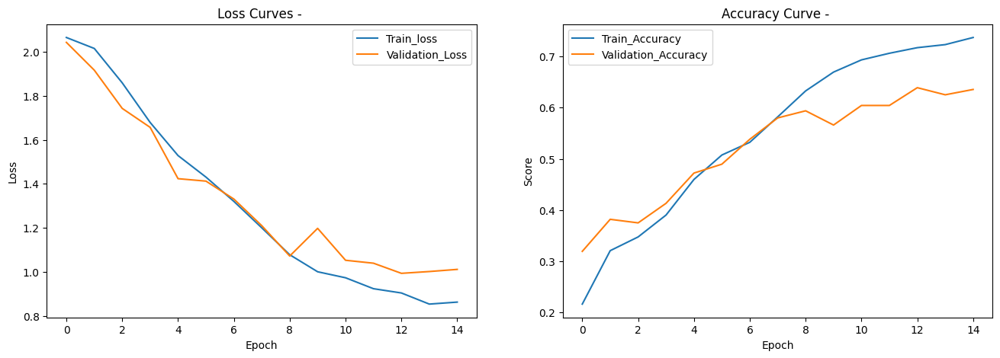

------------------------------ 
Best result on validation set -> Loss = 0.9994184093342887 Accuracy = 62.50 %
Validation Report
[('angry', 0.8461538461538461), ('calm', 0.7380952380952381), ('disgust', 0.8157894736842105), ('fearful', 0.30952380952380953), ('happy', 0.45454545454545453), ('neutral', 0.9166666666666666), ('sad', 0.32558139534883723), ('surprised', 0.8205128205128205)]
              precision    recall  f1-score   support

       angry       0.87      0.85      0.86        39
        calm       0.66      0.74      0.70        42
     disgust       0.89      0.82      0.85        38
     fearful       0.65      0.31      0.42        42
       happy       0.45      0.45      0.45        33
     neutral       0.26      0.92      0.40        12
         sad       0.45      0.33      0.38        43
   surprised       0.78      0.82      0.80        39

    accuracy                           0.62       288
   macro avg       0.63      0.65      0.61       288
weighted avg     

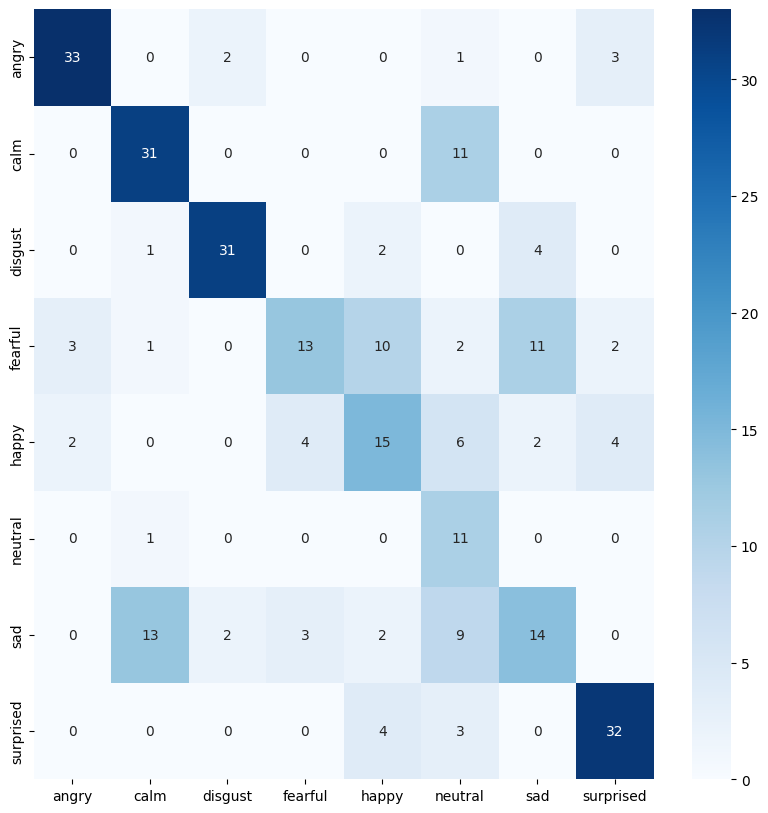

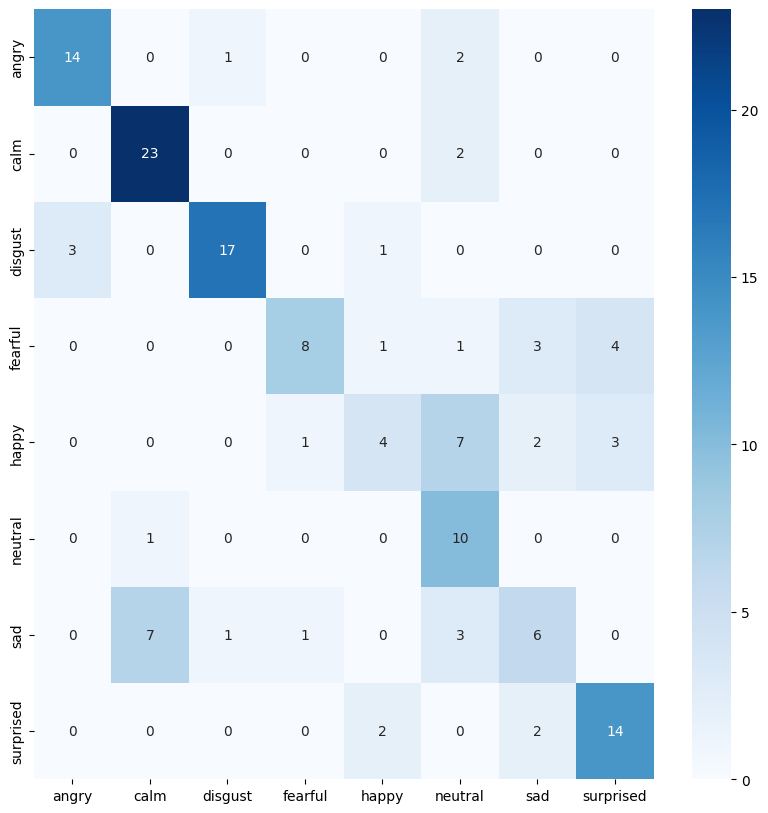

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_45"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-3823043fe648a875/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0787 
[Epoch][Batch] = [1][13] -> Loss = 2.0816 
[Epoch][Batch] = [1][26] -> Loss = 2.0795 
[Epoch][Batch] = [1][39] -> Loss = 2.0739 
[Epoch][Batch] = [1][52] -> Loss = 2.0721 
best_acc  0.2326388888888889
	Train -> Loss = 2.0697 /  accuracy = 0.1678
	Validation -> Loss = 2.0456 /  accuracy = 0.2326
[Epoch][Batch] = [2][0] -> Loss = 2.0366 
[Epoch][Batch] = [2][13] -> Loss = 2.0495 
[Epoch][Batch] = [2][26] -> Loss = 2.0

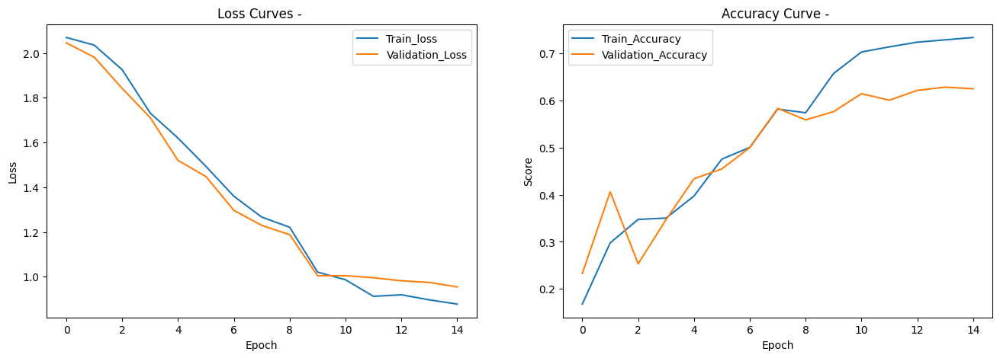

------------------------------ 
Best result on validation set -> Loss = 0.9493228064643012 Accuracy = 63.54 %
Validation Report
[('angry', 0.8205128205128205), ('calm', 0.8333333333333334), ('disgust', 0.8947368421052632), ('fearful', 0.2558139534883721), ('happy', 0.5454545454545454), ('neutral', 0.75), ('sad', 0.40476190476190477), ('surprised', 0.6923076923076923)]
              precision    recall  f1-score   support

       angry       0.78      0.82      0.80        39
        calm       0.66      0.83      0.74        42
     disgust       0.83      0.89      0.86        38
     fearful       0.85      0.26      0.39        43
       happy       0.42      0.55      0.47        33
     neutral       0.33      0.75      0.46        12
         sad       0.46      0.40      0.43        42
   surprised       0.82      0.69      0.75        39

    accuracy                           0.64       288
   macro avg       0.64      0.65      0.61       288
weighted avg       0.68      0.64

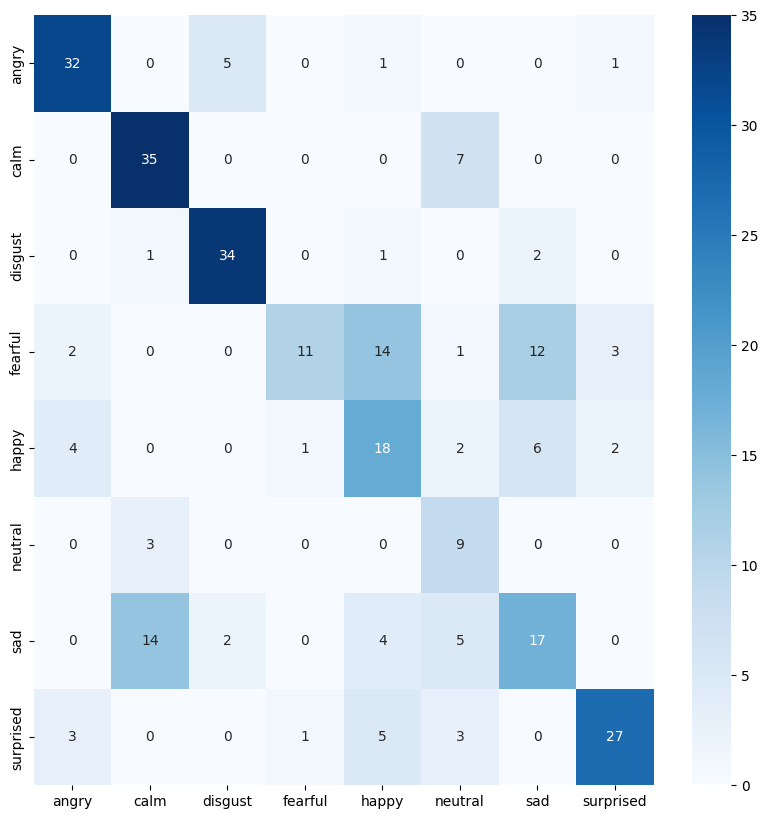

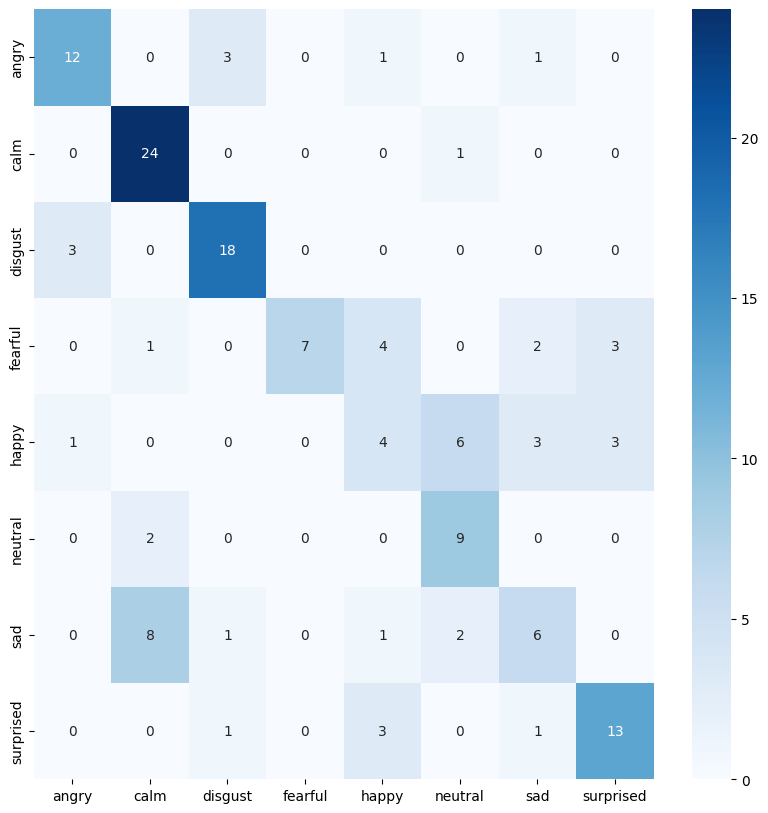

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_45"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-9c39a579f316a64d/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0858 
[Epoch][Batch] = [1][13] -> Loss = 2.0729 
[Epoch][Batch] = [1][26] -> Loss = 2.0773 
[Epoch][Batch] = [1][39] -> Loss = 2.0754 
[Epoch][Batch] = [1][52] -> Loss = 2.0727 
best_acc  0.3020833333333333
	Train -> Loss = 2.0713 /  accuracy = 0.1559
	Validation -> Loss = 2.0497 /  accuracy = 0.3021
[Epoch][Batch] = [2][0] -> Loss = 2.0600 
[Epoch][Batch] = [2][13] -> Loss = 2.0517 
[Epoch][Batch] = [2][26] -> Loss = 2.0

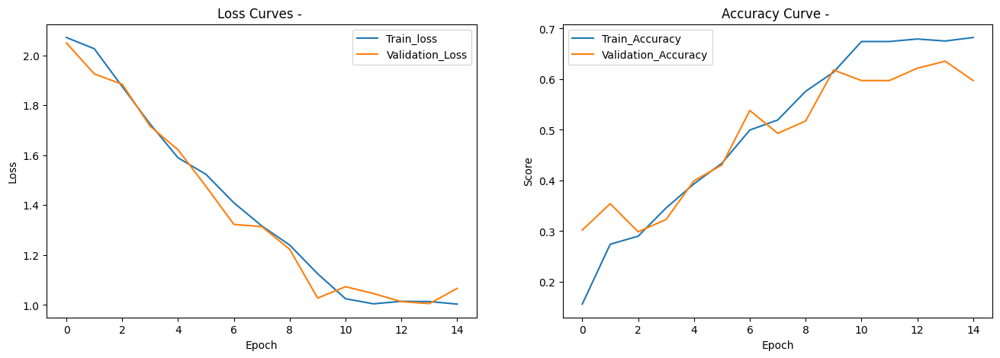

------------------------------ 
Best result on validation set -> Loss = 1.0027072098520067 Accuracy = 63.89 %
Validation Report
[('angry', 0.7948717948717948), ('calm', 0.9047619047619048), ('disgust', 0.9473684210526315), ('fearful', 0.5), ('happy', 0.21212121212121213), ('neutral', 0.6666666666666666), ('sad', 0.32558139534883723), ('surprised', 0.7435897435897436)]
              precision    recall  f1-score   support

       angry       0.76      0.79      0.77        39
        calm       0.68      0.90      0.78        42
     disgust       0.80      0.95      0.87        38
     fearful       0.75      0.50      0.60        42
       happy       0.35      0.21      0.26        33
     neutral       0.27      0.67      0.38        12
         sad       0.54      0.33      0.41        43
   surprised       0.69      0.74      0.72        39

    accuracy                           0.64       288
   macro avg       0.60      0.64      0.60       288
weighted avg       0.64      0.64

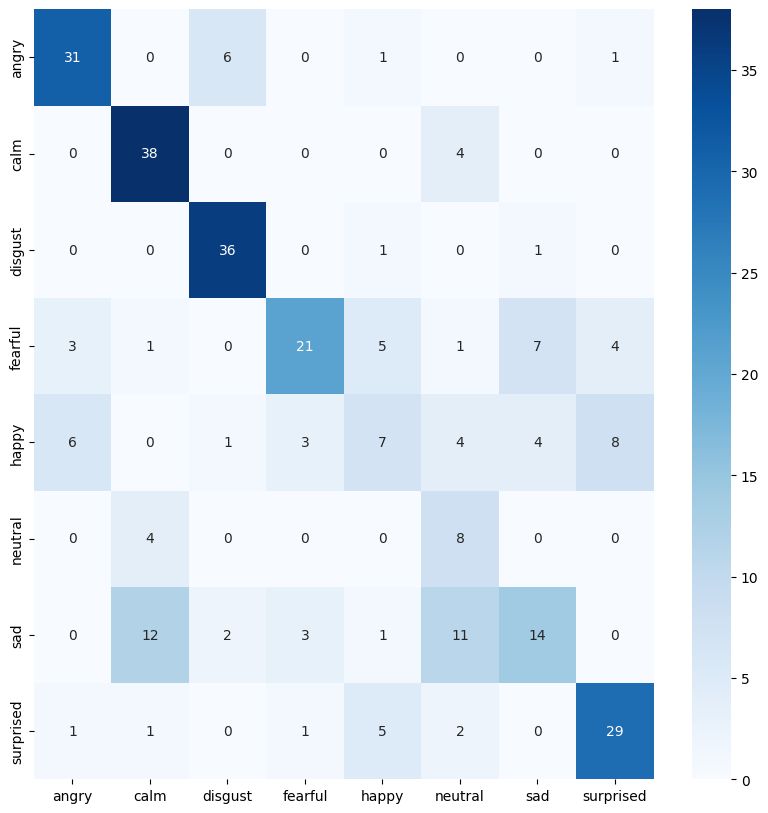

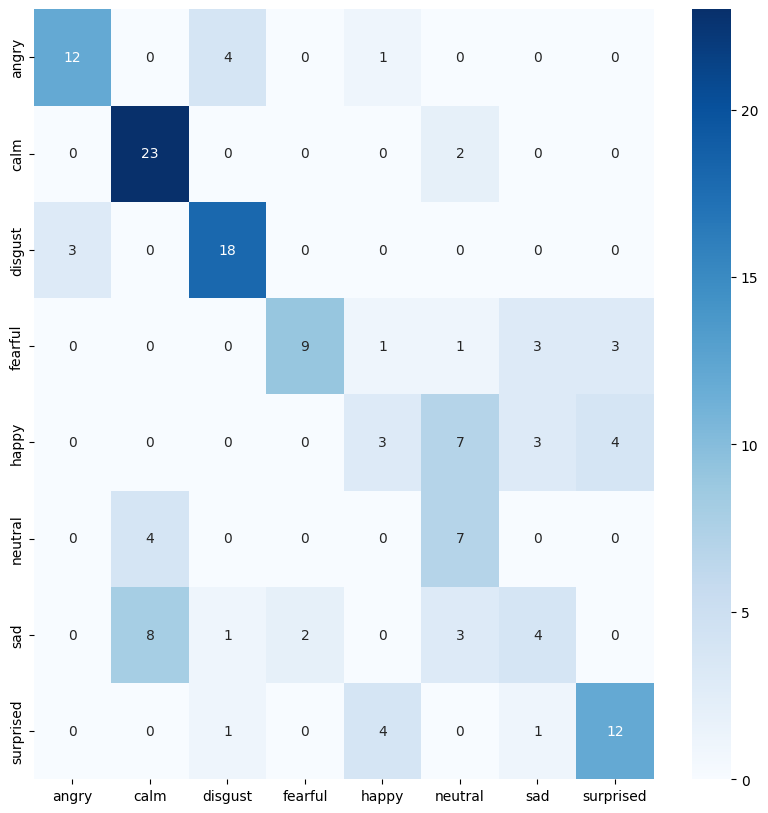

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_45"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-22bd7f6d63523f85/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0990 
[Epoch][Batch] = [1][13] -> Loss = 2.0761 
[Epoch][Batch] = [1][26] -> Loss = 2.0737 
[Epoch][Batch] = [1][39] -> Loss = 2.0715 
[Epoch][Batch] = [1][52] -> Loss = 2.0717 
best_acc  0.2152777777777778
	Train -> Loss = 2.0696 /  accuracy = 0.1559
	Validation -> Loss = 2.0522 /  accuracy = 0.2153
[Epoch][Batch] = [2][0] -> Loss = 2.0600 
[Epoch][Batch] = [2][13] -> Loss = 2.0533 
[Epoch][Batch] = [2][26] -> Loss = 2.0

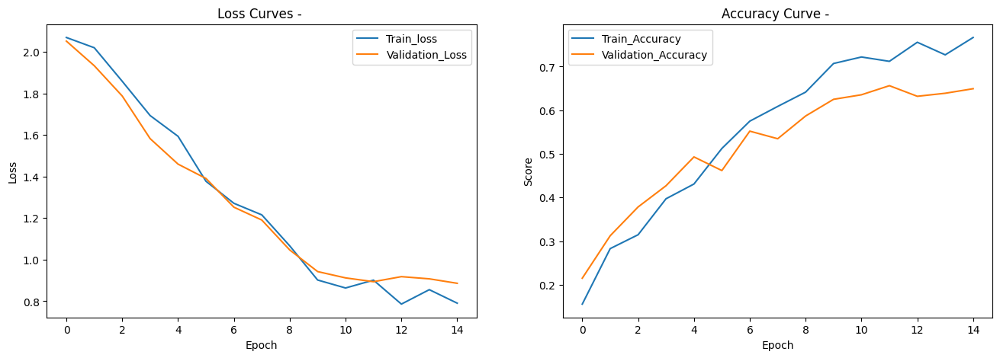

------------------------------ 
Best result on validation set -> Loss = 0.8958049052291446 Accuracy = 65.28 %
Validation Report
[('angry', 0.7105263157894737), ('calm', 0.8095238095238095), ('disgust', 0.7894736842105263), ('fearful', 0.4883720930232558), ('happy', 0.5757575757575758), ('neutral', 0.8333333333333334), ('sad', 0.3953488372093023), ('surprised', 0.7692307692307693)]
              precision    recall  f1-score   support

       angry       0.77      0.71      0.74        38
        calm       0.68      0.81      0.74        42
     disgust       0.83      0.79      0.81        38
     fearful       0.72      0.49      0.58        43
       happy       0.49      0.58      0.53        33
     neutral       0.37      0.83      0.51        12
         sad       0.52      0.40      0.45        43
   surprised       0.77      0.77      0.77        39

    accuracy                           0.65       288
   macro avg       0.64      0.67      0.64       288
weighted avg       0

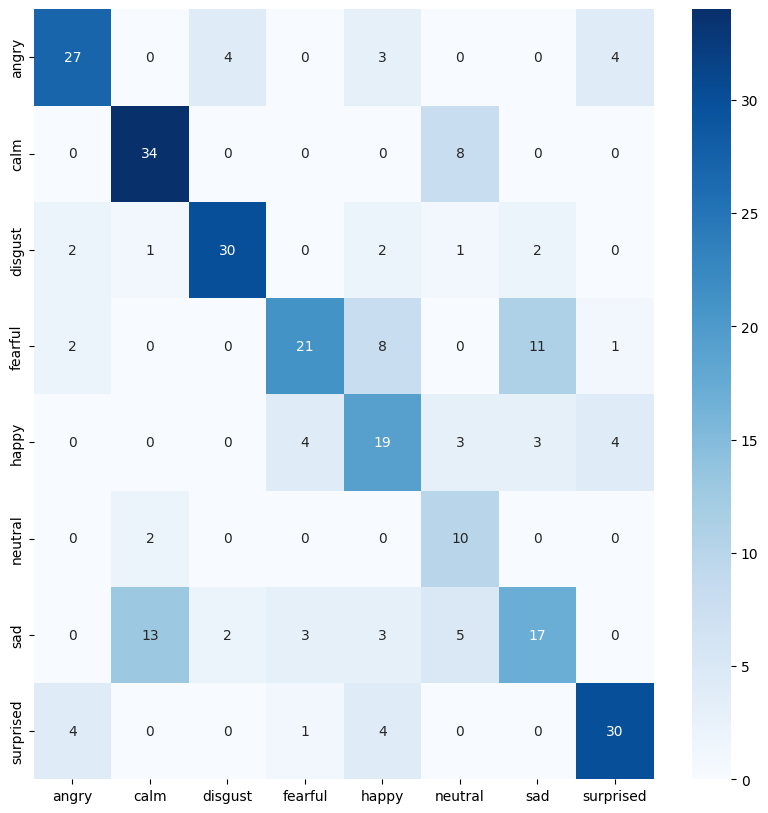

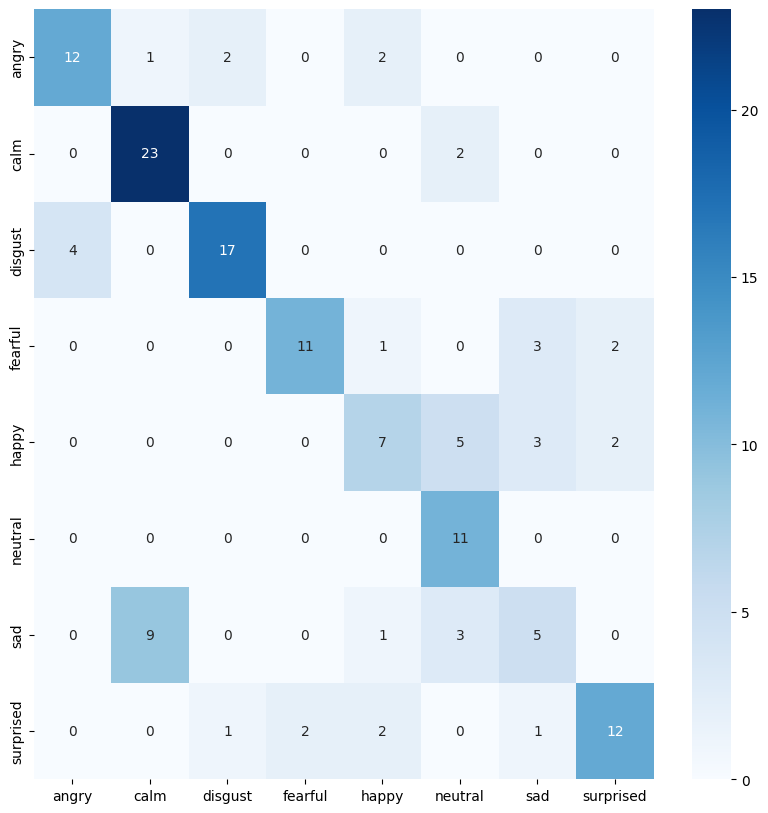

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_50"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-2f4b1391ef2c4484/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available


----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0700 
[Epoch][Batch] = [1][13] -> Loss = 2.0738 
[Epoch][Batch] = [1][26] -> Loss = 2.0708 
[Epoch][Batch] = [1][39] -> Loss = 2.0712 
[Epoch][Batch] = [1][52] -> Loss = 2.0690 
best_acc  0.2951388888888889
	Train -> Loss = 2.0656 /  accuracy = 0.2105
	Validation -> Loss = 2.0419 /  accuracy = 0.2951
[Epoch][Batch] = [2][0] -> Loss = 2.0456 
[Epoch][Batch] = [2][13] -> Loss = 2.0444 
[Epoch][Batch] = [2][26] -> Loss = 2.0376 
[Epoch][Batch] = [2][39] -> Loss = 2.0309 
[Epoch][Batch] = [2][52] -> Loss = 2.0220 
	Train -> Loss = 2.0110 /  accuracy = 0.3496
	Validation -> Loss = 1.9068 /  accuracy = 0.2812
[Epoch][Batch] = [3][0] -> Loss = 1.9492 
[Epoch][Batch] = [3][13] -> Loss = 1.8969 
[Epoch][Batch] = [3][26] -> Loss = 1.8934 
[Epoch][Batch] = [3][39] -> Loss = 1.8672 
[Epoch][Batch] = [3][52] -> Loss = 1.8575 
best_acc  

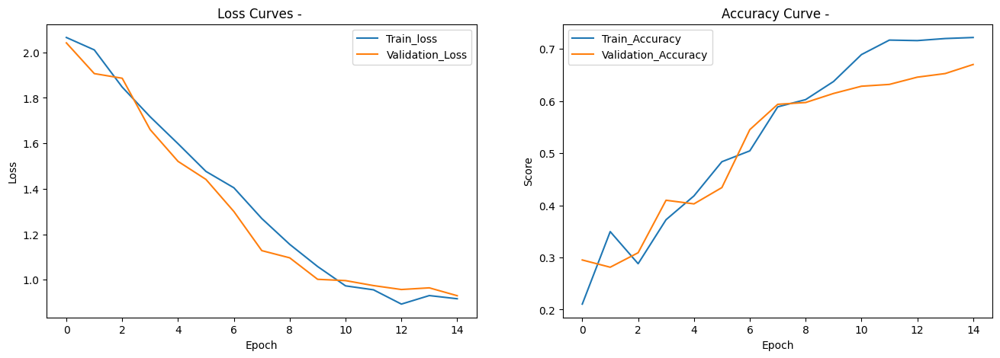

------------------------------ 
Best result on validation set -> Loss = 0.9412849578592513 Accuracy = 64.93 %
Validation Report
[('angry', 0.717948717948718), ('calm', 0.8809523809523809), ('disgust', 0.868421052631579), ('fearful', 0.4523809523809524), ('happy', 0.36363636363636365), ('neutral', 0.6666666666666666), ('sad', 0.4883720930232558), ('surprised', 0.7435897435897436)]
              precision    recall  f1-score   support

       angry       0.82      0.72      0.77        39
        calm       0.65      0.88      0.75        42
     disgust       0.82      0.87      0.85        38
     fearful       0.66      0.45      0.54        42
       happy       0.39      0.36      0.38        33
     neutral       0.36      0.67      0.47        12
         sad       0.54      0.49      0.51        43
   surprised       0.81      0.74      0.77        39

    accuracy                           0.65       288
   macro avg       0.63      0.65      0.63       288
weighted avg       0.

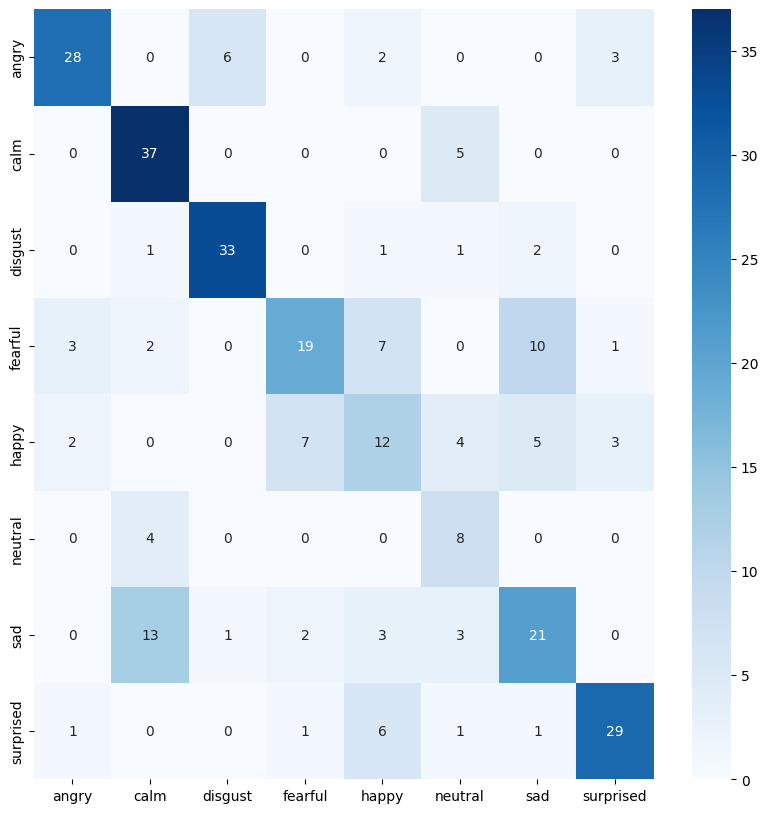

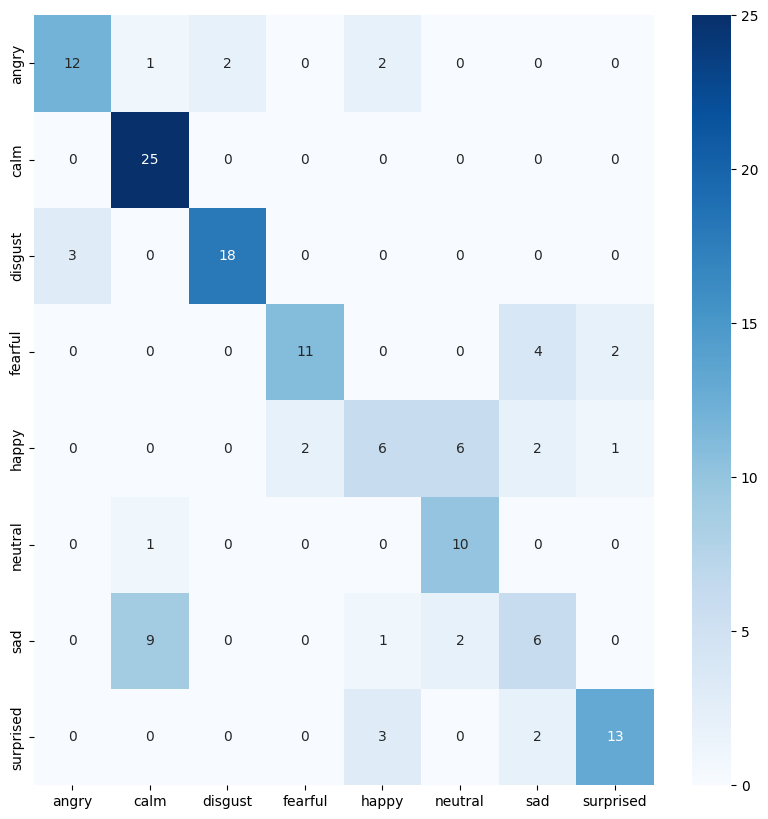

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_50"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-497ba590b6429469/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0812 
[Epoch][Batch] = [1][13] -> Loss = 2.0765 
[Epoch][Batch] = [1][26] -> Loss = 2.0752 
[Epoch][Batch] = [1][39] -> Loss = 2.0731 
[Epoch][Batch] = [1][52] -> Loss = 2.0691 
best_acc  0.2604166666666667
	Train -> Loss = 2.0664 /  accuracy = 0.1738
	Validation -> Loss = 2.0440 /  accuracy = 0.2604
[Epoch][Batch] = [2][0] -> Loss = 2.0274 
[Epoch][Batch] = [2][13] -> Loss = 2.0436 
[Epoch][Batch] = [2][26] -> Loss = 2.0

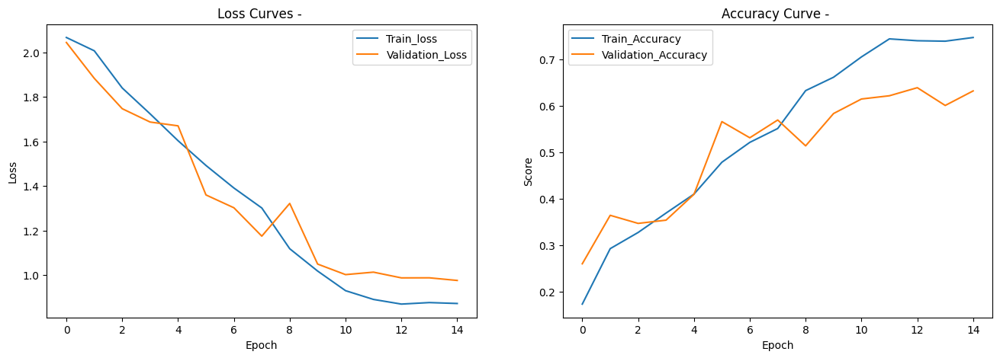

------------------------------ 
Best result on validation set -> Loss = 0.9893391595946418 Accuracy = 64.24 %
Validation Report
[('angry', 0.7631578947368421), ('calm', 0.9285714285714286), ('disgust', 0.8157894736842105), ('fearful', 0.5813953488372093), ('happy', 0.45454545454545453), ('neutral', 0.5833333333333334), ('sad', 0.3023255813953488), ('surprised', 0.6666666666666666)]
              precision    recall  f1-score   support

       angry       0.91      0.76      0.83        38
        calm       0.62      0.93      0.74        42
     disgust       0.82      0.82      0.82        38
     fearful       0.66      0.58      0.62        43
       happy       0.38      0.45      0.42        33
     neutral       0.29      0.58      0.39        12
         sad       0.50      0.30      0.38        43
   surprised       0.93      0.67      0.78        39

    accuracy                           0.64       288
   macro avg       0.64      0.64      0.62       288
weighted avg       

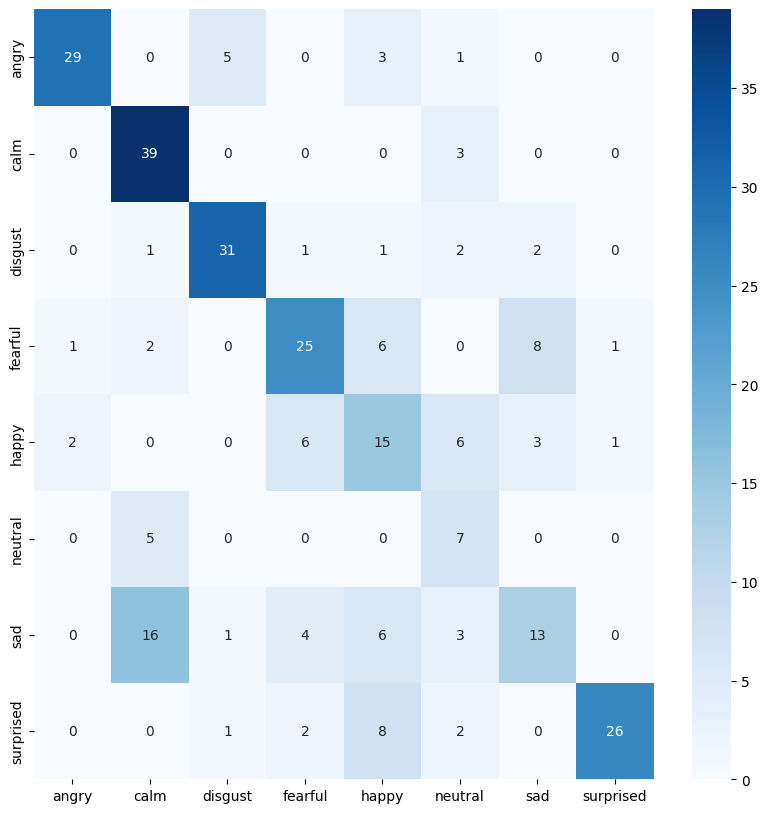

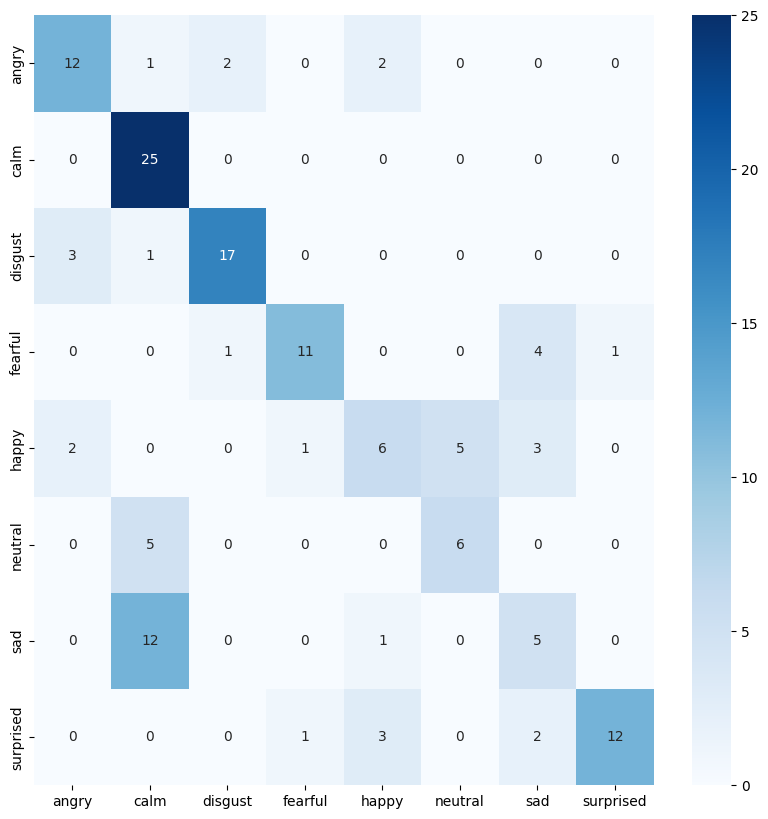

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_50"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-2f66356d00a12658/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0811 
[Epoch][Batch] = [1][13] -> Loss = 2.0814 
[Epoch][Batch] = [1][26] -> Loss = 2.0821 
[Epoch][Batch] = [1][39] -> Loss = 2.0781 
[Epoch][Batch] = [1][52] -> Loss = 2.0771 
best_acc  0.22916666666666666
	Train -> Loss = 2.0759 /  accuracy = 0.1420
	Validation -> Loss = 2.0560 /  accuracy = 0.2292
[Epoch][Batch] = [2][0] -> Loss = 2.0604 
[Epoch][Batch] = [2][13] -> Loss = 2.0575 
[Epoch][Batch] = [2][26] -> Loss = 2.

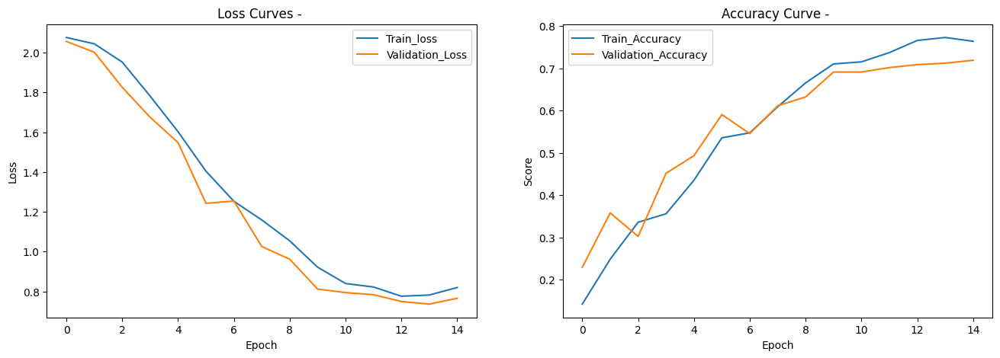

------------------------------ 
Best result on validation set -> Loss = 0.7708335138029523 Accuracy = 70.14 %
Validation Report
[('angry', 0.8461538461538461), ('calm', 0.8292682926829268), ('disgust', 0.9473684210526315), ('fearful', 0.6046511627906976), ('happy', 0.2727272727272727), ('neutral', 0.75), ('sad', 0.46511627906976744), ('surprised', 0.8974358974358975)]
              precision    recall  f1-score   support

       angry       0.79      0.85      0.81        39
        calm       0.69      0.83      0.76        41
     disgust       0.92      0.95      0.94        38
     fearful       0.67      0.60      0.63        43
       happy       0.43      0.27      0.33        33
     neutral       0.38      0.75      0.50        12
         sad       0.65      0.47      0.54        43
   surprised       0.81      0.90      0.85        39

    accuracy                           0.70       288
   macro avg       0.67      0.70      0.67       288
weighted avg       0.70      0.70

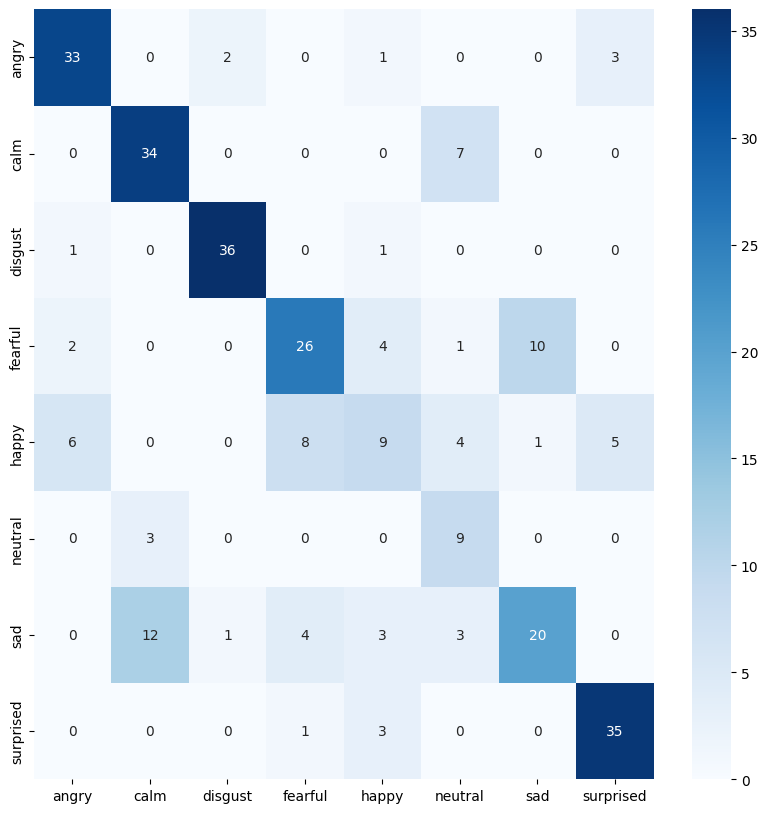

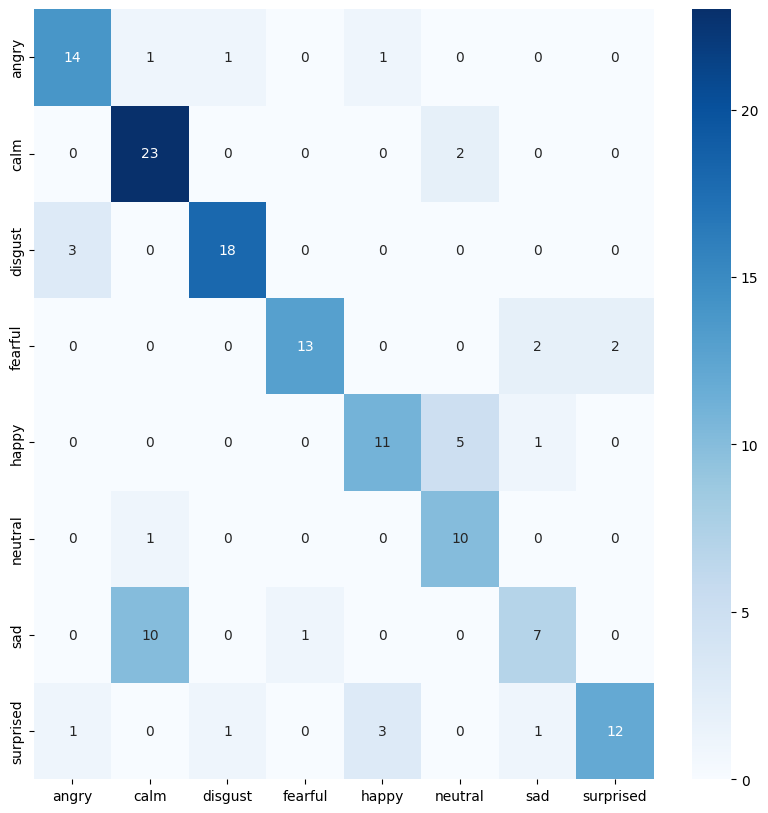

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_55"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-266314e81bb3da52/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0700 
[Epoch][Batch] = [1][13] -> Loss = 2.0783 
[Epoch][Batch] = [1][26] -> Loss = 2.0779 
[Epoch][Batch] = [1][39] -> Loss = 2.0741 
[Epoch][Batch] = [1][52] -> Loss = 2.0719 
best_acc  0.2048611111111111
	Train -> Loss = 2.0705 /  accuracy = 0.1907
	Validation -> Loss = 2.0510 /  accuracy = 0.2049
[Epoch][Batch] = [2][0] -> Loss = 2.0541 
[Epoch][Batch] = [2][13] -> Loss = 2.0500 
[Epoch][Batch] = [2][26] -> Loss = 2.0

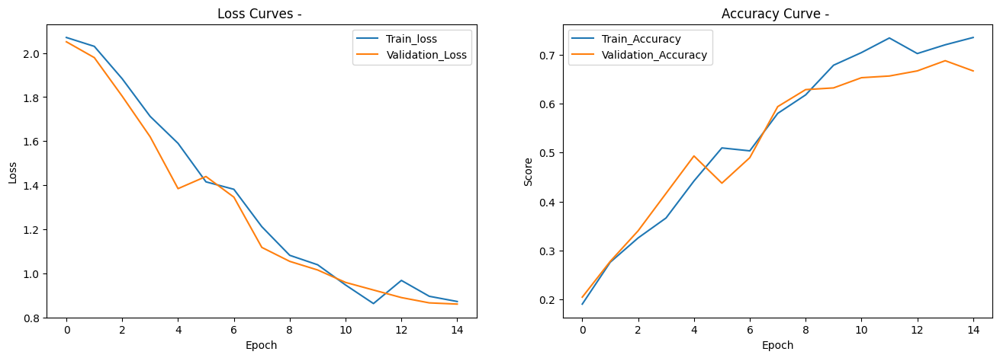

------------------------------ 
Best result on validation set -> Loss = 0.866351412402259 Accuracy = 67.36 %
Validation Report
[('angry', 0.8205128205128205), ('calm', 0.8809523809523809), ('disgust', 0.8947368421052632), ('fearful', 0.5813953488372093), ('happy', 0.375), ('neutral', 0.5833333333333334), ('sad', 0.46511627906976744), ('surprised', 0.6923076923076923)]
              precision    recall  f1-score   support

       angry       0.76      0.82      0.79        39
        calm       0.71      0.88      0.79        42
     disgust       0.87      0.89      0.88        38
     fearful       0.71      0.58      0.64        43
       happy       0.35      0.38      0.36        32
     neutral       0.29      0.58      0.39        12
         sad       0.69      0.47      0.56        43
   surprised       0.82      0.69      0.75        39

    accuracy                           0.67       288
   macro avg       0.65      0.66      0.64       288
weighted avg       0.69      0.67

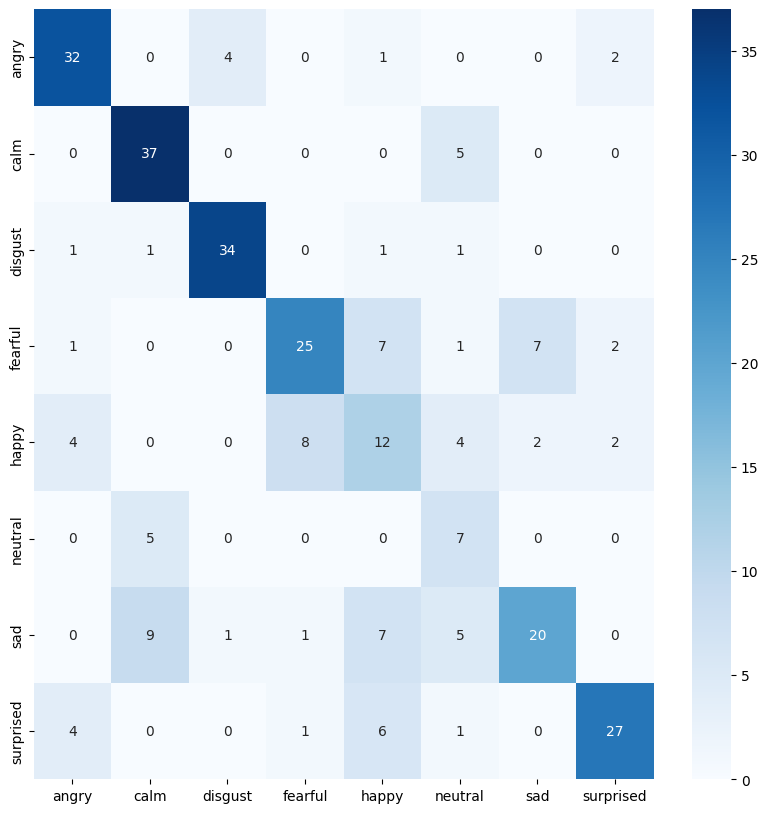

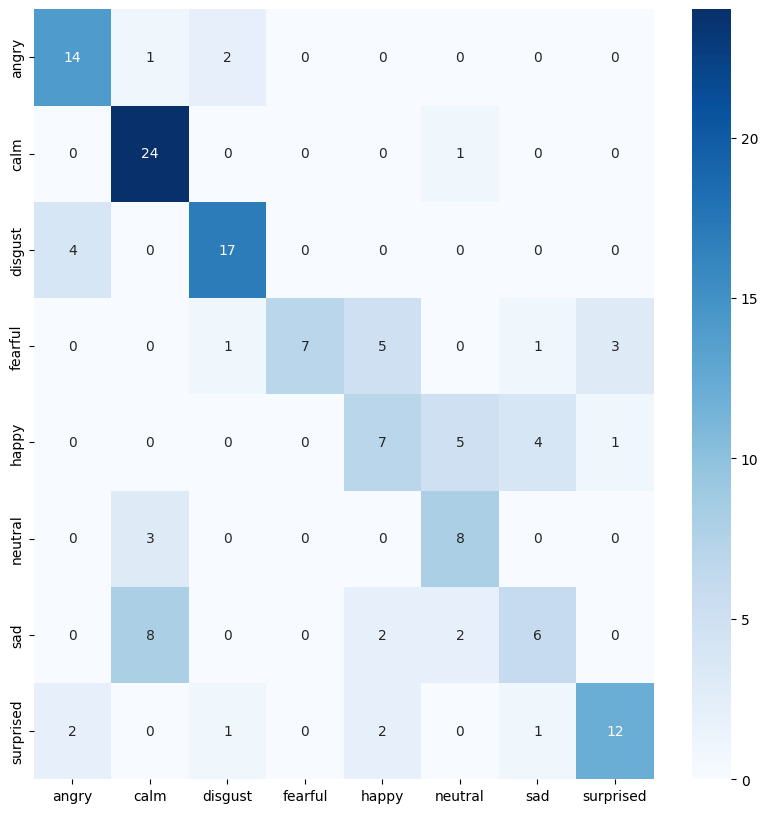

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_55"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-02fd33bb900f3f0d/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0832 
[Epoch][Batch] = [1][13] -> Loss = 2.0709 
[Epoch][Batch] = [1][26] -> Loss = 2.0722 
[Epoch][Batch] = [1][39] -> Loss = 2.0726 
[Epoch][Batch] = [1][52] -> Loss = 2.0705 
best_acc  0.23958333333333334
	Train -> Loss = 2.0704 /  accuracy = 0.1410
	Validation -> Loss = 2.0515 /  accuracy = 0.2396
[Epoch][Batch] = [2][0] -> Loss = 2.0381 
[Epoch][Batch] = [2][13] -> Loss = 2.0453 
[Epoch][Batch] = [2][26] -> Loss = 2.

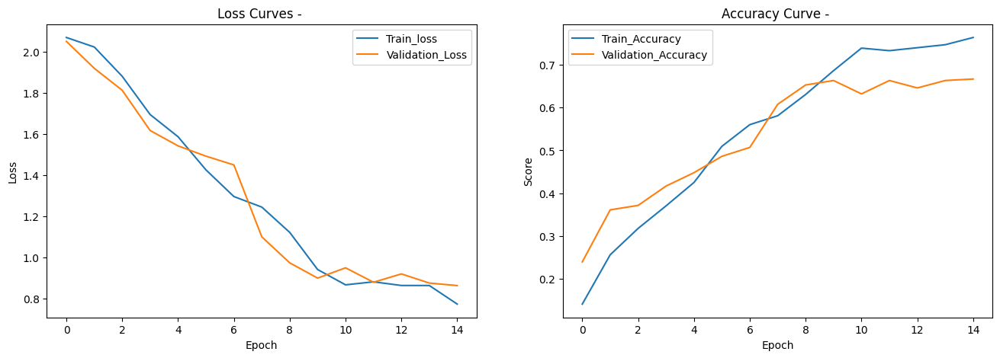

------------------------------ 
Best result on validation set -> Loss = 0.8594179054101309 Accuracy = 68.06 %
Validation Report
[('angry', 0.8974358974358975), ('calm', 0.8809523809523809), ('disgust', 0.9210526315789473), ('fearful', 0.5581395348837209), ('happy', 0.3939393939393939), ('neutral', 0.75), ('sad', 0.37209302325581395), ('surprised', 0.7105263157894737)]
              precision    recall  f1-score   support

       angry       0.81      0.90      0.85        39
        calm       0.70      0.88      0.78        42
     disgust       0.90      0.92      0.91        38
     fearful       0.63      0.56      0.59        43
       happy       0.41      0.39      0.40        33
     neutral       0.35      0.75      0.47        12
         sad       0.64      0.37      0.47        43
   surprised       0.84      0.71      0.77        38

    accuracy                           0.68       288
   macro avg       0.66      0.69      0.66       288
weighted avg       0.69      0.68

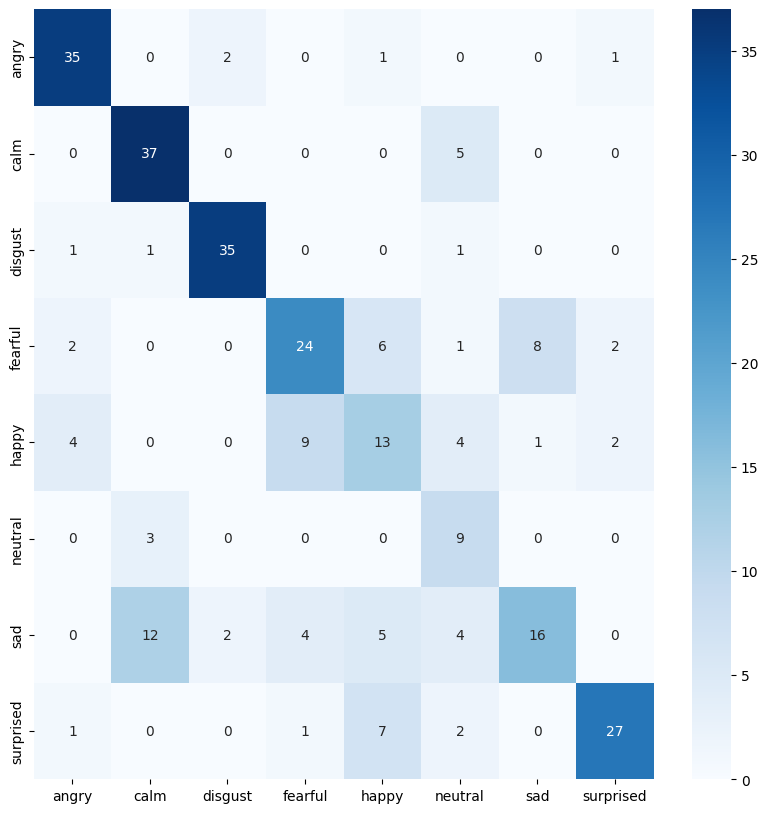

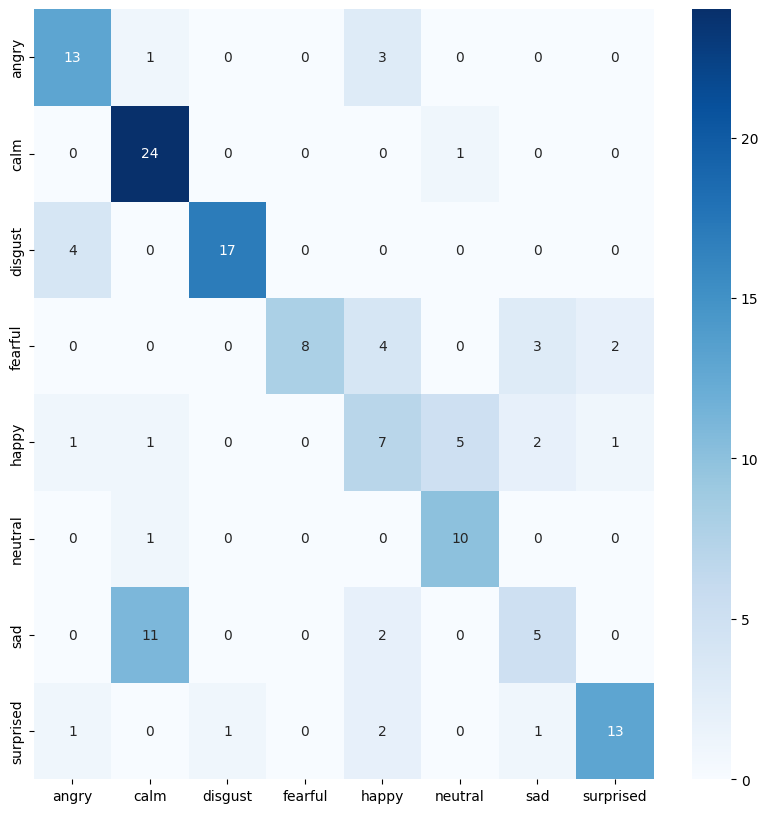

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_55"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_acc=[]
test_acc=[]
val_labels=[]
val_preds=[]
test_labels=[]
test_preds=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-cf651f4c3bfe3e1a/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available


----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0852 
[Epoch][Batch] = [1][13] -> Loss = 2.0822 
[Epoch][Batch] = [1][26] -> Loss = 2.0766 
[Epoch][Batch] = [1][39] -> Loss = 2.0734 
[Epoch][Batch] = [1][52] -> Loss = 2.0718 
best_acc  0.3263888888888889
	Train -> Loss = 2.0702 /  accuracy = 0.1738
	Validation -> Loss = 2.0411 /  accuracy = 0.3264
[Epoch][Batch] = [2][0] -> Loss = 2.0275 
[Epoch][Batch] = [2][13] -> Loss = 2.0438 
[Epoch][Batch] = [2][26] -> Loss = 2.0390 
[Epoch][Batch] = [2][39] -> Loss = 2.0394 
[Epoch][Batch] = [2][52] -> Loss = 2.0308 
best_acc  0.3715277777777778
	Train -> Loss = 2.0268 /  accuracy = 0.3327
	Validation -> Loss = 1.9263 /  accuracy = 0.3715
[Epoch][Batch] = [3][0] -> Loss = 2.0311 
[Epoch][Batch] = [3][13] -> Loss = 1.9500 
[Epoch][Batch] = [3][26] -> Loss = 1.9201 
[Epoch][Batch] = [3][39] -> Loss = 1.8998 
[Epoch][Batch] = [3][52]

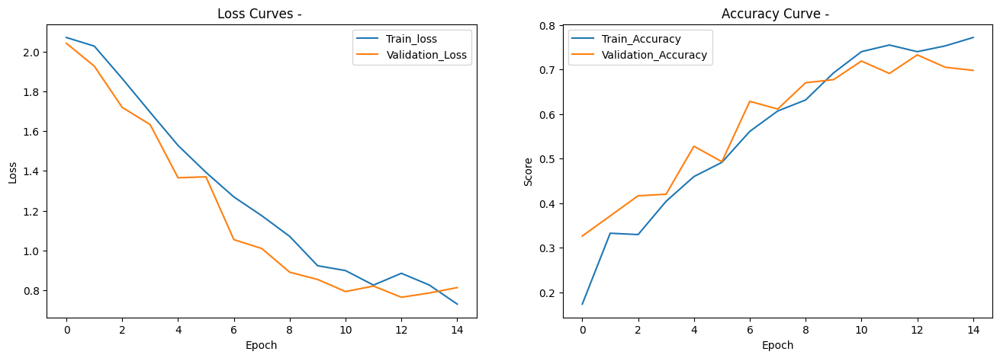

------------------------------ 
Best result on validation set -> Loss = 0.7856877926323149 Accuracy = 71.53 %
Validation Report
[('angry', 0.7435897435897436), ('calm', 0.8333333333333334), ('disgust', 1.0), ('fearful', 0.7674418604651163), ('happy', 0.36363636363636365), ('neutral', 0.75), ('sad', 0.37209302325581395), ('surprised', 0.8974358974358975)]
              precision    recall  f1-score   support

       angry       0.88      0.74      0.81        39
        calm       0.73      0.83      0.78        42
     disgust       0.80      1.00      0.89        37
     fearful       0.73      0.77      0.75        43
       happy       0.63      0.36      0.46        33
     neutral       0.35      0.75      0.47        12
         sad       0.62      0.37      0.46        43
   surprised       0.78      0.90      0.83        39

    accuracy                           0.72       288
   macro avg       0.69      0.72      0.68       288
weighted avg       0.72      0.72      0.70    

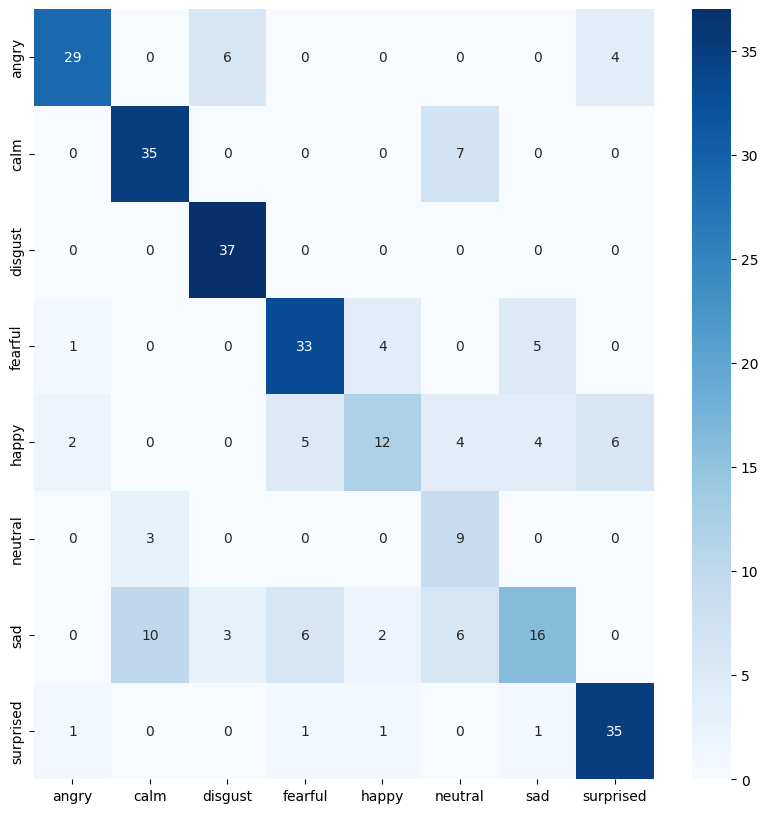

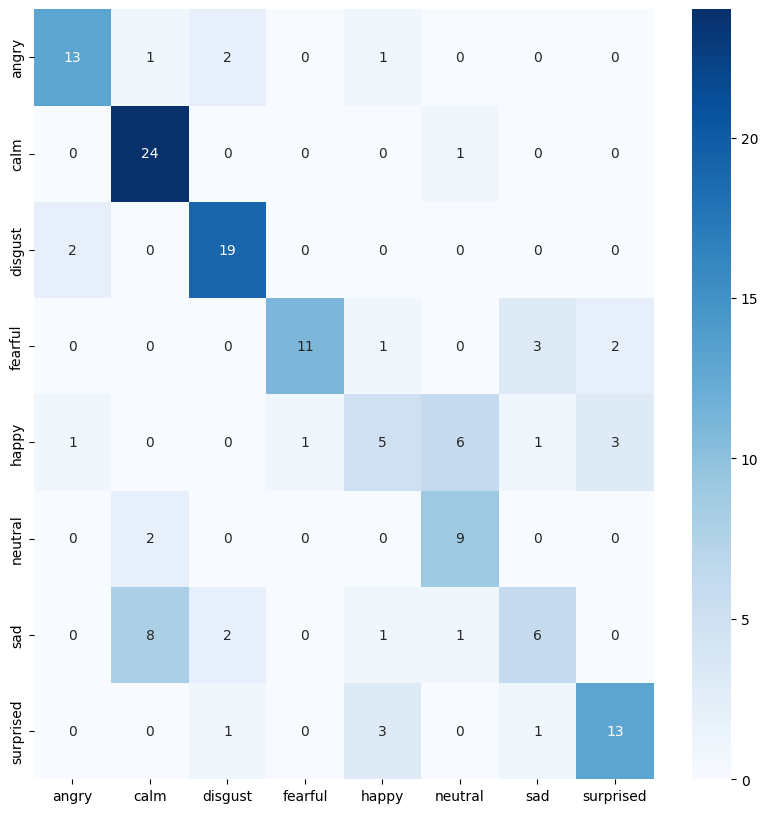

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_60"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-6d577416d766bca5/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0601 
[Epoch][Batch] = [1][13] -> Loss = 2.0726 
[Epoch][Batch] = [1][26] -> Loss = 2.0747 
[Epoch][Batch] = [1][39] -> Loss = 2.0740 
[Epoch][Batch] = [1][52] -> Loss = 2.0715 
best_acc  0.28125
	Train -> Loss = 2.0696 /  accuracy = 0.1708
	Validation -> Loss = 2.0392 /  accuracy = 0.2812
[Epoch][Batch] = [2][0] -> Loss = 2.0298 
[Epoch][Batch] = [2][13] -> Loss = 2.0469 
[Epoch][Batch] = [2][26] -> Loss = 2.0430 
[Epoch

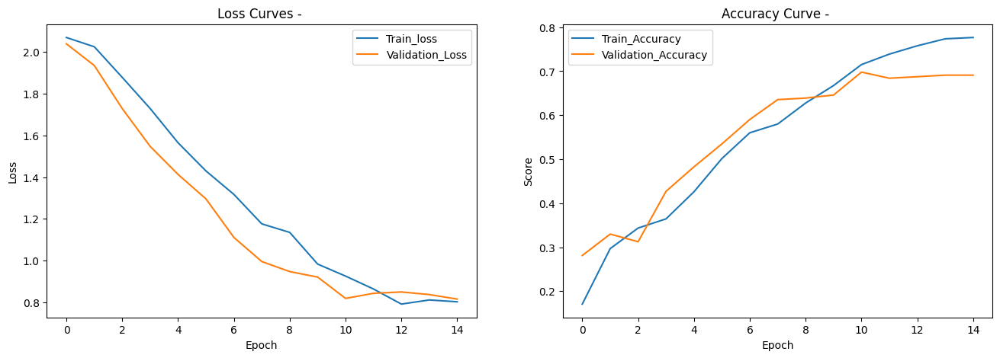

------------------------------ 
Best result on validation set -> Loss = 0.8206137584315406 Accuracy = 69.44 %
Validation Report
[('angry', 0.717948717948718), ('calm', 0.8048780487804879), ('disgust', 0.9473684210526315), ('fearful', 0.7441860465116279), ('happy', 0.36363636363636365), ('neutral', 0.6666666666666666), ('sad', 0.4186046511627907), ('surprised', 0.8461538461538461)]
              precision    recall  f1-score   support

       angry       0.90      0.72      0.80        39
        calm       0.72      0.80      0.76        41
     disgust       0.84      0.95      0.89        38
     fearful       0.68      0.74      0.71        43
       happy       0.50      0.36      0.42        33
     neutral       0.33      0.67      0.44        12
         sad       0.67      0.42      0.51        43
   surprised       0.72      0.85      0.78        39

    accuracy                           0.69       288
   macro avg       0.67      0.69      0.66       288
weighted avg       0

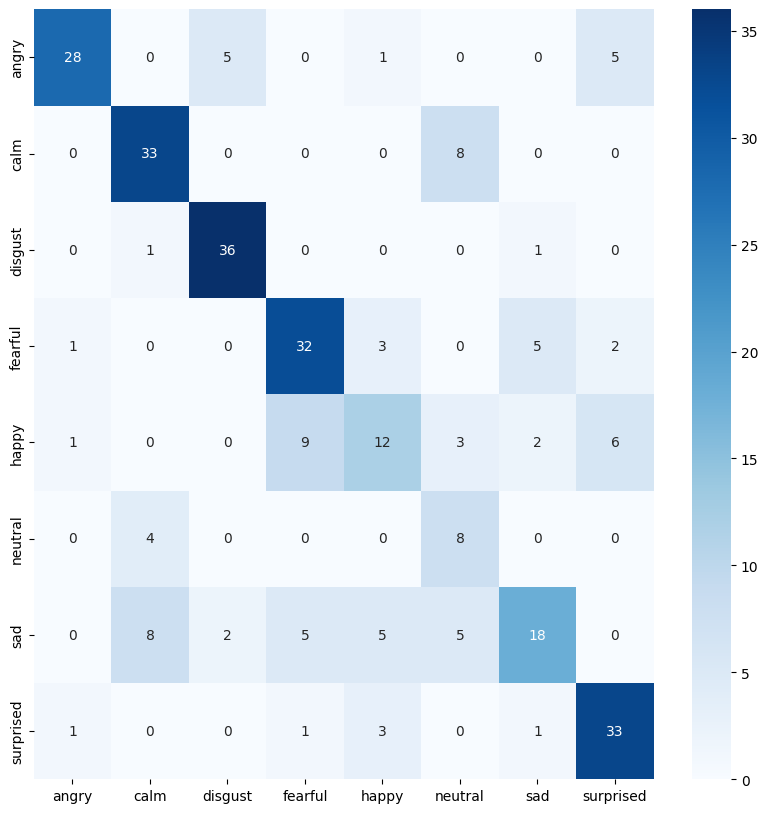

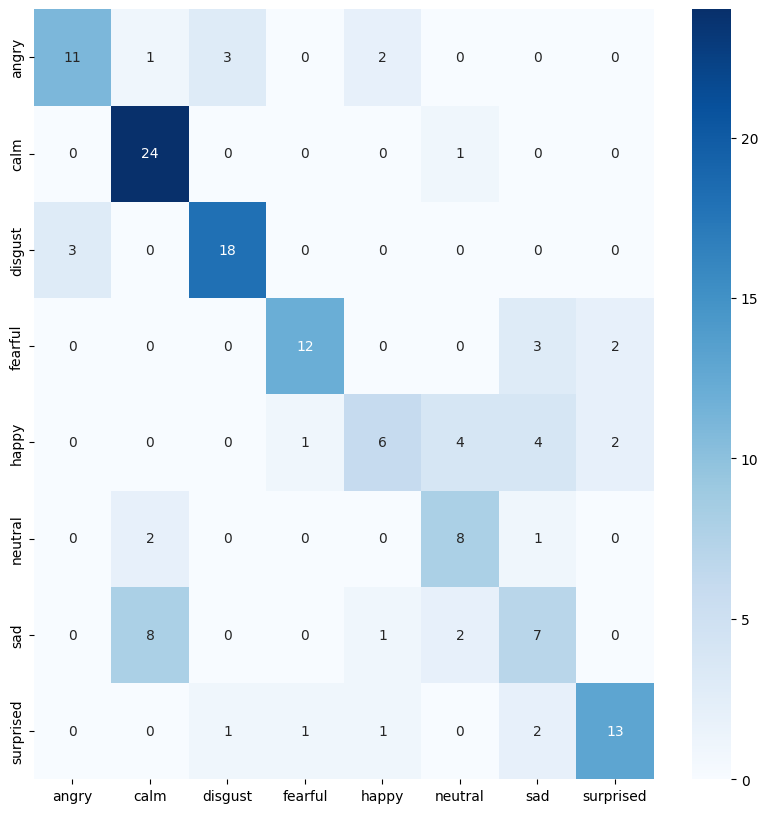

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_60"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-f8a26a49715e2184/0.0.0/6954658bab30a358235fa864b05cf819af0e179325c740e4bc853bcc7ec513e1. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0568 
[Epoch][Batch] = [1][13] -> Loss = 2.0682 
[Epoch][Batch] = [1][26] -> Loss = 2.0708 
[Epoch][Batch] = [1][39] -> Loss = 2.0687 
[Epoch][Batch] = [1][52] -> Loss = 2.0669 
best_acc  0.18055555555555555
	Train -> Loss = 2.0659 /  accuracy = 0.1599
	Validation -> Loss = 2.0474 /  accuracy = 0.1806
[Epoch][Batch] = [2][0] -> Loss = 2.0242 
[Epoch][Batch] = [2][13] -> Loss = 2.0364 
[Epoch][Batch] = [2][26] -> Loss = 2.

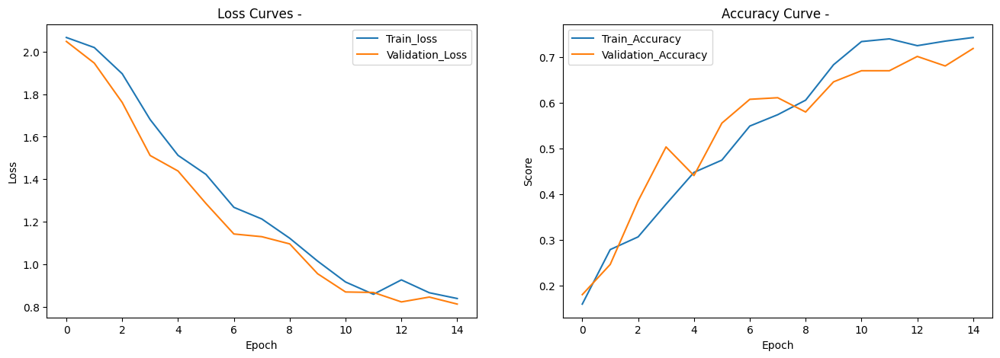

------------------------------ 
Best result on validation set -> Loss = 0.8259208665953742 Accuracy = 69.10 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.9047619047619048), ('disgust', 0.9473684210526315), ('fearful', 0.6976744186046512), ('happy', 0.30303030303030304), ('neutral', 0.5454545454545454), ('sad', 0.3953488372093023), ('surprised', 0.717948717948718)]
              precision    recall  f1-score   support

       angry       0.83      0.87      0.85        39
        calm       0.66      0.90      0.76        42
     disgust       0.86      0.95      0.90        38
     fearful       0.77      0.70      0.73        43
       happy       0.43      0.30      0.36        33
     neutral       0.38      0.55      0.44        11
         sad       0.53      0.40      0.45        43
   surprised       0.76      0.72      0.74        39

    accuracy                           0.69       288
   macro avg       0.65      0.67      0.65       288
weighted avg       0

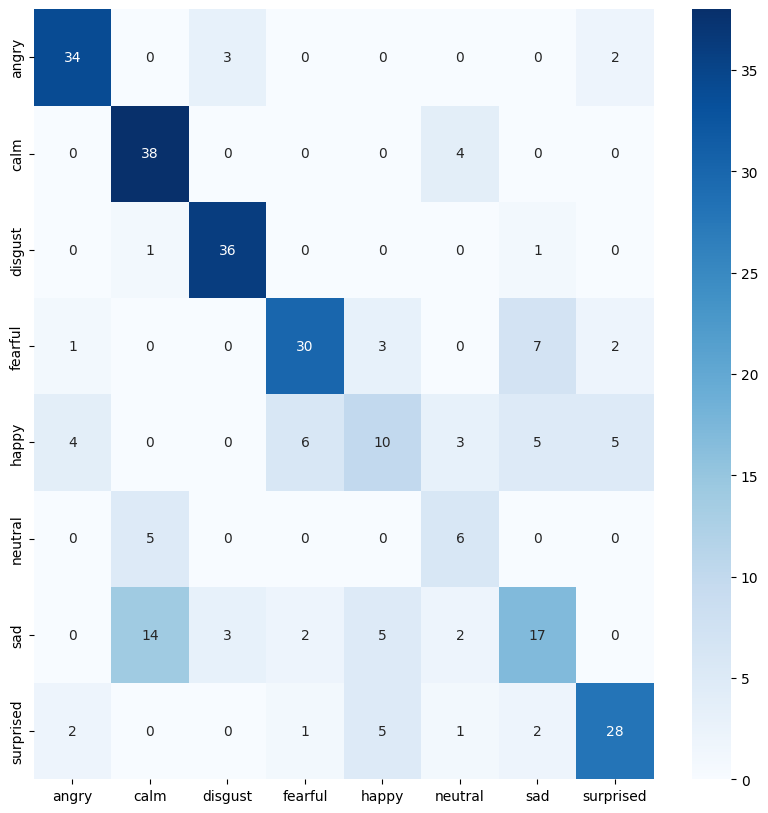

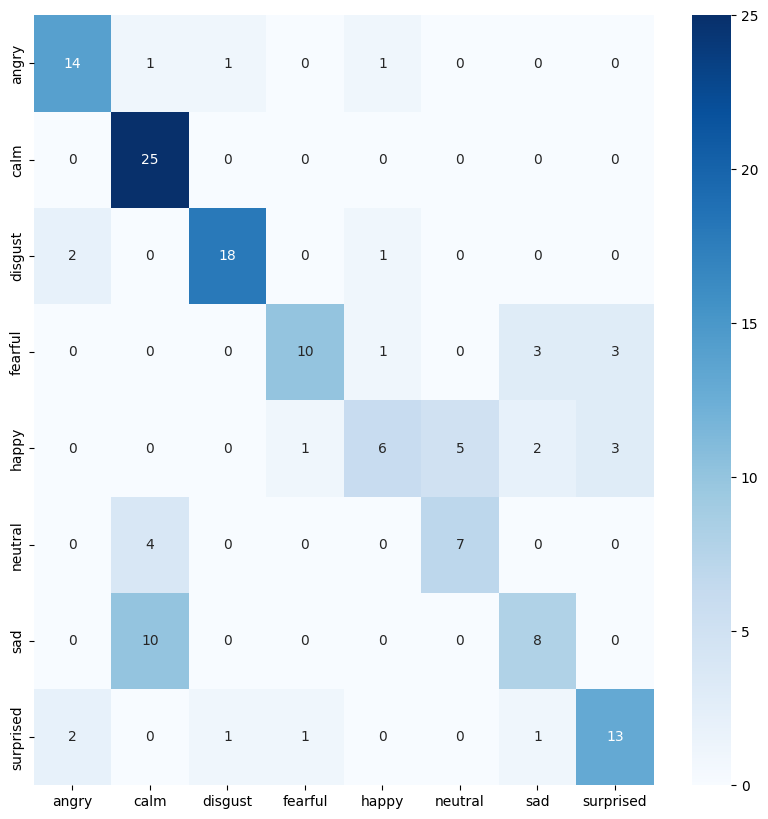

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence_60"
df,df_val,df_test, label_encoder = load_data2(data_path,f2,f2_val,f2_test)

v1,v2,v3,v4,v5,v6=trainModel2(df,
                  df_val,
                  df_test,
                  label_encoder,
                 f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)
val_labels=np.concatenate((val_labels,v3))
val_preds=np.concatenate((val_preds,v4))
test_labels=np.concatenate((test_labels,v5))
test_preds=np.concatenate((test_preds,v6))

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
val_preds = np.asarray(val_preds, dtype = 'int')
val_labels = np.asarray(val_labels, dtype = 'int')

test_preds = np.asarray(test_preds, dtype = 'int')
test_labels = np.asarray(test_labels, dtype = 'int')

[('angry', 0.8272058823529411), ('calm', 0.8424657534246576), ('disgust', 0.8754716981132076), ('fearful', 0.4782608695652174), ('happy', 0.42424242424242425), ('neutral', 0.7380952380952381), ('sad', 0.37666666666666665), ('surprised', 0.8095238095238095)]
              precision    recall  f1-score   support

       angry       0.77      0.83      0.80       272
        calm       0.67      0.84      0.75       292
     disgust       0.87      0.88      0.87       265
     fearful       0.72      0.48      0.58       299
       happy       0.48      0.42      0.45       231
     neutral       0.31      0.74      0.44        84
         sad       0.55      0.38      0.45       300
   surprised       0.78      0.81      0.79       273

    accuracy                           0.66      2016
   macro avg       0.64      0.67      0.64      2016
weighted avg       0.68      0.66      0.66      2016



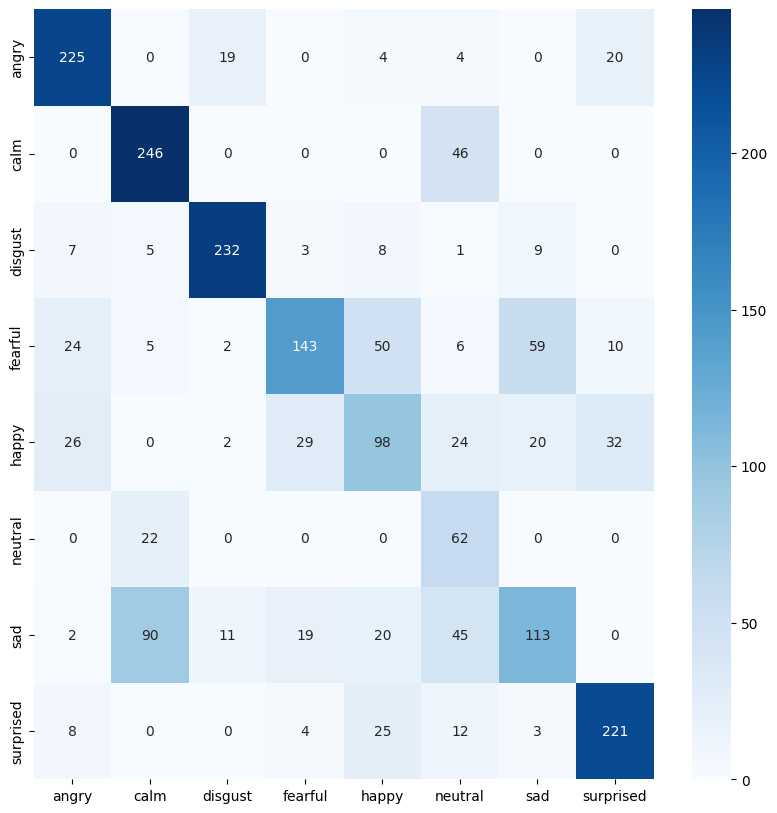

In [ ]:
report(val_labels, val_preds, label_encoder)

[('angry', 0.7815126050420168), ('calm', 0.9257142857142857), ('disgust', 0.8163265306122449), ('fearful', 0.5546218487394958), ('happy', 0.42857142857142855), ('neutral', 0.8441558441558441), ('sad', 0.2857142857142857), ('surprised', 0.6984126984126984)]
              precision    recall  f1-score   support

       angry       0.75      0.78      0.77       119
        calm       0.68      0.93      0.78       175
     disgust       0.84      0.82      0.83       147
     fearful       0.89      0.55      0.68       119
       happy       0.55      0.43      0.48       119
     neutral       0.46      0.84      0.60        77
         sad       0.46      0.29      0.35       126
   surprised       0.75      0.70      0.72       126

    accuracy                           0.68      1008
   macro avg       0.67      0.67      0.65      1008
weighted avg       0.69      0.68      0.66      1008



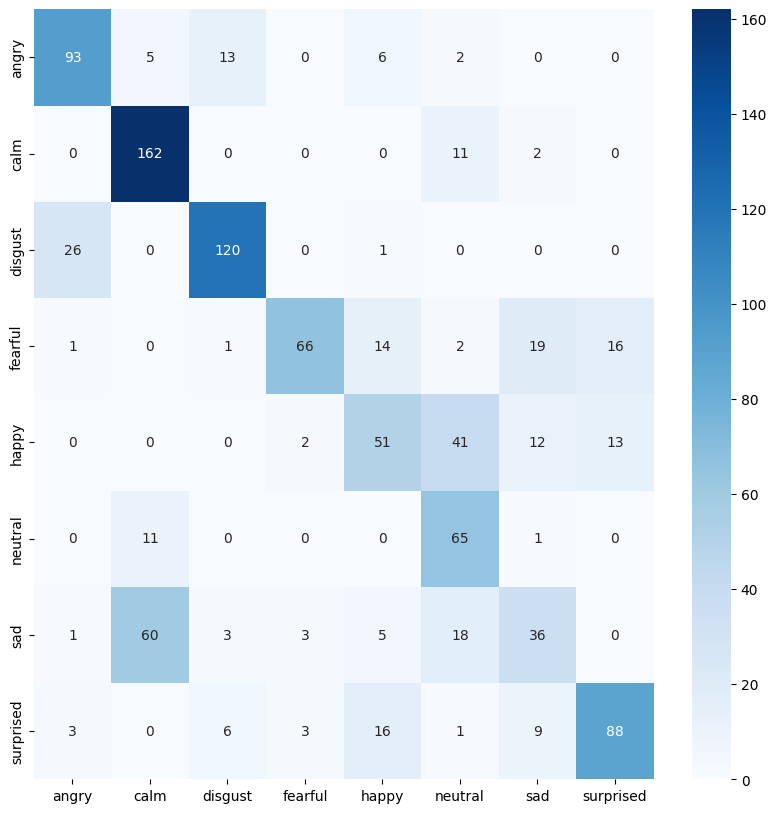

In [ ]:
report(test_labels, test_preds, label_encoder)

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-35a63c04c6cdfb0c/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0899 
[Epoch][Batch] = [1][13] -> Loss = 2.0837 
[Epoch][Batch] = [1][26] -> Loss = 2.0792 
[Epoch][Batch] = [1][39] -> Loss = 2.0758 
[Epoch][Batch] = [1][52] -> Loss = 2.0729 
best_acc  0.23958333333333334
	Train -> Loss = 2.0710 /  accuracy = 0.1837
	Validation -> Loss = 2.0513 /  accuracy = 0.2396
[Epoch][Batch] = [2][0] -> Loss = 2.0503 
[Epoch][Batch] = [2][13] -> Loss = 2.0550 
[Epoch][Batch] = [2][26] -> Loss = 2.

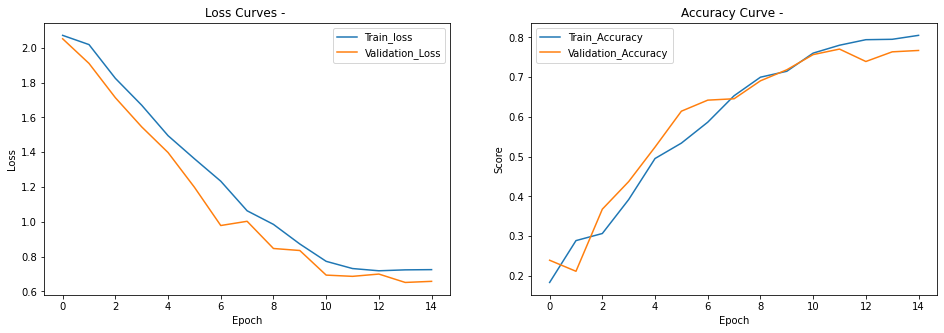

------------------------------ 
Best result on validation set -> Loss = 0.6858613441387812 Accuracy = 76.74 %
Validation Report
[('angry', 0.9230769230769231), ('calm', 0.8333333333333334), ('disgust', 0.918918918918919), ('fearful', 0.8837209302325582), ('happy', 0.5151515151515151), ('neutral', 0.9166666666666666), ('sad', 0.4186046511627907), ('surprised', 0.8205128205128205)]
              precision    recall  f1-score   support

       angry       0.86      0.92      0.89        39
        calm       0.76      0.83      0.80        42
     disgust       0.89      0.92      0.91        37
     fearful       0.72      0.88      0.79        43
       happy       0.65      0.52      0.58        33
     neutral       0.48      0.92      0.63        12
         sad       0.72      0.42      0.53        43
   surprised       0.91      0.82      0.86        39

    accuracy                           0.77       288
   macro avg       0.75      0.78      0.75       288
weighted avg       0.

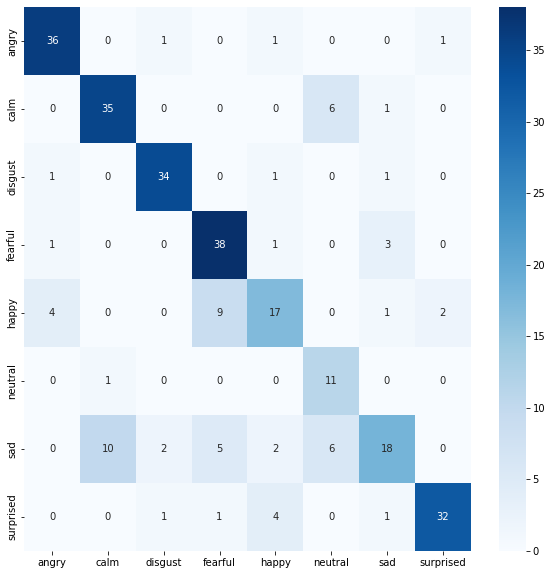

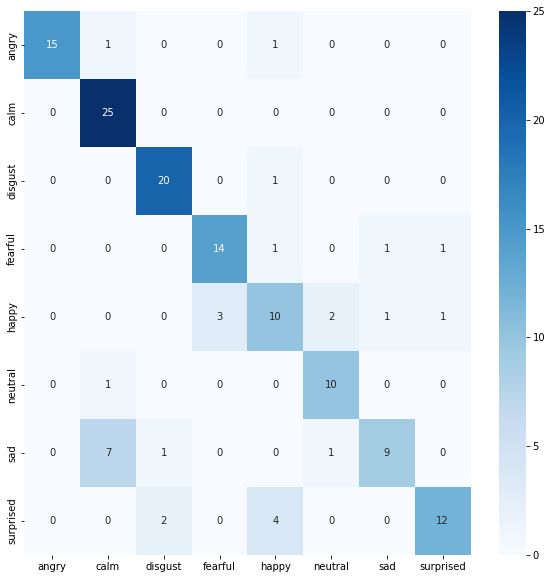

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess"


v1,v2=trainModel2(f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
print(val_acc)
print(sum(val_acc)/len(val_acc))
print(test_acc,sum(test_acc)/len(test_acc))
print(sum(test_acc)/len(test_acc))

[0.7986111111111112, 0.7673611111111112]
0.7829861111111112
[0.7847222222222222, 0.7986111111111112] 0.7916666666666667
0.7916666666666667


In [ ]:
val_acc=[]
test_acc=[]

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-abaf9cc6a5141c80/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0755 
[Epoch][Batch] = [1][13] -> Loss = 2.0795 
[Epoch][Batch] = [1][26] -> Loss = 2.0745 
[Epoch][Batch] = [1][39] -> Loss = 2.0707 
[Epoch][Batch] = [1][52] -> Loss = 2.0689 
best_acc  0.2847222222222222
	Train -> Loss = 2.0675 /  accuracy = 0.1718
	Validation -> Loss = 2.0441 /  accuracy = 0.2847
[Epoch][Batch] = [2][0] -> Loss = 2.0509 
[Epoch][Batch] = [2][13] -> Loss = 2.0545 
[Epoch][Batch] = [2][26] -> Loss = 2.0

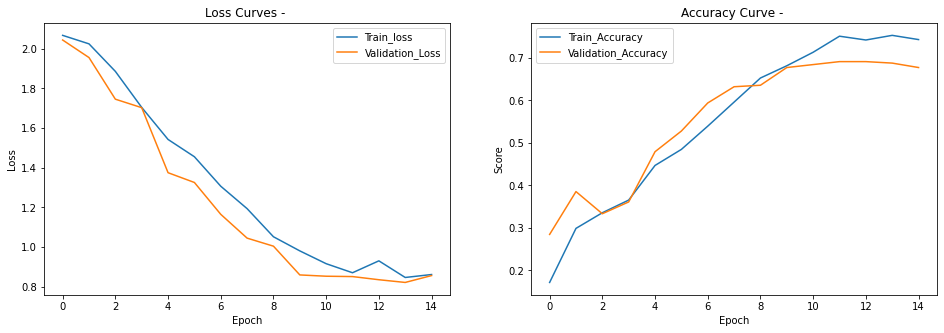

------------------------------ 
Best result on validation set -> Loss = 0.8533874584568871 Accuracy = 69.10 %
Validation Report
[('angry', 0.8717948717948718), ('calm', 0.9285714285714286), ('disgust', 1.0), ('fearful', 0.3953488372093023), ('happy', 0.5151515151515151), ('neutral', 0.5833333333333334), ('sad', 0.3953488372093023), ('surprised', 0.7894736842105263)]
              precision    recall  f1-score   support

       angry       0.85      0.87      0.86        39
        calm       0.65      0.93      0.76        42
     disgust       0.83      1.00      0.90        38
     fearful       0.71      0.40      0.51        43
       happy       0.45      0.52      0.48        33
     neutral       0.47      0.58      0.52        12
         sad       0.57      0.40      0.47        43
   surprised       0.86      0.79      0.82        38

    accuracy                           0.69       288
   macro avg       0.67      0.68      0.67       288
weighted avg       0.69      0.69  

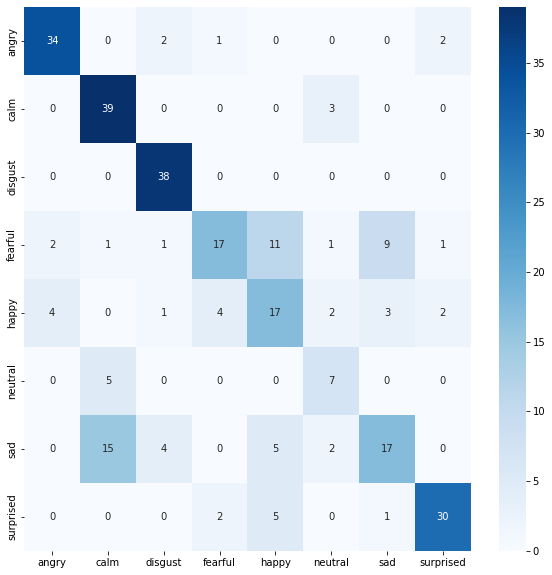

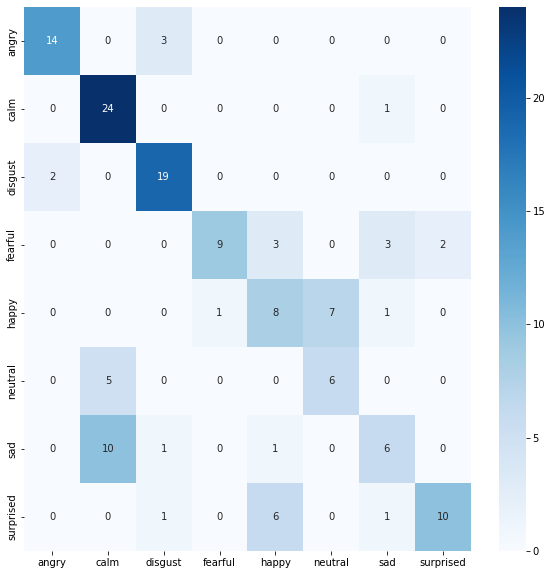

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence"


v1,v2=trainModel2(f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

----------------------------------------------------------------------
Data loaded successfully
----------------------------------------------------------------------


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-6612225a2ea04428/0.0.0/6b34fb8fcf56f7c8ba51dc895bfa2bfbe43546f190a60fcf74bb5e8afdcc2317. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

----------------------------------------------------------------------
Number of Train samples = 1007
Number of Validation samples = 289
Number of Test samples = 144
----------------------------------------
Number of Train batches = 63 | batch size = 16
Number of Validation batches = 19 | batch size = 16
Number of Test batches = 9 | batch size = 16
----------------------------------------
cuda is available
----------------------------------------
Model loaded successfully
----------------------------------------
Start Training ....

[Epoch][Batch] = [1][0] -> Loss = 2.0902 
[Epoch][Batch] = [1][13] -> Loss = 2.0838 
[Epoch][Batch] = [1][26] -> Loss = 2.0810 
[Epoch][Batch] = [1][39] -> Loss = 2.0788 
[Epoch][Batch] = [1][52] -> Loss = 2.0769 
best_acc  0.2847222222222222
	Train -> Loss = 2.0743 /  accuracy = 0.1539
	Validation -> Loss = 2.0540 /  accuracy = 0.2847
[Epoch][Batch] = [2][0] -> Loss = 2.0816 
[Epoch][Batch] = [2][13] -> Loss = 2.0557 
[Epoch][Batch] = [2][26] -> Loss = 2.0

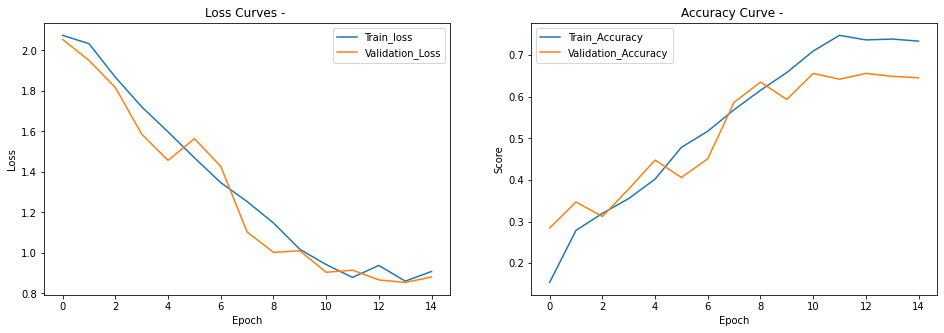

------------------------------ 
Best result on validation set -> Loss = 0.8993247681193881 Accuracy = 65.28 %
Validation Report
[('angry', 0.868421052631579), ('calm', 0.8571428571428571), ('disgust', 0.8947368421052632), ('fearful', 0.3953488372093023), ('happy', 0.6060606060606061), ('neutral', 0.6666666666666666), ('sad', 0.3023255813953488), ('surprised', 0.6923076923076923)]
              precision    recall  f1-score   support

       angry       0.82      0.87      0.85        38
        calm       0.71      0.86      0.77        42
     disgust       0.89      0.89      0.89        38
     fearful       0.65      0.40      0.49        43
       happy       0.35      0.61      0.44        33
     neutral       0.31      0.67      0.42        12
         sad       0.65      0.30      0.41        43
   surprised       0.90      0.69      0.78        39

    accuracy                           0.65       288
   macro avg       0.66      0.66      0.63       288
weighted avg       0.

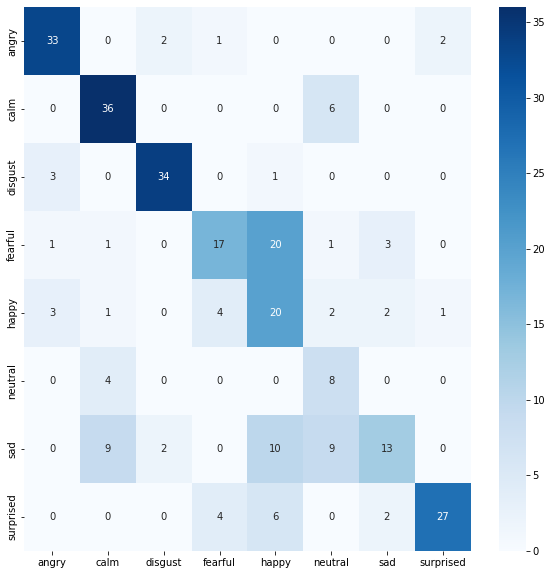

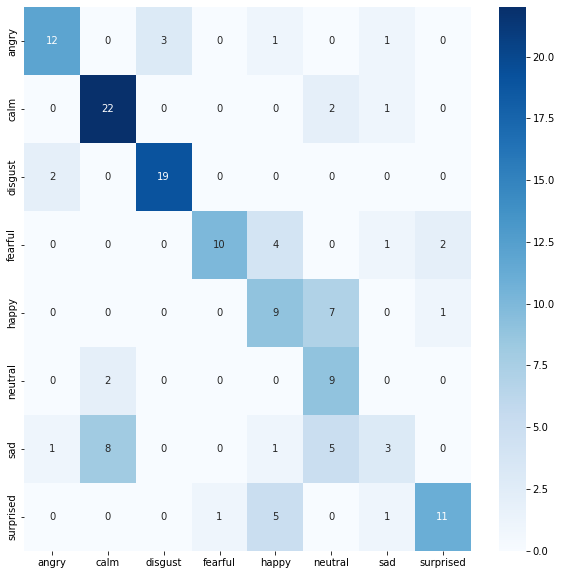

In [ ]:
start_epoch=0
end_epoch=15

# checkpoint = torch.load(your_google_drive_path+'checkpoint.pth')
# start_epoch = checkpoint['epoch']+1
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
data_path="/content/drive/MyDrive/BTP/Ravdess_without_silence"


v1,v2=trainModel2(f2,
                 f2_val,
                 f2_test,
              data_path,
              model_checkpoint,
              lr,  # learning rate
              start_epoch,
              end_epoch,
              wd,  # weight decay
              sc_g,  # Scheduler gamma
              sc_s,  # Scheduler step
              train_size,
              train_bs=16,
              val_bs=16,
              test_bs=16
              )
val_acc.append(v1)
test_acc.append(v2)

print('val_acc= '+str(v1))
print('test_acc= '+str(v2))

In [ ]:
print(val_acc)
print(sum(val_acc)/len(val_acc))
print(test_acc,sum(test_acc)/len(test_acc))
print(sum(test_acc)/len(test_acc))

[0.6909722222222222, 0.6527777777777778]
0.671875
[0.6666666666666666, 0.6597222222222222] 0.6631944444444444
0.6631944444444444
